In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot

# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for specific humidity
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for specific humidity
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for specific humidity
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (specific_humidity) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

# Swap columns 'temperatures' and 'specific_humidity' directly
df['A'] = df['temperatures']
df['temperatures'] = df['specific_humidity']
df['specific_humidity'] = df['A']
df = df.drop(columns=['A'])
# Rename columns
df = df.rename(columns={'temperatures': 'specific_humidity', 'specific_humidity': 'temperatures'})

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['specific_humidity'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['specific_humidity'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['specific_humidity']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df) 

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['specific_humidity']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + 12*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]

print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  specific_humidity          slp  vapor_pressure  \
0      2006-01-31     6501           5.386935  1018.534543        8.674922   
1      2006-02-28     6501           4.299929  1021.230347        6.942276   
2      2006-03-31     6501           6.505135  1018.968548       10.468176   
3      2006-04-30     6501          10.211263  1014.686944       16.358802   
4      2006-05-31     6501          11.737971  1014.236828       18.798749   
...           ...      ...                ...          ...             ...   
24057  2024-07-31     9858          15.211417  1013.969355       23.769169   
24058  2024-08-31     9858          15.149811  1015.112097       23.699154   
24059  2024-09-30     9858          10.720199  1014.393750       16.790240   
24060  2024-10-31     9858           6.989922  1018.230376       1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 2040)
(11, 2040)


In [ ]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# Make a forecast with the best LSTM model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # Create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# Plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # Plot the entire dataset in blue
    plt.plot(series.values)
    # Plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (specific_humidity)
    
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history=best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # Make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # Inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # Evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # Plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

[I 2025-05-18 04:05:15,374] A new study created in memory with name: no-name-5d7c79c9-69bd-4c62-98aa-ef90ceff878f
[I 2025-05-18 04:12:38,672] Trial 0 finished with value: 1.0458225011825562 and parameters: {'lr': 0.23463430352784903, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.2715073562571386}. Best is trial 0 with value: 1.0458225011825562.


Cross Validation Accuracies:
[1.3027656078338623, 1.2200371026992798, 0.7533045411109924, 1.0740679502487183, 0.878937304019928]
Mean Cross Validation Accuracy:
1.0458225011825562
Standard Deviation of Cross Validation Accuracy:
0.20522461783452914


[I 2025-05-18 04:21:16,166] Trial 1 finished with value: 0.4919180154800415 and parameters: {'lr': 0.30503403506714677, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.47331220886839087}. Best is trial 1 with value: 0.4919180154800415.


Cross Validation Accuracies:
[0.29149478673934937, 0.6598424315452576, 0.4975798428058624, 0.47106286883354187, 0.5396101474761963]
Mean Cross Validation Accuracy:
0.4919180154800415
Standard Deviation of Cross Validation Accuracy:
0.11925570260104182


[I 2025-05-18 04:27:04,893] Trial 2 finished with value: 0.07272223681211472 and parameters: {'lr': 0.0019276847820026042, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.13631191505541682}. Best is trial 2 with value: 0.07272223681211472.


Cross Validation Accuracies:
[0.061531104147434235, 0.06698019057512283, 0.08461730927228928, 0.07668106257915497, 0.07380151748657227]
Mean Cross Validation Accuracy:
0.07272223681211472
Standard Deviation of Cross Validation Accuracy:
0.00795666314942481


[I 2025-05-18 04:33:38,938] Trial 3 finished with value: 0.06473758146166801 and parameters: {'lr': 0.014674678404069282, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.25719861531160026}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05877918004989624, 0.060738541185855865, 0.07231773436069489, 0.07328290492296219, 0.05856954678893089]
Mean Cross Validation Accuracy:
0.06473758146166801
Standard Deviation of Cross Validation Accuracy:
0.006633563043587195


[I 2025-05-18 04:40:48,416] Trial 4 finished with value: 0.0652945339679718 and parameters: {'lr': 0.0038096583906000745, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.47254917114501627}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05759654939174652, 0.06326980888843536, 0.07316390424966812, 0.07345489412546158, 0.058987513184547424]
Mean Cross Validation Accuracy:
0.0652945339679718
Standard Deviation of Cross Validation Accuracy:
0.006806694585133741


[I 2025-05-18 04:45:45,855] Trial 5 finished with value: 0.0690462939441204 and parameters: {'lr': 0.029903537626174155, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.3702355579445723}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06273464858531952, 0.06659064441919327, 0.07940472662448883, 0.07432868331670761, 0.06217276677489281]
Mean Cross Validation Accuracy:
0.0690462939441204
Standard Deviation of Cross Validation Accuracy:
0.006757414040119259


[I 2025-05-18 04:51:51,537] Trial 6 finished with value: 0.07439061105251313 and parameters: {'lr': 0.0031015846848808037, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.43851710108020847}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.07843224704265594, 0.07210388034582138, 0.07476913183927536, 0.0748009905219078, 0.07184680551290512]
Mean Cross Validation Accuracy:
0.07439061105251313
Standard Deviation of Cross Validation Accuracy:
0.002381033167345503


[I 2025-05-18 04:56:26,165] Trial 7 finished with value: 0.09984699115157128 and parameters: {'lr': 0.0015502907989110753, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3513321974740117}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.1077122762799263, 0.14365071058273315, 0.0812491849064827, 0.10597202181816101, 0.06065076217055321]
Mean Cross Validation Accuracy:
0.09984699115157128
Standard Deviation of Cross Validation Accuracy:
0.027929795238358594


[I 2025-05-18 05:01:44,480] Trial 8 finished with value: 0.4549329161643982 and parameters: {'lr': 0.003153443631928263, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.169684050578026}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.44575947523117065, 0.4633876085281372, 0.4549821615219116, 0.43719223141670227, 0.4733431041240692]
Mean Cross Validation Accuracy:
0.4549329161643982
Standard Deviation of Cross Validation Accuracy:
0.01272244616929987


[I 2025-05-18 05:08:05,905] Trial 9 finished with value: 0.07470035701990127 and parameters: {'lr': 0.0012716181912856225, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2458889382850832}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06924682855606079, 0.07060843706130981, 0.08107593655586243, 0.08355922251939774, 0.06901136040687561]
Mean Cross Validation Accuracy:
0.07470035701990127
Standard Deviation of Cross Validation Accuracy:
0.0062924872105390925


[I 2025-05-18 05:13:34,963] Trial 10 finished with value: 0.06488067656755447 and parameters: {'lr': 0.022517455168363256, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.20679302838198058}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05898675695061684, 0.06115518510341644, 0.07242737710475922, 0.07325083762407303, 0.058583226054906845]
Mean Cross Validation Accuracy:
0.06488067656755447
Standard Deviation of Cross Validation Accuracy:
0.0065618250993125325


[I 2025-05-18 05:20:11,358] Trial 11 finished with value: 0.0652394413948059 and parameters: {'lr': 0.02391972937314993, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.18753811777093046}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05955933406949043, 0.06247824430465698, 0.07239219546318054, 0.07283507287502289, 0.058932360261678696]
Mean Cross Validation Accuracy:
0.0652394413948059
Standard Deviation of Cross Validation Accuracy:
0.0061404007908850994


[I 2025-05-18 05:28:08,034] Trial 12 finished with value: 0.06505335420370102 and parameters: {'lr': 0.011842343106189876, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.23496255218086148}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.059205684810876846, 0.061241600662469864, 0.07248857617378235, 0.07336112856864929, 0.058969780802726746]
Mean Cross Validation Accuracy:
0.06505335420370102
Standard Deviation of Cross Validation Accuracy:
0.006481299381376767


[I 2025-05-18 05:35:27,079] Trial 13 finished with value: 0.06603479534387588 and parameters: {'lr': 0.11098368847182921, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.10870579952526153}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.061935488134622574, 0.06273854523897171, 0.07487756013870239, 0.07155965268611908, 0.05906273052096367]
Mean Cross Validation Accuracy:
0.06603479534387588
Standard Deviation of Cross Validation Accuracy:
0.006082726528680516


[I 2025-05-18 05:42:11,228] Trial 14 finished with value: 0.06488508805632591 and parameters: {'lr': 0.010805403885053648, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3277508897828936}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05894714221358299, 0.06101635470986366, 0.07249908149242401, 0.0730644166469574, 0.0588984452188015]
Mean Cross Validation Accuracy:
0.06488508805632591
Standard Deviation of Cross Validation Accuracy:
0.006495236766122169


[I 2025-05-18 05:48:17,647] Trial 15 finished with value: 0.07271102666854859 and parameters: {'lr': 0.08338536695304741, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.22078474004243567}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06449022889137268, 0.08431484550237656, 0.07457522302865982, 0.07462005317211151, 0.06555478274822235]
Mean Cross Validation Accuracy:
0.07271102666854859
Standard Deviation of Cross Validation Accuracy:
0.007218885854882107


[I 2025-05-18 05:54:29,339] Trial 16 finished with value: 0.06511583626270294 and parameters: {'lr': 0.00987855039727893, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2994220539070209}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05938439071178436, 0.06144820153713226, 0.07235714793205261, 0.07299277931451797, 0.059396661818027496]
Mean Cross Validation Accuracy:
0.06511583626270294
Standard Deviation of Cross Validation Accuracy:
0.00622081659344144


[I 2025-05-18 05:59:26,305] Trial 17 finished with value: 0.06510208621621132 and parameters: {'lr': 0.6423451279861242, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3975037985344668}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05599265173077583, 0.06354887038469315, 0.07469639182090759, 0.07467550039291382, 0.056597016751766205]
Mean Cross Validation Accuracy:
0.06510208621621132
Standard Deviation of Cross Validation Accuracy:
0.008263551799241672


[I 2025-05-18 06:06:10,065] Trial 18 finished with value: 0.06815013885498047 and parameters: {'lr': 0.06759071440356733, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.17006531434551703}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06577073037624359, 0.0623144656419754, 0.07519000768661499, 0.07434622943401337, 0.06312926113605499]
Mean Cross Validation Accuracy:
0.06815013885498047
Standard Deviation of Cross Validation Accuracy:
0.005529505787252086


[I 2025-05-18 06:14:22,341] Trial 19 finished with value: 1.2570969104766845 and parameters: {'lr': 0.018255301202693388, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.28740617084574127}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[1.148516297340393, 1.2343900203704834, 1.30912184715271, 1.2719659805297852, 1.3214904069900513]
Mean Cross Validation Accuracy:
1.2570969104766845
Standard Deviation of Cross Validation Accuracy:
0.062256819836791426


[I 2025-05-18 06:18:18,573] Trial 20 finished with value: 0.06627224534749984 and parameters: {'lr': 0.047484294281056175, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20561704490325536}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06237891688942909, 0.06232786551117897, 0.07293351739645004, 0.07454252988100052, 0.05917839705944061]
Mean Cross Validation Accuracy:
0.06627224534749984
Standard Deviation of Cross Validation Accuracy:
0.006225897106197384


[I 2025-05-18 06:23:48,155] Trial 21 finished with value: 0.06492693647742272 and parameters: {'lr': 0.006247946024474003, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3329794587091625}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.059101518243551254, 0.0614701546728611, 0.07237711548805237, 0.07300673425197601, 0.058679159730672836]
Mean Cross Validation Accuracy:
0.06492693647742272
Standard Deviation of Cross Validation Accuracy:
0.006414169497124346


[I 2025-05-18 06:29:10,654] Trial 22 finished with value: 0.06519321575760842 and parameters: {'lr': 0.009048088346632859, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3287690037881847}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05952364578843117, 0.061668768525123596, 0.07255352288484573, 0.07303441315889359, 0.059185728430747986]
Mean Cross Validation Accuracy:
0.06519321575760842
Standard Deviation of Cross Validation Accuracy:
0.006266005962421945


[I 2025-05-18 06:35:40,948] Trial 23 finished with value: 0.06518507227301598 and parameters: {'lr': 0.01638864766226021, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3866321836207025}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05894693359732628, 0.06209476292133331, 0.07245644927024841, 0.07323764264583588, 0.059189572930336]
Mean Cross Validation Accuracy:
0.06518507227301598
Standard Deviation of Cross Validation Accuracy:
0.006358100525147535


[I 2025-05-18 06:42:22,219] Trial 24 finished with value: 0.06597466617822648 and parameters: {'lr': 0.04270182809908143, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2648892224303116}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06256167590618134, 0.06183350458741188, 0.07296428829431534, 0.07361385226249695, 0.05890000984072685]
Mean Cross Validation Accuracy:
0.06597466617822648
Standard Deviation of Cross Validation Accuracy:
0.00610017156427369


[I 2025-05-18 06:50:14,469] Trial 25 finished with value: 0.06511239409446716 and parameters: {'lr': 0.006035270330263962, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.30429650084405574}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05965554714202881, 0.06131512299180031, 0.07249395549297333, 0.07315400242805481, 0.05894334241747856]
Mean Cross Validation Accuracy:
0.06511239409446716
Standard Deviation of Cross Validation Accuracy:
0.006346787507922145


[I 2025-05-18 06:57:32,785] Trial 26 finished with value: 0.06508854031562805 and parameters: {'lr': 0.00616473719980676, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2514812857805915}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.059402093291282654, 0.061564043164253235, 0.07243681699037552, 0.07316850125789642, 0.05887124687433243]
Mean Cross Validation Accuracy:
0.06508854031562805
Standard Deviation of Cross Validation Accuracy:
0.006367031279695954


[I 2025-05-18 07:03:38,297] Trial 27 finished with value: 0.06508886069059372 and parameters: {'lr': 0.014013502799347707, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4275320153038634}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.0590268038213253, 0.06205949932336807, 0.0724392756819725, 0.07329481095075607, 0.058623913675546646]
Mean Cross Validation Accuracy:
0.06508886069059372
Standard Deviation of Cross Validation Accuracy:
0.006466642465833321


[I 2025-05-18 07:08:30,475] Trial 28 finished with value: 0.7947762727737426 and parameters: {'lr': 0.1486495972444829, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.1385270070986705}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.6237406730651855, 0.9024938941001892, 0.7585538625717163, 0.9999954700469971, 0.6890974640846252]
Mean Cross Validation Accuracy:
0.7947762727737426
Standard Deviation of Cross Validation Accuracy:
0.1381674743549779


[I 2025-05-18 07:17:48,720] Trial 29 finished with value: 0.06634311005473137 and parameters: {'lr': 0.038329360530135075, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.3208984855988791}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.0664810836315155, 0.06234026327729225, 0.07468833774328232, 0.06926827132701874, 0.058937594294548035]
Mean Cross Validation Accuracy:
0.06634311005473137
Standard Deviation of Cross Validation Accuracy:
0.005460455591771008


[I 2025-05-18 07:24:32,901] Trial 30 finished with value: 0.15064964890480043 and parameters: {'lr': 0.0275880583443, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.2109602159043873}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.16236993670463562, 0.13479694724082947, 0.1778610199689865, 0.15472055971622467, 0.1234997808933258]
Mean Cross Validation Accuracy:
0.15064964890480043
Standard Deviation of Cross Validation Accuracy:
0.019405255263591464


[I 2025-05-18 07:30:21,346] Trial 31 finished with value: 0.06497322618961335 and parameters: {'lr': 0.006570604163135633, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2773867890341227}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.059080008417367935, 0.061438366770744324, 0.07242985814809799, 0.07308817654848099, 0.05882972106337547]
Mean Cross Validation Accuracy:
0.06497322618961335
Standard Deviation of Cross Validation Accuracy:
0.006425288811400898


[I 2025-05-18 07:36:12,146] Trial 32 finished with value: 0.09132853001356125 and parameters: {'lr': 0.004127145032566879, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.34304301376113105}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.09171246737241745, 0.06545630097389221, 0.1080009862780571, 0.10880067199468613, 0.08267222344875336]
Mean Cross Validation Accuracy:
0.09132853001356125
Standard Deviation of Cross Validation Accuracy:
0.016295384806875035


[I 2025-05-18 07:42:15,953] Trial 33 finished with value: 0.06475244909524917 and parameters: {'lr': 0.020473360534575696, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3110564598807167}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05899874120950699, 0.06112124025821686, 0.07220783084630966, 0.07301241904497147, 0.058422014117240906]
Mean Cross Validation Accuracy:
0.06475244909524917
Standard Deviation of Cross Validation Accuracy:
0.006483441365320504


[I 2025-05-18 07:49:19,350] Trial 34 finished with value: 0.0660737358033657 and parameters: {'lr': 0.022173416263066452, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2714001409935182}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06208144128322601, 0.061768196523189545, 0.07251328974962234, 0.07518918812274933, 0.058816563338041306]
Mean Cross Validation Accuracy:
0.0660737358033657
Standard Deviation of Cross Validation Accuracy:
0.006506949550040259


[I 2025-05-18 07:55:45,828] Trial 35 finished with value: 0.06564022973179817 and parameters: {'lr': 0.05721074794384594, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.36419272806546354}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06162339076399803, 0.06418713182210922, 0.07271261513233185, 0.073044553399086, 0.05663345754146576]
Mean Cross Validation Accuracy:
0.06564022973179817
Standard Deviation of Cross Validation Accuracy:
0.006390791474309985


[I 2025-05-18 08:00:01,681] Trial 36 finished with value: 0.07055149450898171 and parameters: {'lr': 0.29098981024785203, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.30830861827084105}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.07268351316452026, 0.060118868947029114, 0.0791943147778511, 0.08002132922410965, 0.06073944643139839]
Mean Cross Validation Accuracy:
0.07055149450898171
Standard Deviation of Cross Validation Accuracy:
0.00864913381642462


[I 2025-05-18 08:06:15,583] Trial 37 finished with value: 0.08981218039989472 and parameters: {'lr': 0.009369416047027724, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.25188033878179156}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.09767205268144608, 0.08549655228853226, 0.09195815771818161, 0.09077337384223938, 0.08316076546907425]
Mean Cross Validation Accuracy:
0.08981218039989472
Standard Deviation of Cross Validation Accuracy:
0.005102404733927541


[I 2025-05-18 08:12:00,286] Trial 38 finished with value: 0.06497168689966201 and parameters: {'lr': 0.03109052594660744, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2312265188717497}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05906040966510773, 0.06044301018118858, 0.07264815270900726, 0.0733385756611824, 0.05936828628182411]
Mean Cross Validation Accuracy:
0.06497168689966201
Standard Deviation of Cross Validation Accuracy:
0.006569370817938231


[I 2025-05-18 08:18:42,345] Trial 39 finished with value: 0.08461627662181855 and parameters: {'lr': 0.01247001662120532, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1940684332902919}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.06954334676265717, 0.07938007265329361, 0.10991492122411728, 0.07767586410045624, 0.08656717836856842]
Mean Cross Validation Accuracy:
0.08461627662181855
Standard Deviation of Cross Validation Accuracy:
0.013759417203099615


[I 2025-05-18 08:26:49,702] Trial 40 finished with value: 0.46659616827964784 and parameters: {'lr': 0.002520121486643968, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.4144081622037047}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.46212148666381836, 0.46221014857292175, 0.46193936467170715, 0.4739656448364258, 0.4727441966533661]
Mean Cross Validation Accuracy:
0.46659616827964784
Standard Deviation of Cross Validation Accuracy:
0.005532688349775462


[I 2025-05-18 08:34:13,829] Trial 41 finished with value: 0.07054238095879554 and parameters: {'lr': 0.004442101752136816, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3493932090419345}. Best is trial 3 with value: 0.06473758146166801.


Cross Validation Accuracies:
[0.05929742753505707, 0.07815216481685638, 0.07611259073019028, 0.07677841186523438, 0.06237130984663963]
Mean Cross Validation Accuracy:
0.07054238095879554
Standard Deviation of Cross Validation Accuracy:
0.00801298333146602


[I 2025-05-18 08:40:47,852] Trial 42 finished with value: 0.06464687585830689 and parameters: {'lr': 0.01807288356493865, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.49514573990307015}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05781635269522667, 0.06146134436130524, 0.07224368304014206, 0.07283911108970642, 0.05887388810515404]
Mean Cross Validation Accuracy:
0.06464687585830689
Standard Deviation of Cross Validation Accuracy:
0.006556755945471571


[I 2025-05-18 08:48:12,896] Trial 43 finished with value: 0.06488721594214439 and parameters: {'lr': 0.018454549465991194, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4887144210873822}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05823133885860443, 0.061794497072696686, 0.07251821458339691, 0.0730634331703186, 0.05882859602570534]
Mean Cross Validation Accuracy:
0.06488721594214439
Standard Deviation of Cross Validation Accuracy:
0.006567421921478669


[I 2025-05-18 08:54:34,491] Trial 44 finished with value: 0.06533426567912101 and parameters: {'lr': 0.02763840103169211, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4587947324979602}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.060739219188690186, 0.061090704053640366, 0.07266634702682495, 0.0729488879442215, 0.05922617018222809]
Mean Cross Validation Accuracy:
0.06533426567912101
Standard Deviation of Cross Validation Accuracy:
0.006134704348982895


[I 2025-05-18 09:00:39,377] Trial 45 finished with value: 0.06501340121030807 and parameters: {'lr': 0.008422022815825504, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4992005649020522}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05946338549256325, 0.06117348372936249, 0.07248977571725845, 0.07291854172945023, 0.05902181938290596]
Mean Cross Validation Accuracy:
0.06501340121030807
Standard Deviation of Cross Validation Accuracy:
0.006321931918610038


[I 2025-05-18 09:06:56,994] Trial 46 finished with value: 0.06511529609560966 and parameters: {'lr': 0.02068519882052749, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.15068833976925}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05985685810446739, 0.06136799231171608, 0.07216837257146835, 0.07284510135650635, 0.05933815613389015]
Mean Cross Validation Accuracy:
0.06511529609560966
Standard Deviation of Cross Validation Accuracy:
0.006075600036843527


[I 2025-05-18 09:15:32,339] Trial 47 finished with value: 0.10723576843738555 and parameters: {'lr': 0.011938929139951978, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.36991501170614055}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.13180679082870483, 0.09611651301383972, 0.10482742637395859, 0.10782213509082794, 0.09560597687959671]
Mean Cross Validation Accuracy:
0.10723576843738555
Standard Deviation of Cross Validation Accuracy:
0.013181570252083963


[I 2025-05-18 09:21:21,847] Trial 48 finished with value: 0.06925764232873917 and parameters: {'lr': 0.09095396077908444, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.10841622850814919}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.06510327011346817, 0.06259802728891373, 0.08002312481403351, 0.0763191357254982, 0.06224465370178223]
Mean Cross Validation Accuracy:
0.06925764232873917
Standard Deviation of Cross Validation Accuracy:
0.007437090729541531


[I 2025-05-18 09:26:15,289] Trial 49 finished with value: 0.06550557911396027 and parameters: {'lr': 0.03585650230116812, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4562812618478026}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.06117101013660431, 0.06028556451201439, 0.07291378825902939, 0.07391341030597687, 0.059244122356176376]
Mean Cross Validation Accuracy:
0.06550557911396027
Standard Deviation of Cross Validation Accuracy:
0.006493320714151049


[I 2025-05-18 09:31:48,806] Trial 50 finished with value: 0.0649731032550335 and parameters: {'lr': 0.015414516370662832, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1861686963561651}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.059122439473867416, 0.061700306832790375, 0.0722937062382698, 0.07309336960315704, 0.058655694127082825]
Mean Cross Validation Accuracy:
0.0649731032550335
Standard Deviation of Cross Validation Accuracy:
0.006393450942867185


[I 2025-05-18 09:39:08,789] Trial 51 finished with value: 0.06513817459344864 and parameters: {'lr': 0.022959047823413393, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.49729462257165213}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05960424244403839, 0.061072155833244324, 0.07291821390390396, 0.0734388679265976, 0.05865739285945892]
Mean Cross Validation Accuracy:
0.06513817459344864
Standard Deviation of Cross Validation Accuracy:
0.006611928114543263


[I 2025-05-18 09:45:40,195] Trial 52 finished with value: 0.06503832414746284 and parameters: {'lr': 0.020379953276515667, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4742131207993223}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.0596846379339695, 0.06168344244360924, 0.07232578843832016, 0.07320330291986465, 0.058294449001550674]
Mean Cross Validation Accuracy:
0.06503832414746284
Standard Deviation of Cross Validation Accuracy:
0.006405795086440792


[I 2025-05-18 09:53:31,570] Trial 53 finished with value: 0.0649768054485321 and parameters: {'lr': 0.0170587081800049, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.48405186188415666}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.059567276388406754, 0.06148242950439453, 0.07238771766424179, 0.07296232134103775, 0.0584842823445797]
Mean Cross Validation Accuracy:
0.0649768054485321
Standard Deviation of Cross Validation Accuracy:
0.006361078652006735


[I 2025-05-18 10:00:59,718] Trial 54 finished with value: 0.06478440463542938 and parameters: {'lr': 0.011823633895284518, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.45323920084566827}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05809800326824188, 0.06146720424294472, 0.07242462038993835, 0.07312589138746262, 0.05880630388855934]
Mean Cross Validation Accuracy:
0.06478440463542938
Standard Deviation of Cross Validation Accuracy:
0.006624239854300998


[I 2025-05-18 10:07:10,537] Trial 55 finished with value: 0.06498782709240913 and parameters: {'lr': 0.00757272886373488, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.43415386851417603}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05896341800689697, 0.06149359047412872, 0.07231119275093079, 0.07294363528490067, 0.05922729894518852]
Mean Cross Validation Accuracy:
0.06498782709240913
Standard Deviation of Cross Validation Accuracy:
0.006302593870355027


[I 2025-05-18 10:12:54,310] Trial 56 finished with value: 0.06498450264334679 and parameters: {'lr': 0.010694442035727544, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4570978259543954}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05853170529007912, 0.06153141334652901, 0.07255664467811584, 0.07349006831645966, 0.05881268158555031]
Mean Cross Validation Accuracy:
0.06498450264334679
Standard Deviation of Cross Validation Accuracy:
0.0066533567010637305


[I 2025-05-18 10:19:13,068] Trial 57 finished with value: 0.0721406914293766 and parameters: {'lr': 0.7538455863744877, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3852228203589547}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.07057440280914307, 0.06855828315019608, 0.0747852697968483, 0.08474714308977127, 0.0620383583009243]
Mean Cross Validation Accuracy:
0.0721406914293766
Standard Deviation of Cross Validation Accuracy:
0.007526758425330334


[I 2025-05-18 10:28:37,498] Trial 58 finished with value: 0.7349961012601852 and parameters: {'lr': 0.04699412684084753, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.23226345622781647}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.8568265438079834, 0.6910083293914795, 0.2484750598669052, 0.9649885296821594, 0.9136820435523987]
Mean Cross Validation Accuracy:
0.7349961012601852
Standard Deviation of Cross Validation Accuracy:
0.26011746870522195


[I 2025-05-18 10:33:26,780] Trial 59 finished with value: 0.456345397233963 and parameters: {'lr': 0.005230698584177142, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.2883653422083371}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.431043416261673, 0.46810972690582275, 0.46208488941192627, 0.4516923129558563, 0.46879664063453674]
Mean Cross Validation Accuracy:
0.456345397233963
Standard Deviation of Cross Validation Accuracy:
0.01405856407838811


[I 2025-05-18 10:39:34,918] Trial 60 finished with value: 0.19087064564228057 and parameters: {'lr': 0.003094133497566078, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.31459370289937516}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.22312428057193756, 0.17863662540912628, 0.20245777070522308, 0.21438726782798767, 0.1357472836971283]
Mean Cross Validation Accuracy:
0.19087064564228057
Standard Deviation of Cross Validation Accuracy:
0.03135552976948928


[I 2025-05-18 10:45:37,488] Trial 61 finished with value: 0.06490559801459313 and parameters: {'lr': 0.015041583049938863, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.47776503580983537}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.058527473360300064, 0.061016179621219635, 0.072610042989254, 0.07327423989772797, 0.05910005420446396]
Mean Cross Validation Accuracy:
0.06490559801459313
Standard Deviation of Cross Validation Accuracy:
0.006616721662749279


[I 2025-05-18 10:51:17,855] Trial 62 finished with value: 0.06497263163328171 and parameters: {'lr': 0.011562923676317867, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4465071423166552}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.059441208839416504, 0.06106710806488991, 0.07241661846637726, 0.0729396715760231, 0.05899855121970177]
Mean Cross Validation Accuracy:
0.06497263163328171
Standard Deviation of Cross Validation Accuracy:
0.006331288252420854


[I 2025-05-18 10:57:02,867] Trial 63 finished with value: 0.06531665921211242 and parameters: {'lr': 0.025117282195542052, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.41492472696021215}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.059785231947898865, 0.062170449644327164, 0.07240566611289978, 0.07350854575634003, 0.0587134025990963]
Mean Cross Validation Accuracy:
0.06531665921211242
Standard Deviation of Cross Validation Accuracy:
0.006347587638055229


[I 2025-05-18 11:03:04,800] Trial 64 finished with value: 0.06502543464303016 and parameters: {'lr': 0.017989085686479913, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.49138058379830296}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05939234793186188, 0.06099027767777443, 0.07241001725196838, 0.07345433533191681, 0.058880195021629333]
Mean Cross Validation Accuracy:
0.06502543464303016
Standard Deviation of Cross Validation Accuracy:
0.006501639097421108


[I 2025-05-18 11:08:35,616] Trial 65 finished with value: 0.06525463610887527 and parameters: {'lr': 0.059841758378436104, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4657151467420362}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.061601296067237854, 0.059746548533439636, 0.07261703908443451, 0.07346988469362259, 0.058838412165641785]
Mean Cross Validation Accuracy:
0.06525463610887527
Standard Deviation of Cross Validation Accuracy:
0.0064272721861134635


[I 2025-05-18 11:14:18,953] Trial 66 finished with value: 0.06945399641990661 and parameters: {'lr': 0.032965557103735346, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.2585307666166389}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.06160692125558853, 0.06360967457294464, 0.07856209576129913, 0.08012532442808151, 0.06336596608161926]
Mean Cross Validation Accuracy:
0.06945399641990661
Standard Deviation of Cross Validation Accuracy:
0.008119501400405998


[I 2025-05-18 11:21:11,069] Trial 67 finished with value: 0.06486166566610337 and parameters: {'lr': 0.00892661767222391, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.17046342725118166}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05852200835943222, 0.061172593384981155, 0.07242395728826523, 0.07315439730882645, 0.059035371989011765]
Mean Cross Validation Accuracy:
0.06486166566610337
Standard Deviation of Cross Validation Accuracy:
0.006537642690602336


[I 2025-05-18 11:28:52,977] Trial 68 finished with value: 0.0653197556734085 and parameters: {'lr': 0.008110963690051319, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.15125860171241448}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.060413774102926254, 0.06087026745080948, 0.07393128424882889, 0.07250043749809265, 0.05888301506638527]
Mean Cross Validation Accuracy:
0.0653197556734085
Standard Deviation of Cross Validation Accuracy:
0.006496442813227741


[I 2025-05-18 11:33:05,564] Trial 69 finished with value: 0.0651285246014595 and parameters: {'lr': 0.013483724115054156, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.21231275822517937}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.059505119919776917, 0.0612138994038105, 0.07247854769229889, 0.07312877476215363, 0.059316281229257584]
Mean Cross Validation Accuracy:
0.0651285246014595
Standard Deviation of Cross Validation Accuracy:
0.00630485504574533


[I 2025-05-18 11:38:39,567] Trial 70 finished with value: 0.06498599126935005 and parameters: {'lr': 0.010455439325619107, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1789476998958755}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.058789968490600586, 0.06133975833654404, 0.07231594622135162, 0.07323618978261948, 0.05924809351563454]
Mean Cross Validation Accuracy:
0.06498599126935005
Standard Deviation of Cross Validation Accuracy:
0.006425001145741226


[I 2025-05-18 11:43:43,308] Trial 71 finished with value: 0.06502278000116349 and parameters: {'lr': 0.018090110401729278, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.16613006771530037}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.059577248990535736, 0.06151995807886124, 0.07227841764688492, 0.07294212281703949, 0.05879615247249603]
Mean Cross Validation Accuracy:
0.06502278000116349
Standard Deviation of Cross Validation Accuracy:
0.006261864388011066


[I 2025-05-18 11:49:24,280] Trial 72 finished with value: 0.5743218243122101 and parameters: {'lr': 0.001068259461802847, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.28361188793809067}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.6591994166374207, 0.6796229481697083, 0.5644581317901611, 0.5088339447975159, 0.4594946801662445]
Mean Cross Validation Accuracy:
0.5743218243122101
Standard Deviation of Cross Validation Accuracy:
0.08469210139180135


[I 2025-05-18 11:55:02,483] Trial 73 finished with value: 0.06526392623782158 and parameters: {'lr': 0.00504356747552432, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.124924880175155}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05947822704911232, 0.06173885986208916, 0.07272858917713165, 0.0730120837688446, 0.05936187133193016]
Mean Cross Validation Accuracy:
0.06526392623782158
Standard Deviation of Cross Validation Accuracy:
0.006268808468772442


[I 2025-05-18 12:01:37,145] Trial 74 finished with value: 0.0651181772351265 and parameters: {'lr': 0.007102315160215436, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2408051362606714}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05945998802781105, 0.06169724464416504, 0.07246565818786621, 0.07319477945566177, 0.0587732158601284]
Mean Cross Validation Accuracy:
0.0651181772351265
Standard Deviation of Cross Validation Accuracy:
0.006374847441743672


[I 2025-05-18 12:07:08,139] Trial 75 finished with value: 0.06497335210442542 and parameters: {'lr': 0.0146377734140019, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.2968254737808815}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05925672873854637, 0.06077435240149498, 0.07220353931188583, 0.07354580610990524, 0.059086333960294724]
Mean Cross Validation Accuracy:
0.06497335210442542
Standard Deviation of Cross Validation Accuracy:
0.006492009528225286


[I 2025-05-18 12:15:19,662] Trial 76 finished with value: 0.06802125573158264 and parameters: {'lr': 0.026972628011616494, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.3314690267419014}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.0696907788515091, 0.06088518723845482, 0.07397881150245667, 0.07468775659799576, 0.06086374446749687]
Mean Cross Validation Accuracy:
0.06802125573158264
Standard Deviation of Cross Validation Accuracy:
0.006080714646274013


[I 2025-05-18 12:20:23,541] Trial 77 finished with value: 0.0649803787469864 and parameters: {'lr': 0.009417738456471234, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2221159680673229}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05944391340017319, 0.06132551655173302, 0.0723523423075676, 0.07299835234880447, 0.05878176912665367]
Mean Cross Validation Accuracy:
0.0649803787469864
Standard Deviation of Cross Validation Accuracy:
0.006341403233449611


[I 2025-05-18 12:26:36,470] Trial 78 finished with value: 0.070400170981884 and parameters: {'lr': 0.04022314126674617, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.19672891806929324}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.06614071130752563, 0.06678248196840286, 0.07554257661104202, 0.07938116788864136, 0.06415391713380814]
Mean Cross Validation Accuracy:
0.070400170981884
Standard Deviation of Cross Validation Accuracy:
0.005955652755900583


[I 2025-05-18 12:32:41,012] Trial 79 finished with value: 0.06517002061009407 and parameters: {'lr': 0.02067090186669316, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4850937163536394}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05905349180102348, 0.0610995776951313, 0.07263573259115219, 0.07351328432559967, 0.059548016637563705]
Mean Cross Validation Accuracy:
0.06517002061009407
Standard Deviation of Cross Validation Accuracy:
0.006495140701692233


[I 2025-05-18 12:39:53,328] Trial 80 finished with value: 0.06483138576149941 and parameters: {'lr': 0.012584798425744854, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4192533743998095}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.060438212007284164, 0.0590786449611187, 0.07300224155187607, 0.07175599038600922, 0.05988183990120888]
Mean Cross Validation Accuracy:
0.06483138576149941
Standard Deviation of Cross Validation Accuracy:
0.006190396435239411


[I 2025-05-18 12:46:57,937] Trial 81 finished with value: 0.06466076299548149 and parameters: {'lr': 0.011324683957968647, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.44766968098551757}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.05655282363295555, 0.0640149712562561, 0.07252725958824158, 0.07256854325532913, 0.05764021724462509]
Mean Cross Validation Accuracy:
0.06466076299548149
Standard Deviation of Cross Validation Accuracy:
0.006926161239801731


[I 2025-05-18 12:53:59,398] Trial 82 finished with value: 0.06586719155311585 and parameters: {'lr': 0.01273679428720369, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4192693808275361}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.056847695261240005, 0.06205502524971962, 0.07268387824296951, 0.07539483904838562, 0.062354519963264465]
Mean Cross Validation Accuracy:
0.06586719155311585
Standard Deviation of Cross Validation Accuracy:
0.0070066549965559066


[I 2025-05-18 13:00:31,550] Trial 83 finished with value: 0.06566281616687775 and parameters: {'lr': 0.009203756819016095, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3958985594618303}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.06175461784005165, 0.060497745871543884, 0.07267288118600845, 0.07359974086284637, 0.05978909507393837]
Mean Cross Validation Accuracy:
0.06566281616687775
Standard Deviation of Cross Validation Accuracy:
0.00614147132203846


[I 2025-05-18 13:07:01,900] Trial 84 finished with value: 0.06585901603102684 and parameters: {'lr': 0.005724760056073868, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.44615457600298924}. Best is trial 42 with value: 0.06464687585830689.


Cross Validation Accuracies:
[0.06208498775959015, 0.06300894170999527, 0.07286638766527176, 0.07276836782693863, 0.058566395193338394]
Mean Cross Validation Accuracy:
0.06585901603102684
Standard Deviation of Cross Validation Accuracy:
0.005871812857565958


[I 2025-05-18 13:13:59,829] Trial 85 finished with value: 0.06388984844088555 and parameters: {'lr': 0.0075347879655024725, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4315340075776729}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.054280176758766174, 0.059719398617744446, 0.07351742684841156, 0.07260225713253021, 0.05932998284697533]
Mean Cross Validation Accuracy:
0.06388984844088555
Standard Deviation of Cross Validation Accuracy:
0.007734690000294743


[I 2025-05-18 13:21:32,408] Trial 86 finished with value: 0.06555255725979806 and parameters: {'lr': 0.0035246703257811613, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4027404470475025}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.059587981551885605, 0.060856934636831284, 0.07374773919582367, 0.07334619015455246, 0.06022394075989723]
Mean Cross Validation Accuracy:
0.06555255725979806
Standard Deviation of Cross Validation Accuracy:
0.006540961850653318


[I 2025-05-18 13:25:58,519] Trial 87 finished with value: 0.06426668614149093 and parameters: {'lr': 0.007313301543291928, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.43959274501903817}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.05609827861189842, 0.06254683434963226, 0.07285574823617935, 0.07202494144439697, 0.05780762806534767]
Mean Cross Validation Accuracy:
0.06426668614149093
Standard Deviation of Cross Validation Accuracy:
0.007005179740705269


[I 2025-05-18 13:30:24,976] Trial 88 finished with value: 0.06550362333655357 and parameters: {'lr': 0.007670947237741508, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4259398420041224}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.0586124025285244, 0.06105535104870796, 0.07297443598508835, 0.07436785846948624, 0.06050806865096092]
Mean Cross Validation Accuracy:
0.06550362333655357
Standard Deviation of Cross Validation Accuracy:
0.006732300101896842


[I 2025-05-18 13:35:34,317] Trial 89 finished with value: 0.06657517477869987 and parameters: {'lr': 0.004546551871903314, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.44072215473490417}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.0623553991317749, 0.062193870544433594, 0.0735778659582138, 0.07375763356685638, 0.06099110469222069]
Mean Cross Validation Accuracy:
0.06657517477869987
Standard Deviation of Cross Validation Accuracy:
0.005810500323268235


[I 2025-05-18 13:40:33,861] Trial 90 finished with value: 0.6496986746788025 and parameters: {'lr': 0.46379669732890466, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.46430249898718173}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.6468817591667175, 0.6798456311225891, 0.923647940158844, 0.5475833415985107, 0.4505347013473511]
Mean Cross Validation Accuracy:
0.6496986746788025
Standard Deviation of Cross Validation Accuracy:
0.15878211711408188


[I 2025-05-18 13:45:05,500] Trial 91 finished with value: 0.06615331918001174 and parameters: {'lr': 0.010759392332530843, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4317615432661322}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.05966348573565483, 0.06230636686086655, 0.07378619909286499, 0.0748552680015564, 0.06015527620911598]
Mean Cross Validation Accuracy:
0.06615331918001174
Standard Deviation of Cross Validation Accuracy:
0.0067361453193767


[I 2025-05-18 13:49:57,659] Trial 92 finished with value: 0.06510168015956878 and parameters: {'lr': 0.0063103207302411205, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.40513345139843726}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.05940675735473633, 0.06133311614394188, 0.07220876216888428, 0.07367654144763947, 0.05888322368264198]
Mean Cross Validation Accuracy:
0.06510168015956878
Standard Deviation of Cross Validation Accuracy:
0.006470583934160823


[I 2025-05-18 13:56:55,517] Trial 93 finished with value: 0.0650751069188118 and parameters: {'lr': 0.013036640052264901, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4486733409147686}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.05795254558324814, 0.061164166778326035, 0.07257039844989777, 0.07400322705507278, 0.05968519672751427]
Mean Cross Validation Accuracy:
0.0650751069188118
Standard Deviation of Cross Validation Accuracy:
0.006796590158823174


[I 2025-05-18 14:03:59,370] Trial 94 finished with value: 0.06689140647649765 and parameters: {'lr': 0.015922896462025552, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.384414515487413}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.06446684151887894, 0.062012020498514175, 0.0731223076581955, 0.07428506016731262, 0.06057080253958702]
Mean Cross Validation Accuracy:
0.06689140647649765
Standard Deviation of Cross Validation Accuracy:
0.00571186836891275


[I 2025-05-18 14:08:52,490] Trial 95 finished with value: 0.07011326029896736 and parameters: {'lr': 0.008590442104800693, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.424347672018167}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.058025989681482315, 0.06329170614480972, 0.08153697848320007, 0.07543475180864334, 0.07227687537670135]
Mean Cross Validation Accuracy:
0.07011326029896736
Standard Deviation of Cross Validation Accuracy:
0.00843962737688511


[I 2025-05-18 14:15:51,197] Trial 96 finished with value: 0.06705927476286888 and parameters: {'lr': 0.007088188187178537, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.44003206374548176}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.06471310555934906, 0.06310513615608215, 0.07228705286979675, 0.07501137256622314, 0.060179706662893295]
Mean Cross Validation Accuracy:
0.06705927476286888
Standard Deviation of Cross Validation Accuracy:
0.005639746496161222


[I 2025-05-18 14:22:55,983] Trial 97 finished with value: 0.06548948660492897 and parameters: {'lr': 0.02346639586380762, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.47450109280901964}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.060398779809474945, 0.06048920378088951, 0.07311008125543594, 0.07304409891366959, 0.060405269265174866]
Mean Cross Validation Accuracy:
0.06548948660492897
Standard Deviation of Cross Validation Accuracy:
0.006195369559892821


[I 2025-05-18 14:29:43,236] Trial 98 finished with value: 0.1960957944393158 and parameters: {'lr': 0.031624855617514026, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.4671710146249546}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.21860076487064362, 0.21288567781448364, 0.1569882035255432, 0.17907220125198364, 0.21293212473392487]
Mean Cross Validation Accuracy:
0.1960957944393158
Standard Deviation of Cross Validation Accuracy:
0.02404596551499905


[I 2025-05-18 14:34:38,954] Trial 99 finished with value: 0.06510899811983109 and parameters: {'lr': 0.011684819632189111, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.45317929366189497}. Best is trial 85 with value: 0.06388984844088555.


Cross Validation Accuracies:
[0.05410813167691231, 0.06464201211929321, 0.07304901629686356, 0.07620428502559662, 0.05754154548048973]
Mean Cross Validation Accuracy:
0.06510899811983109
Standard Deviation of Cross Validation Accuracy:
0.008539938618528442
Number of finished trials: 100
Best trial: {'lr': 0.0075347879655024725, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4315340075776729}
Best hyperparameters:  {'lr': 0.0075347879655024725, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4315340075776729}
Fold 1:
Epoch 1/100
84/84 [==============================] - 27s 227ms/step - loss: 0.1026 - val_loss: 0.2105
Epoch 2/100
84/84 [==============================] - 16s 189ms/step - loss: 0.0709 - val_loss: 0.1875
Epoch 3/100
84/84 [==============================] - 16s 191ms/step - loss: 0.0679 - val_loss: 0.1941
Epoch 4/100
84/84 [==============================] - 15s 175ms/step - loss: 0.065

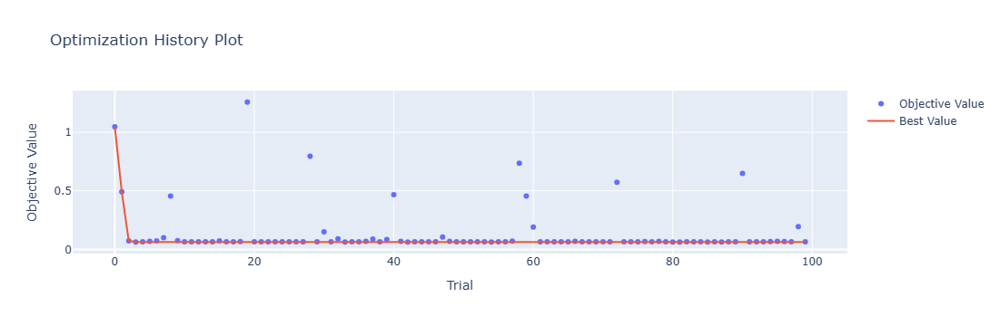

In [4]:
optuna.visualization.plot_optimization_history(study)

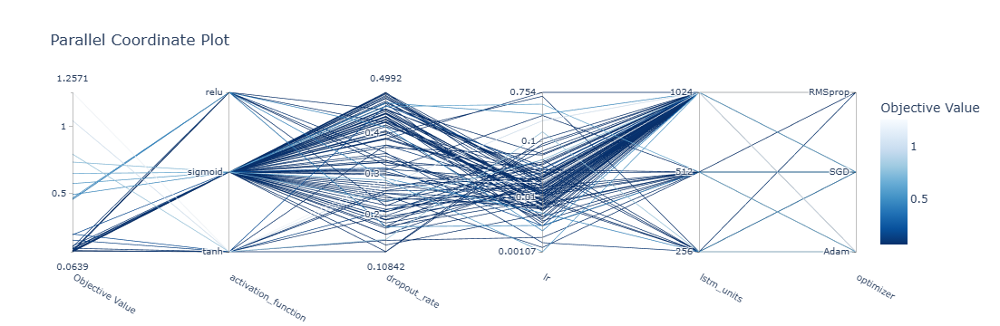

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

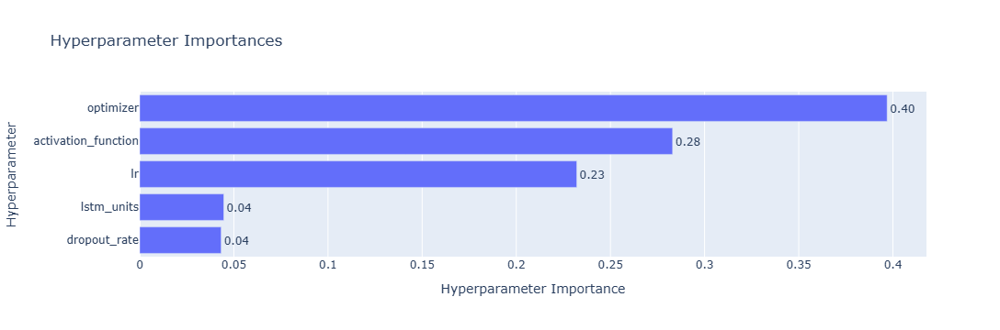

In [6]:
optuna.visualization.plot_param_importances(study)

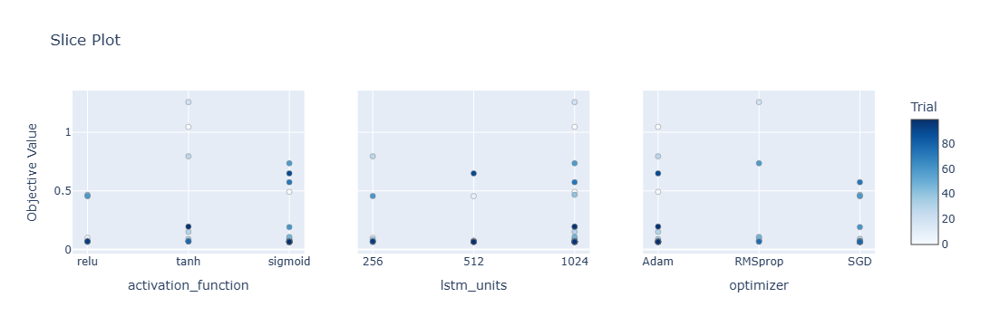

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

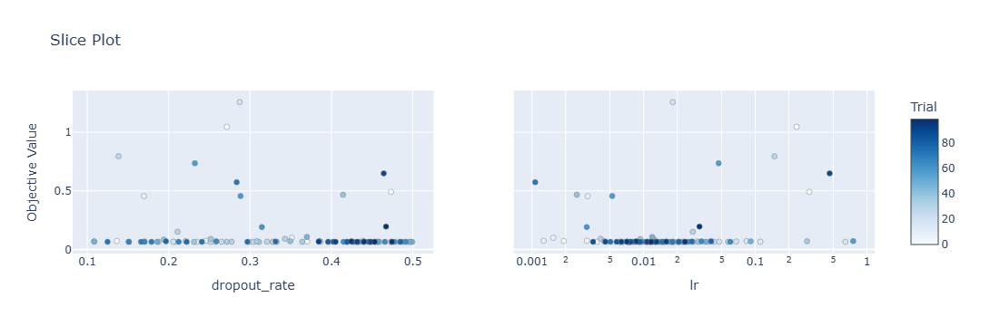

In [9]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

[[ 5.39  4.3   6.51 ... 13.73  8.35  9.05]
 [ 8.03  6.78  8.21 ... 17.14 11.74 12.27]
 [ 5.48  4.27  5.49 ... 13.3   9.17  8.6 ]
 ...
 [ 4.55  3.1   4.22 ... 12.8   7.91  6.65]
 [ 4.44  3.4   5.39 ... 12.34  7.74  6.78]
 [ 4.14  2.75  4.12 ... 10.6   7.07  6.41]]
Epoch 1/100
84/84 [==============================] - 51s 276ms/step - loss: 0.1048 - accuracy: 0.2619 - mae: 0.0826 - rmse: 0.1048 - mape: 18.3954 - pearson: 0.6166 - val_loss: 0.0685 - val_accuracy: 0.7000 - val_mae: 0.0539 - val_rmse: 0.0685 - val_mape: 11.0999 - val_pearson: 0.7658
Epoch 2/100
84/84 [==============================] - 16s 187ms/step - loss: 0.0714 - accuracy: 0.3690 - mae: 0.0565 - rmse: 0.0714 - mape: 12.6618 - pearson: 0.7465 - val_loss: 0.0769 - val_accuracy: 0.7000 - val_mae: 0.0634 - val_rmse: 0.0769 - val_mape: 13.7440 - val_pearson: 0.7333
Epoch 3/100
84/84 [==============================] - 16s 191ms/step - loss: 0.0742 - accuracy: 0.3452 - mae: 0.0588 - rmse: 0.0742 - mape: 13.1940 - pearson: 0.7469

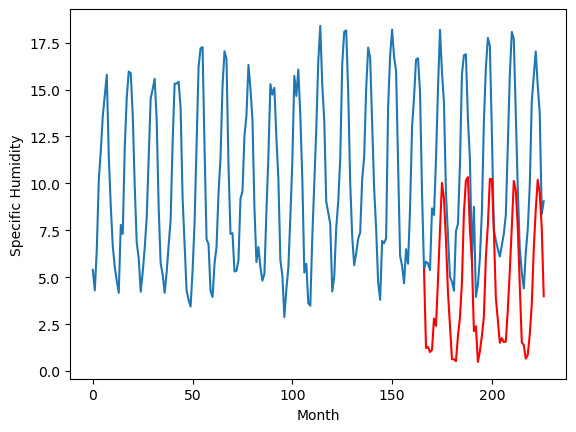

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.86		2.47		3.33
-0.53		2.54		3.07
-0.97		2.27		3.24
-0.24		2.38		2.62
3.64		4.05		0.41
1.85		3.66		1.81
4.17		6.10		1.93
7.85		8.79		0.94
9.51		11.27		1.76
9.45		10.42		0.97
7.35		8.23		0.88
4.79		5.43		0.64
1.46		3.68		2.22
-2.06		1.88		3.94
-1.71		1.88		3.59
-1.00		1.78		2.78
1.21		3.11		1.90
1.43		4.10		2.67
3.92		5.97		2.05
8.67		9.71		1.04
9.47		11.40		1.93
9.63		11.59		1.96
7.47		8.80		1.33
4.39		7.14		2.75
-1.27		3.38		4.65
2.37		3.63		1.26
-2.39		1.74		4.13
-1.17		2.31		3.48
0.74		3.13		2.39
2.04		4.15		2.11
6.28		7.33		1.05
8.89		9.04		0.15
9.79		11.49		1.70
9.22		11.47		2.25
6.16		8.79		2.63
1.02		5.15		4.13
0.82		3.97		3.15
-0.38		2.76		3.14
-0.29		3.01		3.30
1.40		2.79		1.39
1.78		2.82		1.04
2.57		4.54		1.97
4.76		6.60		1.84
8.09		8.93		0.84
9.76		11.38		1.62
10.54		10.86		0.32
6.52		8.88		2.36
1.82		5.79		3.97
-0.36		2.78		3.14
-1.80		2.64		4.44
-2.58		1.91		4.49
-1.36		2.12		3

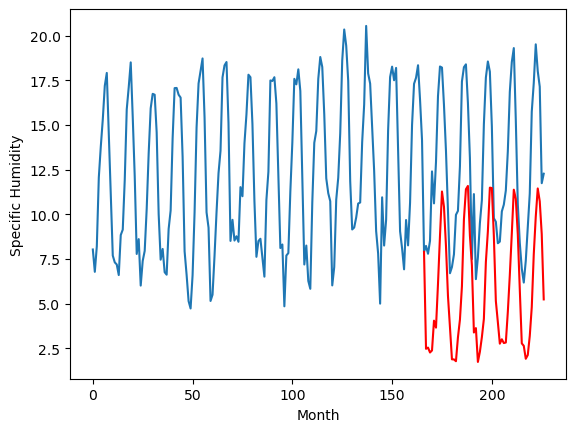

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.23		5.11		2.88
2.48		5.18		2.70
2.31		4.91		2.60
2.86		5.02		2.16
5.46		6.69		1.23
4.21		6.30		2.09
7.07		8.74		1.67
10.98		11.43		0.45
13.38		13.91		0.53
13.47		13.06		-0.41
10.38		10.87		0.49
7.63		8.07		0.44
4.30		6.32		2.02
1.14		4.52		3.38
1.52		4.52		3.00
1.67		4.42		2.75
3.52		5.75		2.23
3.76		6.74		2.98
6.52		8.61		2.09
11.14		12.35		1.21
13.05		14.04		0.99
13.25		14.23		0.98
10.25		11.44		1.19
7.53		9.78		2.25
1.66		6.02		4.36
4.06		6.27		2.21
0.65		4.38		3.73
1.86		4.95		3.09
2.57		5.77		3.20
4.02		6.79		2.77
8.16		9.97		1.81
10.94		11.68		0.74
13.14		14.13		0.99
12.44		14.11		1.67
8.71		11.43		2.72
3.71		7.79		4.08
3.39		6.61		3.22
2.06		5.40		3.34
2.43		5.65		3.22
3.54		5.43		1.89
2.90		5.46		2.56
4.34		7.18		2.84
7.12		9.24		2.12
9.70		11.57		1.87
12.56		14.02		1.46
12.65		13.50		0.85
9.07		11.52		2.45
5.16		8.43		3.27
2.63		5.42		2.79
1.82		5.28		3.46
1.02		4.55		3.53
1.66		4.

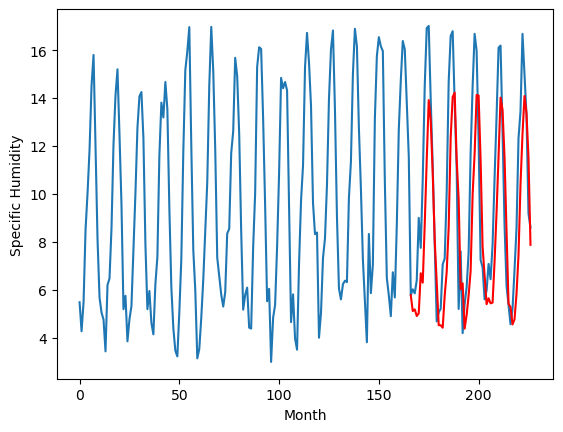

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.48		2.56		3.04
0.06		2.63		2.57
0.30		2.36		2.06
0.44		2.47		2.03
4.75		4.14		-0.61
3.60		3.75		0.15
5.75		6.19		0.44
8.24		8.88		0.64
10.99		11.36		0.37
9.74		10.51		0.77
8.39		8.32		-0.07
4.58		5.52		0.94
1.53		3.77		2.24
-1.54		1.97		3.51
-1.47		1.97		3.44
-1.56		1.87		3.43
1.89		3.20		1.31
2.46		4.19		1.73
5.97		6.06		0.09
9.87		9.80		-0.07
10.71		11.49		0.78
10.33		11.68		1.35
8.02		8.89		0.87
5.59		7.23		1.64
-0.62		3.47		4.09
2.43		3.72		1.29
-2.69		1.83		4.52
-1.48		2.40		3.88
-0.39		3.22		3.61
2.53		4.24		1.71
6.77		7.42		0.65
8.78		9.13		0.35
9.99		11.58		1.59
9.27		11.56		2.29
5.89		8.88		2.99
0.79		5.24		4.45
0.27		4.06		3.79
-0.23		2.85		3.08
-0.04		3.10		3.14
0.63		2.88		2.25
1.71		2.91		1.20
2.11		4.63		2.52
4.96		6.69		1.73
9.11		9.02		-0.09
10.14		11.47		1.33
9.89		10.95		1.06
7.71		8.97		1.26
3.14		5.88		2.74
0.15		2.87		2.72
-1.25		2.73		3.98
-2.17		2.00		4.17
-0.39		2.2

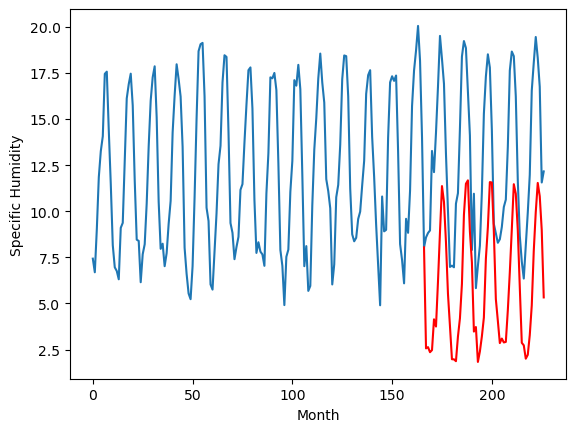

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.29		4.51		0.22
3.04		4.58		1.54
3.83		4.31		0.48
3.22		4.42		1.20
7.67		6.09		-1.58
7.39		5.70		-1.69
9.97		8.14		-1.83
12.33		10.83		-1.50
15.19		13.31		-1.88
12.92		12.46		-0.46
11.61		10.27		-1.34
7.33		7.47		0.14
5.48		5.72		0.24
2.70		3.92		1.22
2.63		3.92		1.29
2.23		3.82		1.59
5.07		5.15		0.08
6.47		6.14		-0.33
10.48		8.01		-2.47
14.17		11.75		-2.42
14.88		13.44		-1.44
14.80		13.63		-1.17
10.57		10.84		0.27
8.48		9.18		0.70
4.26		5.42		1.16
7.02		5.67		-1.35
1.52		3.78		2.26
1.78		4.35		2.57
3.33		5.17		1.84
7.25		6.19		-1.06
10.95		9.37		-1.58
11.92		11.08		-0.84
11.68		13.53		1.85
12.77		13.51		0.74
9.94		10.83		0.89
5.14		7.19		2.05
5.13		6.01		0.88
4.05		4.80		0.75
3.29		5.05		1.76
3.63		4.83		1.20
5.82		4.86		-0.96
6.58		6.58		-0.00
10.52		8.64		-1.88
14.64		10.97		-3.67
13.22		13.42		0.20
11.40		12.90		1.50
11.36		10.92		-0.44
7.61		7.83		0.22
4.81		4.82		0.01
2.95		4.68		1.73


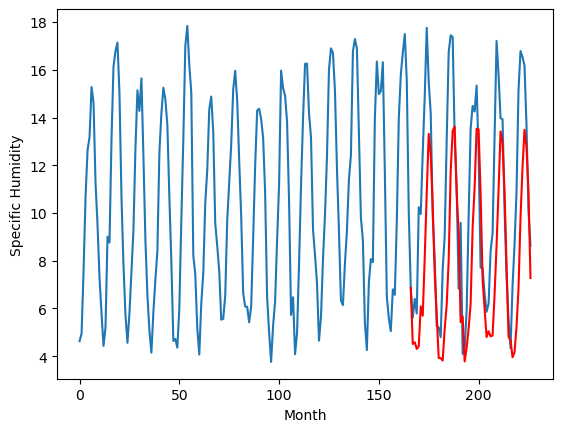

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.81		1.71		2.52
-0.85		1.78		2.63
-1.33		1.51		2.84
-1.44		1.62		3.06
0.32		3.29		2.97
0.66		2.90		2.24
3.79		5.34		1.55
7.52		8.03		0.51
11.00		10.51		-0.49
11.03		9.66		-1.37
8.13		7.47		-0.66
4.43		4.67		0.24
1.48		2.92		1.44
-2.28		1.12		3.40
-2.89		1.12		4.01
-2.30		1.02		3.32
-0.73		2.35		3.08
0.28		3.34		3.06
2.78		5.21		2.43
8.04		8.95		0.91
9.16		10.64		1.48
10.32		10.83		0.51
6.23		8.04		1.81
3.91		6.38		2.47
-1.35		2.62		3.97
0.07		2.87		2.80
-3.04		0.98		4.02
-1.66		1.55		3.21
-0.33		2.37		2.70
0.80		3.39		2.59
5.58		6.57		0.99
6.67		8.28		1.61
11.00		10.73		-0.27
9.21		10.71		1.50
6.51		8.03		1.52
1.87		4.39		2.52
1.21		3.21		2.00
-2.14		2.00		4.14
-1.39		2.25		3.64
-0.46		2.03		2.49
-0.68		2.06		2.74
2.00		3.78		1.78
2.76		5.84		3.08
6.66		8.17		1.51
11.01		10.62		-0.39
10.12		10.10		-0.02
7.00		8.12		1.12
2.60		5.03		2.43
-0.42		2.02		2.44
-1.24		1.88		3.12
-2.03		1.15		3.18


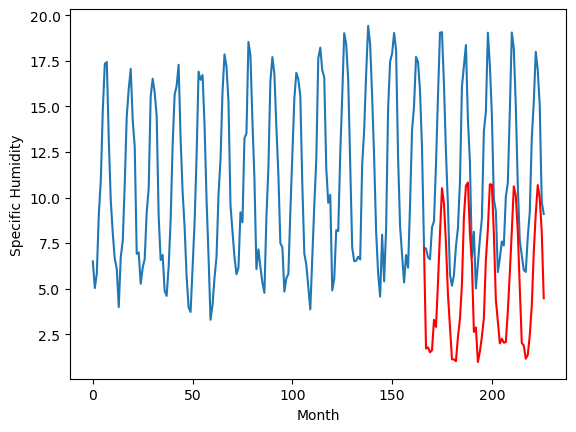

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.38		3.58		2.20
1.50		3.65		2.15
1.42		3.38		1.96
1.78		3.49		1.71
3.41		5.16		1.75
3.19		4.77		1.58
6.29		7.21		0.92
10.01		9.90		-0.11
12.80		12.38		-0.42
12.74		11.53		-1.21
9.21		9.34		0.13
6.49		6.54		0.05
3.64		4.79		1.15
0.77		2.99		2.22
0.62		2.99		2.37
0.67		2.89		2.22
2.26		4.22		1.96
2.86		5.21		2.35
5.86		7.08		1.22
10.24		10.82		0.58
11.68		12.51		0.83
12.21		12.70		0.49
8.89		9.91		1.02
6.78		8.25		1.47
1.03		4.49		3.46
2.87		4.74		1.87
0.09		2.85		2.76
1.37		3.42		2.05
2.38		4.24		1.86
3.38		5.26		1.88
7.74		8.44		0.70
9.62		10.15		0.53
13.24		12.60		-0.64
11.89		12.58		0.69
8.45		9.90		1.45
3.89		6.26		2.37
3.29		5.08		1.79
1.11		3.87		2.76
1.97		4.12		2.15
2.65		3.90		1.25
2.24		3.93		1.69
4.45		5.65		1.20
6.04		7.71		1.67
8.77		10.04		1.27
12.51		12.49		-0.02
12.14		11.97		-0.17
9.20		9.99		0.79
4.94		6.90		1.96
1.61		3.89		2.28
1.54		3.75		2.21
0.87		3.02		2.15
1.03		3.23	

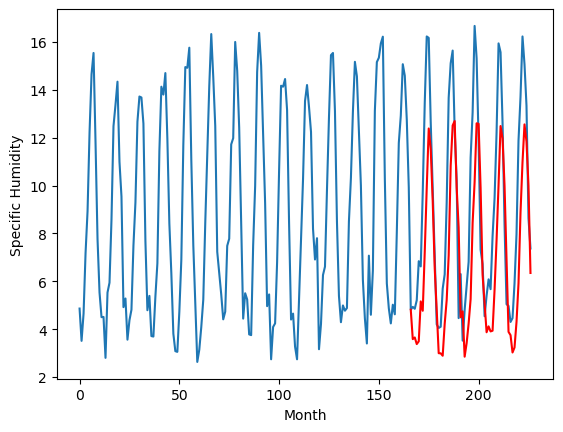

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.05		1.94		1.99
0.20		2.01		1.81
0.23		1.74		1.51
0.45		1.85		1.40
1.75		3.52		1.77
1.69		3.13		1.44
3.68		5.57		1.89
8.35		8.26		-0.09
11.16		10.74		-0.42
11.40		9.89		-1.51
7.50		7.70		0.20
4.79		4.90		0.11
2.25		3.15		0.90
-0.62		1.35		1.97
-0.93		1.35		2.28
-0.90		1.25		2.15
0.72		2.58		1.86
1.42		3.57		2.15
4.44		5.44		1.00
8.71		9.18		0.47
10.21		10.87		0.66
10.49		11.06		0.57
7.00		8.27		1.27
5.12		6.61		1.49
-0.67		2.85		3.52
1.10		3.10		2.00
-1.41		1.21		2.62
-0.18		1.78		1.96
0.81		2.60		1.79
1.71		3.62		1.91
6.00		6.80		0.80
7.45		8.51		1.06
10.82		10.96		0.14
9.75		10.94		1.19
6.96		8.26		1.30
2.54		4.62		2.08
1.84		3.44		1.60
-0.50		2.23		2.73
0.43		2.48		2.05
0.79		2.26		1.47
0.71		2.29		1.58
2.99		4.01		1.02
4.31		6.07		1.76
6.93		8.40		1.47
11.28		10.85		-0.43
10.22		10.33		0.11
7.42		8.35		0.93
3.67		5.26		1.59
0.15		2.25		2.10
0.35		2.11		1.76
-0.34		1.38		1.72
-0.31		1.59

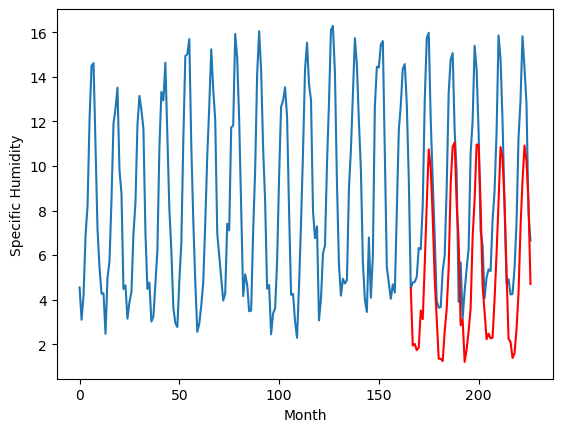

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.27		1.63		0.36
1.36		1.70		0.34
0.96		1.43		0.47
0.95		1.54		0.59
3.21		3.21		-0.00
3.45		2.82		-0.63
6.67		5.26		-1.41
10.32		7.95		-2.37
13.41		10.43		-2.98
11.38		9.58		-1.80
8.66		7.39		-1.27
4.21		4.59		0.38
2.45		2.84		0.39
0.54		1.04		0.50
0.31		1.04		0.73
-0.37		0.94		1.31
2.69		2.27		-0.42
3.42		3.26		-0.16
6.33		5.13		-1.20
11.31		8.87		-2.44
12.81		10.56		-2.25
13.00		10.75		-2.25
9.19		7.96		-1.23
6.77		6.30		-0.47
1.48		2.54		1.06
3.07		2.79		-0.28
-0.21		0.90		1.11
0.38		1.47		1.09
2.06		2.29		0.23
3.64		3.31		-0.33
7.83		6.49		-1.34
10.01		8.20		-1.81
13.67		10.65		-3.02
12.70		10.63		-2.07
8.25		7.95		-0.30
3.02		4.31		1.29
2.02		3.13		1.11
1.09		1.92		0.83
1.69		2.17		0.48
1.76		1.95		0.19
2.20		1.98		-0.22
3.42		3.70		0.28
6.91		5.76		-1.15
9.19		8.09		-1.10
12.74		10.54		-2.20
12.74		10.02		-2.72
8.67		8.04		-0.63
4.61		4.95		0.34
1.95		1.94		-0.01
1.34		1.80		0.46
0.16		

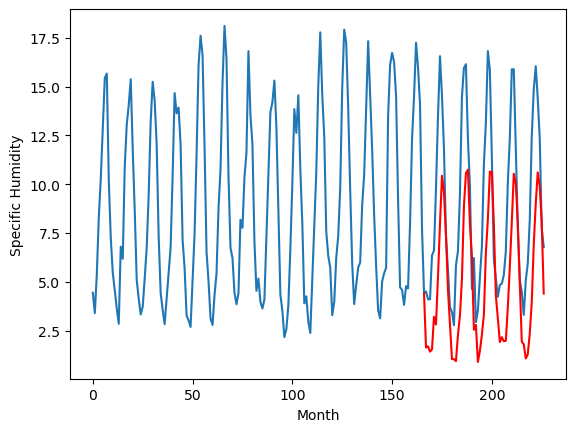

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.78		1.52		0.74
1.19		1.59		0.40
0.69		1.32		0.63
0.37		1.43		1.06
2.33		3.10		0.77
2.39		2.71		0.32
5.53		5.15		-0.38
8.22		7.84		-0.38
11.36		10.32		-1.04
10.14		9.47		-0.67
7.35		7.28		-0.07
4.01		4.48		0.47
1.96		2.73		0.77
0.30		0.93		0.63
-0.03		0.93		0.96
-0.48		0.83		1.31
1.32		2.16		0.84
2.64		3.15		0.51
4.73		5.02		0.29
9.50		8.76		-0.74
10.43		10.45		0.02
10.85		10.64		-0.21
7.68		7.85		0.17
6.37		6.19		-0.18
0.85		2.43		1.58
1.69		2.68		0.99
-0.60		0.79		1.39
0.14		1.36		1.22
1.42		2.18		0.76
3.04		3.20		0.16
7.65		6.38		-1.27
9.33		8.09		-1.24
12.91		10.54		-2.37
11.37		10.52		-0.85
8.31		7.84		-0.47
2.52		4.20		1.68
1.80		3.02		1.22
0.87		1.81		0.94
1.48		2.06		0.58
1.25		1.84		0.59
1.35		1.87		0.52
3.08		3.59		0.51
5.52		5.65		0.13
8.14		7.98		-0.16
11.96		10.43		-1.53
10.66		9.91		-0.75
7.94		7.93		-0.01
4.70		4.84		0.14
1.35		1.83		0.48
1.54		1.69		0.15
0.57		0.96		0.39
0.9

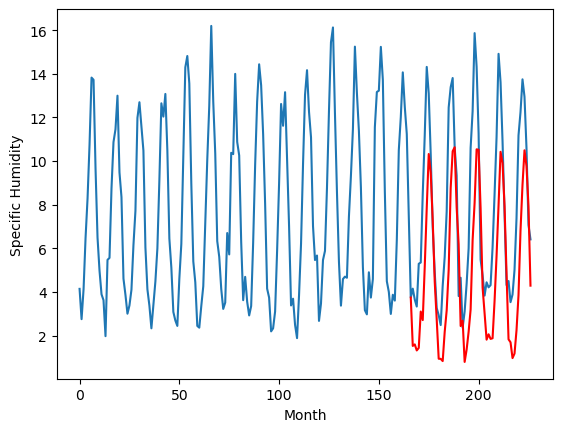

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.49		1.22		0.73
0.61		1.29		0.68
0.23		1.02		0.79
-0.28		1.13		1.41
1.32		2.80		1.48
1.68		2.41		0.73
4.58		4.85		0.27
7.68		7.54		-0.14
10.73		10.02		-0.71
9.16		9.17		0.01
6.50		6.98		0.48
3.05		4.18		1.13
1.64		2.43		0.79
0.11		0.63		0.52
-0.27		0.63		0.90
-1.01		0.53		1.54
0.61		1.86		1.25
2.21		2.85		0.64
3.73		4.72		0.99
8.86		8.46		-0.40
9.93		10.15		0.22
10.42		10.34		-0.08
6.80		7.55		0.75
5.81		5.89		0.08
0.96		2.13		1.17
0.96		2.38		1.42
-1.11		0.49		1.60
-0.51		1.06		1.57
0.74		1.88		1.14
1.68		2.90		1.22
5.40		6.08		0.68
6.67		7.79		1.12
9.16		10.24		1.08
10.15		10.22		0.07
7.55		7.54		-0.01
2.53		3.90		1.37
1.39		2.72		1.33
0.22		1.51		1.29
0.62		1.76		1.14
0.06		1.54		1.48
0.52		1.57		1.05
2.16		3.29		1.13
3.37		5.35		1.98
6.38		7.68		1.30
10.21		10.13		-0.08
9.46		9.61		0.15
8.15		7.63		-0.52
4.39		4.54		0.15
0.98		1.53		0.55
1.51		1.39		-0.12
-0.01		0.66		0.67
0.52		0.87		0

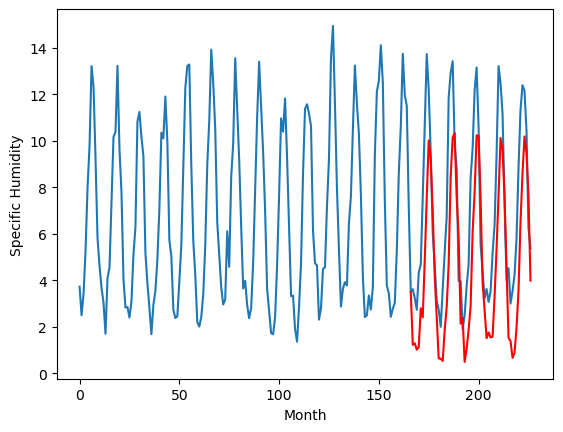

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.03   1.222616
1                 1   -0.86   2.472616
2                 2    2.23   5.112616
3                 3   -0.48   2.562616
4                 4    4.29   4.512616
5                 5   -0.81   1.712616
6                 6    1.38   3.582616
7                 7   -0.05   1.942616
8                 8    1.27   1.632616
9                 9    0.78   1.522616
10               10    0.49   1.222616


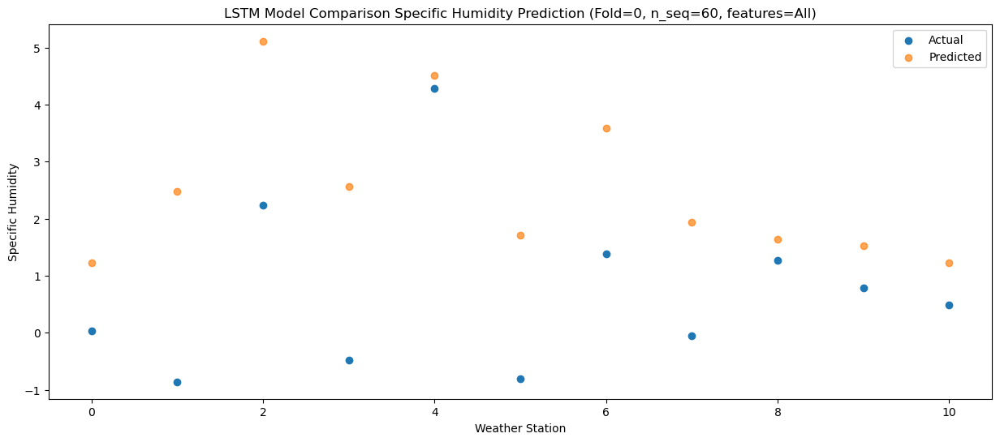

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.46   1.291682
1                 1   -0.53   2.541682
2                 2    2.48   5.181682
3                 3    0.06   2.631682
4                 4    3.04   4.581682
5                 5   -0.85   1.781682
6                 6    1.50   3.651682
7                 7    0.20   2.011682
8                 8    1.36   1.701682
9                 9    1.19   1.591682
10               10    0.61   1.291682


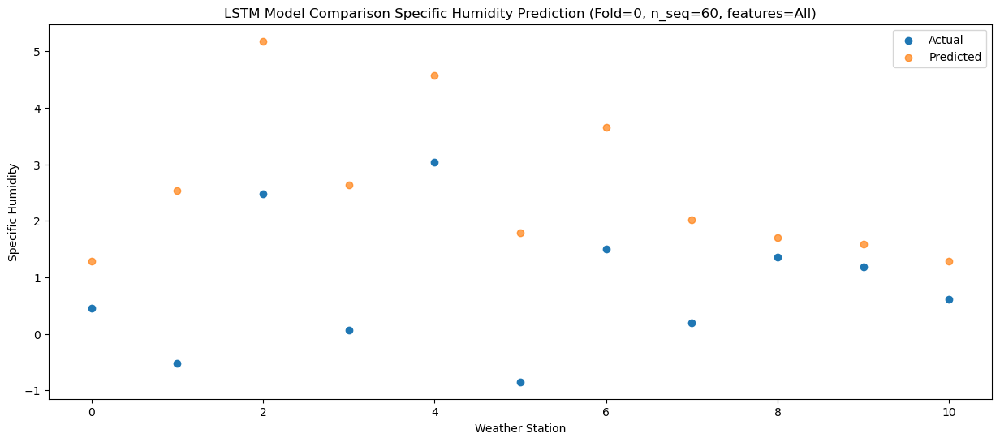

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.37   1.015642
1                 1   -0.97   2.265642
2                 2    2.31   4.905642
3                 3    0.30   2.355642
4                 4    3.83   4.305642
5                 5   -1.33   1.505642
6                 6    1.42   3.375642
7                 7    0.23   1.735642
8                 8    0.96   1.425642
9                 9    0.69   1.315642
10               10    0.23   1.015642


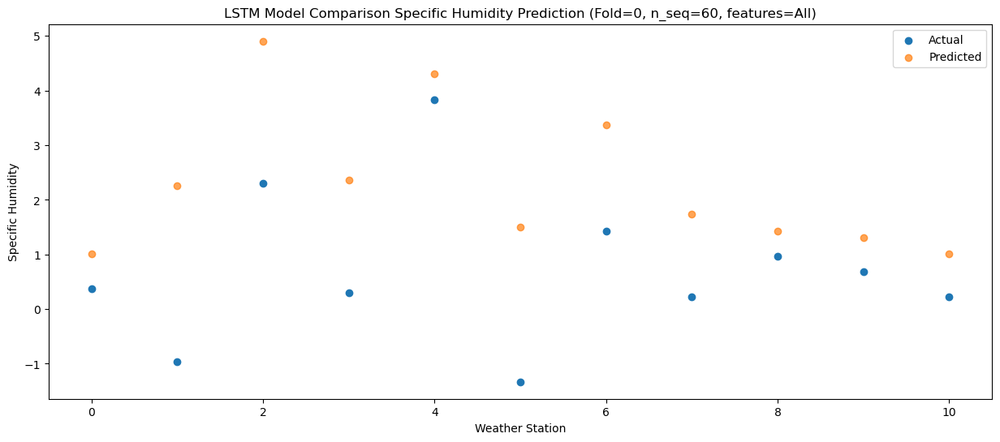

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.01   1.130624
1                 1   -0.24   2.380624
2                 2    2.86   5.020624
3                 3    0.44   2.470624
4                 4    3.22   4.420624
5                 5   -1.44   1.620624
6                 6    1.78   3.490624
7                 7    0.45   1.850624
8                 8    0.95   1.540624
9                 9    0.37   1.430624
10               10   -0.28   1.130624


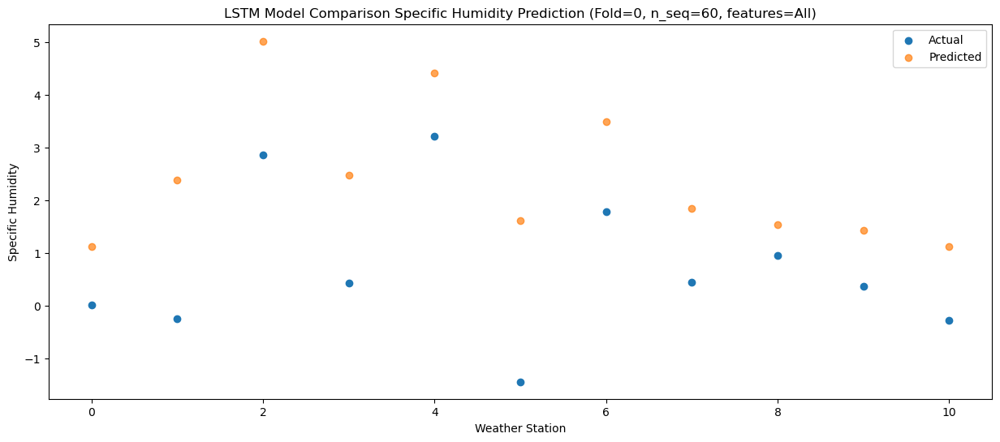

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.30   2.798826
1                 1    3.64   4.048826
2                 2    5.46   6.688826
3                 3    4.75   4.138826
4                 4    7.67   6.088826
5                 5    0.32   3.288826
6                 6    3.41   5.158826
7                 7    1.75   3.518826
8                 8    3.21   3.208826
9                 9    2.33   3.098826
10               10    1.32   2.798826


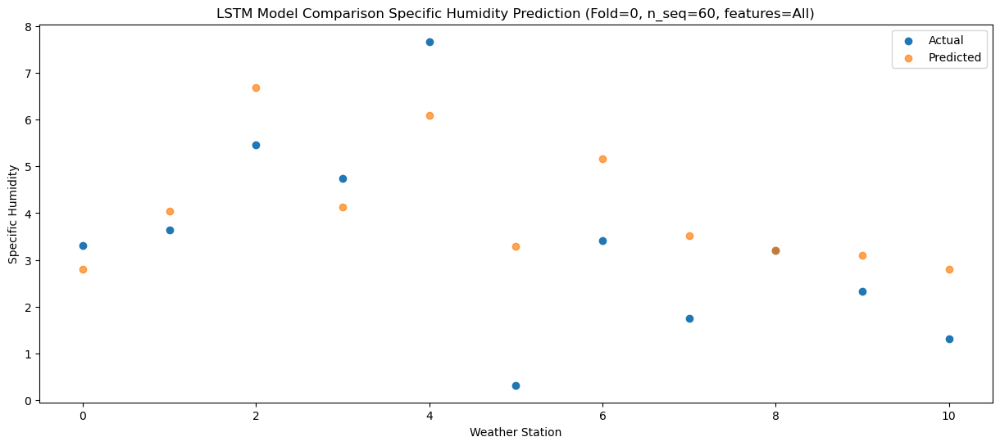

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    2.95   2.408209
1                 1    1.85   3.658209
2                 2    4.21   6.298209
3                 3    3.60   3.748209
4                 4    7.39   5.698209
5                 5    0.66   2.898209
6                 6    3.19   4.768209
7                 7    1.69   3.128209
8                 8    3.45   2.818209
9                 9    2.39   2.708209
10               10    1.68   2.408209


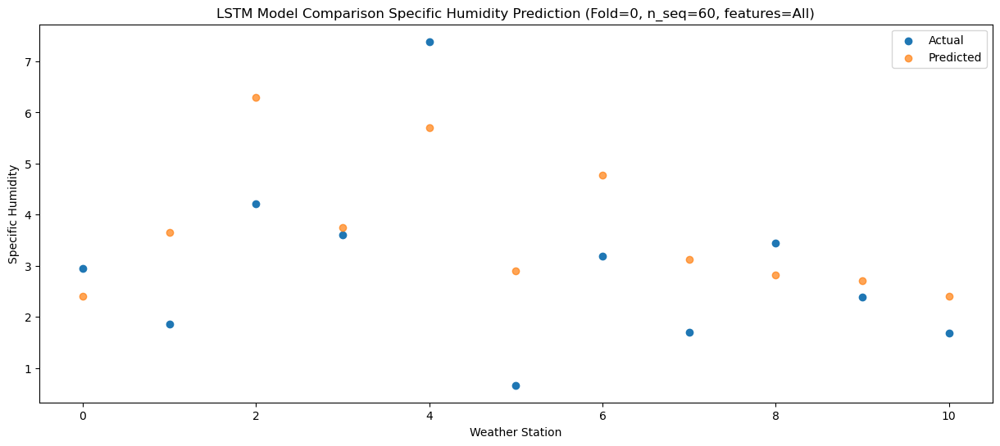

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    5.92   4.853097
1                 1    4.17   6.103097
2                 2    7.07   8.743097
3                 3    5.75   6.193097
4                 4    9.97   8.143097
5                 5    3.79   5.343097
6                 6    6.29   7.213097
7                 7    3.68   5.573097
8                 8    6.67   5.263097
9                 9    5.53   5.153097
10               10    4.58   4.853097


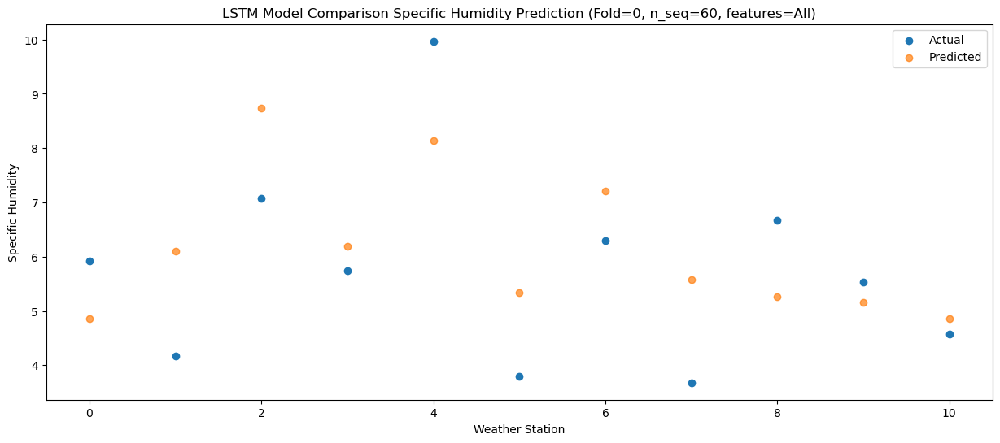

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.68    7.53766
1                 1    7.85    8.78766
2                 2   10.98   11.42766
3                 3    8.24    8.87766
4                 4   12.33   10.82766
5                 5    7.52    8.02766
6                 6   10.01    9.89766
7                 7    8.35    8.25766
8                 8   10.32    7.94766
9                 9    8.22    7.83766
10               10    7.68    7.53766


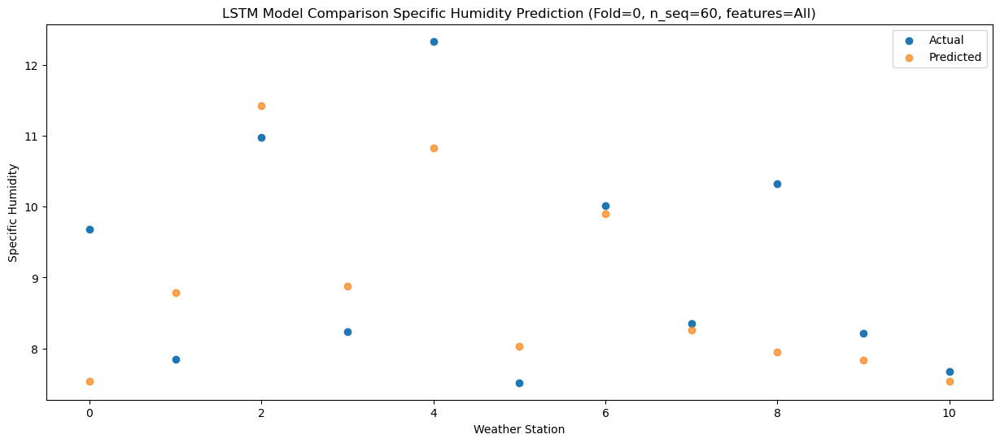

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   12.81   10.02422
1                 1    9.51   11.27422
2                 2   13.38   13.91422
3                 3   10.99   11.36422
4                 4   15.19   13.31422
5                 5   11.00   10.51422
6                 6   12.80   12.38422
7                 7   11.16   10.74422
8                 8   13.41   10.43422
9                 9   11.36   10.32422
10               10   10.73   10.02422


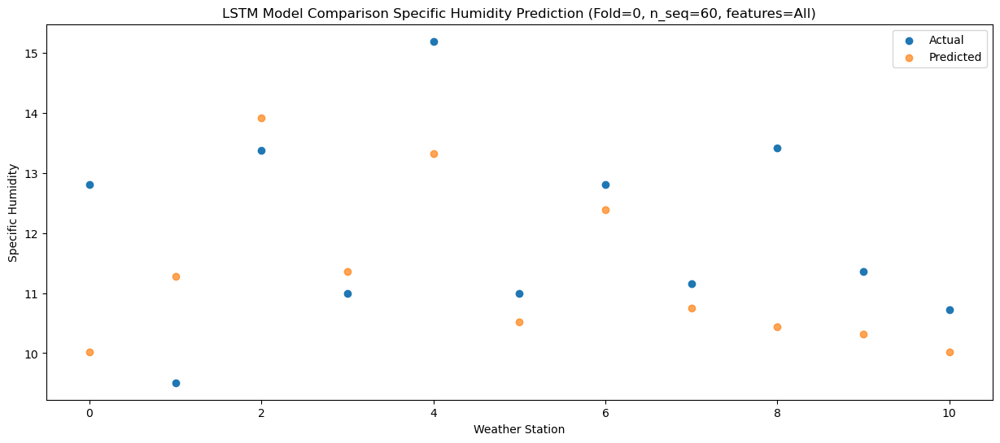

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.56   9.166611
1                 1    9.45  10.416611
2                 2   13.47  13.056611
3                 3    9.74  10.506611
4                 4   12.92  12.456611
5                 5   11.03   9.656611
6                 6   12.74  11.526611
7                 7   11.40   9.886611
8                 8   11.38   9.576611
9                 9   10.14   9.466611
10               10    9.16   9.166611


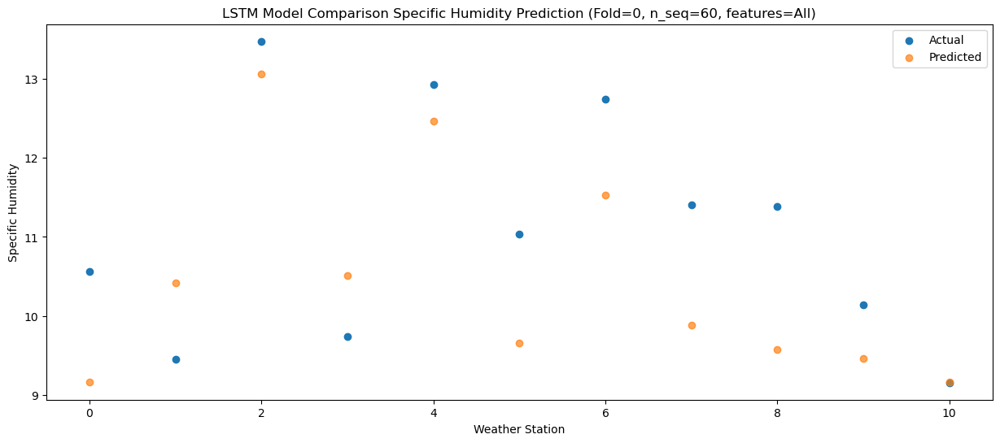

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.92    6.97686
1                 1    7.35    8.22686
2                 2   10.38   10.86686
3                 3    8.39    8.31686
4                 4   11.61   10.26686
5                 5    8.13    7.46686
6                 6    9.21    9.33686
7                 7    7.50    7.69686
8                 8    8.66    7.38686
9                 9    7.35    7.27686
10               10    6.50    6.97686


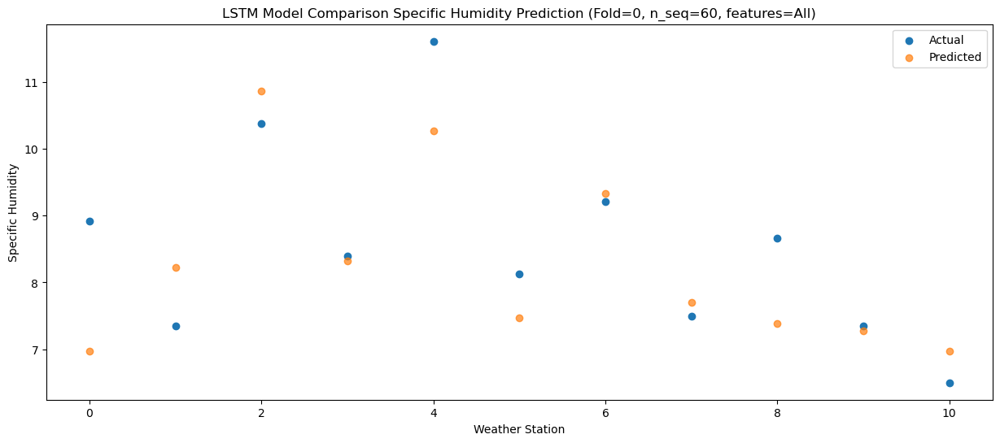

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.11   4.184416
1                 1    4.79   5.434416
2                 2    7.63   8.074416
3                 3    4.58   5.524416
4                 4    7.33   7.474416
5                 5    4.43   4.674416
6                 6    6.49   6.544416
7                 7    4.79   4.904416
8                 8    4.21   4.594416
9                 9    4.01   4.484416
10               10    3.05   4.184416


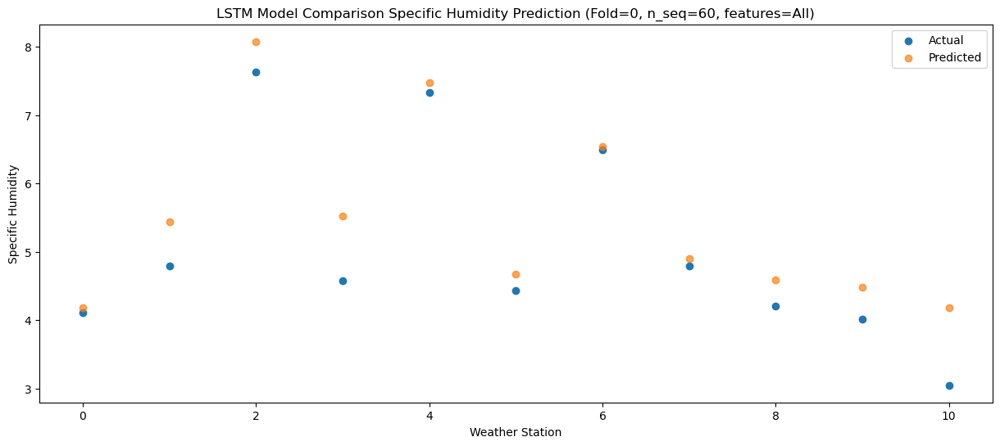

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.87    2.43317
1                 1    1.46    3.68317
2                 2    4.30    6.32317
3                 3    1.53    3.77317
4                 4    5.48    5.72317
5                 5    1.48    2.92317
6                 6    3.64    4.79317
7                 7    2.25    3.15317
8                 8    2.45    2.84317
9                 9    1.96    2.73317
10               10    1.64    2.43317


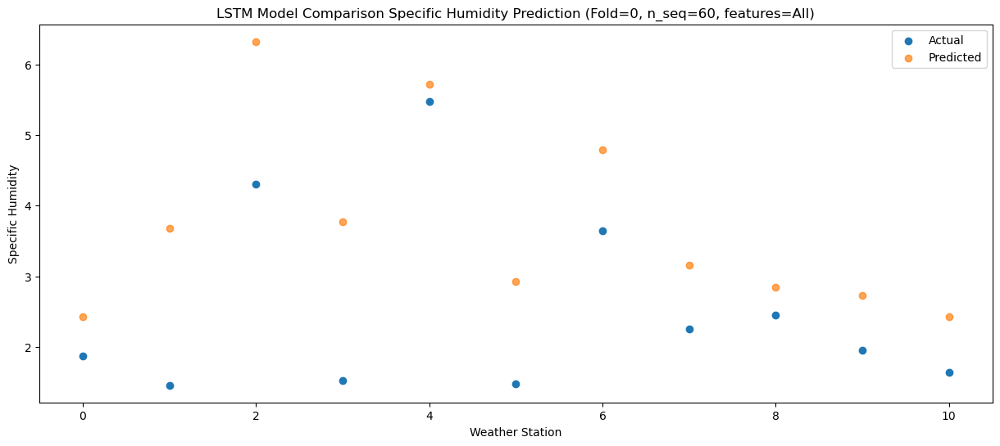

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.36   0.634191
1                 1   -2.06   1.884191
2                 2    1.14   4.524191
3                 3   -1.54   1.974191
4                 4    2.70   3.924191
5                 5   -2.28   1.124191
6                 6    0.77   2.994191
7                 7   -0.62   1.354191
8                 8    0.54   1.044191
9                 9    0.30   0.934191
10               10    0.11   0.634191


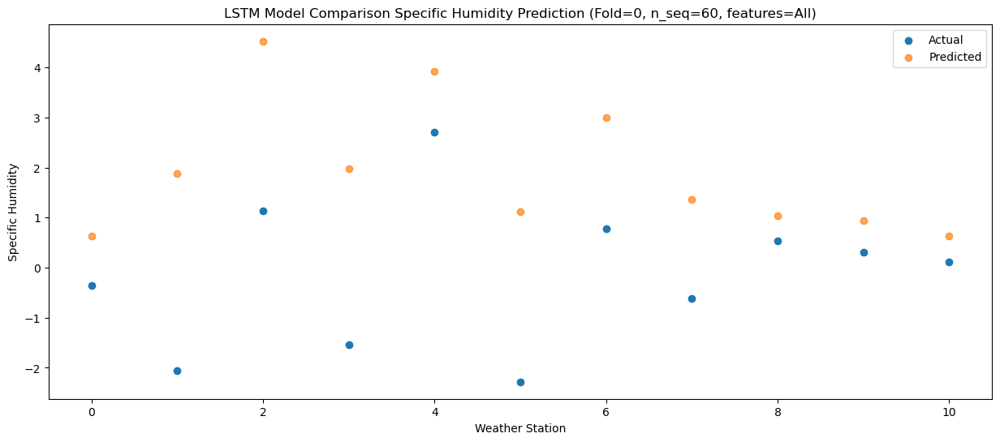

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.60   0.629374
1                 1   -1.71   1.879374
2                 2    1.52   4.519374
3                 3   -1.47   1.969374
4                 4    2.63   3.919374
5                 5   -2.89   1.119374
6                 6    0.62   2.989374
7                 7   -0.93   1.349374
8                 8    0.31   1.039374
9                 9   -0.03   0.929374
10               10   -0.27   0.629374


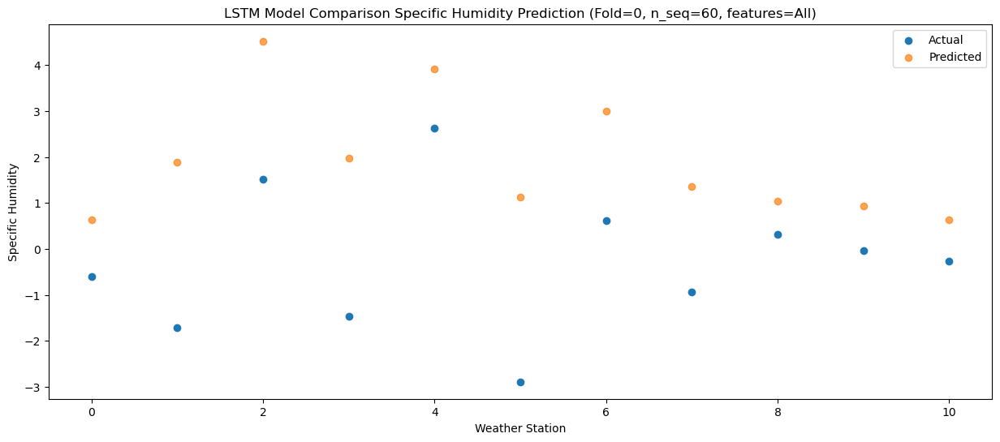

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.09   0.528076
1                 1   -1.00   1.778076
2                 2    1.67   4.418076
3                 3   -1.56   1.868076
4                 4    2.23   3.818076
5                 5   -2.30   1.018076
6                 6    0.67   2.888076
7                 7   -0.90   1.248076
8                 8   -0.37   0.938076
9                 9   -0.48   0.828076
10               10   -1.01   0.528076


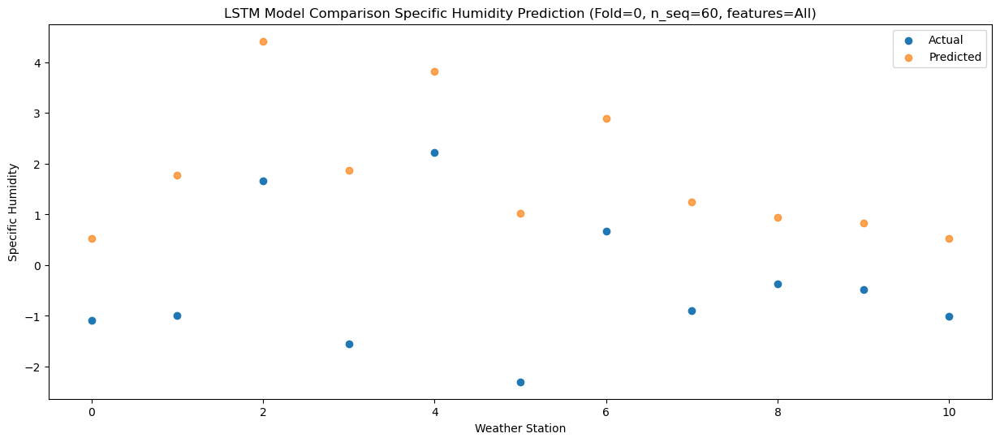

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.08    1.86145
1                 1    1.21    3.11145
2                 2    3.52    5.75145
3                 3    1.89    3.20145
4                 4    5.07    5.15145
5                 5   -0.73    2.35145
6                 6    2.26    4.22145
7                 7    0.72    2.58145
8                 8    2.69    2.27145
9                 9    1.32    2.16145
10               10    0.61    1.86145


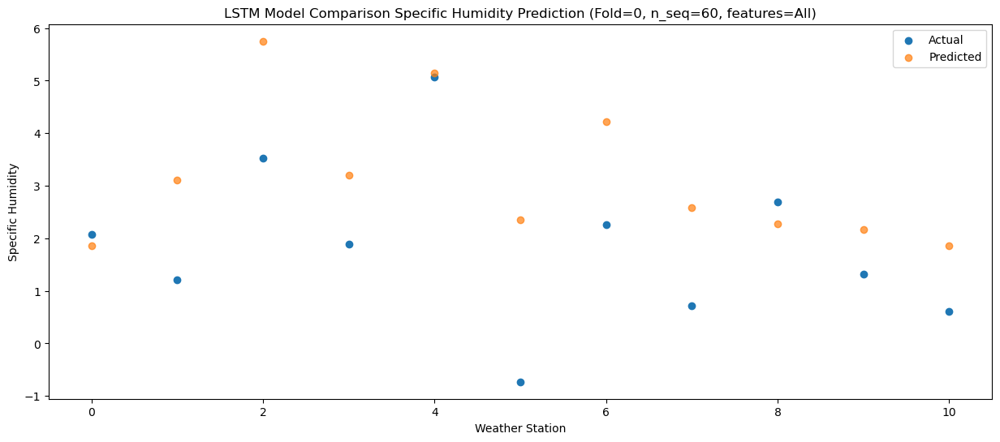

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.47   2.852977
1                 1    1.43   4.102977
2                 2    3.76   6.742977
3                 3    2.46   4.192977
4                 4    6.47   6.142977
5                 5    0.28   3.342977
6                 6    2.86   5.212977
7                 7    1.42   3.572977
8                 8    3.42   3.262977
9                 9    2.64   3.152977
10               10    2.21   2.852977


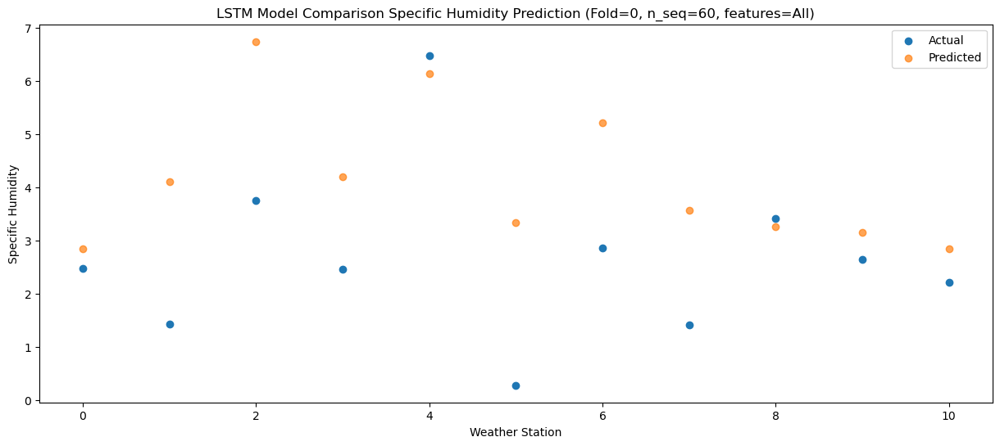

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.62   4.720073
1                 1    3.92   5.970073
2                 2    6.52   8.610073
3                 3    5.97   6.060073
4                 4   10.48   8.010073
5                 5    2.78   5.210073
6                 6    5.86   7.080073
7                 7    4.44   5.440073
8                 8    6.33   5.130073
9                 9    4.73   5.020073
10               10    3.73   4.720073


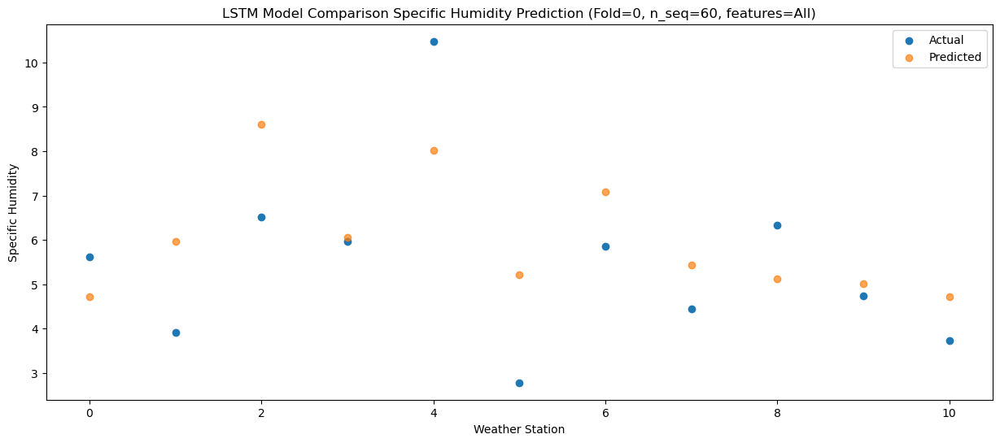

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   10.43   8.463386
1                 1    8.67   9.713386
2                 2   11.14  12.353386
3                 3    9.87   9.803386
4                 4   14.17  11.753386
5                 5    8.04   8.953386
6                 6   10.24  10.823386
7                 7    8.71   9.183386
8                 8   11.31   8.873386
9                 9    9.50   8.763386
10               10    8.86   8.463386


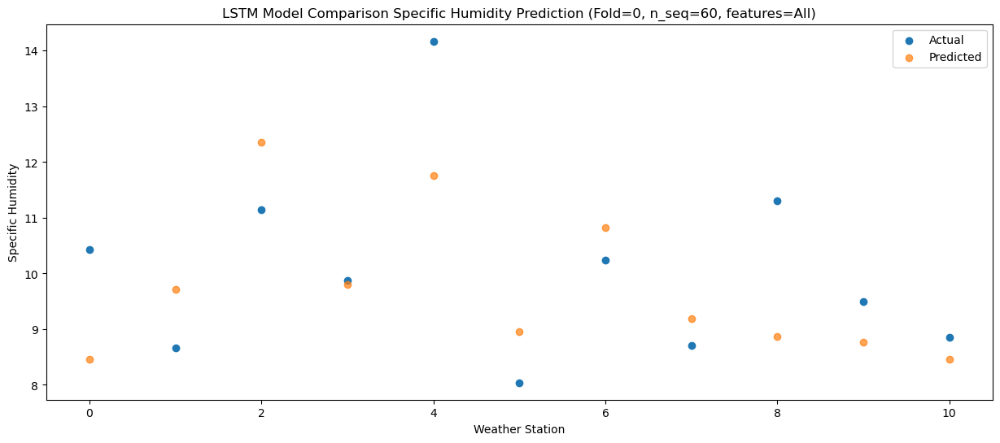

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   11.46  10.150665
1                 1    9.47  11.400665
2                 2   13.05  14.040665
3                 3   10.71  11.490665
4                 4   14.88  13.440665
5                 5    9.16  10.640665
6                 6   11.68  12.510665
7                 7   10.21  10.870665
8                 8   12.81  10.560665
9                 9   10.43  10.450665
10               10    9.93  10.150665


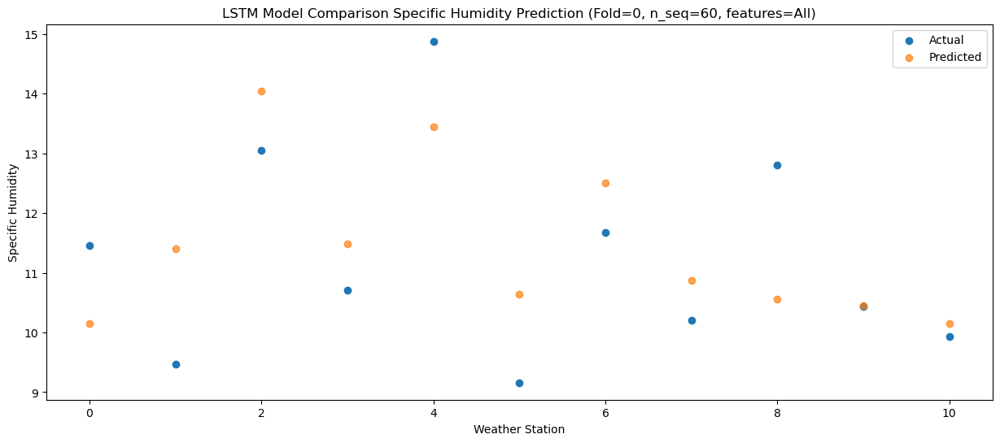

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   11.51  10.335936
1                 1    9.63  11.585936
2                 2   13.25  14.225936
3                 3   10.33  11.675936
4                 4   14.80  13.625936
5                 5   10.32  10.825936
6                 6   12.21  12.695936
7                 7   10.49  11.055936
8                 8   13.00  10.745936
9                 9   10.85  10.635936
10               10   10.42  10.335936


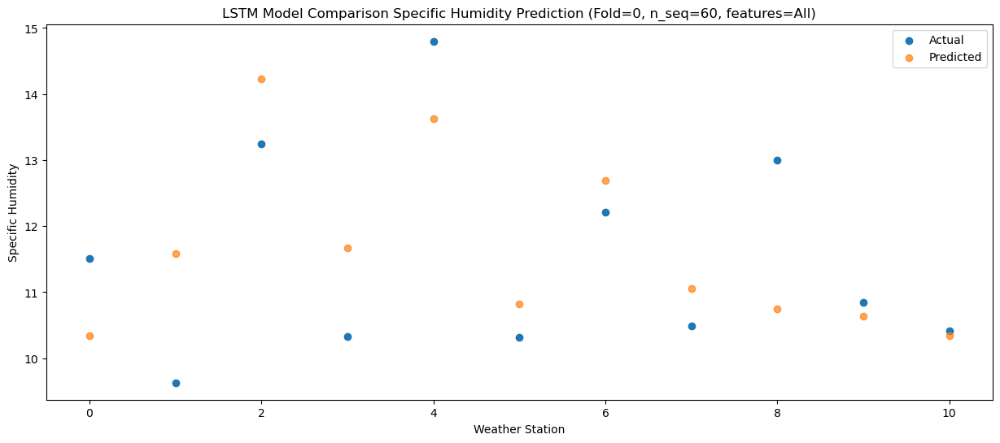

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.09   7.554679
1                 1    7.47   8.804679
2                 2   10.25  11.444679
3                 3    8.02   8.894679
4                 4   10.57  10.844679
5                 5    6.23   8.044679
6                 6    8.89   9.914679
7                 7    7.00   8.274679
8                 8    9.19   7.964679
9                 9    7.68   7.854679
10               10    6.80   7.554679


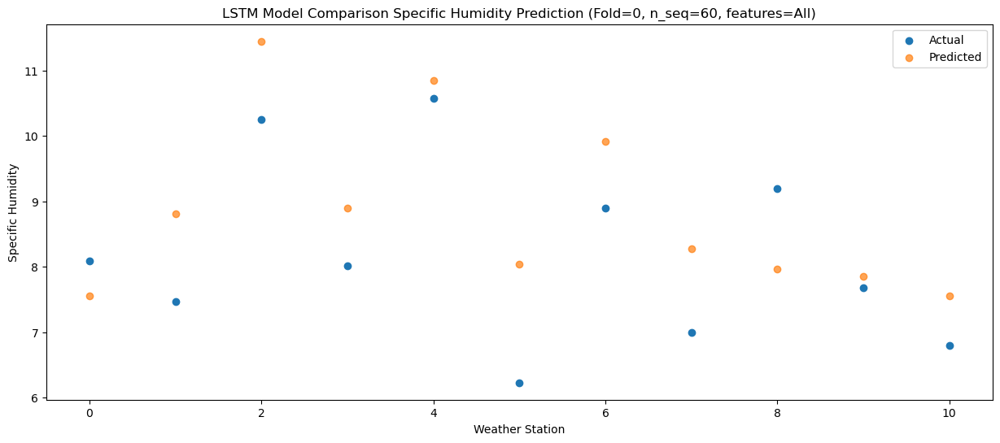

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.91   5.887847
1                 1    4.39   7.137847
2                 2    7.53   9.777847
3                 3    5.59   7.227847
4                 4    8.48   9.177847
5                 5    3.91   6.377847
6                 6    6.78   8.247847
7                 7    5.12   6.607847
8                 8    6.77   6.297847
9                 9    6.37   6.187847
10               10    5.81   5.887847


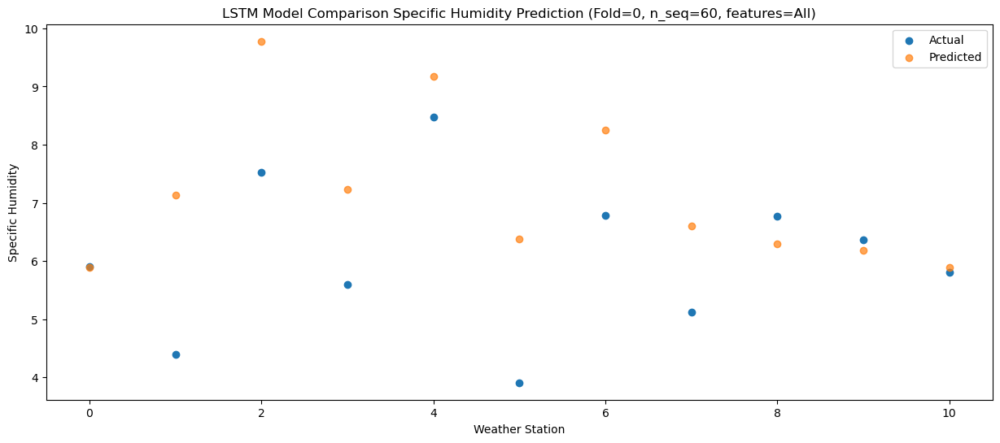

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.61   2.132814
1                 1   -1.27   3.382814
2                 2    1.66   6.022814
3                 3   -0.62   3.472814
4                 4    4.26   5.422814
5                 5   -1.35   2.622814
6                 6    1.03   4.492814
7                 7   -0.67   2.852814
8                 8    1.48   2.542814
9                 9    0.85   2.432814
10               10    0.96   2.132814


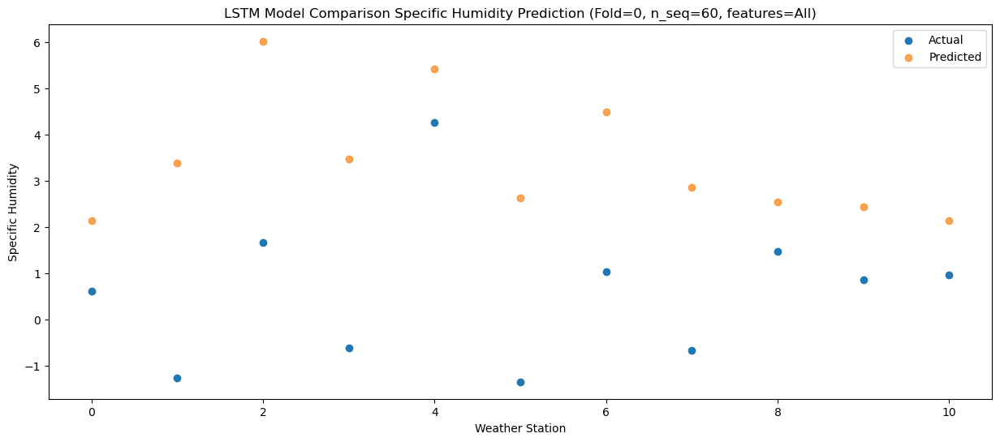

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    3.39   2.382415
1                 1    2.37   3.632415
2                 2    4.06   6.272415
3                 3    2.43   3.722415
4                 4    7.02   5.672415
5                 5    0.07   2.872415
6                 6    2.87   4.742415
7                 7    1.10   3.102415
8                 8    3.07   2.792415
9                 9    1.69   2.682415
10               10    0.96   2.382415


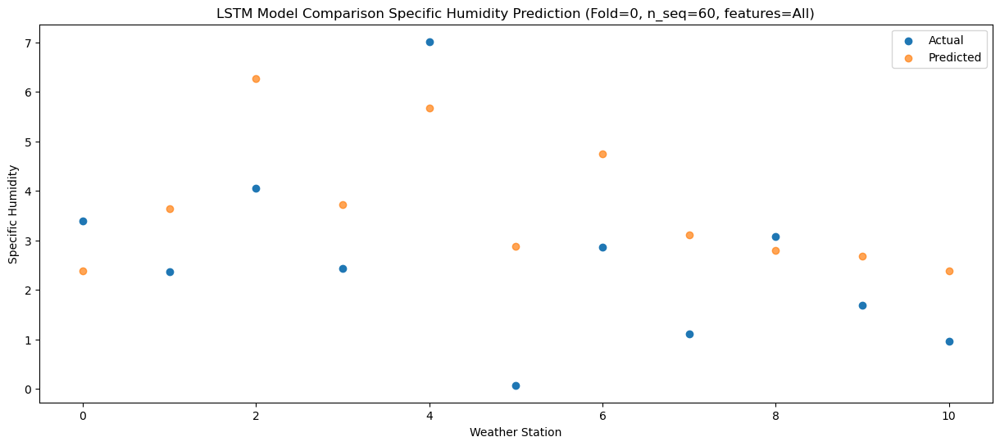

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.42   0.488661
1                 1   -2.39   1.738661
2                 2    0.65   4.378661
3                 3   -2.69   1.828661
4                 4    1.52   3.778661
5                 5   -3.04   0.978661
6                 6    0.09   2.848661
7                 7   -1.41   1.208661
8                 8   -0.21   0.898661
9                 9   -0.60   0.788661
10               10   -1.11   0.488661


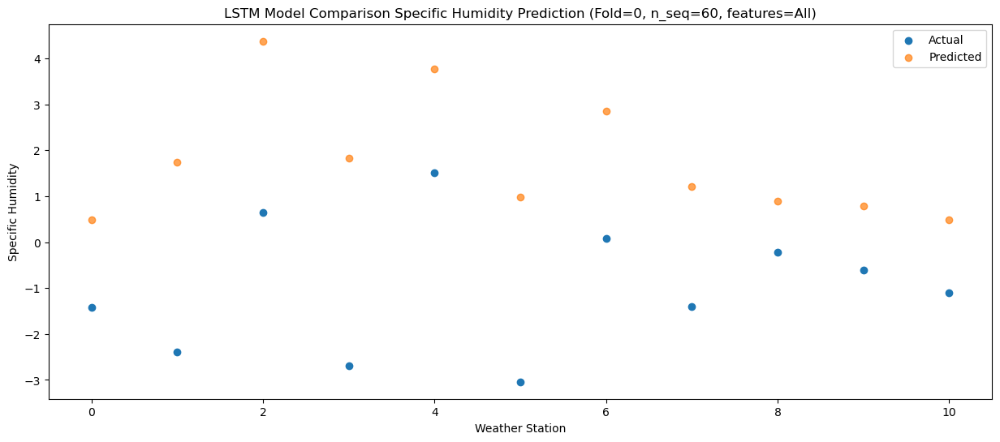

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.76   1.056298
1                 1   -1.17   2.306298
2                 2    1.86   4.946298
3                 3   -1.48   2.396298
4                 4    1.78   4.346298
5                 5   -1.66   1.546298
6                 6    1.37   3.416298
7                 7   -0.18   1.776298
8                 8    0.38   1.466298
9                 9    0.14   1.356298
10               10   -0.51   1.056298


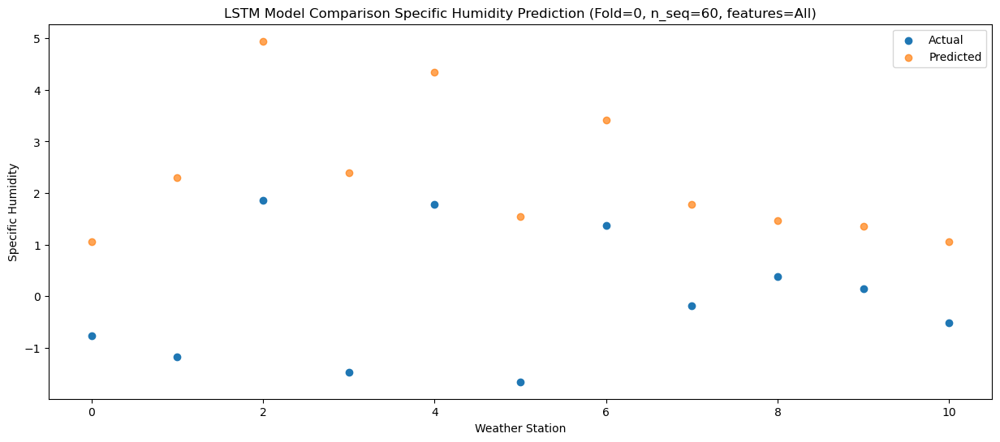

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.64   1.876465
1                 1    0.74   3.126465
2                 2    2.57   5.766465
3                 3   -0.39   3.216465
4                 4    3.33   5.166465
5                 5   -0.33   2.366465
6                 6    2.38   4.236465
7                 7    0.81   2.596465
8                 8    2.06   2.286465
9                 9    1.42   2.176465
10               10    0.74   1.876465


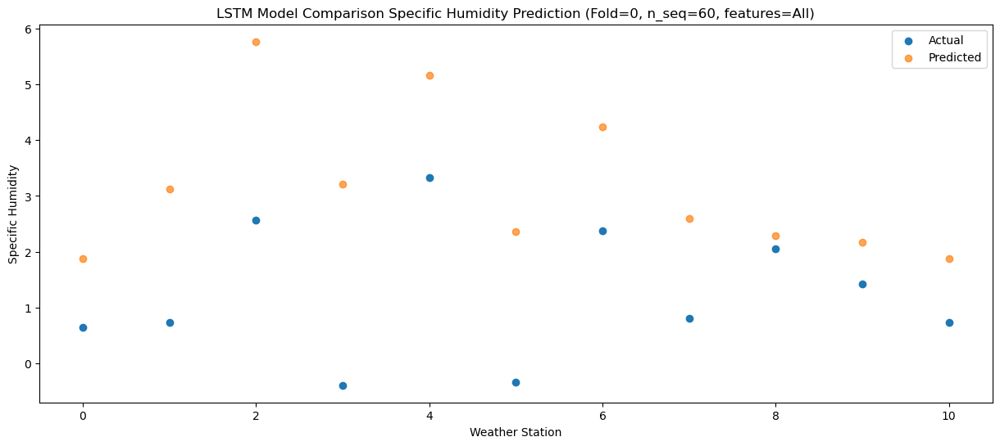

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.11   2.896169
1                 1    2.04   4.146169
2                 2    4.02   6.786169
3                 3    2.53   4.236169
4                 4    7.25   6.186169
5                 5    0.80   3.386169
6                 6    3.38   5.256169
7                 7    1.71   3.616169
8                 8    3.64   3.306169
9                 9    3.04   3.196169
10               10    1.68   2.896169


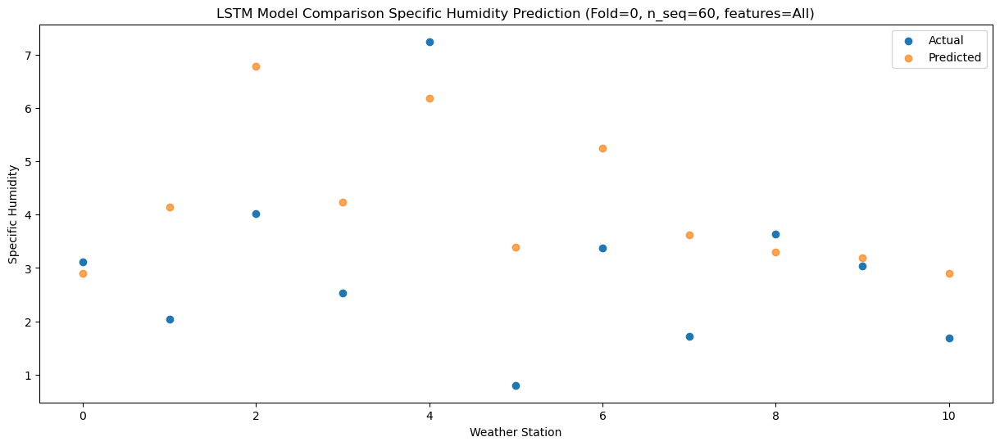

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.88   6.078408
1                 1    6.28   7.328408
2                 2    8.16   9.968408
3                 3    6.77   7.418408
4                 4   10.95   9.368408
5                 5    5.58   6.568408
6                 6    7.74   8.438408
7                 7    6.00   6.798408
8                 8    7.83   6.488408
9                 9    7.65   6.378408
10               10    5.40   6.078408


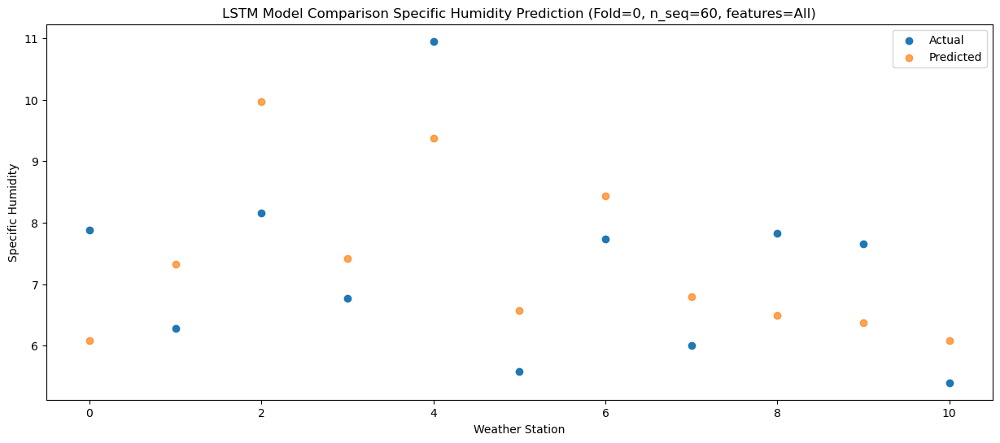

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   10.80   7.792665
1                 1    8.89   9.042665
2                 2   10.94  11.682665
3                 3    8.78   9.132665
4                 4   11.92  11.082665
5                 5    6.67   8.282665
6                 6    9.62  10.152665
7                 7    7.45   8.512665
8                 8   10.01   8.202665
9                 9    9.33   8.092665
10               10    6.67   7.792665


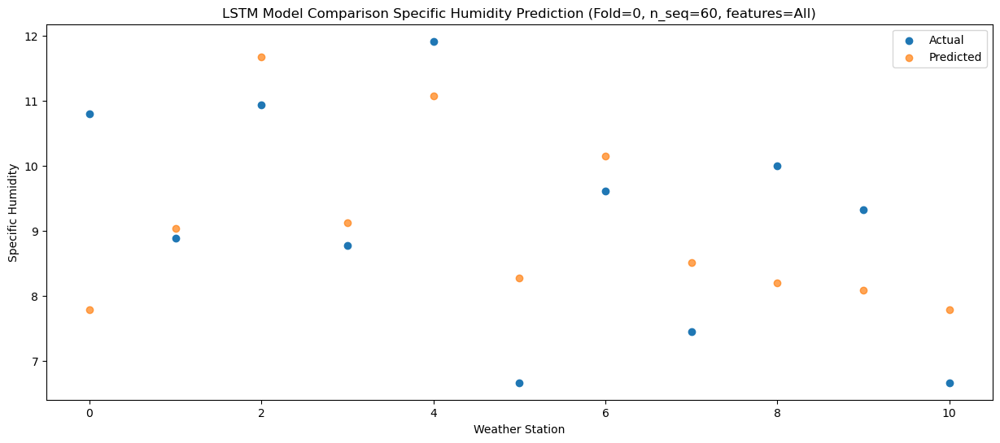

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.38  10.241073
1                 1    9.79  11.491073
2                 2   13.14  14.131073
3                 3    9.99  11.581073
4                 4   11.68  13.531073
5                 5   11.00  10.731073
6                 6   13.24  12.601073
7                 7   10.82  10.961073
8                 8   13.67  10.651073
9                 9   12.91  10.541073
10               10    9.16  10.241073


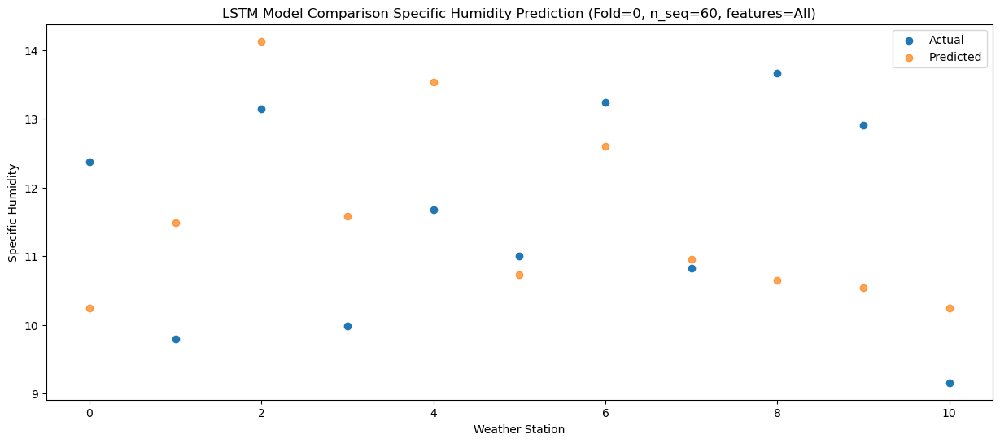

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   11.96  10.217964
1                 1    9.22  11.467964
2                 2   12.44  14.107964
3                 3    9.27  11.557964
4                 4   12.77  13.507964
5                 5    9.21  10.707964
6                 6   11.89  12.577964
7                 7    9.75  10.937964
8                 8   12.70  10.627964
9                 9   11.37  10.517964
10               10   10.15  10.217964


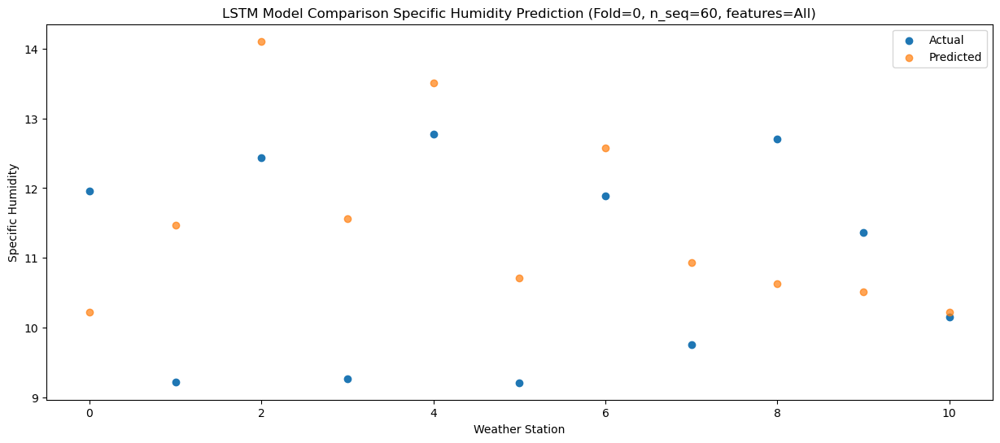

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.41   7.536921
1                 1    6.16   8.786921
2                 2    8.71  11.426921
3                 3    5.89   8.876921
4                 4    9.94  10.826921
5                 5    6.51   8.026921
6                 6    8.45   9.896921
7                 7    6.96   8.256921
8                 8    8.25   7.946921
9                 9    8.31   7.836921
10               10    7.55   7.536921


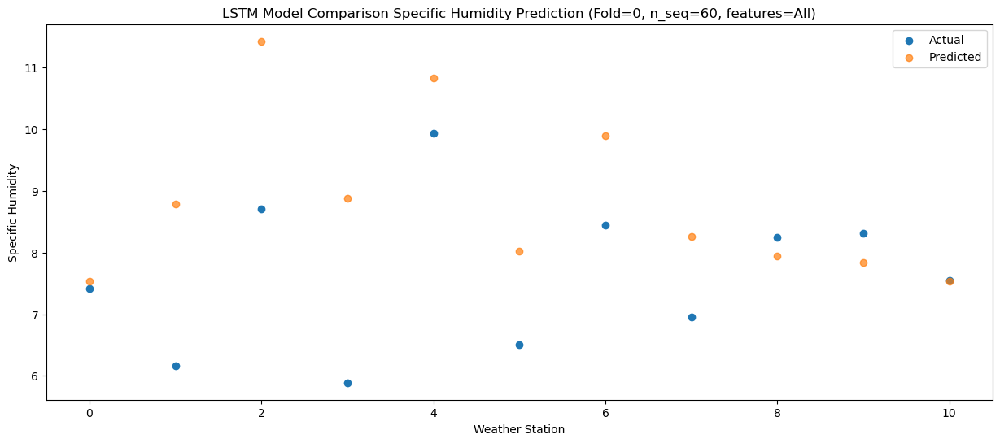

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.13   3.897656
1                 1    1.02   5.147656
2                 2    3.71   7.787656
3                 3    0.79   5.237656
4                 4    5.14   7.187656
5                 5    1.87   4.387656
6                 6    3.89   6.257656
7                 7    2.54   4.617656
8                 8    3.02   4.307656
9                 9    2.52   4.197656
10               10    2.53   3.897656


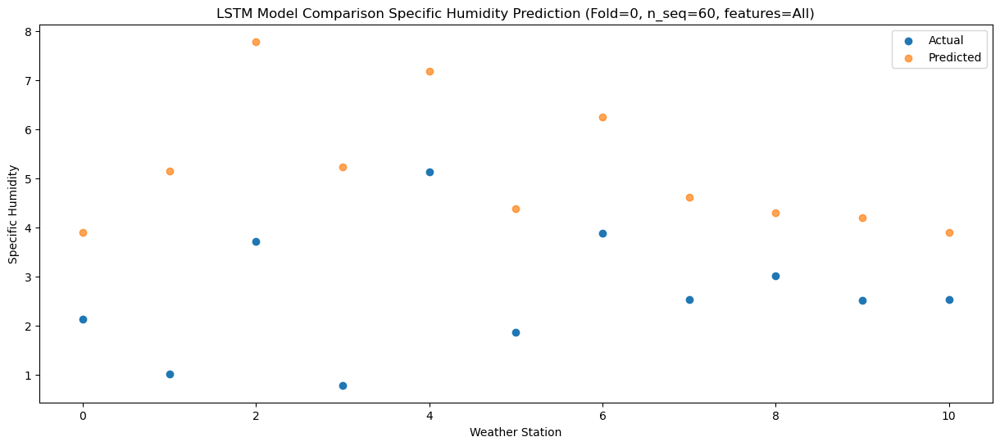

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.59   2.718607
1                 1    0.82   3.968607
2                 2    3.39   6.608607
3                 3    0.27   4.058607
4                 4    5.13   6.008607
5                 5    1.21   3.208607
6                 6    3.29   5.078607
7                 7    1.84   3.438607
8                 8    2.02   3.128607
9                 9    1.80   3.018607
10               10    1.39   2.718607


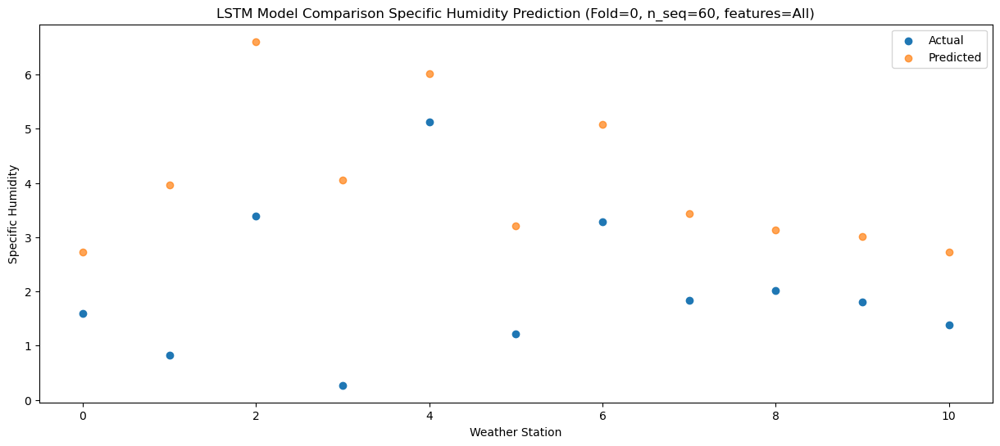

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.13   1.509244
1                 1   -0.38   2.759244
2                 2    2.06   5.399244
3                 3   -0.23   2.849244
4                 4    4.05   4.799244
5                 5   -2.14   1.999244
6                 6    1.11   3.869244
7                 7   -0.50   2.229244
8                 8    1.09   1.919244
9                 9    0.87   1.809244
10               10    0.22   1.509244


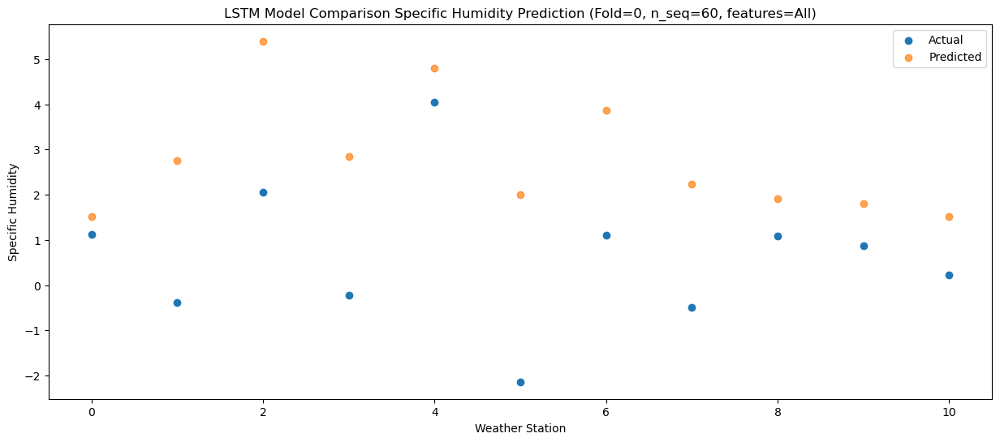

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.73   1.755873
1                 1   -0.29   3.005873
2                 2    2.43   5.645873
3                 3   -0.04   3.095873
4                 4    3.29   5.045873
5                 5   -1.39   2.245873
6                 6    1.97   4.115873
7                 7    0.43   2.475873
8                 8    1.69   2.165873
9                 9    1.48   2.055873
10               10    0.62   1.755873


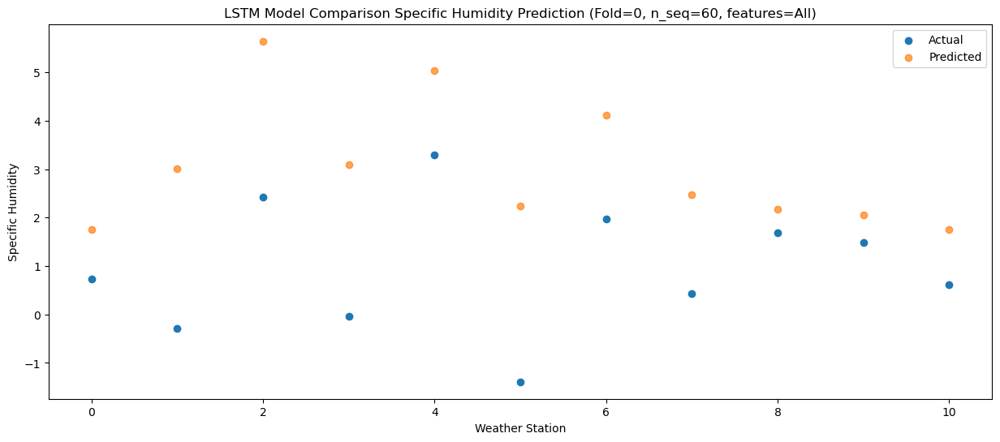

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.35   1.544389
1                 1    1.40   2.794389
2                 2    3.54   5.434389
3                 3    0.63   2.884389
4                 4    3.63   4.834389
5                 5   -0.46   2.034389
6                 6    2.65   3.904389
7                 7    0.79   2.264389
8                 8    1.76   1.954389
9                 9    1.25   1.844389
10               10    0.06   1.544389


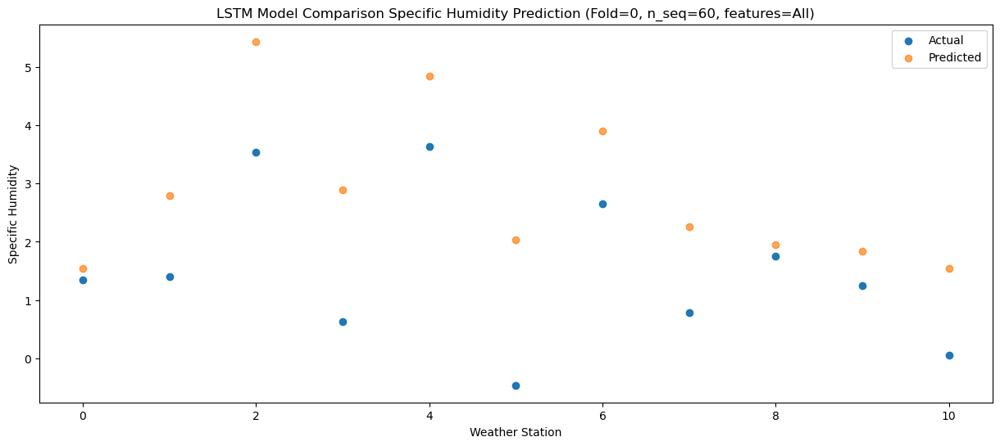

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.95   1.574227
1                 1    1.78   2.824227
2                 2    2.90   5.464227
3                 3    1.71   2.914227
4                 4    5.82   4.864227
5                 5   -0.68   2.064227
6                 6    2.24   3.934227
7                 7    0.71   2.294227
8                 8    2.20   1.984227
9                 9    1.35   1.874227
10               10    0.52   1.574227


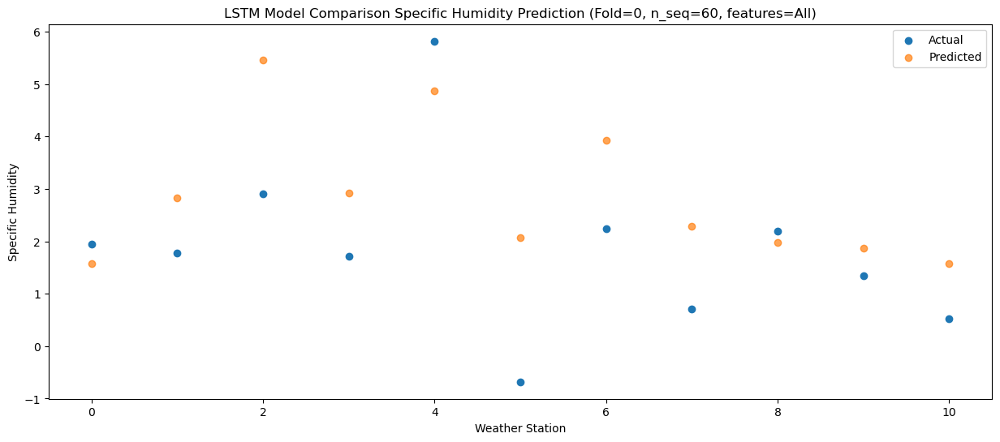

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.94   3.286784
1                 1    2.57   4.536784
2                 2    4.34   7.176784
3                 3    2.11   4.626784
4                 4    6.58   6.576784
5                 5    2.00   3.776784
6                 6    4.45   5.646784
7                 7    2.99   4.006784
8                 8    3.42   3.696784
9                 9    3.08   3.586784
10               10    2.16   3.286784


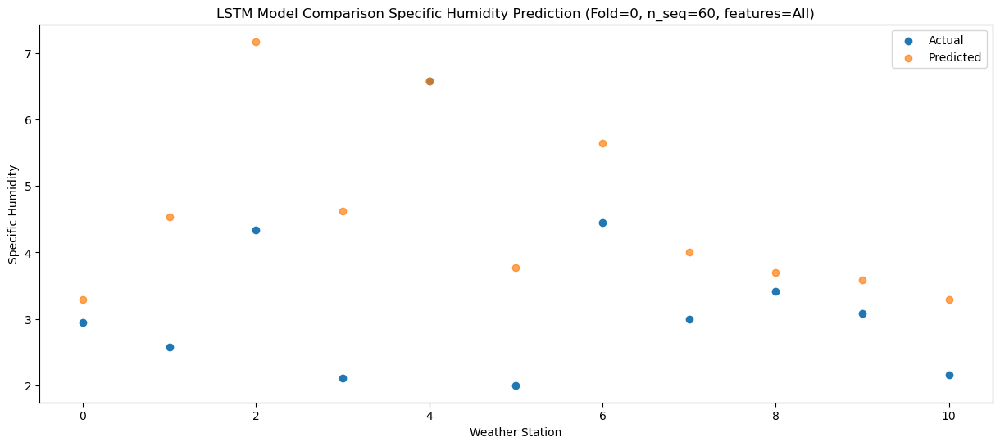

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.62   5.353326
1                 1    4.76   6.603326
2                 2    7.12   9.243326
3                 3    4.96   6.693326
4                 4   10.52   8.643326
5                 5    2.76   5.843326
6                 6    6.04   7.713326
7                 7    4.31   6.073326
8                 8    6.91   5.763326
9                 9    5.52   5.653326
10               10    3.37   5.353326


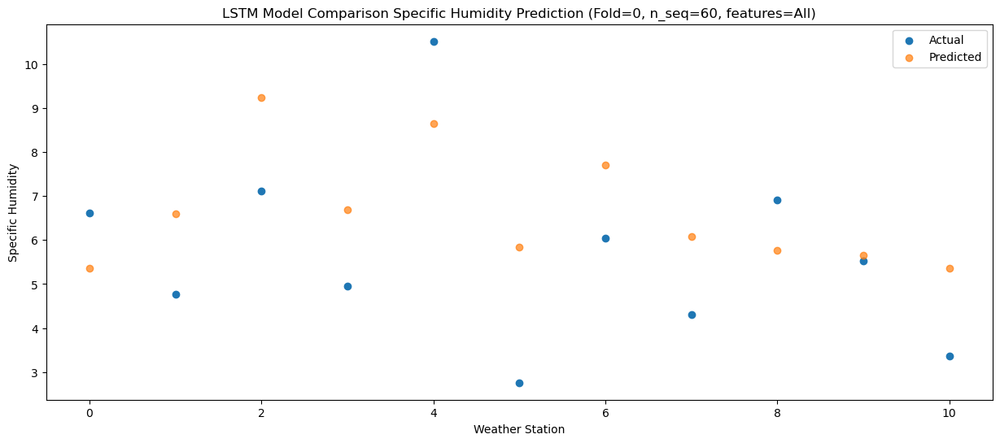

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   10.41    7.68069
1                 1    8.09    8.93069
2                 2    9.70   11.57069
3                 3    9.11    9.02069
4                 4   14.64   10.97069
5                 5    6.66    8.17069
6                 6    8.77   10.04069
7                 7    6.93    8.40069
8                 8    9.19    8.09069
9                 9    8.14    7.98069
10               10    6.38    7.68069


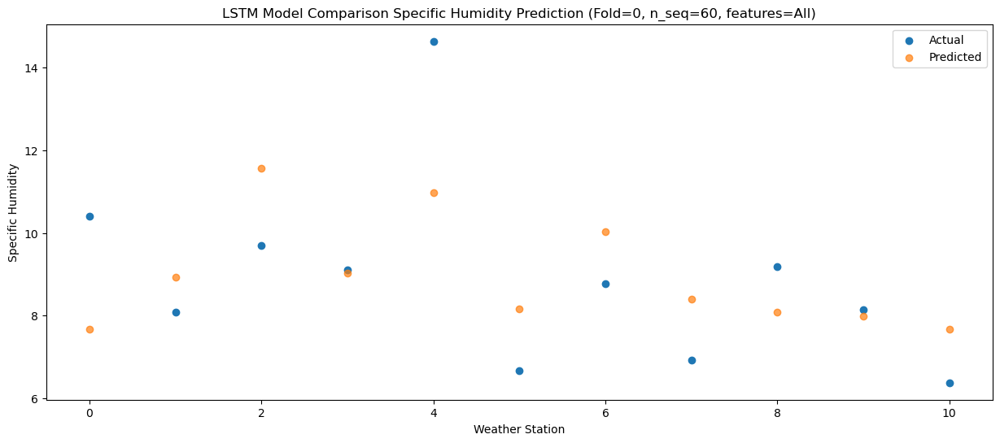

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.70  10.126146
1                 1    9.76  11.376146
2                 2   12.56  14.016146
3                 3   10.14  11.466146
4                 4   13.22  13.416146
5                 5   11.01  10.616146
6                 6   12.51  12.486146
7                 7   11.28  10.846146
8                 8   12.74  10.536146
9                 9   11.96  10.426146
10               10   10.21  10.126146


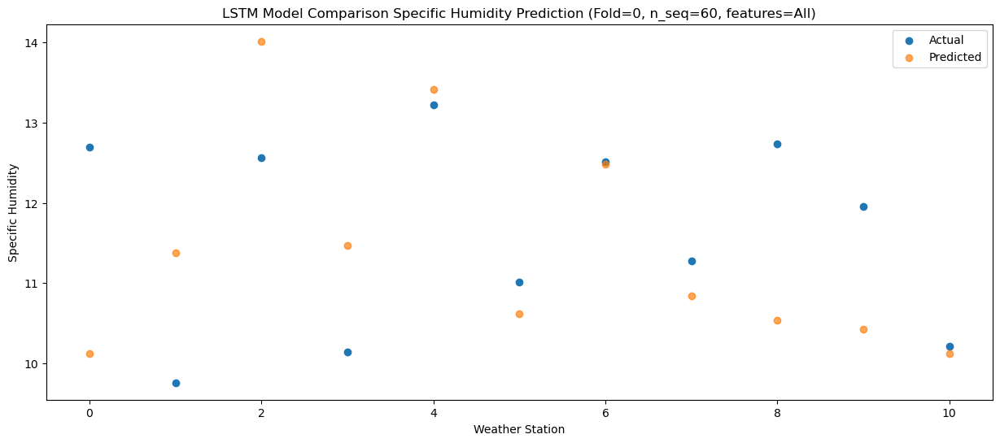

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   12.32   9.610451
1                 1   10.54  10.860451
2                 2   12.65  13.500451
3                 3    9.89  10.950451
4                 4   11.40  12.900451
5                 5   10.12  10.100451
6                 6   12.14  11.970451
7                 7   10.22  10.330451
8                 8   12.74  10.020451
9                 9   10.66   9.910451
10               10    9.46   9.610451


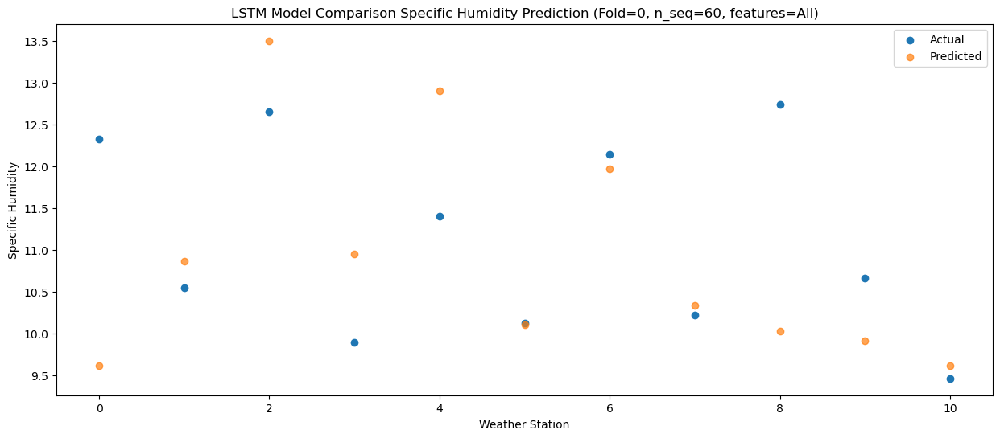

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.35   7.629845
1                 1    6.52   8.879845
2                 2    9.07  11.519845
3                 3    7.71   8.969845
4                 4   11.36  10.919845
5                 5    7.00   8.119845
6                 6    9.20   9.989845
7                 7    7.42   8.349845
8                 8    8.67   8.039845
9                 9    7.94   7.929845
10               10    8.15   7.629845


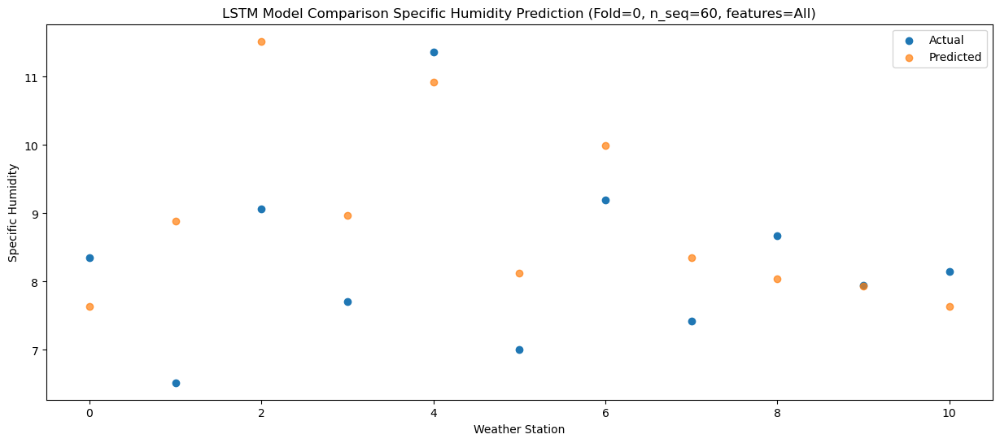

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    4.32   4.536223
1                 1    1.82   5.786223
2                 2    5.16   8.426223
3                 3    3.14   5.876223
4                 4    7.61   7.826223
5                 5    2.60   5.026223
6                 6    4.94   6.896223
7                 7    3.67   5.256223
8                 8    4.61   4.946223
9                 9    4.70   4.836223
10               10    4.39   4.536223


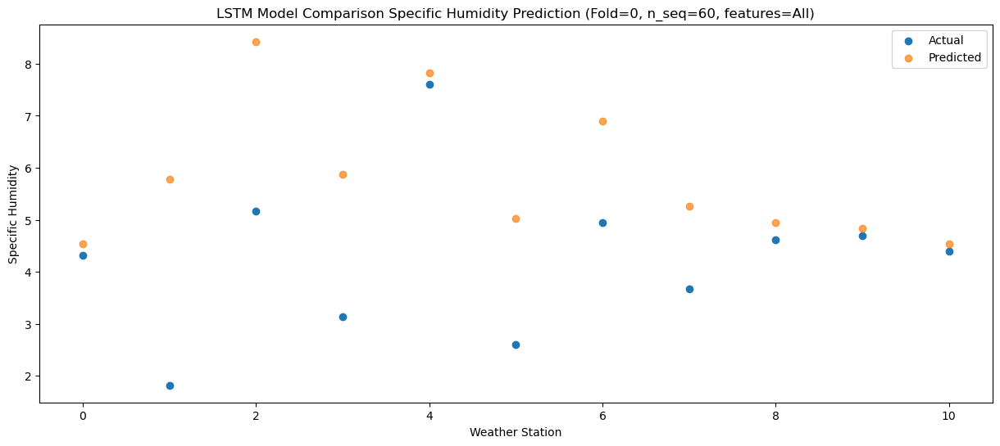

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.14   1.525579
1                 1   -0.36   2.775579
2                 2    2.63   5.415579
3                 3    0.15   2.865579
4                 4    4.81   4.815579
5                 5   -0.42   2.015579
6                 6    1.61   3.885579
7                 7    0.15   2.245579
8                 8    1.95   1.935579
9                 9    1.35   1.825579
10               10    0.98   1.525579


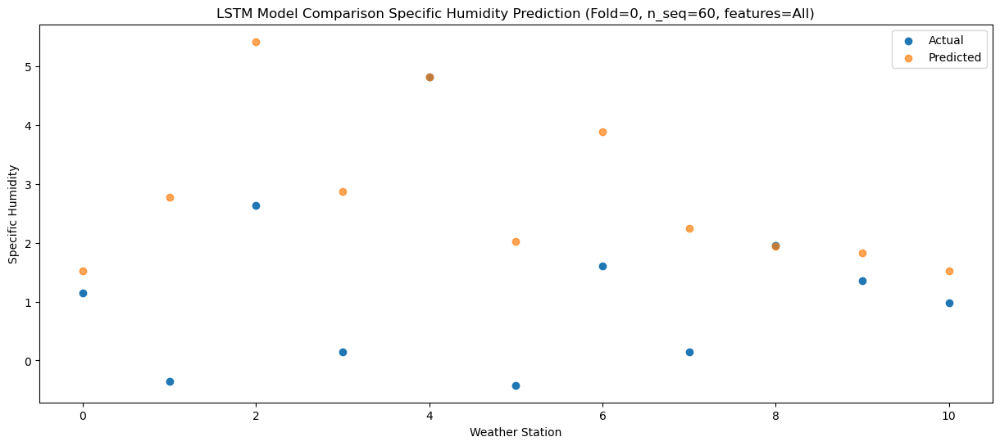

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.14   1.388409
1                 1   -1.80   2.638409
2                 2    1.82   5.278409
3                 3   -1.25   2.728409
4                 4    2.95   4.678409
5                 5   -1.24   1.878409
6                 6    1.54   3.748409
7                 7    0.35   2.108409
8                 8    1.34   1.798409
9                 9    1.54   1.688409
10               10    1.51   1.388409


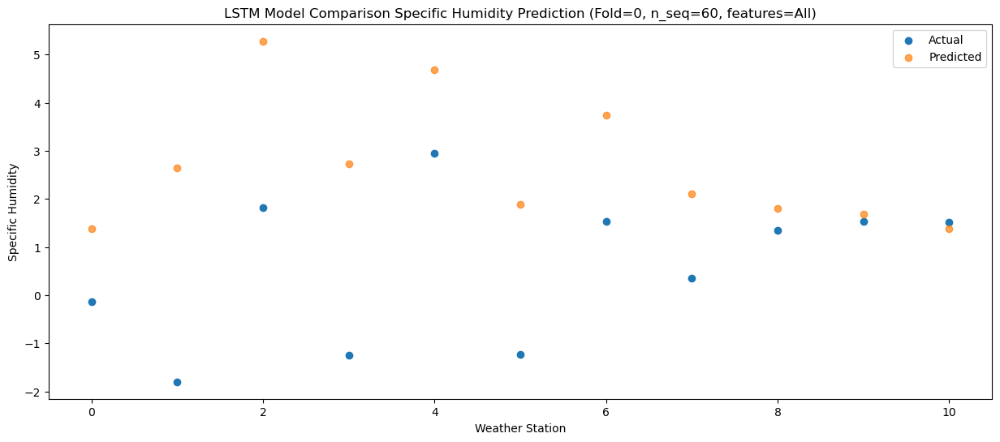

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.96   0.663994
1                 1   -2.58   1.913994
2                 2    1.02   4.553994
3                 3   -2.17   2.003994
4                 4    1.77   3.953994
5                 5   -2.03   1.153994
6                 6    0.87   3.023994
7                 7   -0.34   1.383994
8                 8    0.16   1.073994
9                 9    0.57   0.963994
10               10   -0.01   0.663994


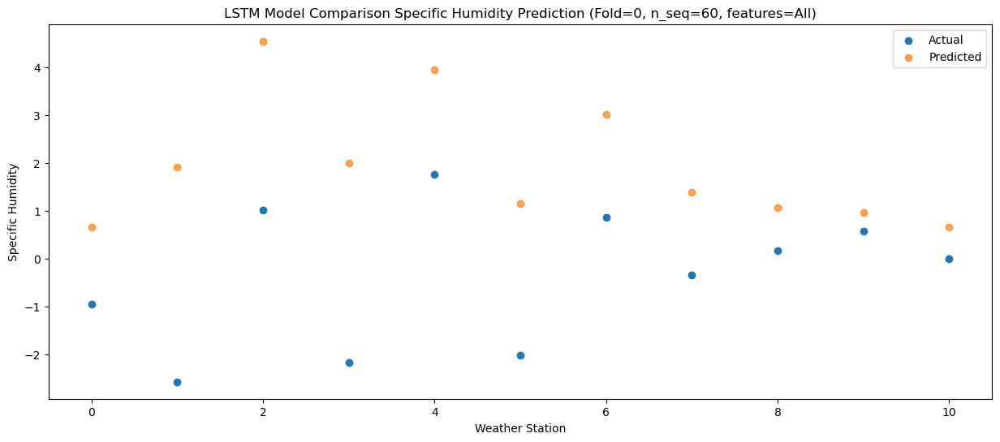

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.94   0.873422
1                 1   -1.36   2.123422
2                 2    1.66   4.763422
3                 3   -0.39   2.213422
4                 4    4.34   4.163422
5                 5   -2.13   1.363422
6                 6    1.03   3.233422
7                 7   -0.31   1.593422
8                 8    1.92   1.283422
9                 9    0.92   1.173422
10               10    0.52   0.873422


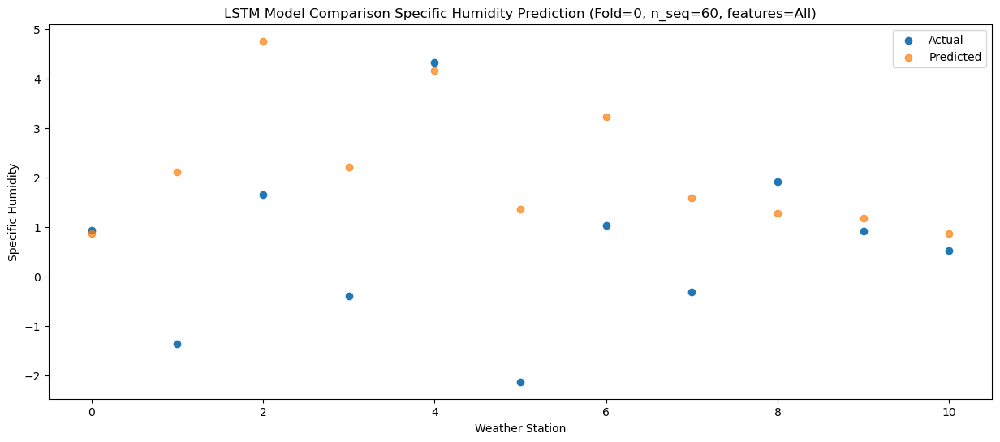

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.20   1.941987
1                 1    0.49   3.191987
2                 2    3.29   5.831987
3                 3    1.40   3.281987
4                 4    6.08   5.231987
5                 5   -0.21   2.431987
6                 6    2.48   4.301987
7                 7    0.83   2.661987
8                 8    2.79   2.351987
9                 9    2.05   2.241987
10               10    1.21   1.941987


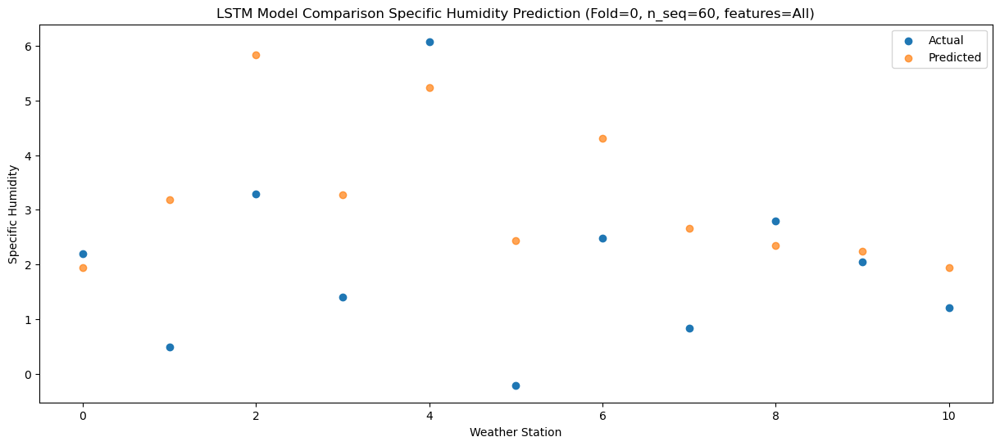

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    4.51   3.555931
1                 1    2.40   4.805931
2                 2    5.03   7.445931
3                 3    3.45   4.895931
4                 4    8.32   6.845931
5                 5    1.13   4.045931
6                 6    4.54   5.915931
7                 7    2.85   4.275931
8                 8    5.02   3.965931
9                 9    4.42   3.855931
10               10    2.77   3.555931


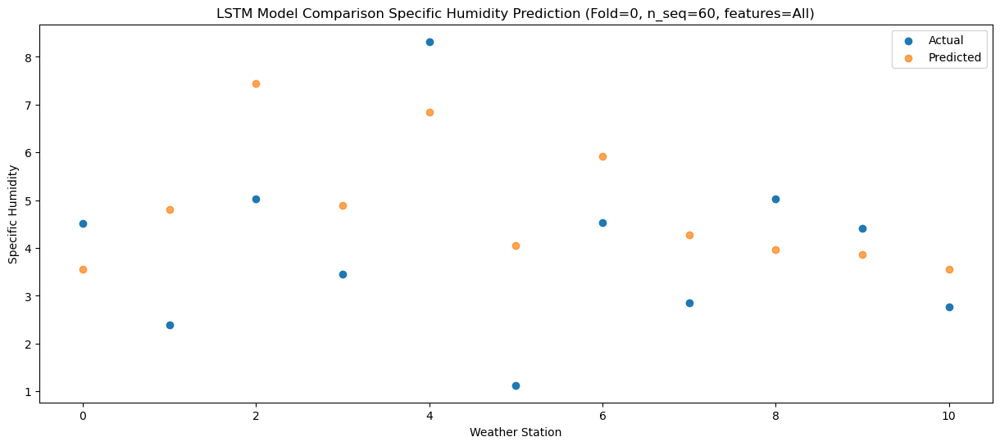

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.98   6.501973
1                 1    6.98   7.751973
2                 2    8.78  10.391973
3                 3    8.02   7.841973
4                 4   12.57   9.791973
5                 5    5.19   6.991973
6                 6    8.45   8.861973
7                 7    6.67   7.221973
8                 8    9.30   6.911973
9                 9    8.22   6.801973
10               10    5.82   6.501973


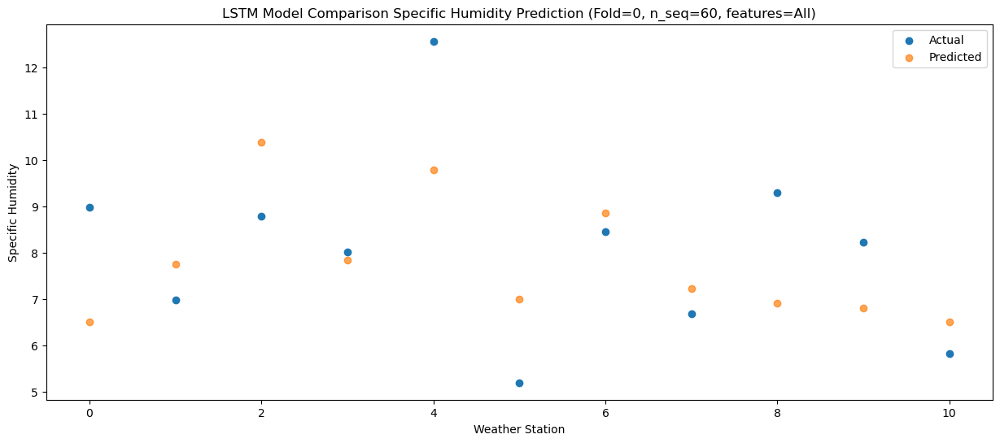

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.37   8.608256
1                 1    8.58   9.858256
2                 2    9.91  12.498256
3                 3    9.53   9.948256
4                 4   14.22  11.898256
5                 5    7.16   9.098256
6                 6   10.27  10.968256
7                 7    8.36   9.328256
8                 8   11.72   9.018256
9                 9    9.29   8.908256
10               10    8.32   8.608256


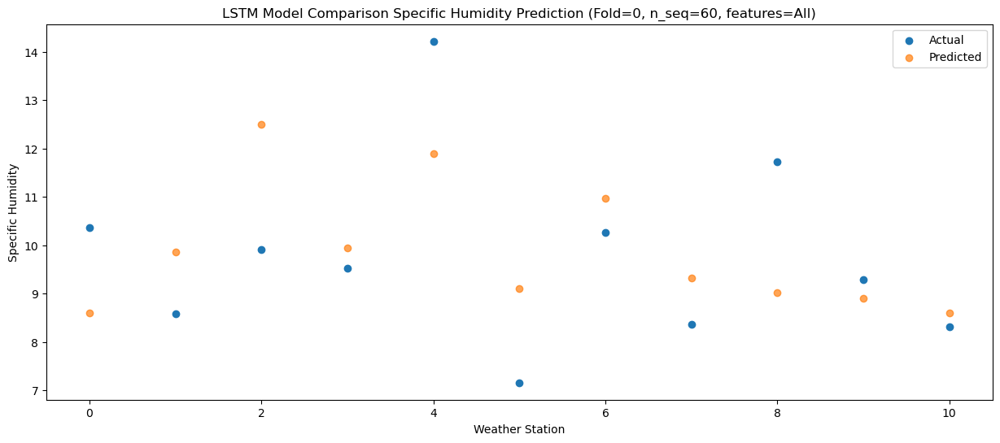

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   11.66  10.195092
1                 1   10.75  11.445092
2                 2   13.14  14.085092
3                 3   10.93  11.535092
4                 4   13.96  13.485092
5                 5    9.95  10.685092
6                 6   12.80  12.555092
7                 7   11.25  10.915092
8                 8   12.90  10.605092
9                 9   10.79  10.495092
10               10    9.39  10.195092


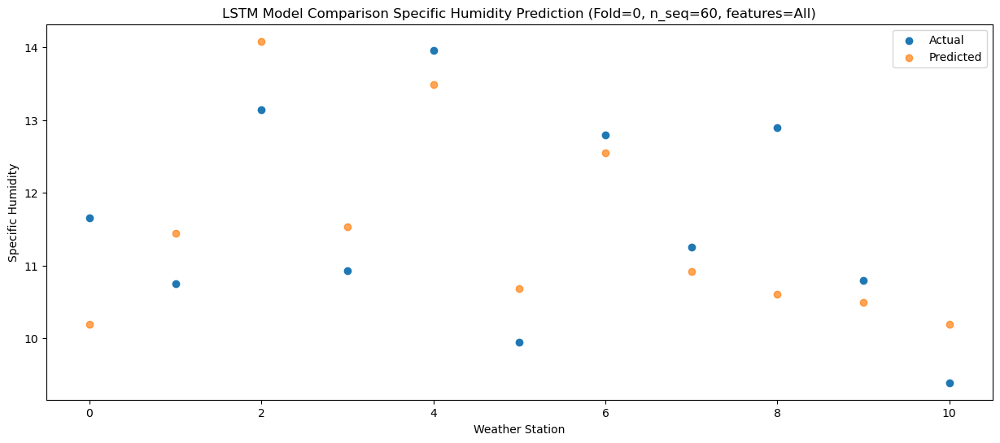

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.83   9.476071
1                 1    9.25  10.726071
2                 2   11.45  13.366071
3                 3    9.79  10.816071
4                 4   13.61  12.766071
5                 5    8.94   9.966071
6                 6   11.64  11.836071
7                 7    9.82  10.196071
8                 8   11.23   9.886071
9                 9    9.99   9.776071
10               10    9.15   9.476071


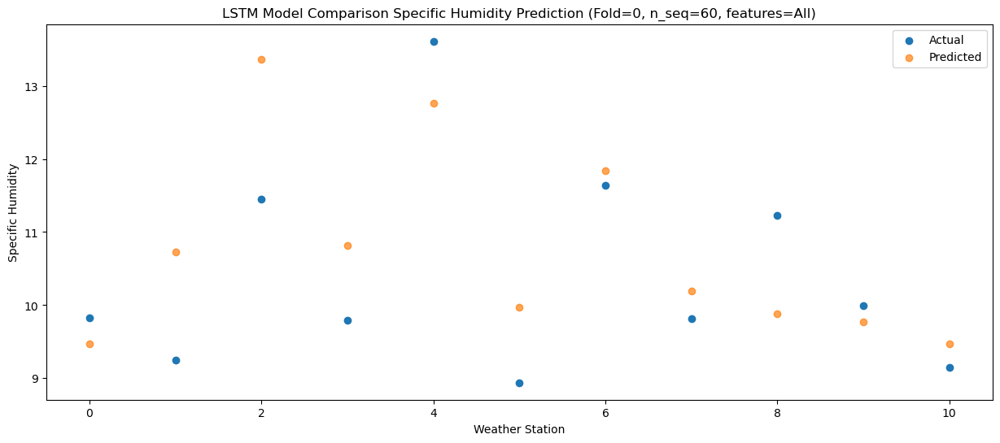

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    8.36   7.641388
1                 1    8.38   8.891388
2                 2    9.76  11.531388
3                 3    8.23   8.981388
4                 4   11.12  10.931388
5                 5    6.99   8.131388
6                 6    9.91  10.001388
7                 7    8.23   8.361388
8                 8    9.19   8.051388
9                 9    7.64   7.941388
10               10    7.44   7.641388


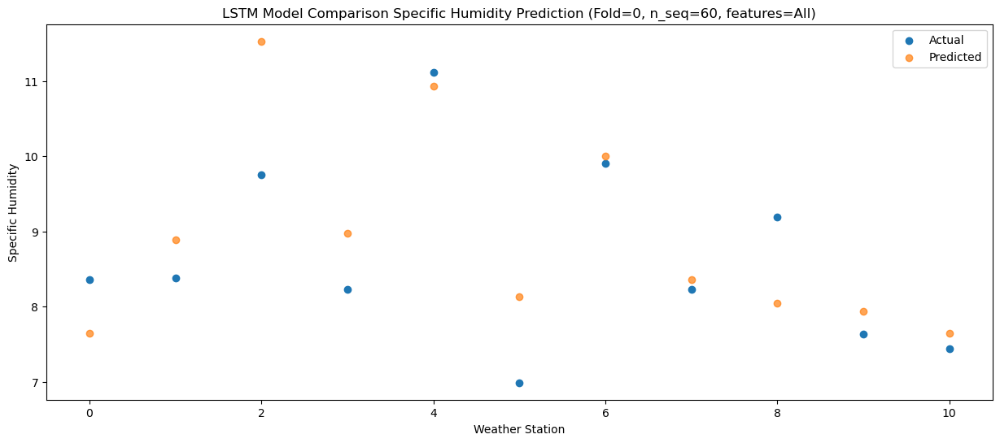

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.98   3.986721
1                 1    2.98   5.236721
2                 2    5.63   7.876721
3                 3    3.04   5.326721
4                 4    7.51   7.276721
5                 5    1.70   4.476721
6                 6    5.21   6.346721
7                 7    3.34   4.706721
8                 8    4.59   4.396721
9                 9    4.11   4.286721
10               10    3.24   3.986721


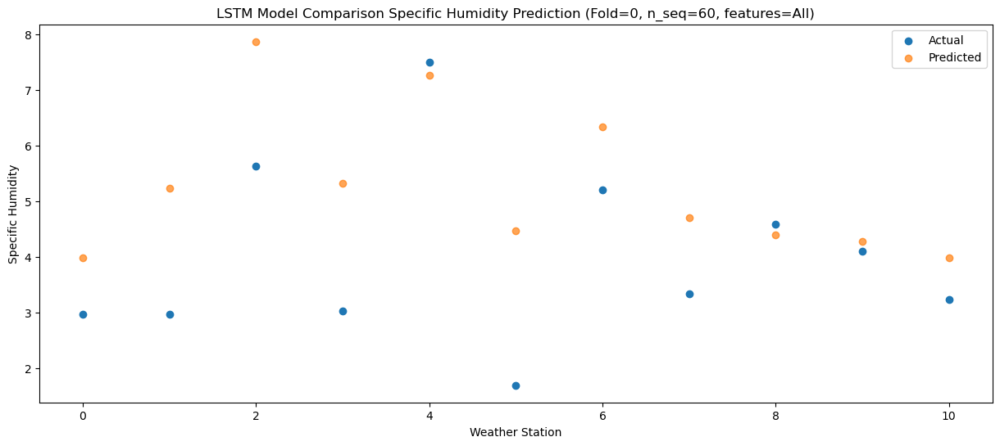

f, t:
[[ 3.000e-02 -8.600e-01  2.230e+00 -4.800e-01  4.290e+00 -8.100e-01
   1.380e+00 -5.000e-02  1.270e+00  7.800e-01  4.900e-01]
 [ 4.600e-01 -5.300e-01  2.480e+00  6.000e-02  3.040e+00 -8.500e-01
   1.500e+00  2.000e-01  1.360e+00  1.190e+00  6.100e-01]
 [ 3.700e-01 -9.700e-01  2.310e+00  3.000e-01  3.830e+00 -1.330e+00
   1.420e+00  2.300e-01  9.600e-01  6.900e-01  2.300e-01]
 [ 1.000e-02 -2.400e-01  2.860e+00  4.400e-01  3.220e+00 -1.440e+00
   1.780e+00  4.500e-01  9.500e-01  3.700e-01 -2.800e-01]
 [ 3.300e+00  3.640e+00  5.460e+00  4.750e+00  7.670e+00  3.200e-01
   3.410e+00  1.750e+00  3.210e+00  2.330e+00  1.320e+00]
 [ 2.950e+00  1.850e+00  4.210e+00  3.600e+00  7.390e+00  6.600e-01
   3.190e+00  1.690e+00  3.450e+00  2.390e+00  1.680e+00]
 [ 5.920e+00  4.170e+00  7.070e+00  5.750e+00  9.970e+00  3.790e+00
   6.290e+00  3.680e+00  6.670e+00  5.530e+00  4.580e+00]
 [ 9.680e+00  7.850e+00  1.098e+01  8.240e+00  1.233e+01  7.520e+00
   1.001e+01  8.350e+00  1.032e+01  8.220e+0

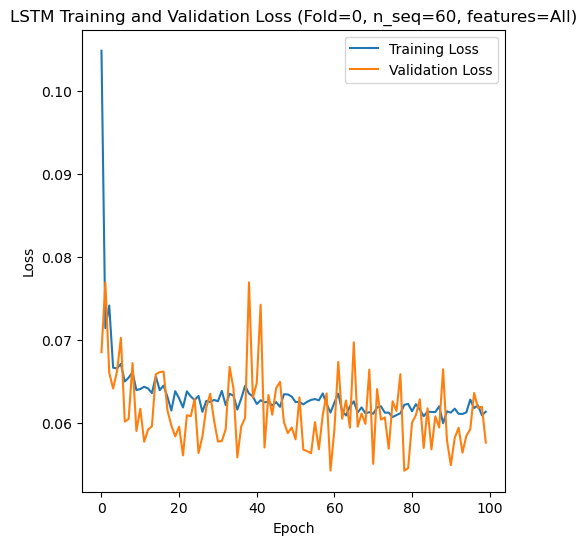

[[ 6.43  5.26  5.95 ... 15.04 10.09  9.76]
 [ 4.92  3.81  4.91 ... 12.52  8.69  7.9 ]
 [ 5.77  4.38  5.81 ... 14.28  9.78  9.52]
 ...
 [ 4.32  3.52  5.54 ... 12.    6.96  7.01]
 [ 3.07  3.12  5.08 ... 11.47  8.11  7.14]
 [ 2.37  2.06  3.5  ...  9.32  6.33  5.39]]
Epoch 1/100
84/84 [==============================] - 47s 257ms/step - loss: 0.1024 - accuracy: 0.2500 - mae: 0.0818 - rmse: 0.1024 - mape: 18.1495 - pearson: 0.6411 - val_loss: 0.0709 - val_accuracy: 0.5000 - val_mae: 0.0555 - val_rmse: 0.0709 - val_mape: 12.3999 - val_pearson: 0.7386
Epoch 2/100
84/84 [==============================] - 16s 187ms/step - loss: 0.0703 - accuracy: 0.5833 - mae: 0.0558 - rmse: 0.0703 - mape: 12.6205 - pearson: 0.7524 - val_loss: 0.0659 - val_accuracy: 0.5000 - val_mae: 0.0526 - val_rmse: 0.0659 - val_mape: 11.7978 - val_pearson: 0.7691
Epoch 3/100
84/84 [==============================] - 16s 188ms/step - loss: 0.0678 - accuracy: 0.5357 - mae: 0.0538 - rmse: 0.0678 - mape: 12.3301 - pearson: 0.7704

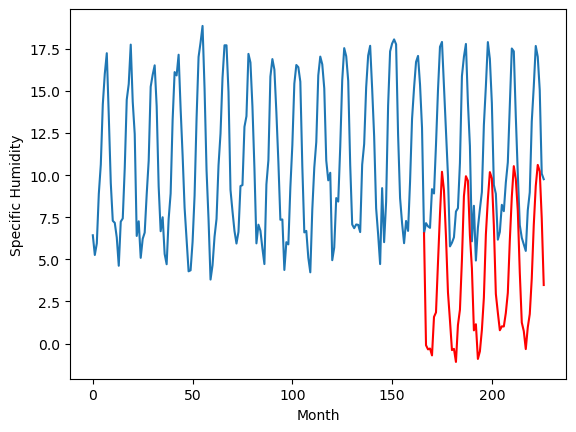

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.11		3.96		2.85
1.16		3.72		2.56
0.91		3.76		2.85
1.43		3.36		1.93
3.66		5.64		1.98
2.07		5.91		3.84
5.08		8.87		3.79
8.88		11.76		2.88
10.92		14.26		3.34
10.97		13.15		2.18
8.07		10.43		2.36
5.40		7.10		1.70
2.34		5.43		3.09
-0.25		3.67		3.92
-0.23		3.74		3.97
-0.04		2.97		3.01
1.49		5.16		3.67
1.85		6.07		4.22
4.77		9.03		4.26
8.75		12.81		4.06
10.62		14.00		3.38
10.83		13.73		2.90
7.88		10.49		2.61
5.84		8.52		2.68
0.25		4.84		4.59
2.42		5.21		2.79
-0.58		3.15		3.73
0.37		3.60		3.23
1.05		4.87		3.82
2.11		6.79		4.68
6.28		10.54		4.26
8.68		12.63		3.95
11.35		14.24		2.89
10.94		13.87		2.93
7.58		11.06		3.48
2.69		7.01		4.32
2.21		5.90		3.69
0.62		4.85		4.23
1.03		5.08		4.05
2.15		5.08		2.93
1.28		5.88		4.60
2.88		7.07		4.19
5.62		10.17		4.55
7.97		12.77		4.80
10.93		14.59		3.66
11.06		13.83		2.77
7.95		11.95		4.00
4.10		8.27		4.17
1.09		5.31		4.22
0.51		4.80		4.29
-0.26		3.73		3.99
0.08		5

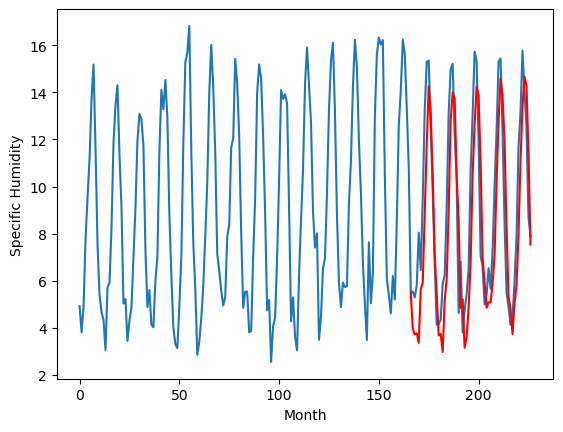

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.05		2.45		2.50
0.86		2.21		1.35
0.35		2.25		1.90
0.74		1.85		1.11
3.90		4.13		0.23
2.28		4.40		2.12
5.05		7.36		2.31
8.90		10.25		1.35
11.45		12.75		1.30
10.97		11.64		0.67
8.02		8.92		0.90
5.26		5.59		0.33
2.08		3.92		1.84
-0.69		2.16		2.85
-0.54		2.23		2.77
-0.54		1.46		2.00
2.08		3.65		1.57
1.79		4.56		2.77
4.63		7.52		2.89
9.15		11.30		2.15
10.74		12.49		1.75
10.96		12.22		1.26
8.20		8.98		0.78
5.45		7.01		1.56
-0.05		3.33		3.38
2.59		3.70		1.11
-1.29		1.64		2.93
-0.26		2.09		2.35
0.53		3.36		2.83
2.29		5.28		2.99
6.65		9.03		2.38
9.74		11.12		1.38
11.37		12.73		1.36
10.50		12.36		1.86
6.99		9.55		2.56
1.88		5.50		3.62
1.51		4.39		2.88
0.82		3.34		2.52
0.79		3.57		2.78
1.84		3.57		1.73
1.37		4.37		3.00
2.73		5.56		2.83
6.03		8.66		2.63
8.68		11.26		2.58
11.82		13.08		1.26
11.75		12.32		0.57
7.94		10.44		2.50
3.43		6.76		3.33
0.88		3.80		2.92
-0.14		3.29		3.43
-0.77		2.22		2.99
0.03		3.

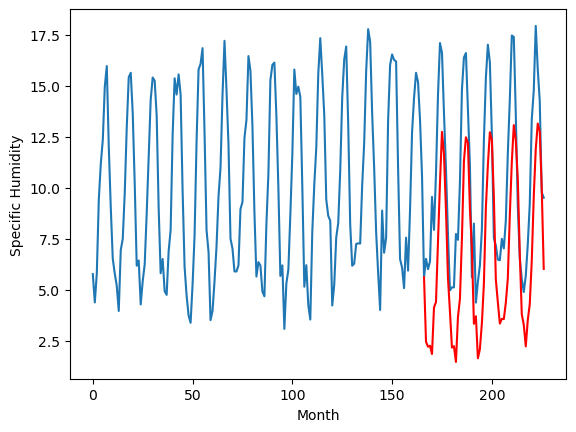

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.89		3.30		1.41
0.69		3.06		2.37
1.59		3.10		1.51
0.89		2.70		1.81
5.25		4.98		-0.27
4.91		5.25		0.34
6.89		8.21		1.32
9.01		11.10		2.09
11.52		13.60		2.08
10.41		12.49		2.08
8.83		9.77		0.94
5.43		6.44		1.01
3.33		4.77		1.44
0.78		3.01		2.23
0.44		3.08		2.64
0.51		2.31		1.80
3.15		4.50		1.35
4.49		5.41		0.92
8.38		8.37		-0.01
11.57		12.15		0.58
12.05		13.34		1.29
12.39		13.07		0.68
9.30		9.83		0.53
7.05		7.86		0.81
2.60		4.18		1.58
5.52		4.55		-0.97
-0.13		2.49		2.62
0.04		2.94		2.90
1.72		4.21		2.49
5.88		6.13		0.25
9.69		9.88		0.19
10.74		11.97		1.23
11.66		13.58		1.92
11.91		13.21		1.30
8.62		10.40		1.78
3.66		6.35		2.69
3.16		5.24		2.08
2.35		4.19		1.84
1.93		4.42		2.49
2.71		4.42		1.71
4.26		5.22		0.96
4.63		6.41		1.78
8.41		9.51		1.10
11.81		12.11		0.30
12.37		13.93		1.56
10.70		13.17		2.47
9.50		11.29		1.79
6.08		7.61		1.53
2.75		4.65		1.90
1.11		4.14		3.03
0.01		3.07		3.06
2.26		4.3

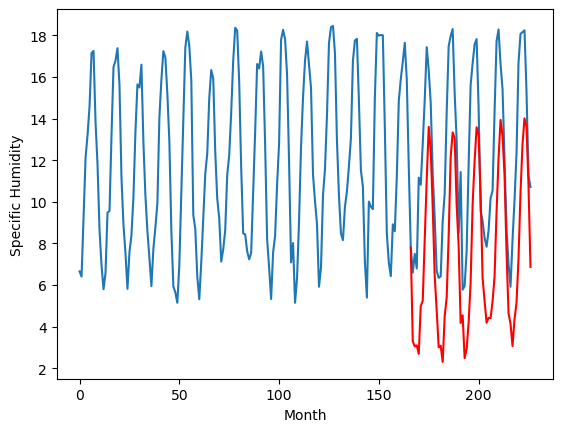

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.44		4.19		1.75
1.20		3.95		2.75
2.11		3.99		1.88
1.43		3.59		2.16
6.16		5.87		-0.29
5.85		6.14		0.29
7.97		9.10		1.13
10.26		11.99		1.73
12.86		14.49		1.63
11.41		13.38		1.97
9.92		10.66		0.74
6.07		7.33		1.26
3.59		5.66		2.07
0.77		3.90		3.13
0.52		3.97		3.45
0.56		3.20		2.64
3.28		5.39		2.11
4.54		6.30		1.76
8.57		9.26		0.69
11.98		13.04		1.06
12.16		14.23		2.07
12.20		13.96		1.76
9.10		10.72		1.62
7.15		8.75		1.60
2.56		5.07		2.51
5.49		5.44		-0.05
-0.05		3.38		3.43
0.15		3.83		3.68
1.85		5.10		3.25
5.95		7.02		1.07
9.83		10.77		0.94
10.95		12.86		1.91
11.70		14.47		2.77
12.08		14.10		2.02
8.73		11.29		2.56
3.83		7.24		3.41
3.45		6.13		2.68
2.63		5.08		2.45
2.15		5.31		3.16
2.75		5.31		2.56
4.45		6.11		1.66
4.90		7.30		2.40
8.57		10.40		1.83
11.83		13.00		1.17
11.91		14.82		2.91
10.51		14.06		3.55
9.76		12.18		2.42
6.37		8.50		2.13
3.03		5.54		2.51
1.31		5.03		3.72
0.14		3.96		3.82
2.39	

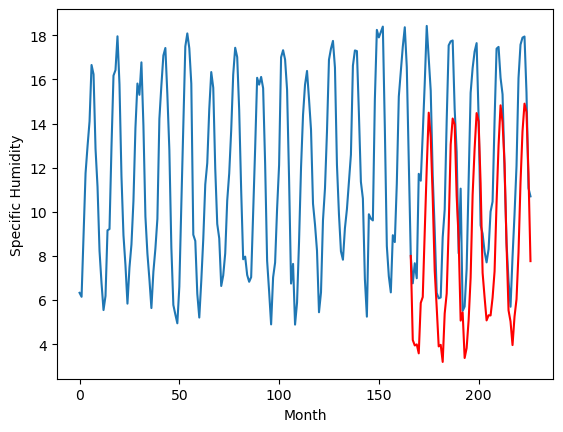

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.76		3.86		-0.90
3.28		3.62		0.34
3.00		3.66		0.66
3.18		3.26		0.08
5.85		5.54		-0.31
4.84		5.81		0.97
7.52		8.77		1.25
9.34		11.66		2.32
10.33		14.16		3.83
9.10		13.05		3.95
8.67		10.33		1.66
5.16		7.00		1.84
4.60		5.33		0.73
2.16		3.57		1.41
2.99		3.64		0.65
2.36		2.87		0.51
3.15		5.06		1.91
4.45		5.97		1.52
8.76		8.93		0.17
10.93		12.71		1.78
12.26		13.90		1.64
12.48		13.63		1.15
8.94		10.39		1.45
5.83		8.42		2.59
3.99		4.74		0.75
2.94		5.11		2.17
1.67		3.05		1.38
1.55		3.50		1.95
2.10		4.77		2.67
4.37		6.69		2.32
6.14		10.44		4.30
8.74		12.53		3.79
9.69		14.14		4.45
11.80		13.77		1.97
10.53		10.96		0.43
7.34		6.91		-0.43
4.47		5.80		1.33
3.80		4.75		0.95
2.25		4.98		2.73
2.28		4.98		2.70
3.33		5.78		2.45
3.59		6.97		3.38
7.96		10.07		2.11
7.91		12.67		4.76
10.08		14.49		4.41
10.23		13.73		3.50
9.87		11.85		1.98
7.89		8.17		0.28
5.26		5.21		-0.05
3.39		4.70		1.31
2.24		3.63		1.39
2.65		4.

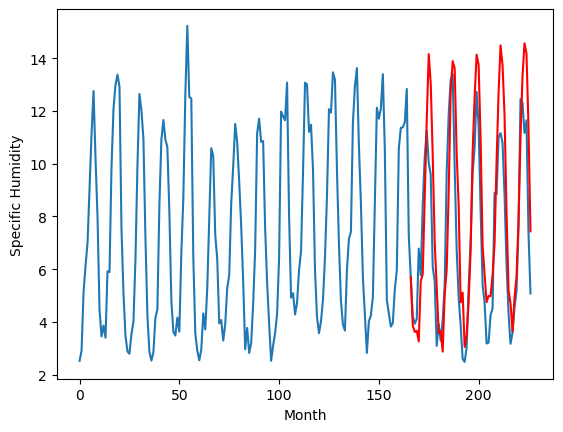

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.55		0.05		2.60
-2.52		-0.19		2.33
-2.94		-0.15		2.79
-2.46		-0.55		1.91
-0.49		1.73		2.22
-1.14		2.00		3.14
2.06		4.96		2.90
5.70		7.85		2.15
8.14		10.35		2.21
8.16		9.24		1.08
4.85		6.52		1.67
2.36		3.19		0.83
-0.75		1.52		2.27
-3.47		-0.24		3.23
-3.58		-0.17		3.41
-3.46		-0.94		2.52
-1.90		1.25		3.15
-1.28		2.16		3.44
1.65		5.12		3.47
6.00		8.90		2.90
8.50		10.09		1.59
8.79		9.82		1.03
5.44		6.58		1.14
3.31		4.61		1.30
-2.62		0.93		3.55
-0.75		1.30		2.05
-3.75		-0.76		2.99
-2.62		-0.31		2.31
-1.87		0.96		2.83
-0.68		2.88		3.56
3.58		6.63		3.05
6.30		8.72		2.42
9.29		10.33		1.04
8.20		9.96		1.76
4.72		7.15		2.43
-0.34		3.10		3.44
-0.83		1.99		2.82
-2.73		0.94		3.67
-2.37		1.17		3.54
-1.17		1.17		2.34
-1.93		1.97		3.90
-0.12		3.16		3.28
2.44		6.26		3.82
5.02		8.86		3.84
8.64		10.68		2.04
8.53		9.92		1.39
5.56		8.04		2.48
1.31		4.36		3.05
-2.04		1.40		3.44
-2.54		0.89		3.43
-3.36		-0.18		3.

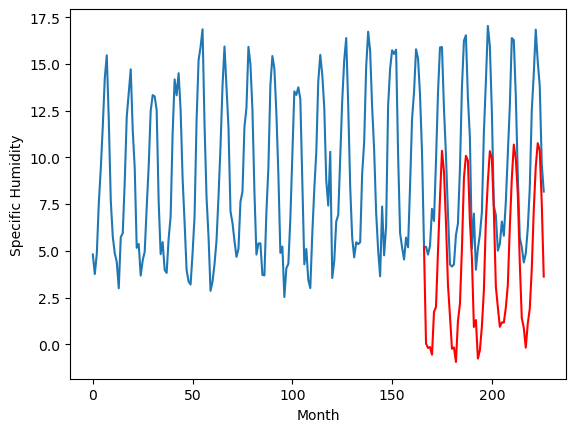

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.26		2.34		1.08
0.93		2.10		1.17
0.85		2.14		1.29
0.73		1.74		1.01
3.39		4.02		0.63
3.65		4.29		0.64
6.55		7.25		0.70
10.38		10.14		-0.24
13.46		12.64		-0.82
11.29		11.53		0.24
9.49		8.81		-0.68
4.67		5.48		0.81
2.65		3.81		1.16
0.33		2.05		1.72
0.20		2.12		1.92
-0.32		1.35		1.67
2.41		3.54		1.13
3.64		4.45		0.81
6.85		7.41		0.56
11.61		11.19		-0.42
12.24		12.38		0.14
12.09		12.11		0.02
8.84		8.87		0.03
6.11		6.90		0.79
1.55		3.22		1.67
3.19		3.59		0.40
-0.56		1.53		2.09
0.12		1.98		1.86
1.65		3.25		1.60
3.84		5.17		1.33
8.29		8.92		0.63
11.05		11.01		-0.04
12.02		12.62		0.60
11.93		12.25		0.32
7.97		9.44		1.47
3.43		5.39		1.96
2.18		4.28		2.10
1.27		3.23		1.96
1.39		3.46		2.07
1.49		3.46		1.97
2.25		4.26		2.01
3.45		5.45		2.00
7.49		8.55		1.06
10.41		11.15		0.74
12.98		12.97		-0.01
12.56		12.21		-0.35
8.07		10.33		2.26
4.82		6.65		1.83
2.11		3.69		1.58
0.72		3.18		2.46
-0.35		2.11		2.46
1.4

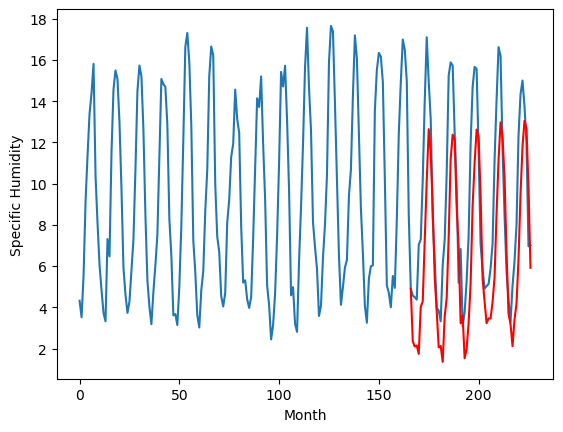

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.02		1.85		-0.17
1.18		1.61		0.43
1.63		1.65		0.02
1.01		1.25		0.24
4.03		3.53		-0.50
4.22		3.80		-0.42
7.55		6.76		-0.79
9.69		9.65		-0.04
13.05		12.15		-0.90
10.15		11.04		0.89
8.67		8.32		-0.35
4.00		4.99		0.99
2.89		3.32		0.43
0.61		1.56		0.95
0.77		1.63		0.86
-0.04		0.86		0.90
2.57		3.05		0.48
3.73		3.96		0.23
7.95		6.92		-1.03
11.09		10.70		-0.39
12.14		11.89		-0.25
11.72		11.62		-0.10
8.15		8.38		0.23
5.71		6.41		0.70
2.18		2.73		0.55
1.57		3.10		1.53
-0.41		1.04		1.45
0.12		1.49		1.37
1.21		2.76		1.55
4.33		4.68		0.35
8.57		8.43		-0.14
10.47		10.52		0.05
9.83		12.13		2.30
10.57		11.76		1.19
7.83		8.95		1.12
3.88		4.90		1.02
2.90		3.79		0.89
1.16		2.74		1.58
0.68		2.97		2.29
1.01		2.97		1.96
2.43		3.77		1.34
3.65		4.96		1.31
8.70		8.06		-0.64
11.28		10.66		-0.62
11.51		12.48		0.97
9.68		11.72		2.04
8.73		9.84		1.11
5.30		6.16		0.86
2.63		3.20		0.57
1.58		2.69		1.11
0.27		1.62		1.35
2.

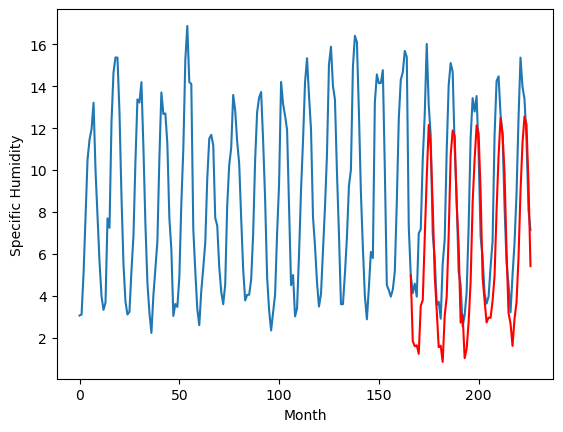

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.35		0.60		-0.75
0.70		0.36		-0.34
0.55		0.40		-0.15
0.56		-0.00		-0.56
2.45		2.28		-0.17
2.61		2.55		-0.06
5.43		5.51		0.08
7.14		8.40		1.26
10.03		10.90		0.87
8.71		9.79		1.08
5.92		7.07		1.15
2.40		3.74		1.34
2.08		2.07		-0.01
0.22		0.31		0.09
0.41		0.38		-0.03
-0.33		-0.39		-0.06
1.49		1.80		0.31
1.66		2.71		1.05
6.81		5.67		-1.14
9.80		9.45		-0.35
11.04		10.64		-0.40
10.01		10.37		0.36
7.05		7.13		0.08
3.61		5.16		1.55
1.25		1.48		0.23
0.27		1.85		1.58
-0.37		-0.21		0.16
-0.45		0.24		0.69
0.51		1.51		1.00
1.48		3.43		1.95
4.04		7.18		3.14
8.22		9.27		1.05
8.87		10.88		2.01
9.28		10.51		1.23
7.28		7.70		0.42
3.89		3.65		-0.24
1.91		2.54		0.63
0.70		1.49		0.79
0.39		1.72		1.33
0.25		1.72		1.47
1.04		2.52		1.48
1.56		3.71		2.15
7.29		6.81		-0.48
8.90		9.41		0.51
10.83		11.23		0.40
8.92		10.47		1.55
7.27		8.59		1.32
4.16		4.91		0.75
1.84		1.95		0.11
1.40		1.44		0.04
0.66		0.37		-0.29
1.33	

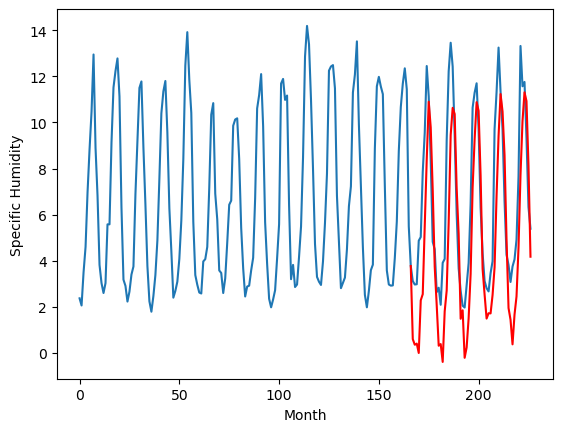

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.82		-0.10		1.72
-1.83		-0.34		1.49
-1.98		-0.30		1.68
-1.91		-0.70		1.21
-0.96		1.58		2.54
-0.67		1.85		2.52
1.90		4.81		2.91
5.54		7.70		2.16
9.18		10.20		1.02
9.09		9.09		-0.00
5.61		6.37		0.76
2.69		3.04		0.35
0.31		1.37		1.06
-1.85		-0.39		1.46
-2.58		-0.32		2.26
-2.54		-1.09		1.45
-1.30		1.10		2.40
0.07		2.01		1.94
1.60		4.97		3.37
6.92		8.75		1.83
8.78		9.94		1.16
9.12		9.67		0.55
5.93		6.43		0.50
4.07		4.46		0.39
-1.12		0.78		1.90
-1.24		1.15		2.39
-2.85		-0.91		1.94
-2.11		-0.46		1.65
-1.09		0.81		1.90
-0.43		2.73		3.16
3.70		6.48		2.78
5.29		8.57		3.28
8.92		10.18		1.26
8.49		9.81		1.32
5.24		7.00		1.76
1.80		2.95		1.15
0.30		1.84		1.54
-1.83		0.79		2.62
-0.97		1.02		1.99
-1.77		1.02		2.79
-1.74		1.82		3.56
0.87		3.01		2.14
1.17		6.11		4.94
4.46		8.71		4.25
9.17		10.53		1.36
6.88		9.77		2.89
5.62		7.89		2.27
2.57		4.21		1.64
-1.09		1.25		2.34
-0.85		0.74		1.59
-1.90		-0.33		1.57


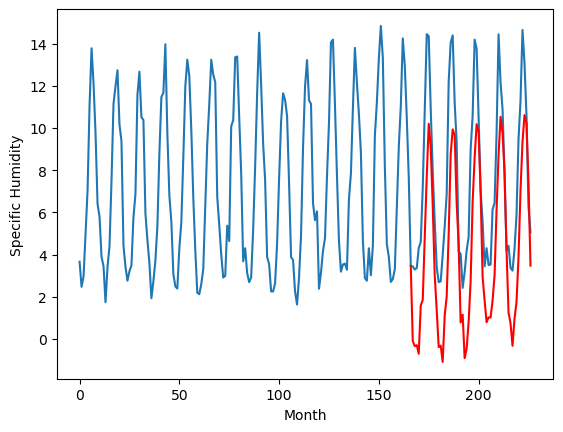

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -3.88  -0.098348
1                 1    1.11   3.961652
2                 2   -0.05   2.451652
3                 3    1.89   3.301652
4                 4    2.44   4.191652
5                 5    4.76   3.861652
6                 6   -2.55   0.051652
7                 7    1.26   2.341652
8                 8    2.02   1.851652
9                 9    1.35   0.601652
10               10   -1.82  -0.098348


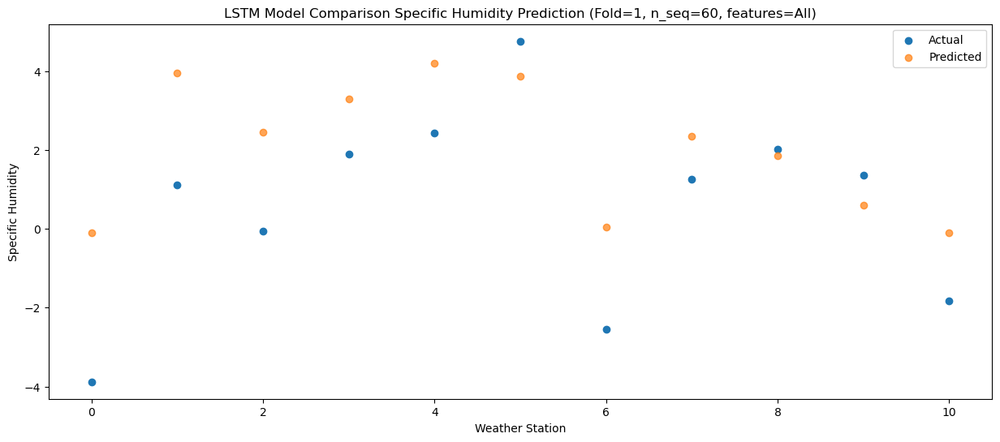

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.28  -0.343993
1                 1    1.16   3.716007
2                 2    0.86   2.206007
3                 3    0.69   3.056007
4                 4    1.20   3.946007
5                 5    3.28   3.616007
6                 6   -2.52  -0.193993
7                 7    0.93   2.096007
8                 8    1.18   1.606007
9                 9    0.70   0.356007
10               10   -1.83  -0.343993


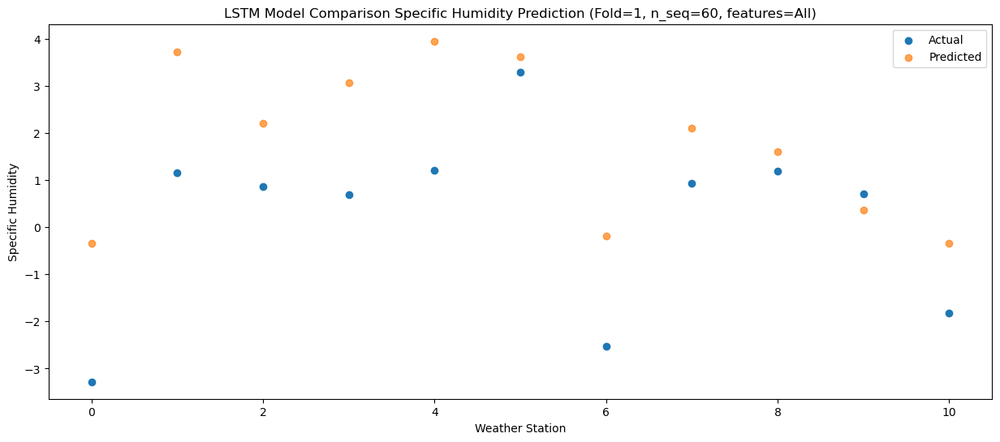

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.47  -0.295229
1                 1    0.91   3.764771
2                 2    0.35   2.254771
3                 3    1.59   3.104771
4                 4    2.11   3.994771
5                 5    3.00   3.664771
6                 6   -2.94  -0.145229
7                 7    0.85   2.144771
8                 8    1.63   1.654771
9                 9    0.55   0.404771
10               10   -1.98  -0.295229


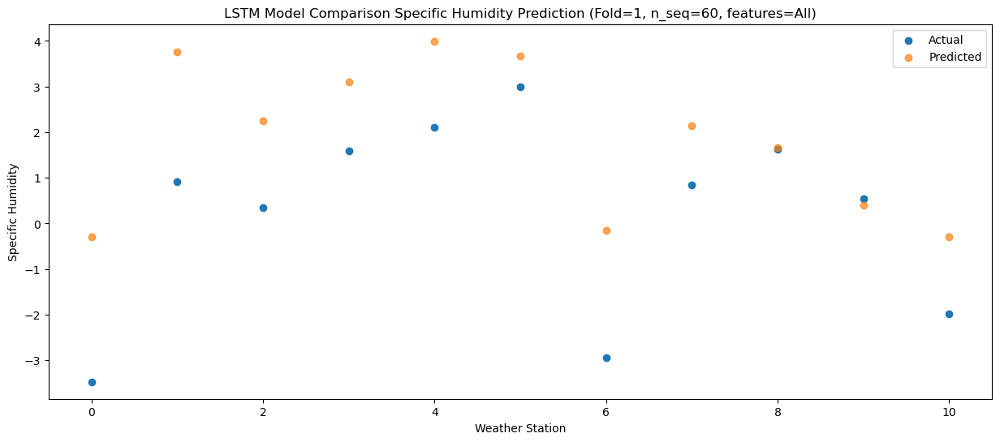

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -3.56  -0.701368
1                 1    1.43   3.358632
2                 2    0.74   1.848632
3                 3    0.89   2.698632
4                 4    1.43   3.588632
5                 5    3.18   3.258632
6                 6   -2.46  -0.551368
7                 7    0.73   1.738632
8                 8    1.01   1.248632
9                 9    0.56  -0.001368
10               10   -1.91  -0.701368


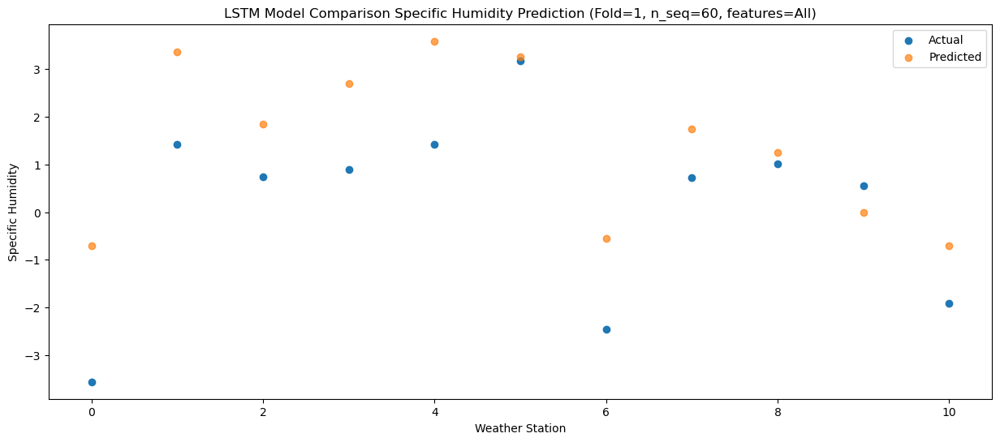

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -1.26   1.583399
1                 1    3.66   5.643399
2                 2    3.90   4.133399
3                 3    5.25   4.983399
4                 4    6.16   5.873399
5                 5    5.85   5.543399
6                 6   -0.49   1.733399
7                 7    3.39   4.023399
8                 8    4.03   3.533399
9                 9    2.45   2.283399
10               10   -0.96   1.583399


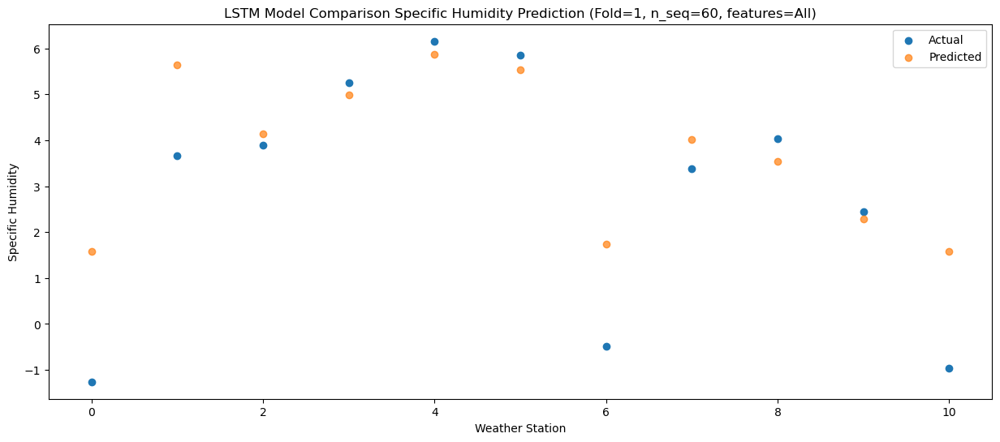

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -1.52    1.85034
1                 1    2.07    5.91034
2                 2    2.28    4.40034
3                 3    4.91    5.25034
4                 4    5.85    6.14034
5                 5    4.84    5.81034
6                 6   -1.14    2.00034
7                 7    3.65    4.29034
8                 8    4.22    3.80034
9                 9    2.61    2.55034
10               10   -0.67    1.85034


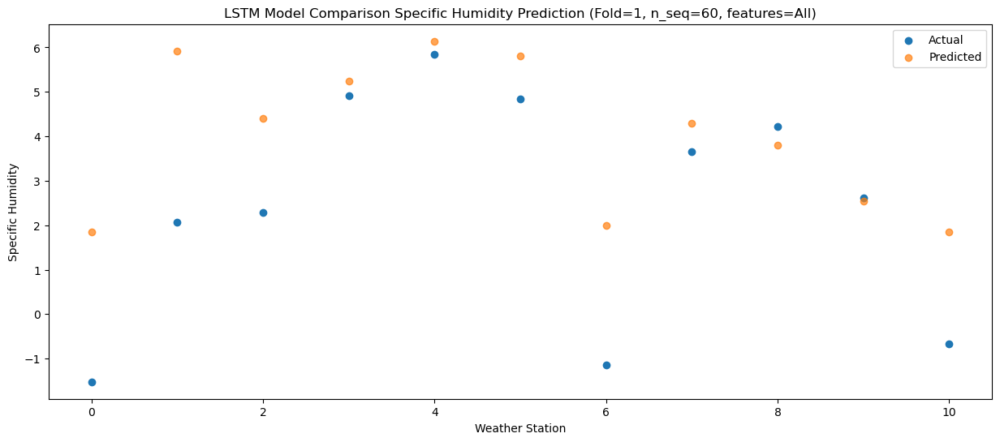

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    1.38    4.81211
1                 1    5.08    8.87211
2                 2    5.05    7.36211
3                 3    6.89    8.21211
4                 4    7.97    9.10211
5                 5    7.52    8.77211
6                 6    2.06    4.96211
7                 7    6.55    7.25211
8                 8    7.55    6.76211
9                 9    5.43    5.51211
10               10    1.90    4.81211


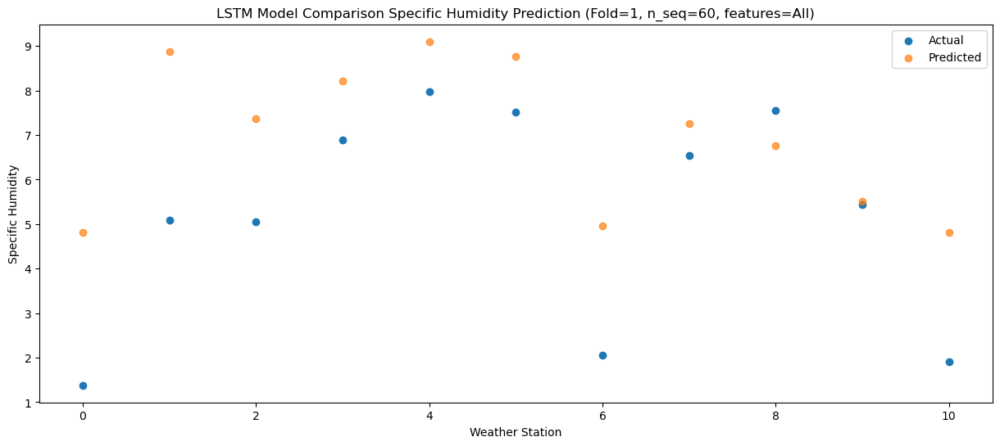

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    4.62   7.695335
1                 1    8.88  11.755335
2                 2    8.90  10.245335
3                 3    9.01  11.095335
4                 4   10.26  11.985335
5                 5    9.34  11.655335
6                 6    5.70   7.845335
7                 7   10.38  10.135335
8                 8    9.69   9.645335
9                 9    7.14   8.395335
10               10    5.54   7.695335


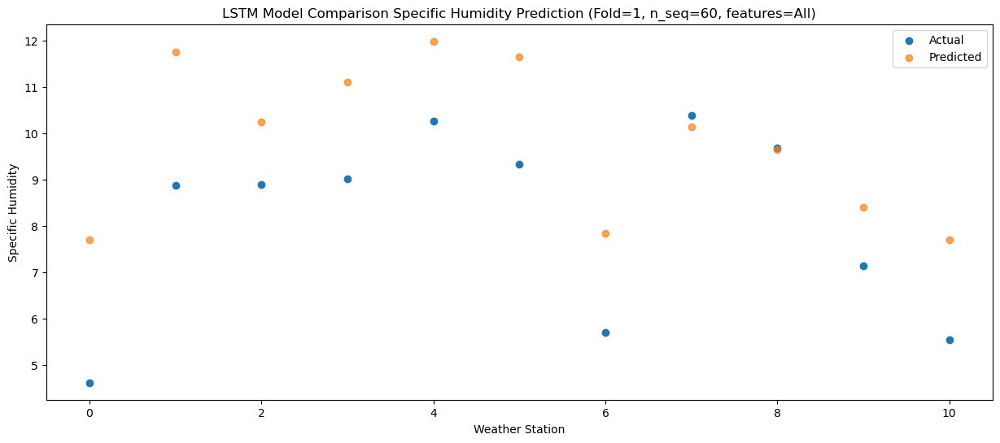

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    7.19  10.199994
1                 1   10.92  14.259994
2                 2   11.45  12.749994
3                 3   11.52  13.599994
4                 4   12.86  14.489994
5                 5   10.33  14.159994
6                 6    8.14  10.349994
7                 7   13.46  12.639994
8                 8   13.05  12.149994
9                 9   10.03  10.899994
10               10    9.18  10.199994


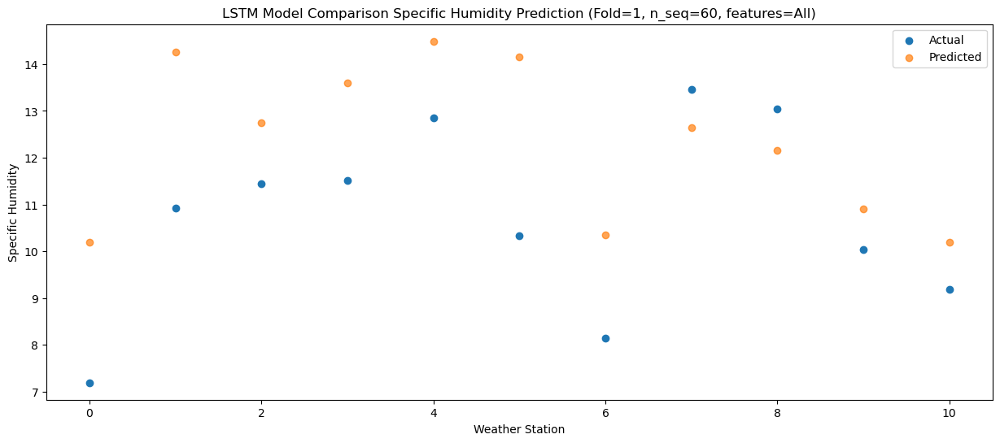

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    7.48   9.089242
1                 1   10.97  13.149242
2                 2   10.97  11.639242
3                 3   10.41  12.489242
4                 4   11.41  13.379242
5                 5    9.10  13.049242
6                 6    8.16   9.239242
7                 7   11.29  11.529242
8                 8   10.15  11.039242
9                 9    8.71   9.789242
10               10    9.09   9.089242


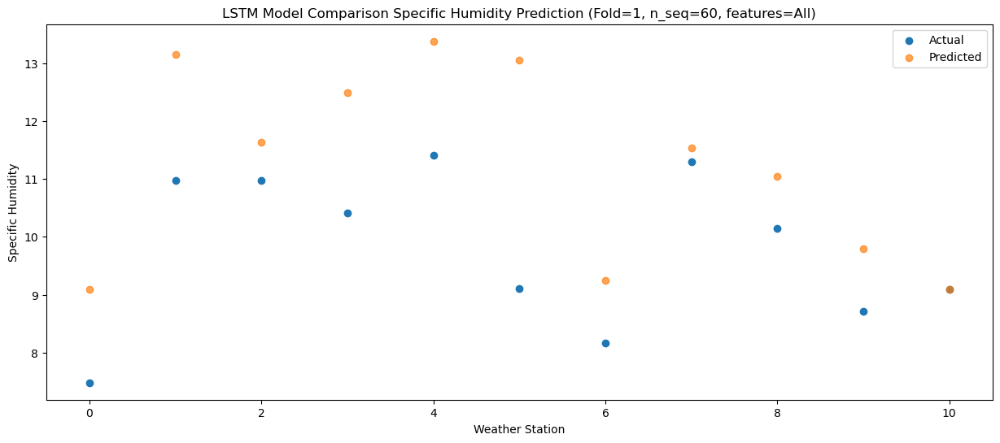

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    4.86   6.368515
1                 1    8.07  10.428515
2                 2    8.02   8.918515
3                 3    8.83   9.768515
4                 4    9.92  10.658515
5                 5    8.67  10.328515
6                 6    4.85   6.518515
7                 7    9.49   8.808515
8                 8    8.67   8.318515
9                 9    5.92   7.068515
10               10    5.61   6.368515


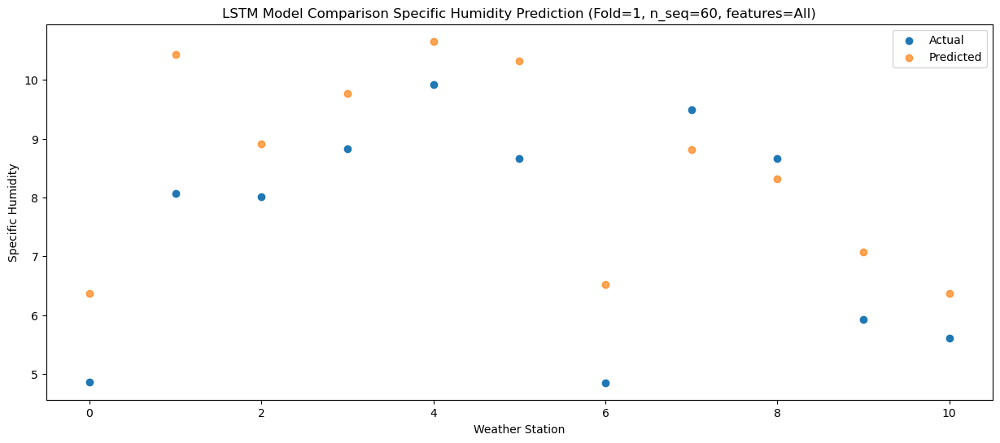

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    2.18   3.040047
1                 1    5.40   7.100047
2                 2    5.26   5.590047
3                 3    5.43   6.440047
4                 4    6.07   7.330047
5                 5    5.16   7.000047
6                 6    2.36   3.190047
7                 7    4.67   5.480047
8                 8    4.00   4.990047
9                 9    2.40   3.740047
10               10    2.69   3.040047


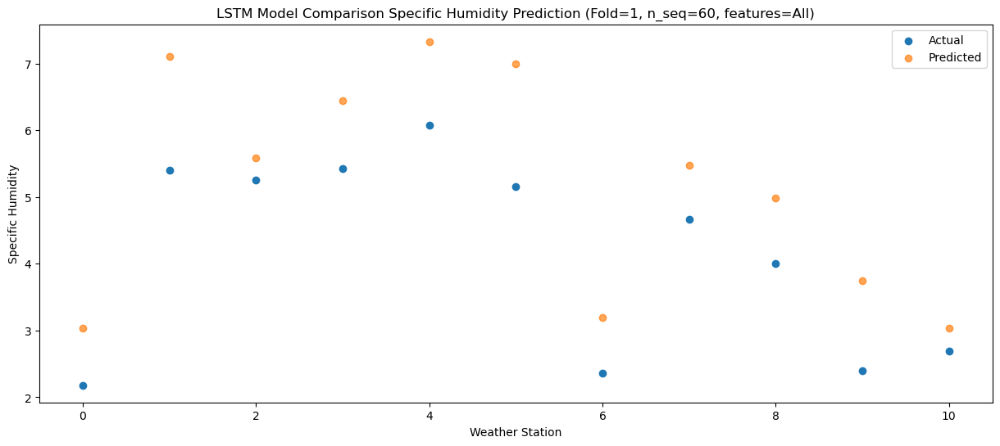

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -0.45   1.371261
1                 1    2.34   5.431261
2                 2    2.08   3.921261
3                 3    3.33   4.771261
4                 4    3.59   5.661261
5                 5    4.60   5.331261
6                 6   -0.75   1.521261
7                 7    2.65   3.811261
8                 8    2.89   3.321261
9                 9    2.08   2.071261
10               10    0.31   1.371261


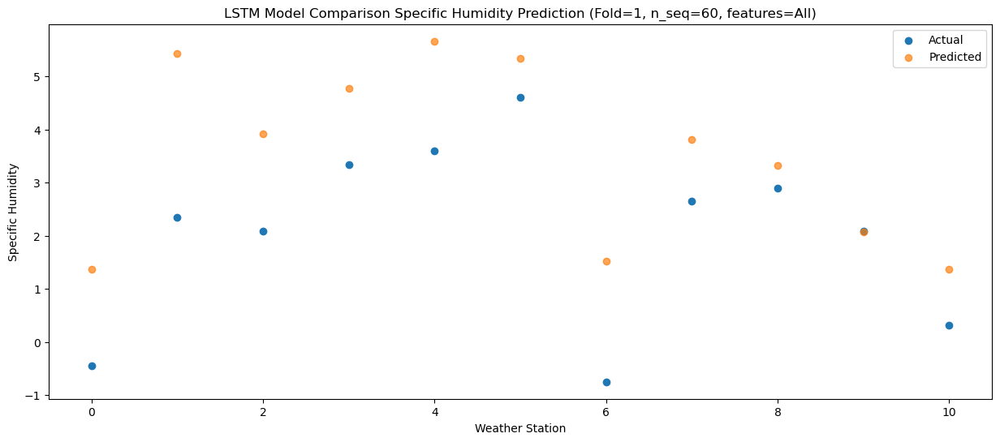

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.66  -0.386817
1                 1   -0.25   3.673183
2                 2   -0.69   2.163183
3                 3    0.78   3.013183
4                 4    0.77   3.903183
5                 5    2.16   3.573183
6                 6   -3.47  -0.236817
7                 7    0.33   2.053183
8                 8    0.61   1.563183
9                 9    0.22   0.313183
10               10   -1.85  -0.386817


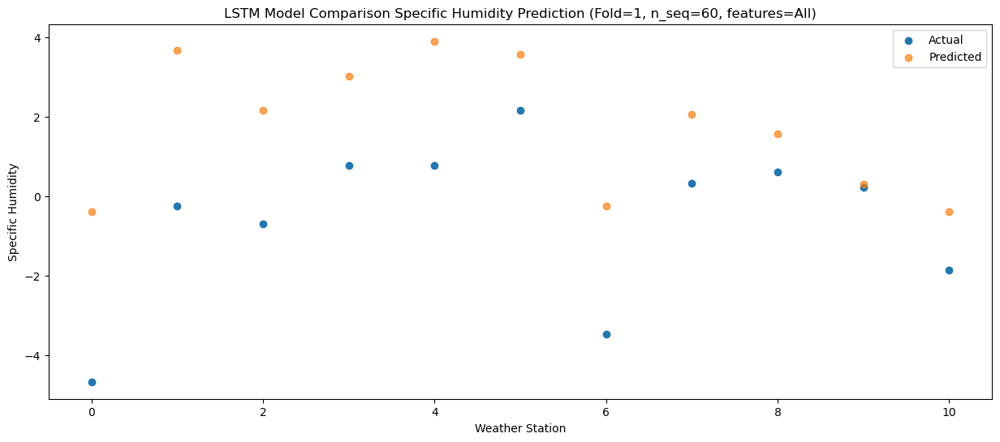

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -4.44  -0.316031
1                 1   -0.23   3.743969
2                 2   -0.54   2.233969
3                 3    0.44   3.083969
4                 4    0.52   3.973969
5                 5    2.99   3.643969
6                 6   -3.58  -0.166031
7                 7    0.20   2.123969
8                 8    0.77   1.633969
9                 9    0.41   0.383969
10               10   -2.58  -0.316031


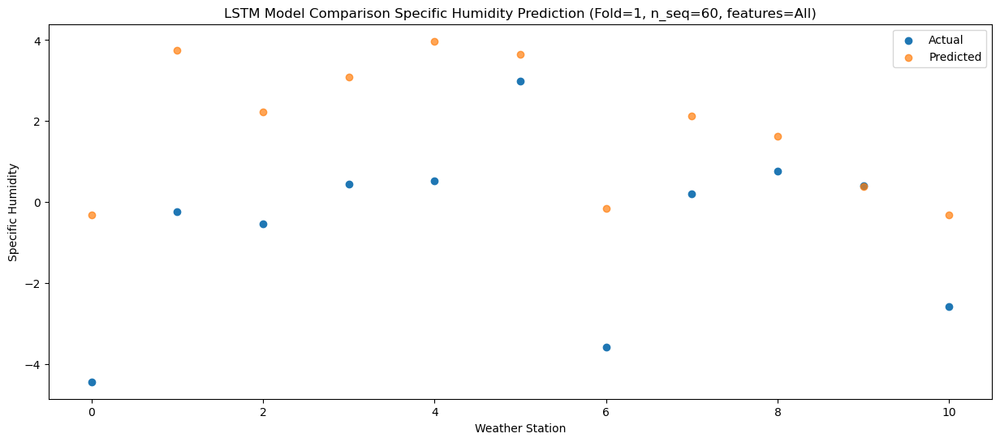

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -4.12  -1.089753
1                 1   -0.04   2.970247
2                 2   -0.54   1.460247
3                 3    0.51   2.310247
4                 4    0.56   3.200247
5                 5    2.36   2.870247
6                 6   -3.46  -0.939753
7                 7   -0.32   1.350247
8                 8   -0.04   0.860247
9                 9   -0.33  -0.389753
10               10   -2.54  -1.089753


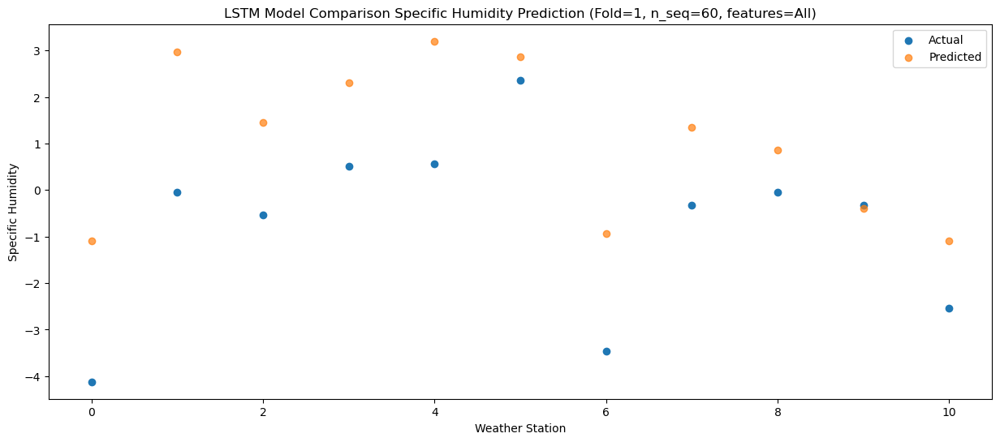

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -2.59     1.1031
1                 1    1.49     5.1631
2                 2    2.08     3.6531
3                 3    3.15     4.5031
4                 4    3.28     5.3931
5                 5    3.15     5.0631
6                 6   -1.90     1.2531
7                 7    2.41     3.5431
8                 8    2.57     3.0531
9                 9    1.49     1.8031
10               10   -1.30     1.1031


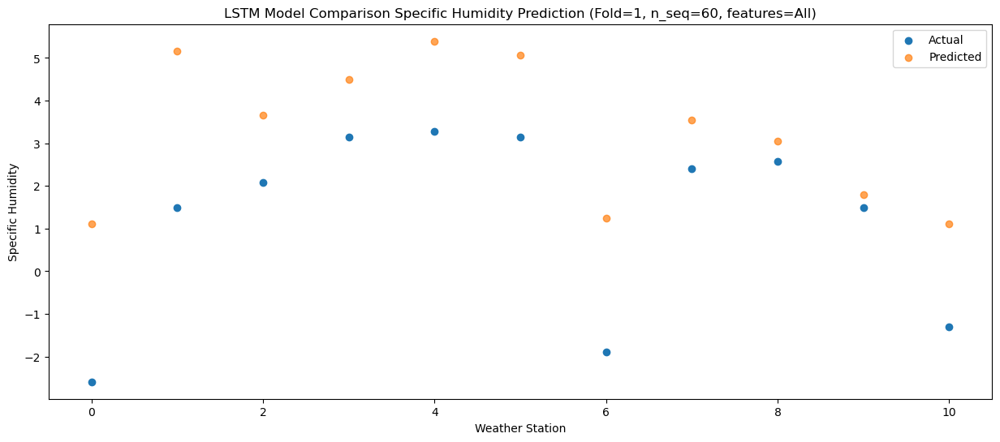

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   -2.39    2.00793
1                 1    1.85    6.06793
2                 2    1.79    4.55793
3                 3    4.49    5.40793
4                 4    4.54    6.29793
5                 5    4.45    5.96793
6                 6   -1.28    2.15793
7                 7    3.64    4.44793
8                 8    3.73    3.95793
9                 9    1.66    2.70793
10               10    0.07    2.00793


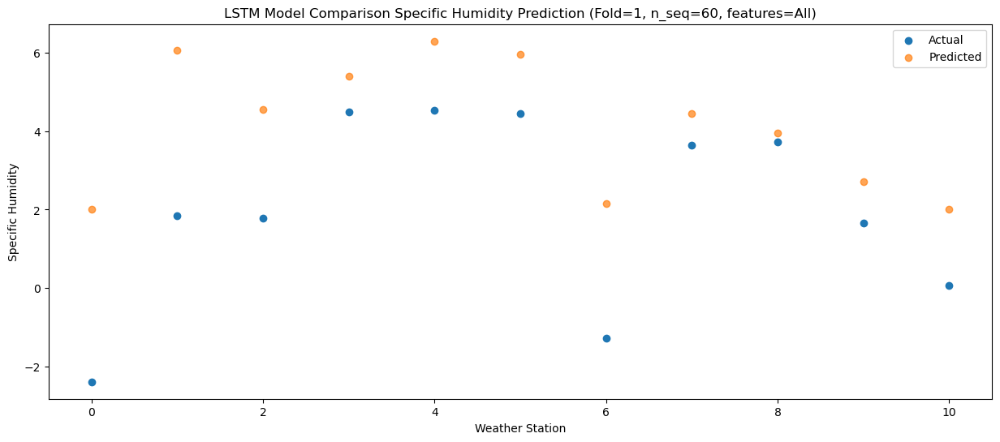

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    0.29   4.971813
1                 1    4.77   9.031813
2                 2    4.63   7.521813
3                 3    8.38   8.371813
4                 4    8.57   9.261813
5                 5    8.76   8.931813
6                 6    1.65   5.121813
7                 7    6.85   7.411813
8                 8    7.95   6.921813
9                 9    6.81   5.671813
10               10    1.60   4.971813


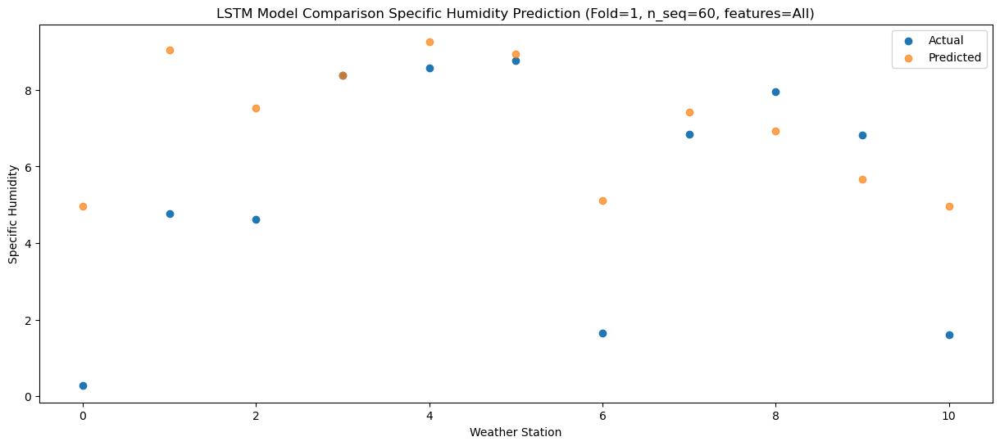

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    5.45    8.75439
1                 1    8.75   12.81439
2                 2    9.15   11.30439
3                 3   11.57   12.15439
4                 4   11.98   13.04439
5                 5   10.93   12.71439
6                 6    6.00    8.90439
7                 7   11.61   11.19439
8                 8   11.09   10.70439
9                 9    9.80    9.45439
10               10    6.92    8.75439


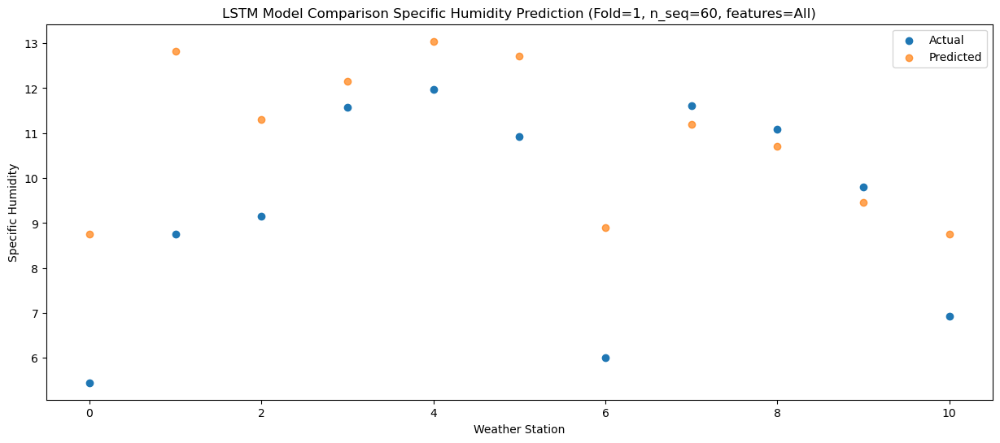

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    6.60   9.936332
1                 1   10.62  13.996332
2                 2   10.74  12.486332
3                 3   12.05  13.336332
4                 4   12.16  14.226332
5                 5   12.26  13.896332
6                 6    8.50  10.086332
7                 7   12.24  12.376332
8                 8   12.14  11.886332
9                 9   11.04  10.636332
10               10    8.78   9.936332


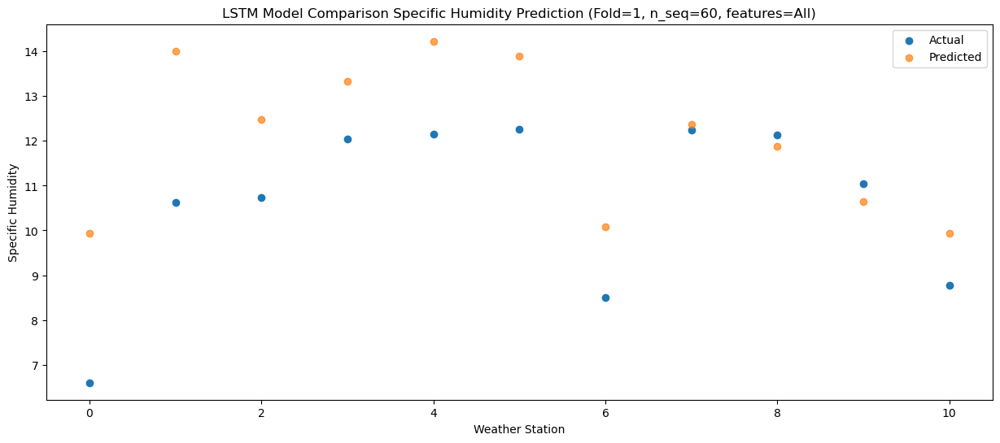

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    7.36   9.666057
1                 1   10.83  13.726057
2                 2   10.96  12.216057
3                 3   12.39  13.066057
4                 4   12.20  13.956057
5                 5   12.48  13.626057
6                 6    8.79   9.816057
7                 7   12.09  12.106057
8                 8   11.72  11.616057
9                 9   10.01  10.366057
10               10    9.12   9.666057


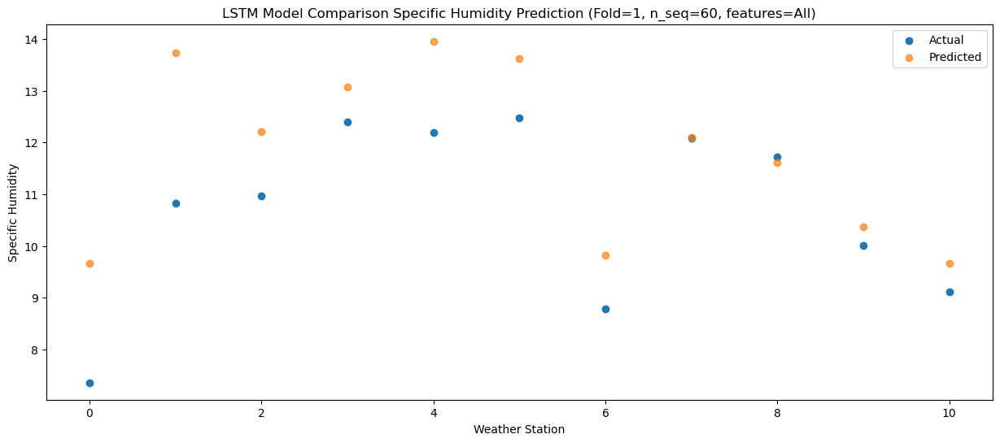

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    3.88   6.432801
1                 1    7.88  10.492801
2                 2    8.20   8.982801
3                 3    9.30   9.832801
4                 4    9.10  10.722801
5                 5    8.94  10.392801
6                 6    5.44   6.582801
7                 7    8.84   8.872801
8                 8    8.15   8.382801
9                 9    7.05   7.132801
10               10    5.93   6.432801


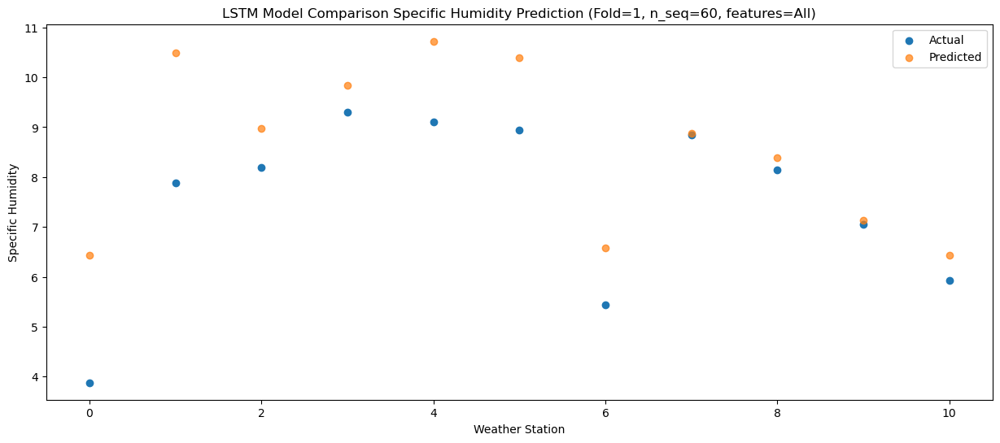

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    1.30   4.463222
1                 1    5.84   8.523222
2                 2    5.45   7.013222
3                 3    7.05   7.863222
4                 4    7.15   8.753222
5                 5    5.83   8.423222
6                 6    3.31   4.613222
7                 7    6.11   6.903222
8                 8    5.71   6.413222
9                 9    3.61   5.163222
10               10    4.07   4.463222


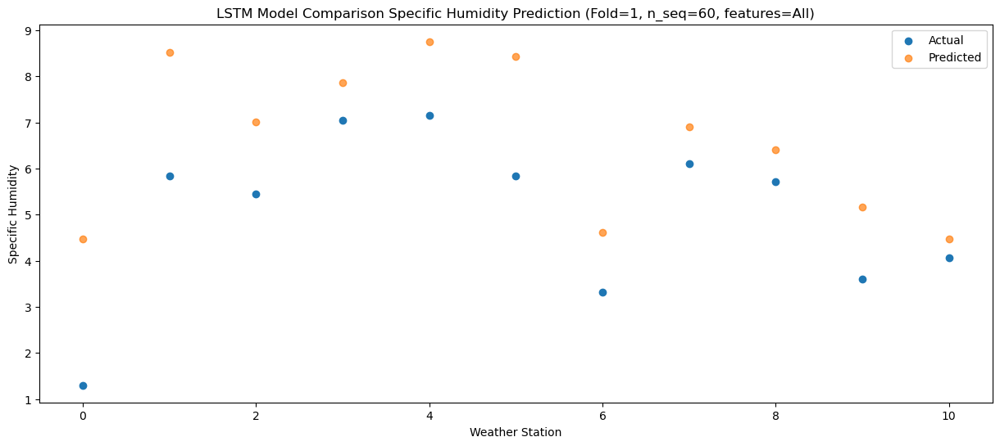

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -4.36   0.782439
1                 1    0.25   4.842439
2                 2   -0.05   3.332439
3                 3    2.60   4.182439
4                 4    2.56   5.072439
5                 5    3.99   4.742439
6                 6   -2.62   0.932439
7                 7    1.55   3.222439
8                 8    2.18   2.732439
9                 9    1.25   1.482439
10               10   -1.12   0.782439


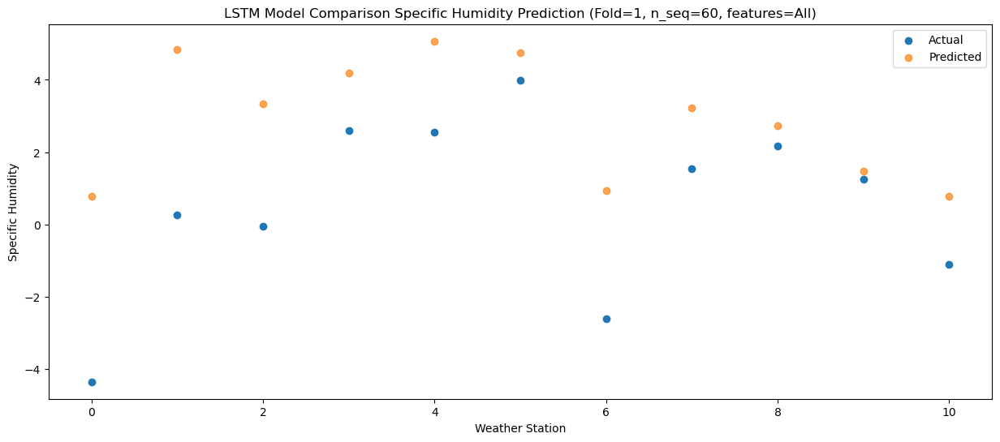

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -2.25   1.149744
1                 1    2.42   5.209744
2                 2    2.59   3.699744
3                 3    5.52   4.549744
4                 4    5.49   5.439744
5                 5    2.94   5.109744
6                 6   -0.75   1.299744
7                 7    3.19   3.589744
8                 8    1.57   3.099744
9                 9    0.27   1.849744
10               10   -1.24   1.149744


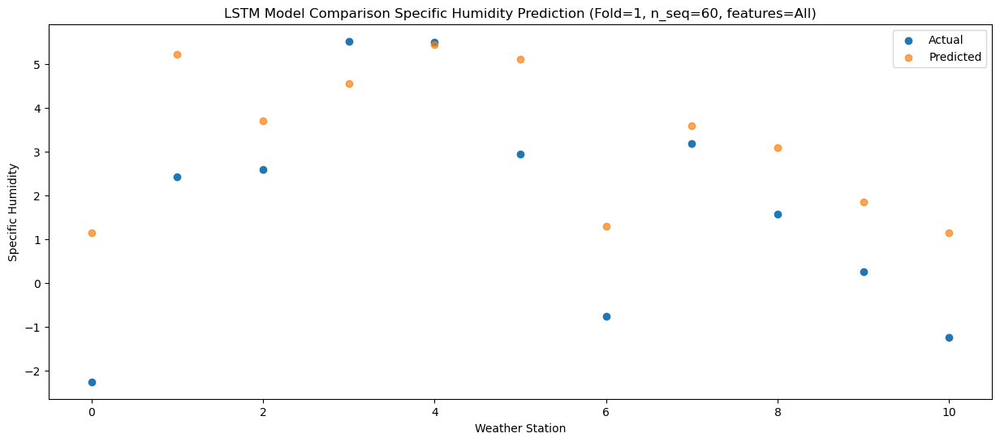

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.50  -0.911006
1                 1   -0.58   3.148994
2                 2   -1.29   1.638994
3                 3   -0.13   2.488994
4                 4   -0.05   3.378994
5                 5    1.67   3.048994
6                 6   -3.75  -0.761006
7                 7   -0.56   1.528994
8                 8   -0.41   1.038994
9                 9   -0.37  -0.211006
10               10   -2.85  -0.911006


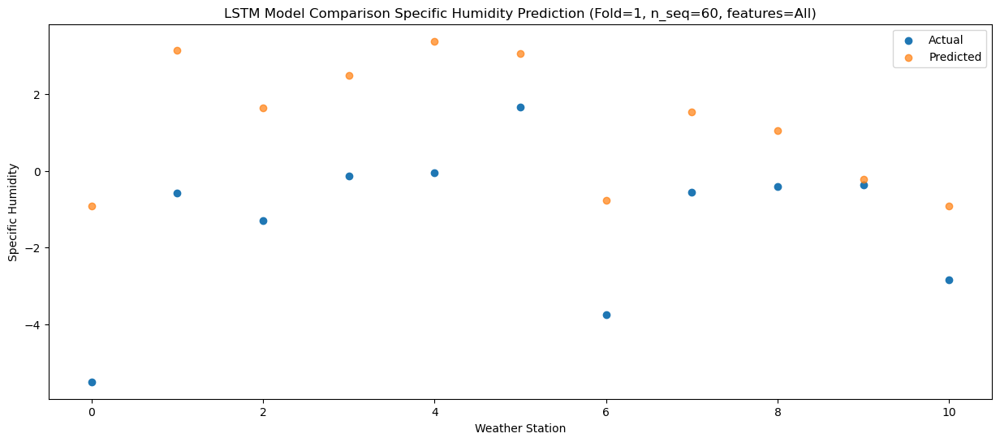

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -3.56  -0.461691
1                 1    0.37   3.598309
2                 2   -0.26   2.088309
3                 3    0.04   2.938309
4                 4    0.15   3.828309
5                 5    1.55   3.498309
6                 6   -2.62  -0.311691
7                 7    0.12   1.978309
8                 8    0.12   1.488309
9                 9   -0.45   0.238309
10               10   -2.11  -0.461691


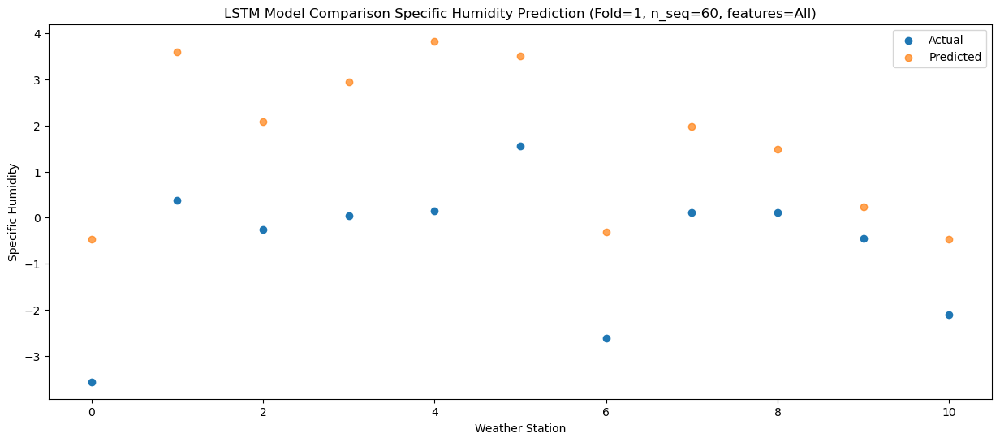

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.45   0.808856
1                 1    1.05   4.868856
2                 2    0.53   3.358856
3                 3    1.72   4.208856
4                 4    1.85   5.098856
5                 5    2.10   4.768856
6                 6   -1.87   0.958856
7                 7    1.65   3.248856
8                 8    1.21   2.758856
9                 9    0.51   1.508856
10               10   -1.09   0.808856


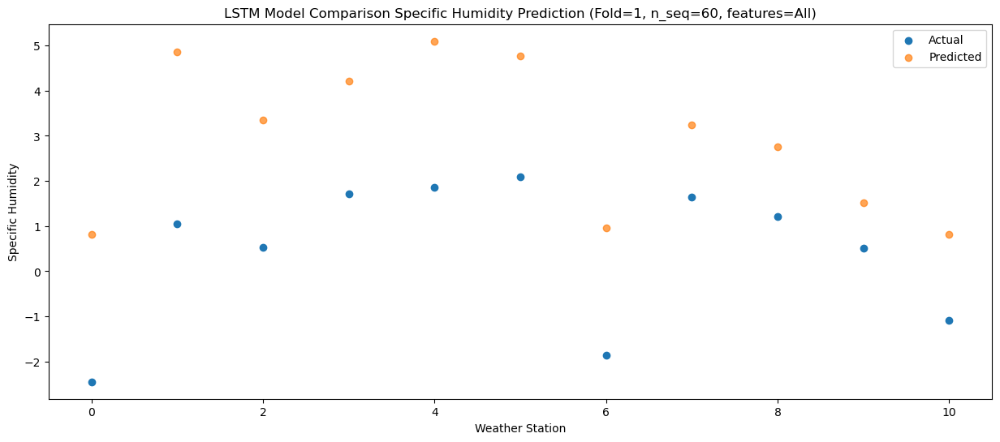

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   -1.43   2.726821
1                 1    2.11   6.786821
2                 2    2.29   5.276821
3                 3    5.88   6.126821
4                 4    5.95   7.016821
5                 5    4.37   6.686821
6                 6   -0.68   2.876821
7                 7    3.84   5.166821
8                 8    4.33   4.676821
9                 9    1.48   3.426821
10               10   -0.43   2.726821


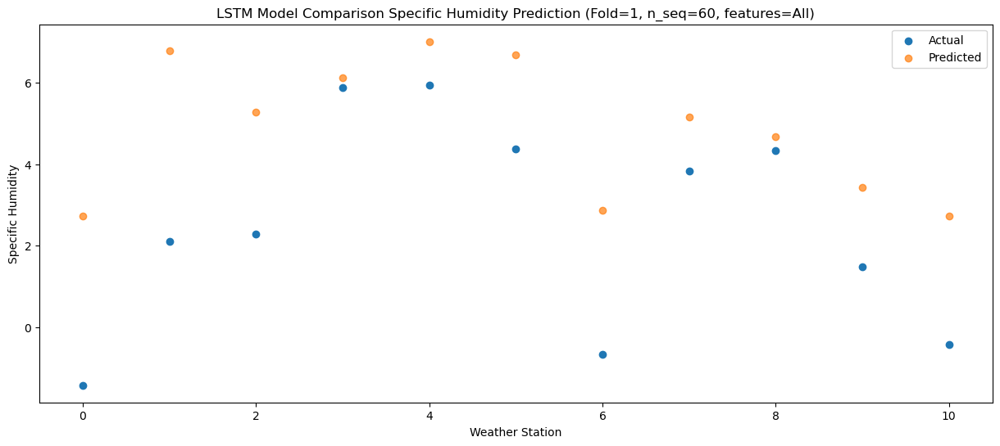

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    2.55   6.477785
1                 1    6.28  10.537785
2                 2    6.65   9.027785
3                 3    9.69   9.877785
4                 4    9.83  10.767785
5                 5    6.14  10.437785
6                 6    3.58   6.627785
7                 7    8.29   8.917785
8                 8    8.57   8.427785
9                 9    4.04   7.177785
10               10    3.70   6.477785


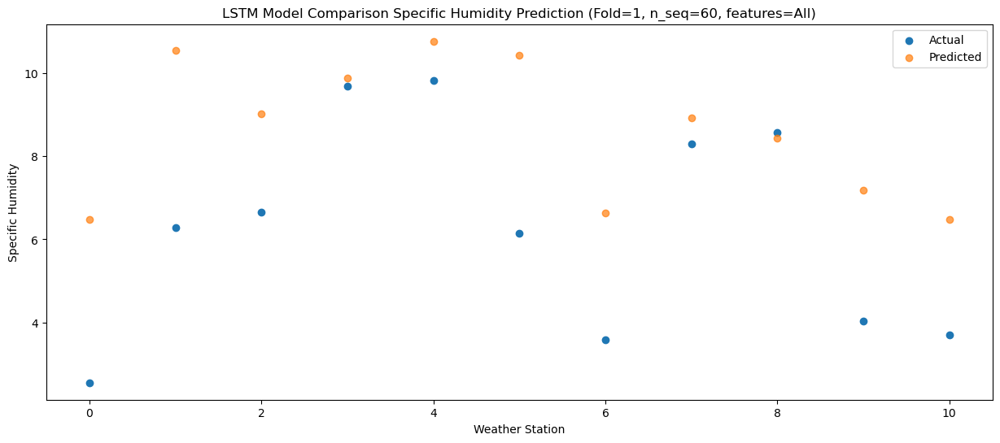

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    4.85    8.56687
1                 1    8.68   12.62687
2                 2    9.74   11.11687
3                 3   10.74   11.96687
4                 4   10.95   12.85687
5                 5    8.74   12.52687
6                 6    6.30    8.71687
7                 7   11.05   11.00687
8                 8   10.47   10.51687
9                 9    8.22    9.26687
10               10    5.29    8.56687


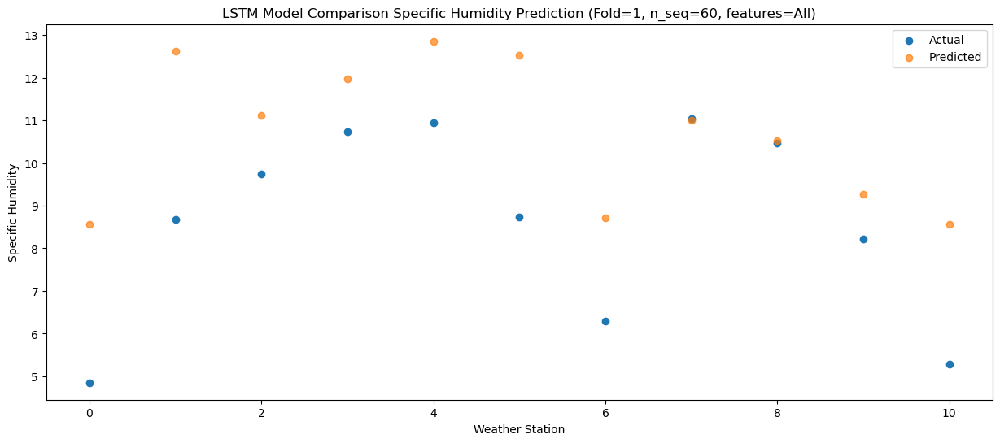

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    7.47  10.180816
1                 1   11.35  14.240816
2                 2   11.37  12.730816
3                 3   11.66  13.580816
4                 4   11.70  14.470816
5                 5    9.69  14.140816
6                 6    9.29  10.330816
7                 7   12.02  12.620816
8                 8    9.83  12.130816
9                 9    8.87  10.880816
10               10    8.92  10.180816


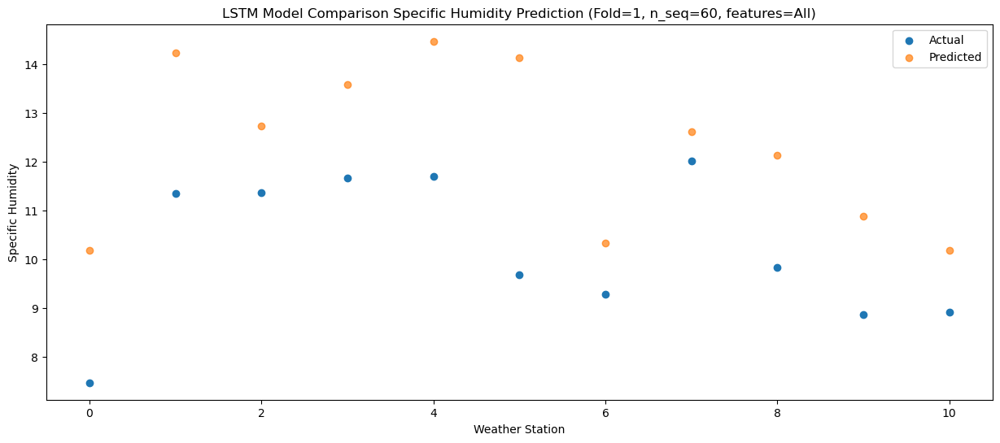

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    6.47    9.80626
1                 1   10.94   13.86626
2                 2   10.50   12.35626
3                 3   11.91   13.20626
4                 4   12.08   14.09626
5                 5   11.80   13.76626
6                 6    8.20    9.95626
7                 7   11.93   12.24626
8                 8   10.57   11.75626
9                 9    9.28   10.50626
10               10    8.49    9.80626


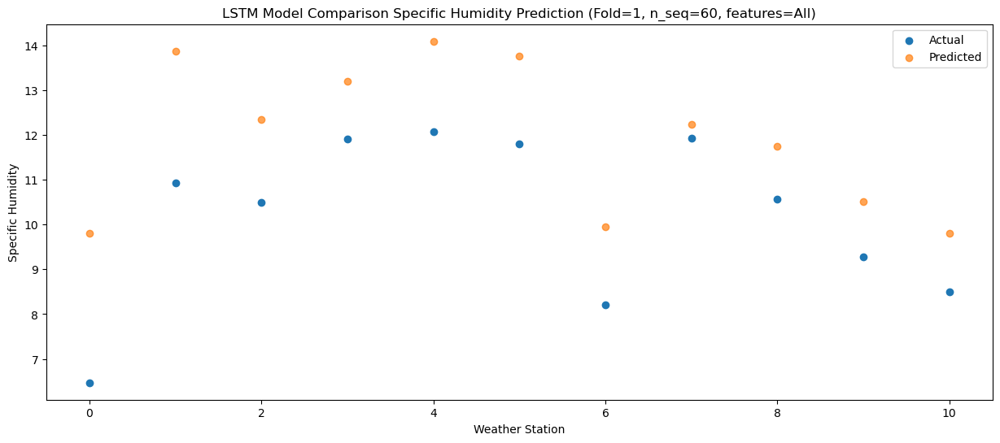

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    3.85   7.003468
1                 1    7.58  11.063468
2                 2    6.99   9.553468
3                 3    8.62  10.403468
4                 4    8.73  11.293468
5                 5   10.53  10.963468
6                 6    4.72   7.153468
7                 7    7.97   9.443468
8                 8    7.83   8.953468
9                 9    7.28   7.703468
10               10    5.24   7.003468


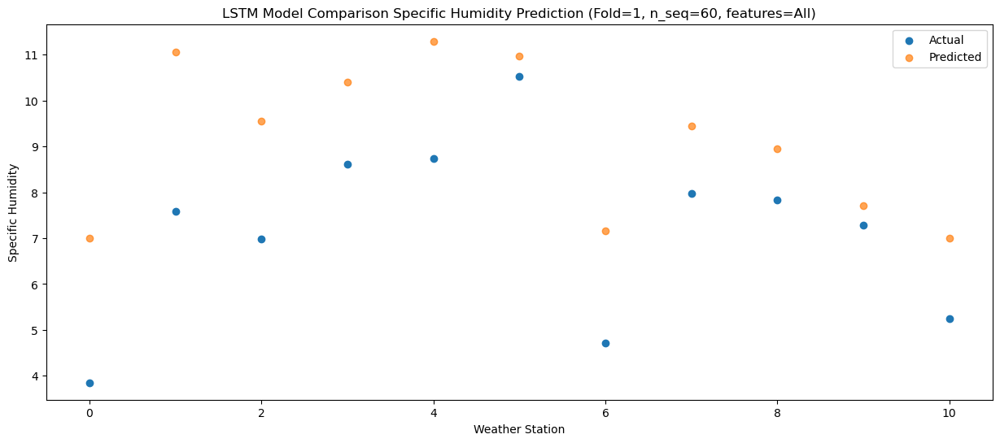

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.01   2.947264
1                 1    2.69   7.007264
2                 2    1.88   5.497264
3                 3    3.66   6.347264
4                 4    3.83   7.237264
5                 5    7.34   6.907264
6                 6   -0.34   3.097264
7                 7    3.43   5.387264
8                 8    3.88   4.897264
9                 9    3.89   3.647264
10               10    1.80   2.947264


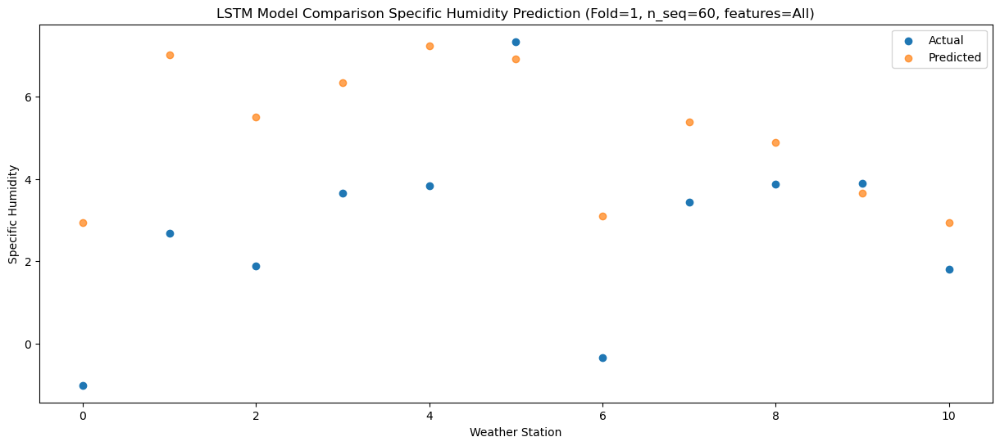

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.54   1.835116
1                 1    2.21   5.895116
2                 2    1.51   4.385116
3                 3    3.16   5.235116
4                 4    3.45   6.125116
5                 5    4.47   5.795116
6                 6   -0.83   1.985116
7                 7    2.18   4.275116
8                 8    2.90   3.785116
9                 9    1.91   2.535116
10               10    0.30   1.835116


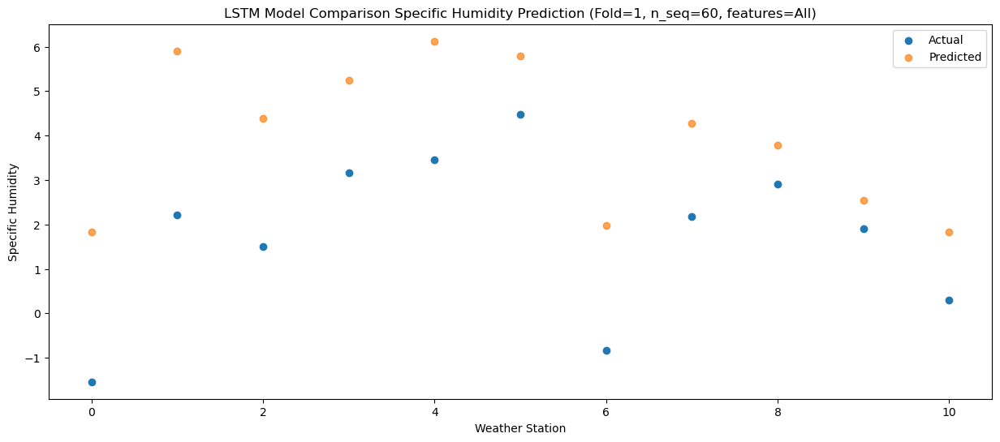

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -4.26   0.790475
1                 1    0.62   4.850475
2                 2    0.82   3.340475
3                 3    2.35   4.190475
4                 4    2.63   5.080475
5                 5    3.80   4.750475
6                 6   -2.73   0.940475
7                 7    1.27   3.230475
8                 8    1.16   2.740475
9                 9    0.70   1.490475
10               10   -1.83   0.790475


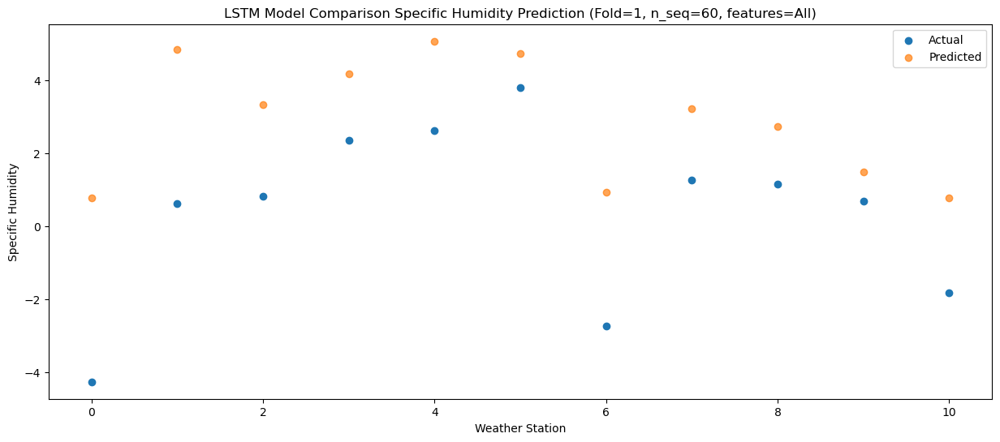

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -3.80   1.023072
1                 1    1.03   5.083072
2                 2    0.79   3.573072
3                 3    1.93   4.423072
4                 4    2.15   5.313072
5                 5    2.25   4.983072
6                 6   -2.37   1.173072
7                 7    1.39   3.463072
8                 8    0.68   2.973072
9                 9    0.39   1.723072
10               10   -0.97   1.023072


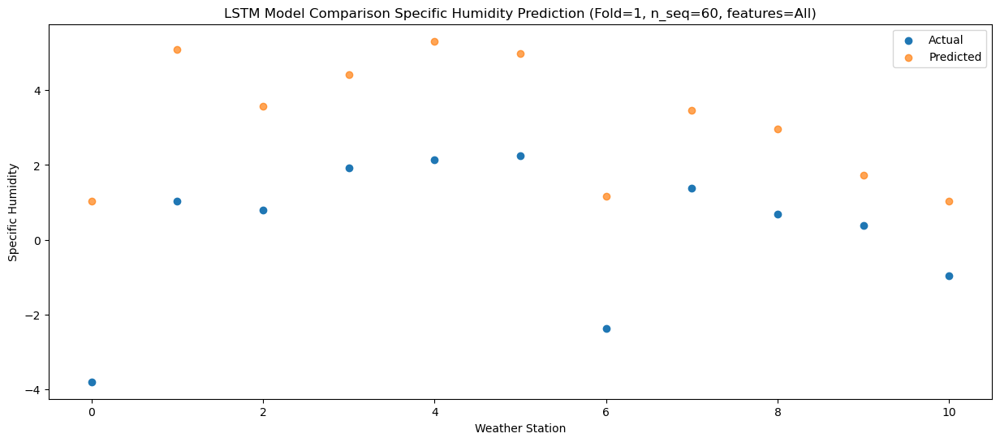

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -2.19   1.015304
1                 1    2.15   5.075304
2                 2    1.84   3.565304
3                 3    2.71   4.415304
4                 4    2.75   5.305304
5                 5    2.28   4.975304
6                 6   -1.17   1.165304
7                 7    1.49   3.455304
8                 8    1.01   2.965304
9                 9    0.25   1.715304
10               10   -1.77   1.015304


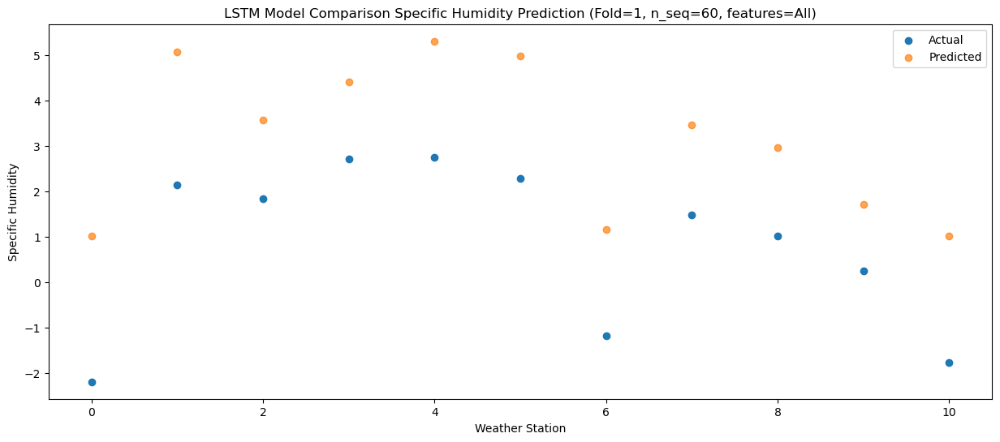

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.57   1.815716
1                 1    1.28   5.875716
2                 2    1.37   4.365716
3                 3    4.26   5.215716
4                 4    4.45   6.105716
5                 5    3.33   5.775716
6                 6   -1.93   1.965716
7                 7    2.25   4.255716
8                 8    2.43   3.765716
9                 9    1.04   2.515716
10               10   -1.74   1.815716


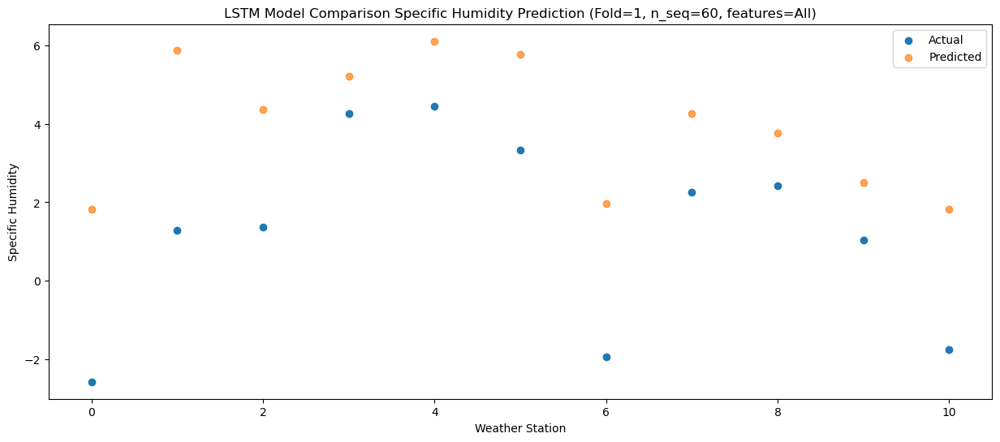

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   -0.87   3.012576
1                 1    2.88   7.072576
2                 2    2.73   5.562576
3                 3    4.63   6.412576
4                 4    4.90   7.302576
5                 5    3.59   6.972576
6                 6   -0.12   3.162576
7                 7    3.45   5.452576
8                 8    3.65   4.962576
9                 9    1.56   3.712576
10               10    0.87   3.012576


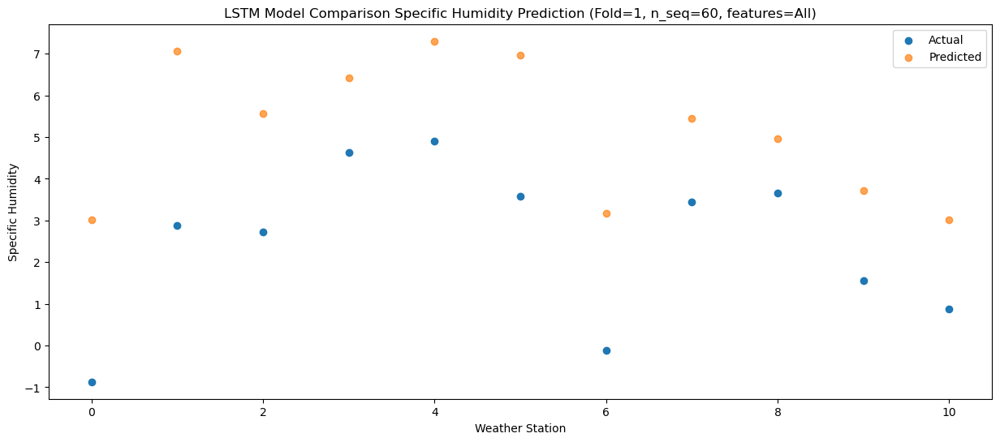

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    0.33   6.114562
1                 1    5.62  10.174562
2                 2    6.03   8.664562
3                 3    8.41   9.514562
4                 4    8.57  10.404562
5                 5    7.96  10.074562
6                 6    2.44   6.264562
7                 7    7.49   8.554562
8                 8    8.70   8.064562
9                 9    7.29   6.814562
10               10    1.17   6.114562


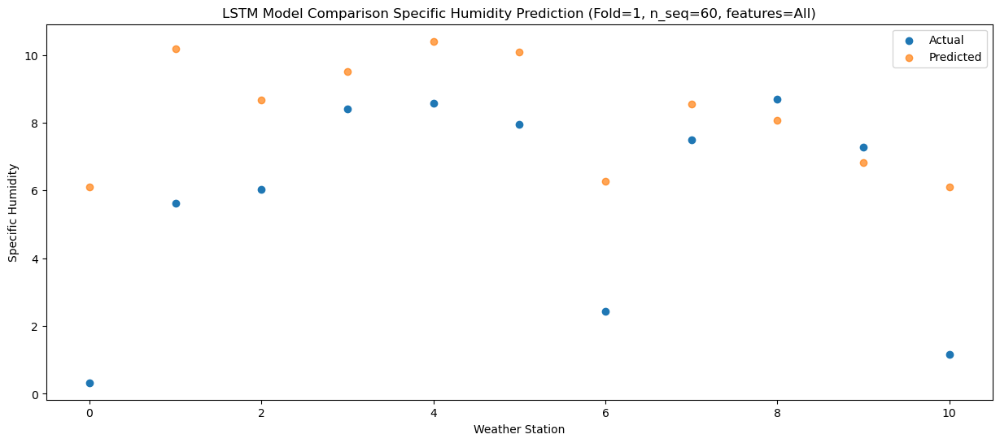

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    3.68   8.712209
1                 1    7.97  12.772209
2                 2    8.68  11.262209
3                 3   11.81  12.112209
4                 4   11.83  13.002209
5                 5    7.91  12.672209
6                 6    5.02   8.862209
7                 7   10.41  11.152209
8                 8   11.28  10.662209
9                 9    8.90   9.412209
10               10    4.46   8.712209


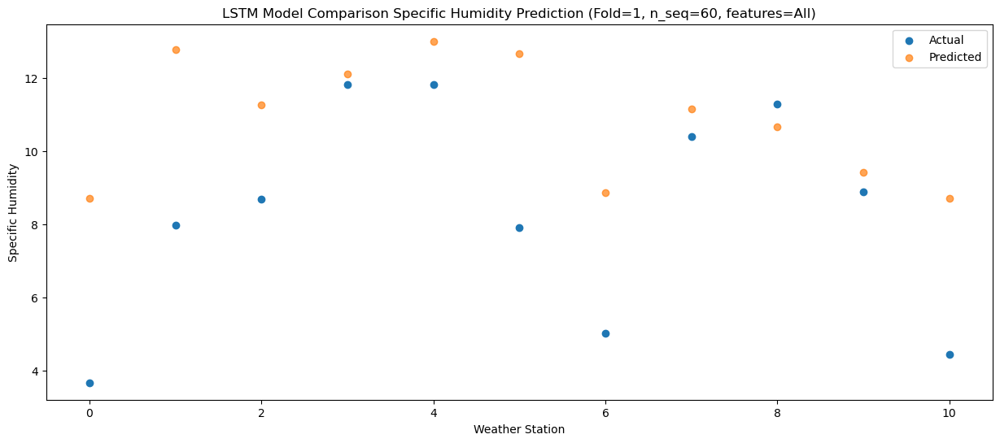

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    7.09  10.533579
1                 1   10.93  14.593579
2                 2   11.82  13.083579
3                 3   12.37  13.933579
4                 4   11.91  14.823579
5                 5   10.08  14.493579
6                 6    8.64  10.683579
7                 7   12.98  12.973579
8                 8   11.51  12.483579
9                 9   10.83  11.233579
10               10    9.17  10.533579


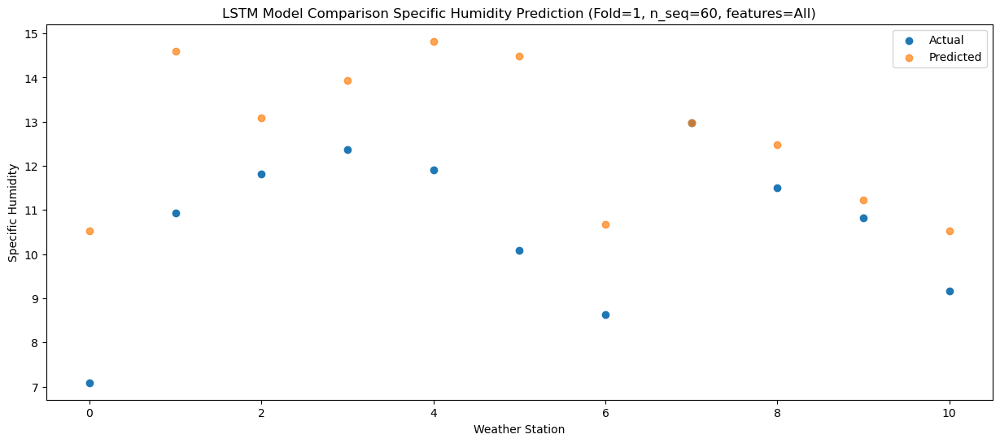

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    6.92   9.773674
1                 1   11.06  13.833674
2                 2   11.75  12.323674
3                 3   10.70  13.173674
4                 4   10.51  14.063674
5                 5   10.23  13.733674
6                 6    8.53   9.923674
7                 7   12.56  12.213674
8                 8    9.68  11.723674
9                 9    8.92  10.473674
10               10    6.88   9.773674


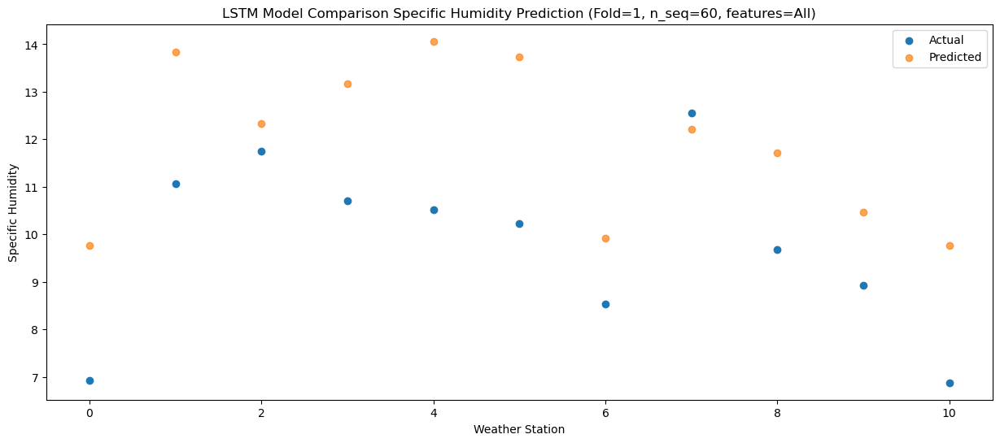

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    3.06   7.885377
1                 1    7.95  11.945377
2                 2    7.94  10.435377
3                 3    9.50  11.285377
4                 4    9.76  12.175377
5                 5    9.87  11.845377
6                 6    5.56   8.035377
7                 7    8.07  10.325377
8                 8    8.73   9.835377
9                 9    7.27   8.585377
10               10    5.62   7.885377


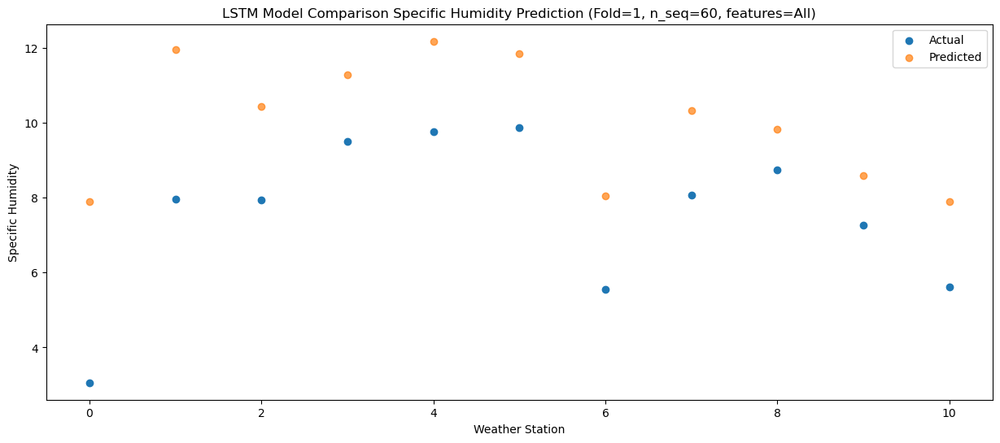

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   -0.34   4.206608
1                 1    4.10   8.266608
2                 2    3.43   6.756608
3                 3    6.08   7.606608
4                 4    6.37   8.496608
5                 5    7.89   8.166608
6                 6    1.31   4.356608
7                 7    4.82   6.646608
8                 8    5.30   6.156608
9                 9    4.16   4.906608
10               10    2.57   4.206608


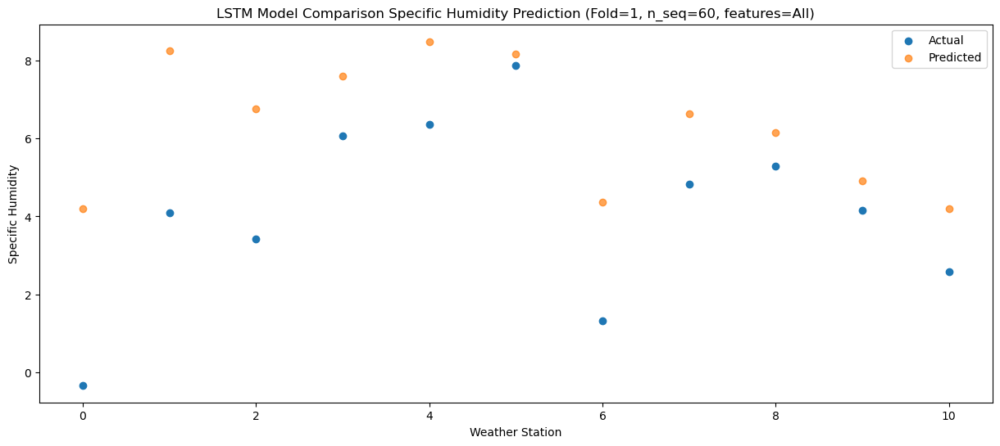

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -3.40   1.249076
1                 1    1.09   5.309076
2                 2    0.88   3.799076
3                 3    2.75   4.649076
4                 4    3.03   5.539076
5                 5    5.26   5.209076
6                 6   -2.04   1.399076
7                 7    2.11   3.689076
8                 8    2.63   3.199076
9                 9    1.84   1.949076
10               10   -1.09   1.249076


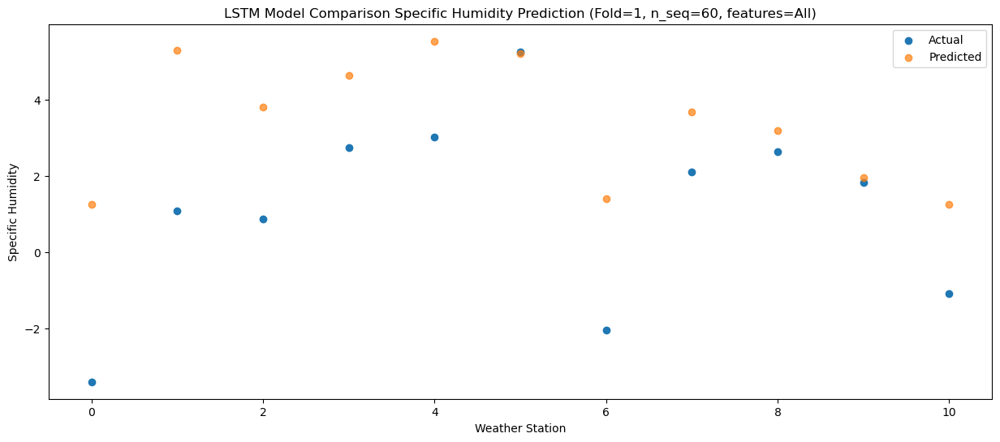

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -4.15   0.739233
1                 1    0.51   4.799233
2                 2   -0.14   3.289233
3                 3    1.11   4.139233
4                 4    1.31   5.029233
5                 5    3.39   4.699233
6                 6   -2.54   0.889233
7                 7    0.72   3.179233
8                 8    1.58   2.689233
9                 9    1.40   1.439233
10               10   -0.85   0.739233


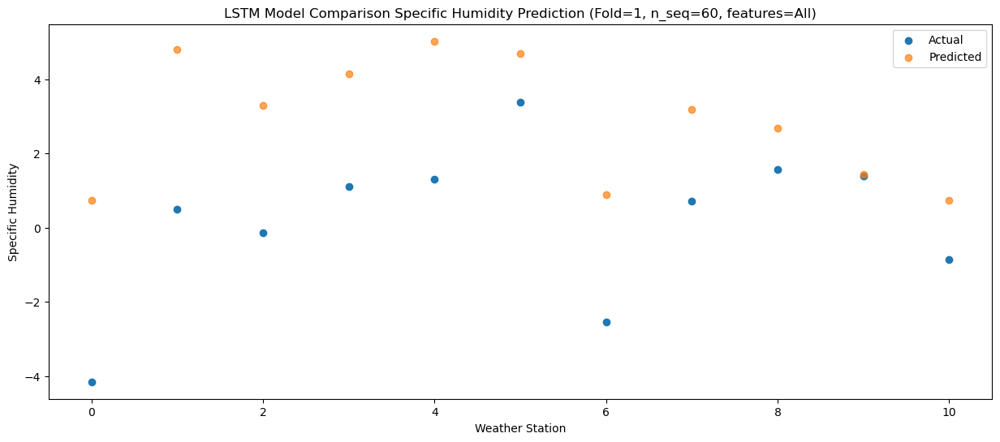

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -4.54  -0.326992
1                 1   -0.26   3.733008
2                 2   -0.77   2.223008
3                 3    0.01   3.073008
4                 4    0.14   3.963008
5                 5    2.24   3.633008
6                 6   -3.36  -0.176992
7                 7   -0.35   2.113008
8                 8    0.27   1.623008
9                 9    0.66   0.373008
10               10   -1.90  -0.326992


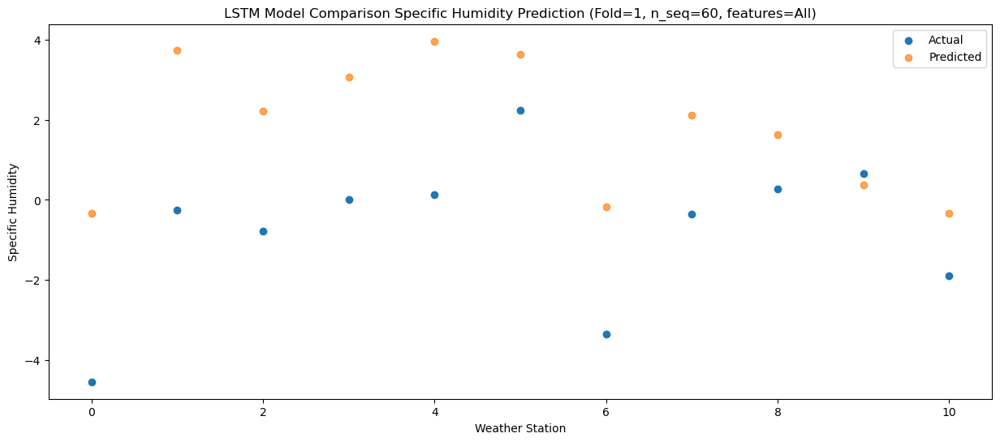

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -4.93   0.962017
1                 1    0.08   5.022017
2                 2    0.03   3.512017
3                 3    2.26   4.362017
4                 4    2.39   5.252017
5                 5    2.65   4.922017
6                 6   -2.88   1.112017
7                 7    1.40   3.402017
8                 8    2.02   2.912017
9                 9    1.33   1.662017
10               10   -2.03   0.962017


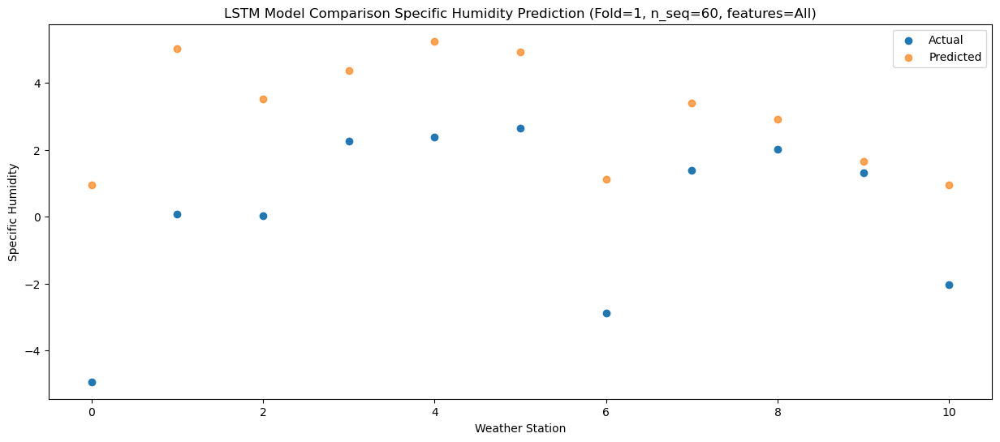

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.52   1.751196
1                 1    1.59   5.811196
2                 2    1.57   4.301196
3                 3    4.17   5.151196
4                 4    4.32   6.041196
5                 5    3.61   5.711196
6                 6   -1.54   1.901196
7                 7    2.59   4.191196
8                 8    3.57   3.701196
9                 9    1.64   2.451196
10               10   -1.00   1.751196


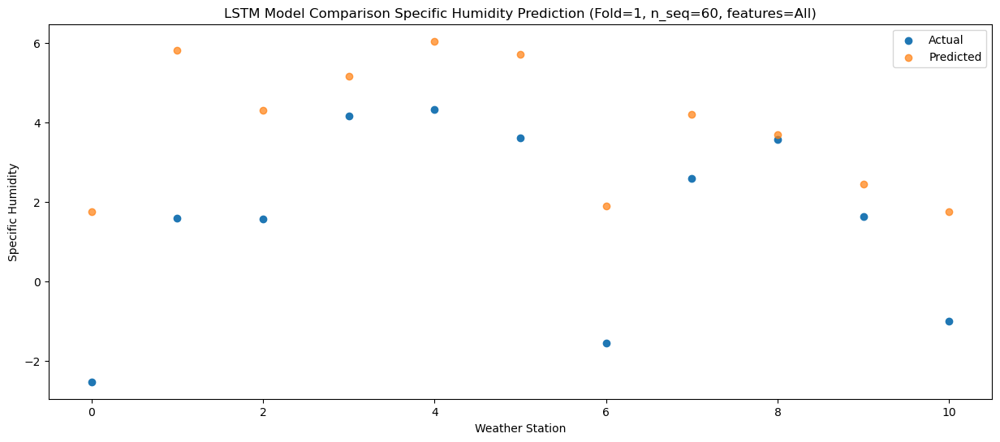

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -1.45   3.866986
1                 1    3.48   7.926986
2                 2    3.56   6.416986
3                 3    6.42   7.266986
4                 4    6.52   8.156986
5                 5    4.25   7.826986
6                 6    0.61   4.016986
7                 7    4.36   6.306986
8                 8    5.89   5.816986
9                 9    2.50   4.566986
10               10    0.61   3.866986


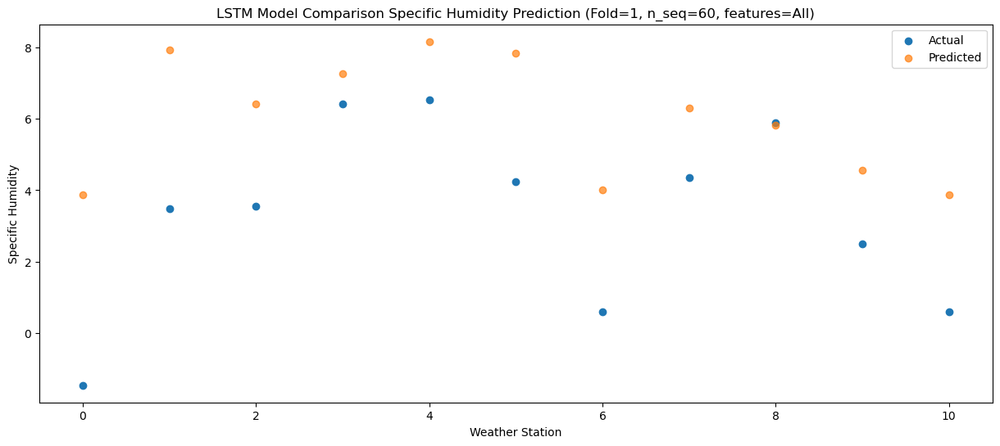

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    2.75   7.024402
1                 1    7.28  11.084402
2                 2    7.69   9.574402
3                 3   10.77  10.424402
4                 4   10.50  11.314402
5                 5    6.68  10.984402
6                 6    4.75   7.174402
7                 7    8.67   9.464402
8                 8    9.49   8.974402
9                 9    5.23   7.724402
10               10    4.19   7.024402


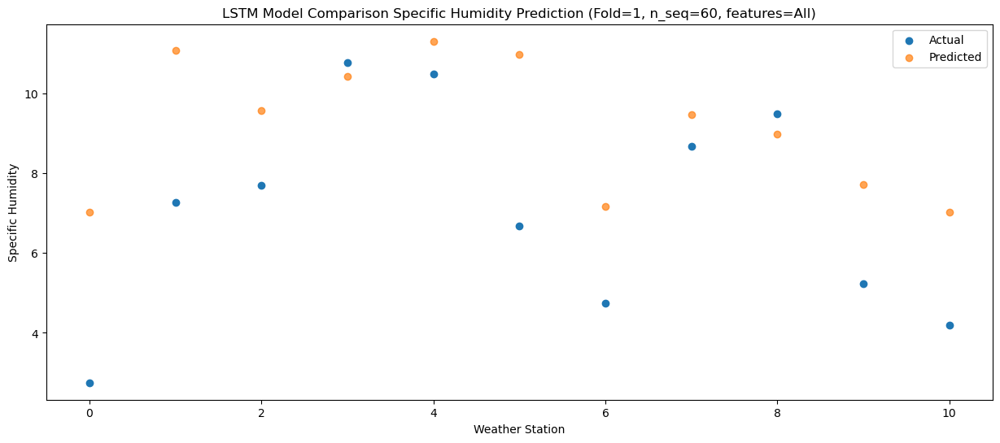

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    4.82   9.353013
1                 1    8.79  13.413013
2                 2    9.12  11.903013
3                 3   12.16  12.753013
4                 4   12.01  13.643013
5                 5   11.53  13.313013
6                 6    6.71   9.503013
7                 7   10.69  11.793013
8                 8   12.40  11.303013
9                 9   10.90  10.053013
10               10    6.01   9.353013


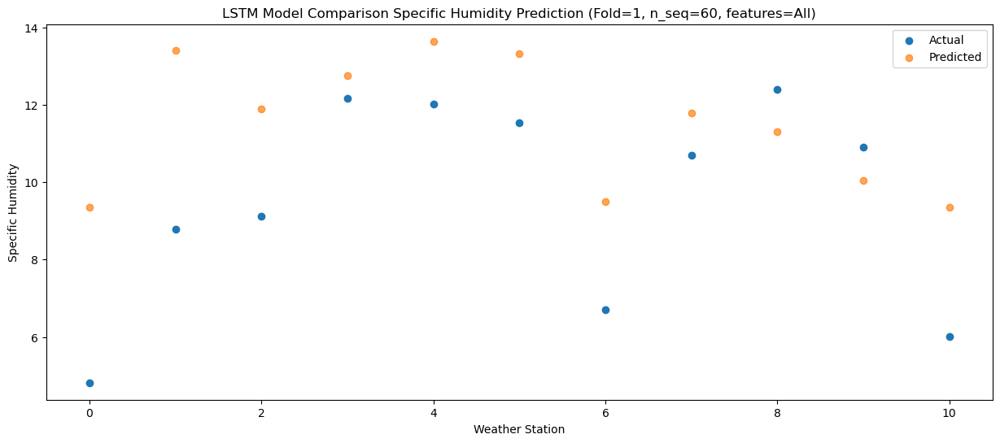

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    7.24  10.608995
1                 1   11.39  14.668995
2                 2   12.29  13.158995
3                 3   12.24  14.008995
4                 4   12.33  14.898995
5                 5   11.38  14.568995
6                 6    9.09  10.758995
7                 7   11.36  13.048995
8                 8   11.01  12.558995
9                 9    9.15  11.308995
10               10    9.38  10.608995


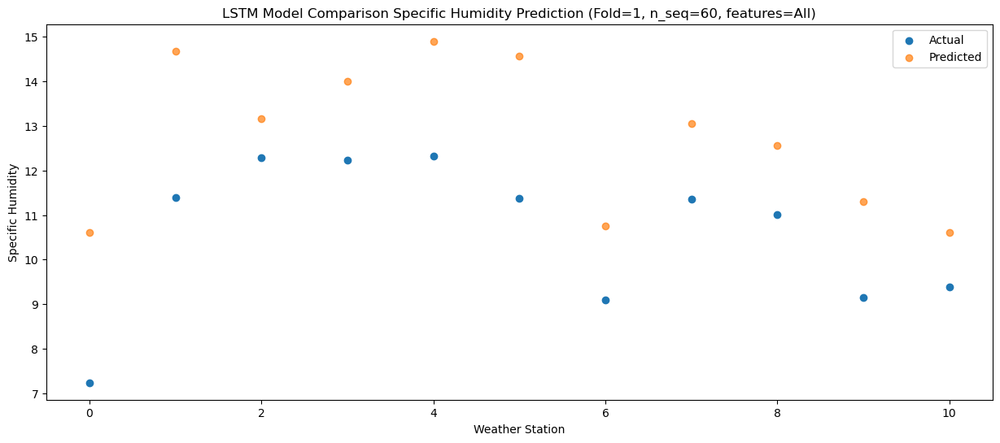

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    6.60  10.227086
1                 1    9.66  14.287086
2                 2   10.17  12.777086
3                 3   12.33  13.627086
4                 4   12.38  14.517086
5                 5   10.24  14.187086
6                 6    7.37  10.377086
7                 7   10.12  12.667086
8                 8   10.42  12.177086
9                 9    9.34  10.927086
10               10    7.80  10.227086


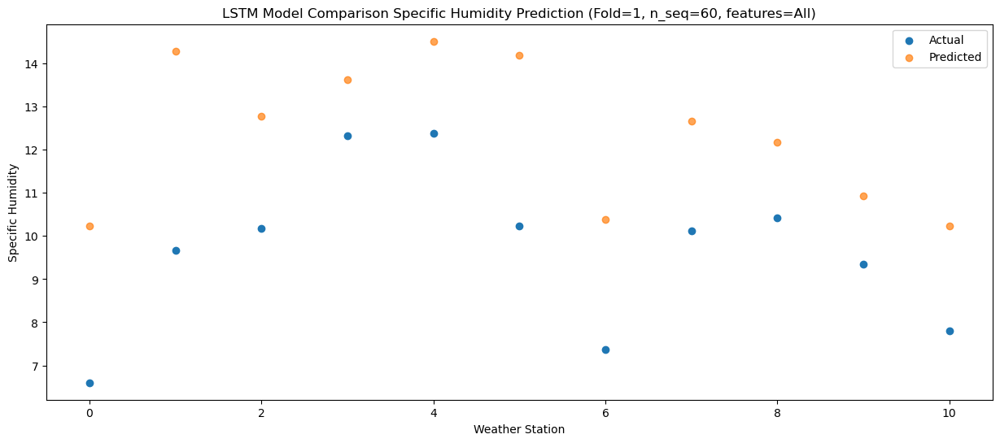

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    4.61   7.436922
1                 1    8.14  11.496922
2                 2    8.62   9.986922
3                 3    9.41  10.836922
4                 4    9.84  11.726922
5                 5   10.72  11.396922
6                 6    6.08   7.586922
7                 7    8.36   9.876922
8                 8    8.51   9.386922
9                 9    6.90   8.136922
10               10    5.31   7.436922


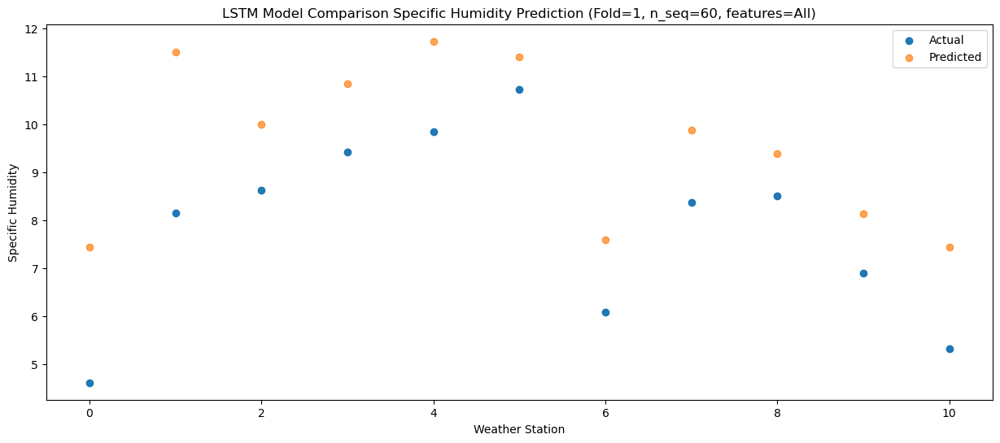

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   -0.34   3.475861
1                 1    4.31   7.535861
2                 2    4.12   6.025861
3                 3    5.36   6.875861
4                 4    5.51   7.765861
5                 5    6.45   7.435861
6                 6    1.94   3.625861
7                 7    3.32   5.915861
8                 8    5.15   5.425861
9                 9    3.91   4.175861
10               10    1.00   3.475861


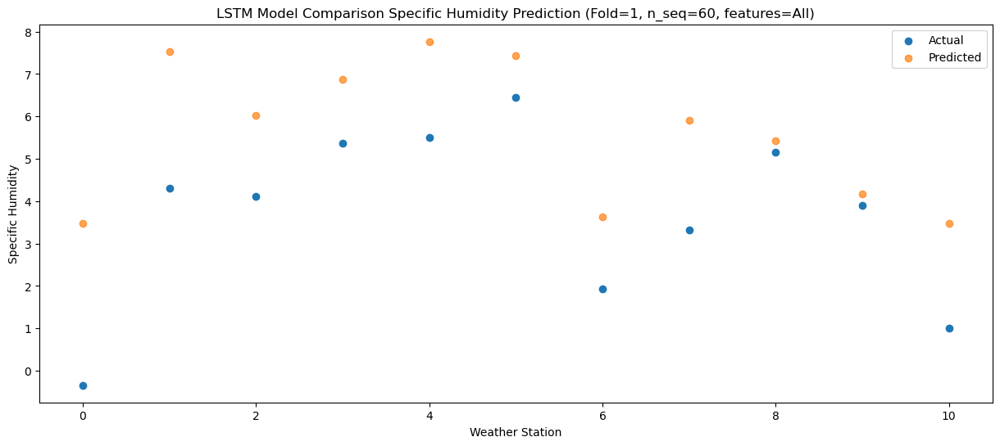

f, t:
[[-3.880e+00  1.110e+00 -5.000e-02  1.890e+00  2.440e+00  4.760e+00
  -2.550e+00  1.260e+00  2.020e+00  1.350e+00 -1.820e+00]
 [-3.280e+00  1.160e+00  8.600e-01  6.900e-01  1.200e+00  3.280e+00
  -2.520e+00  9.300e-01  1.180e+00  7.000e-01 -1.830e+00]
 [-3.470e+00  9.100e-01  3.500e-01  1.590e+00  2.110e+00  3.000e+00
  -2.940e+00  8.500e-01  1.630e+00  5.500e-01 -1.980e+00]
 [-3.560e+00  1.430e+00  7.400e-01  8.900e-01  1.430e+00  3.180e+00
  -2.460e+00  7.300e-01  1.010e+00  5.600e-01 -1.910e+00]
 [-1.260e+00  3.660e+00  3.900e+00  5.250e+00  6.160e+00  5.850e+00
  -4.900e-01  3.390e+00  4.030e+00  2.450e+00 -9.600e-01]
 [-1.520e+00  2.070e+00  2.280e+00  4.910e+00  5.850e+00  4.840e+00
  -1.140e+00  3.650e+00  4.220e+00  2.610e+00 -6.700e-01]
 [ 1.380e+00  5.080e+00  5.050e+00  6.890e+00  7.970e+00  7.520e+00
   2.060e+00  6.550e+00  7.550e+00  5.430e+00  1.900e+00]
 [ 4.620e+00  8.880e+00  8.900e+00  9.010e+00  1.026e+01  9.340e+00
   5.700e+00  1.038e+01  9.690e+00  7.140e+0

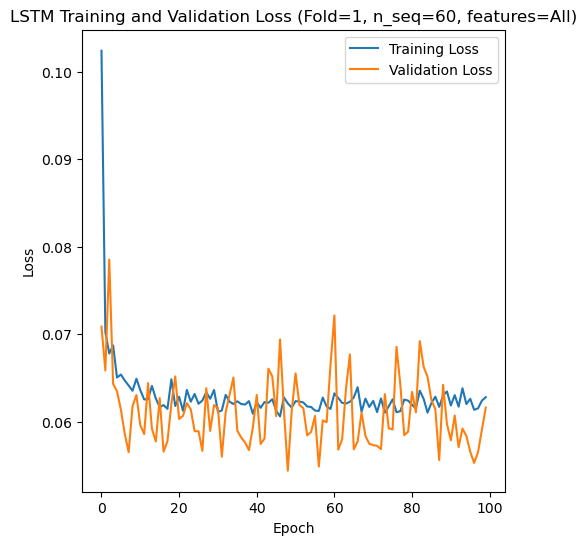

[[ 4.97  3.84  5.83 ... 12.86  8.48  8.25]
 [ 2.46  2.06  3.48 ...  9.57  6.71  5.1 ]
 [ 8.78  8.15  9.01 ... 20.36 15.38 12.95]
 ...
 [ 1.89  2.51  2.73 ...  7.42  4.53  3.35]
 [ 5.04  4.9   5.93 ... 10.09  8.19  4.88]
 [ 5.06  3.79  4.84 ... 13.58  8.96  7.8 ]]
Epoch 1/100
84/84 [==============================] - 50s 291ms/step - loss: 0.1070 - accuracy: 0.2024 - mae: 0.0868 - rmse: 0.1070 - mape: 19.2713 - pearson: 0.6238 - val_loss: 0.0735 - val_accuracy: 0.8000 - val_mae: 0.0568 - val_rmse: 0.0735 - val_mape: 13.6499 - val_pearson: 0.7496
Epoch 2/100
84/84 [==============================] - 15s 184ms/step - loss: 0.0725 - accuracy: 0.3690 - mae: 0.0575 - rmse: 0.0725 - mape: 13.0178 - pearson: 0.7516 - val_loss: 0.0615 - val_accuracy: 0.8000 - val_mae: 0.0499 - val_rmse: 0.0615 - val_mape: 11.2070 - val_pearson: 0.8219
Epoch 3/100
84/84 [==============================] - 16s 186ms/step - loss: 0.0690 - accuracy: 0.3929 - mae: 0.0544 - rmse: 0.0690 - mape: 12.2210 - pearson: 0.7692

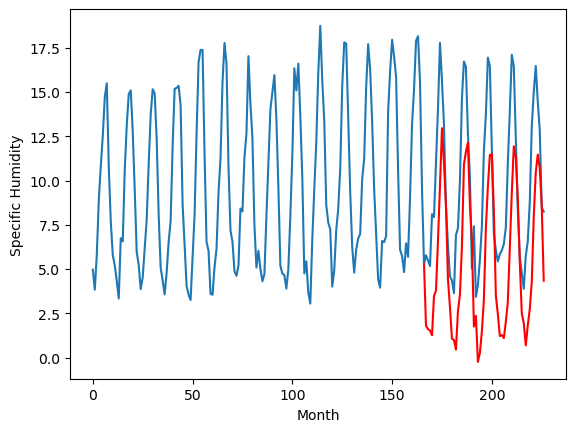

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.34		1.70		-1.64
2.83		1.52		-1.31
2.81		1.44		-1.37
2.87		1.17		-1.70
4.66		3.39		-1.27
4.95		3.70		-1.25
7.85		6.52		-1.33
9.27		9.62		0.35
14.08		12.87		-1.21
12.65		10.91		-1.74
8.59		8.47		-0.12
4.86		4.33		-0.53
4.64		2.77		-1.87
2.91		0.97		-1.94
2.86		0.91		-1.95
2.18		0.36		-1.82
4.03		2.53		-1.50
4.15		3.47		-0.68
9.27		6.20		-3.07
12.18		10.83		-1.35
13.79		11.54		-2.25
12.17		12.06		-0.11
9.35		8.51		-0.84
5.96		6.53		0.57
3.53		1.66		-1.87
2.47		2.27		-0.20
2.14		-0.34		-2.48
2.05		0.17		-1.88
2.93		1.39		-1.54
4.08		3.16		-0.92
6.47		7.21		0.74
10.83		9.56		-1.27
12.17		11.35		-0.82
11.67		11.40		-0.27
9.10		8.21		-0.89
5.42		3.43		-1.99
3.92		2.35		-1.57
2.73		1.13		-1.60
2.72		1.18		-1.54
2.64		1.01		-1.63
3.33		1.93		-1.40
3.95		3.07		-0.88
9.73		6.09		-3.64
12.38		9.25		-3.13
14.44		11.84		-2.60
12.55		11.23		-1.32
9.96		8.89		-1.07
6.50		5.29		-1.21
3.94		2.40		-1.54
3.55	

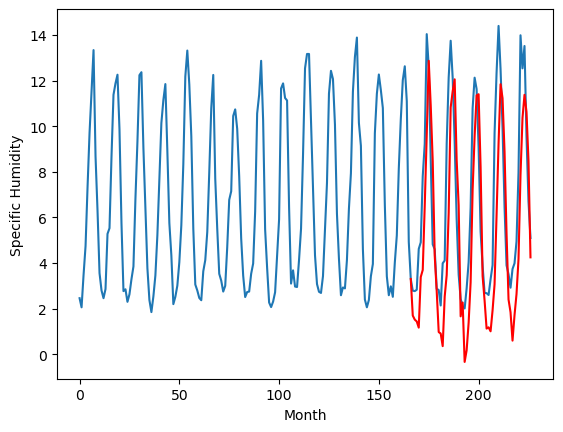

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.46		-0.81		1.65
-2.15		-0.99		1.16
-3.71		-1.07		2.64
-2.83		-1.34		1.49
-1.66		0.88		2.54
-0.18		1.19		1.37
0.93		4.01		3.08
4.27		7.11		2.84
5.29		10.36		5.07
5.99		8.40		2.41
5.29		5.96		0.67
2.70		1.82		-0.88
-0.25		0.26		0.51
-4.92		-1.54		3.38
-4.43		-1.60		2.83
-2.30		-2.15		0.15
-2.08		0.02		2.10
-1.11		0.96		2.07
0.20		3.69		3.49
3.98		8.32		4.34
4.38		9.03		4.65
5.00		9.55		4.55
3.72		6.00		2.28
1.06		4.02		2.96
-2.89		-0.85		2.04
-1.49		-0.24		1.25
-5.14		-2.85		2.29
-3.95		-2.34		1.61
-2.14		-1.12		1.02
-0.78		0.65		1.43
2.32		4.70		2.38
4.25		7.05		2.80
5.08		8.84		3.76
4.97		8.89		3.92
4.82		5.70		0.88
0.43		0.92		0.49
0.32		-0.16		-0.48
-3.34		-1.38		1.96
-3.72		-1.33		2.39
-1.87		-1.50		0.37
-1.48		-0.58		0.90
0.03		0.56		0.53
0.84		3.58		2.74
4.00		6.74		2.74
4.97		9.33		4.36
5.69		8.72		3.03
3.30		6.38		3.08
0.38		2.78		2.40
-2.12		-0.11		2.01
-2.69		-0.67		2.02
-3.76		-1

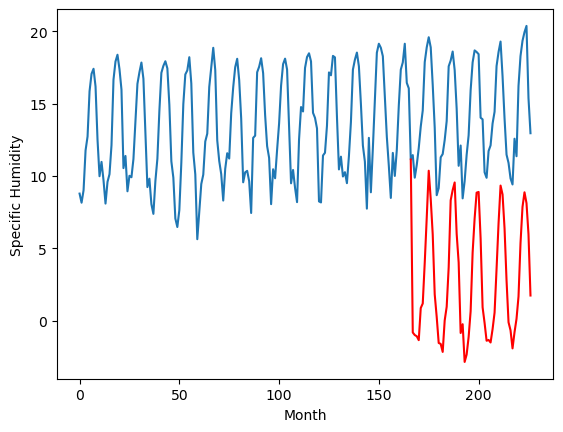

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.49		5.51		1.02
3.93		5.33		1.40
3.75		5.25		1.50
3.77		4.98		1.21
4.29		7.20		2.91
4.67		7.51		2.84
6.92		10.33		3.41
10.93		13.43		2.50
14.31		16.68		2.37
13.48		14.72		1.24
10.39		12.28		1.89
7.88		8.14		0.26
6.01		6.58		0.57
4.09		4.78		0.69
3.01		4.72		1.71
3.18		4.17		0.99
3.82		6.34		2.52
5.17		7.28		2.11
6.85		10.01		3.16
11.45		14.64		3.19
14.05		15.35		1.30
14.79		15.87		1.08
12.13		12.32		0.19
9.17		10.34		1.17
4.72		5.47		0.75
4.36		6.08		1.72
3.03		3.47		0.44
3.60		3.98		0.38
4.36		5.20		0.84
5.06		6.97		1.91
8.36		11.02		2.66
10.62		13.37		2.75
13.98		15.16		1.18
14.66		15.21		0.55
10.86		12.02		1.16
7.99		7.24		-0.75
6.17		6.16		-0.01
4.08		4.94		0.86
4.59		4.99		0.40
3.83		4.82		0.99
4.08		5.74		1.66
6.16		6.88		0.72
6.97		9.90		2.93
10.87		13.06		2.19
15.13		15.65		0.52
12.79		15.04		2.25
11.78		12.70		0.92
8.42		9.10		0.68
4.59		6.21		1.62
4.88		5.65		0.77
3.55		4.41		0.86


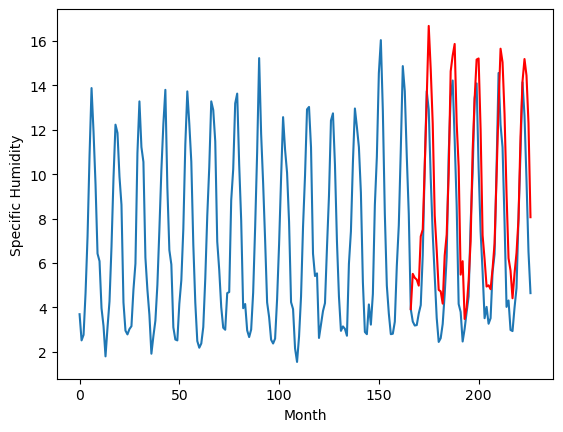

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.07		0.42		2.49
-1.27		0.24		1.51
-1.24		0.16		1.40
-0.92		-0.11		0.81
2.57		2.11		-0.46
1.61		2.42		0.81
3.73		5.24		1.51
7.07		8.34		1.27
9.20		11.59		2.39
8.47		9.63		1.16
6.67		7.19		0.52
3.46		3.05		-0.41
0.73		1.49		0.76
-2.55		-0.31		2.24
-2.42		-0.37		2.05
-2.44		-0.92		1.52
0.85		1.25		0.40
0.87		2.19		1.32
4.07		4.92		0.85
7.96		9.55		1.59
8.99		10.26		1.27
8.59		10.78		2.19
6.45		7.23		0.78
3.92		5.25		1.33
-1.74		0.38		2.12
1.54		0.99		-0.55
-3.37		-1.62		1.75
-1.91		-1.11		0.80
-1.06		0.11		1.17
1.37		1.88		0.51
5.40		5.93		0.53
7.70		8.28		0.58
8.99		10.07		1.08
9.39		10.12		0.73
5.88		6.93		1.05
0.70		2.15		1.45
0.26		1.07		0.81
-0.29		-0.15		0.14
-0.38		-0.10		0.28
0.92		-0.27		-1.19
1.80		0.65		-1.15
2.35		1.79		-0.56
5.41		4.81		-0.60
8.72		7.97		-0.75
10.06		10.56		0.50
10.09		9.95		-0.14
7.74		7.61		-0.13
2.51		4.01		1.50
-0.01		1.12		1.13
-1.60		0.56		2.16
-2.47		-0.68	

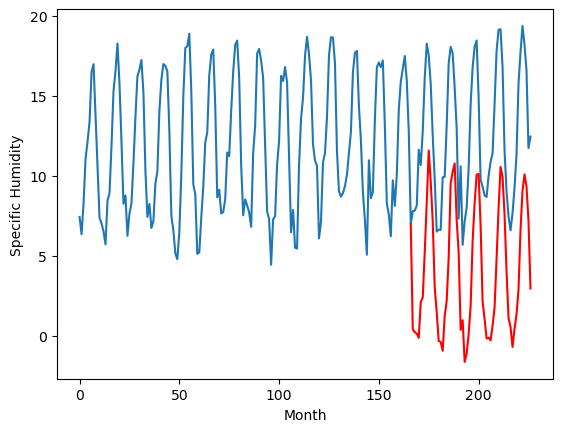

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.77		4.17		0.40
2.58		3.99		1.41
3.41		3.91		0.50
2.74		3.64		0.90
7.35		5.86		-1.49
6.83		6.17		-0.66
8.91		8.99		0.08
11.03		12.09		1.06
13.61		15.34		1.73
12.17		13.38		1.21
10.72		10.94		0.22
6.85		6.80		-0.05
4.79		5.24		0.45
2.47		3.44		0.97
2.34		3.38		1.04
2.29		2.83		0.54
5.28		5.00		-0.28
6.85		5.94		-0.91
11.68		8.67		-3.01
14.32		13.30		-1.02
13.28		14.01		0.73
13.41		14.53		1.12
9.85		10.98		1.13
8.26		9.00		0.74
4.07		4.13		0.06
6.94		4.74		-2.20
1.31		2.13		0.82
1.53		2.64		1.11
3.15		3.86		0.71
7.11		5.63		-1.48
10.76		9.68		-1.08
11.79		12.03		0.24
12.89		13.82		0.93
13.35		13.87		0.52
9.99		10.68		0.69
5.17		5.90		0.73
5.03		4.82		-0.21
4.12		3.60		-0.52
3.74		3.65		-0.09
4.19		3.48		-0.71
5.97		4.40		-1.57
6.52		5.54		-0.98
10.22		8.56		-1.66
13.68		11.72		-1.96
13.39		14.31		0.92
11.96		13.70		1.74
11.41		11.36		-0.05
7.88		7.76		-0.12
4.71		4.87		0.16
2.78		4.31		1.53
1.

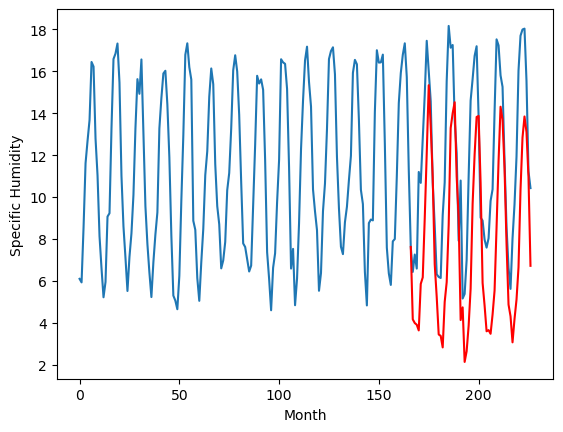

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.89		2.83		-0.06
1.79		2.65		0.86
2.47		2.57		0.10
1.91		2.30		0.39
6.13		4.52		-1.61
5.71		4.83		-0.88
8.65		7.65		-1.00
10.93		10.75		-0.18
13.84		14.00		0.16
11.14		12.04		0.90
10.20		9.60		-0.60
5.71		5.46		-0.25
4.12		3.90		-0.22
1.41		2.10		0.69
1.31		2.04		0.73
0.98		1.49		0.51
3.84		3.66		-0.18
5.16		4.60		-0.56
9.36		7.33		-2.03
13.11		11.96		-1.15
13.93		12.67		-1.26
14.31		13.19		-1.12
9.86		9.64		-0.22
7.25		7.66		0.41
3.26		2.79		-0.47
5.76		3.40		-2.36
0.47		0.79		0.32
0.94		1.30		0.36
2.57		2.52		-0.05
6.47		4.29		-2.18
10.56		8.34		-2.22
11.36		10.69		-0.67
10.68		12.48		1.80
11.74		12.53		0.79
9.07		9.34		0.27
4.29		4.56		0.27
3.84		3.48		-0.36
2.67		2.26		-0.41
1.89		2.31		0.42
2.29		2.14		-0.15
4.20		3.06		-1.14
4.87		4.20		-0.67
8.76		7.22		-1.54
12.66		10.38		-2.28
11.95		12.97		1.02
9.90		12.36		2.46
9.27		10.02		0.75
6.12		6.42		0.30
3.50		3.53		0.03
1.68		2.97		1.29
0

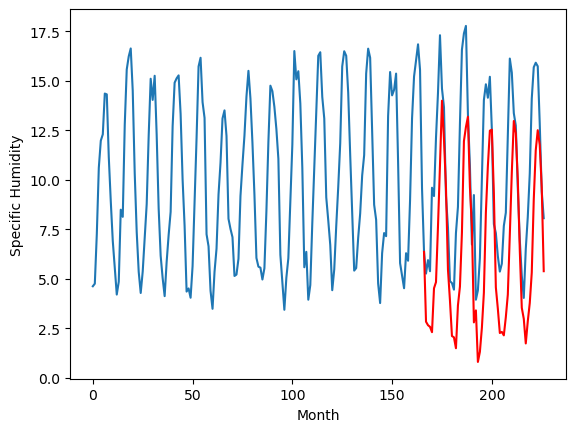

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.55		1.35		-2.20
3.10		1.17		-1.93
2.15		1.09		-1.06
2.68		0.82		-1.86
4.14		3.04		-1.10
2.74		3.35		0.61
2.98		6.17		3.19
4.66		9.27		4.61
8.10		12.52		4.42
6.37		10.56		4.19
5.72		8.12		2.40
2.65		3.98		1.33
2.70		2.42		-0.28
1.44		0.62		-0.82
1.72		0.56		-1.16
1.59		0.01		-1.58
1.68		2.18		0.50
1.98		3.12		1.14
2.10		5.85		3.75
4.76		10.48		5.72
10.00		11.19		1.19
10.29		11.71		1.42
7.53		8.16		0.63
3.82		6.18		2.36
2.17		1.31		-0.86
2.30		1.92		-0.38
2.02		-0.69		-2.71
1.03		-0.18		-1.21
1.43		1.04		-0.39
1.44		2.81		1.37
1.37		6.86		5.49
6.87		9.21		2.34
9.43		11.00		1.57
11.40		11.05		-0.35
8.36		7.86		-0.50
6.28		3.08		-3.20
2.31		2.00		-0.31
3.13		0.78		-2.35
2.24		0.83		-1.41
2.12		0.66		-1.46
2.46		1.58		-0.88
1.62		2.72		1.10
3.62		5.74		2.12
3.42		8.90		5.48
6.77		11.49		4.72
8.96		10.88		1.92
7.15		8.54		1.39
4.70		4.94		0.24
3.78		2.05		-1.73
2.26		1.49		-0.77
2.68		0.25		-2.43

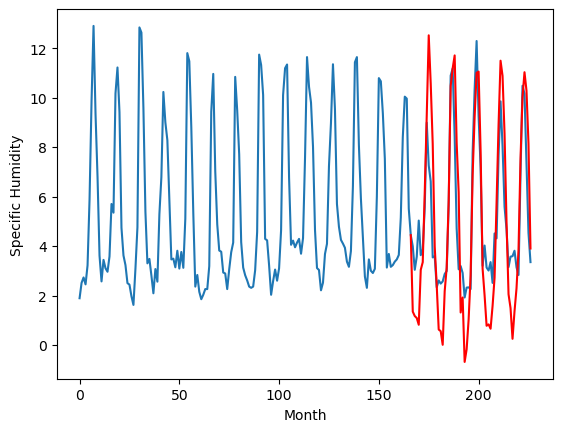

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.23		-1.38		-3.61
2.05		-1.56		-3.61
1.84		-1.64		-3.48
1.12		-1.91		-3.03
2.76		0.31		-2.45
4.17		0.62		-3.55
4.93		3.44		-1.49
4.91		6.54		1.63
5.68		9.79		4.11
6.76		7.83		1.07
4.98		5.39		0.41
3.85		1.25		-2.60
1.61		-0.31		-1.92
0.04		-2.11		-2.15
0.89		-2.17		-3.06
1.42		-2.72		-4.14
1.53		-0.55		-2.08
2.85		0.39		-2.46
4.33		3.12		-1.21
5.58		7.75		2.17
6.73		8.46		1.73
6.13		8.98		2.85
5.67		5.43		-0.24
2.87		3.45		0.58
2.33		-1.42		-3.75
2.15		-0.81		-2.96
0.79		-3.42		-4.21
0.05		-2.91		-2.96
1.79		-1.69		-3.48
2.63		0.08		-2.55
3.89		4.13		0.24
5.66		6.48		0.82
6.55		8.27		1.72
6.65		8.32		1.67
7.50		5.13		-2.37
5.73		0.35		-5.38
1.09		-0.73		-1.82
1.94		-1.95		-3.89
2.03		-1.90		-3.93
0.62		-2.07		-2.69
2.54		-1.15		-3.69
3.24		-0.01		-3.25
4.64		3.01		-1.63
5.02		6.17		1.15
6.36		8.76		2.40
6.97		8.15		1.18
6.72		5.81		-0.91
4.42		2.21		-2.21
1.39		-0.68		-2.07
2.18		-1.24		-3.4

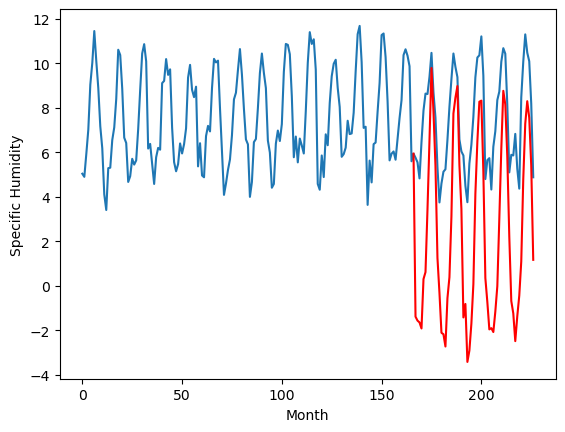

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.17		1.77		1.94
-0.06		1.59		1.65
-0.08		1.51		1.59
0.31		1.24		0.93
1.94		3.46		1.52
1.85		3.77		1.92
5.18		6.59		1.41
8.69		9.69		1.00
11.54		12.94		1.40
11.53		10.98		-0.55
7.81		8.54		0.73
5.19		4.40		-0.79
2.54		2.84		0.30
-0.68		1.04		1.72
-0.80		0.98		1.78
-0.73		0.43		1.16
1.00		2.60		1.60
1.53		3.54		2.01
4.24		6.27		2.03
8.74		10.90		2.16
10.26		11.61		1.35
10.84		12.13		1.29
7.24		8.58		1.34
5.08		6.60		1.52
-0.48		1.73		2.21
1.37		2.34		0.97
-1.41		-0.27		1.14
-0.10		0.24		0.34
0.86		1.46		0.60
1.90		3.23		1.33
6.22		7.28		1.06
8.02		9.63		1.61
11.60		11.42		-0.18
10.03		11.47		1.44
6.60		8.28		1.68
2.24		3.50		1.26
1.77		2.42		0.65
-0.47		1.20		1.67
0.39		1.25		0.86
1.15		1.08		-0.07
0.84		2.00		1.16
2.97		3.14		0.17
4.50		6.16		1.66
7.36		9.32		1.96
11.20		11.91		0.71
10.71		11.30		0.59
7.57		8.96		1.39
3.38		5.36		1.98
0.27		2.47		2.20
0.18		1.91		1.73
-0.51		0.67		1.18
-0.3

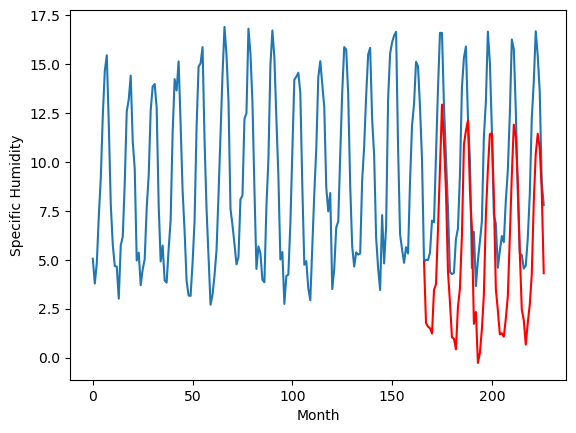

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.52		1.79		1.27
0.97		1.61		0.64
0.77		1.53		0.76
0.88		1.26		0.38
2.73		3.48		0.75
2.16		3.79		1.63
4.95		6.61		1.66
8.39		9.71		1.32
11.09		12.96		1.87
10.85		11.00		0.15
8.24		8.56		0.32
5.05		4.42		-0.63
1.93		2.86		0.93
0.14		1.06		0.92
0.15		1.00		0.85
0.39		0.45		0.06
1.42		2.62		1.20
2.03		3.56		1.53
4.70		6.29		1.59
8.80		10.92		2.12
10.21		11.63		1.42
10.60		12.15		1.55
7.39		8.60		1.21
5.66		6.62		0.96
0.30		1.75		1.45
1.86		2.36		0.50
-0.56		-0.25		0.31
0.34		0.26		-0.08
0.96		1.48		0.52
2.23		3.25		1.02
6.39		7.30		0.91
8.35		9.65		1.30
11.56		11.44		-0.12
10.57		11.49		0.92
7.09		8.30		1.21
2.43		3.52		1.09
1.81		2.44		0.63
0.72		1.22		0.50
0.99		1.27		0.28
1.39		1.10		-0.29
0.99		2.02		1.03
2.63		3.16		0.53
5.22		6.18		0.96
7.06		9.34		2.28
10.37		11.93		1.56
10.48		11.32		0.84
8.06		8.98		0.92
3.95		5.38		1.43
1.00		2.49		1.49
0.79		1.93		1.14
0.17		0.69		0.52
0.57		1.81		1.

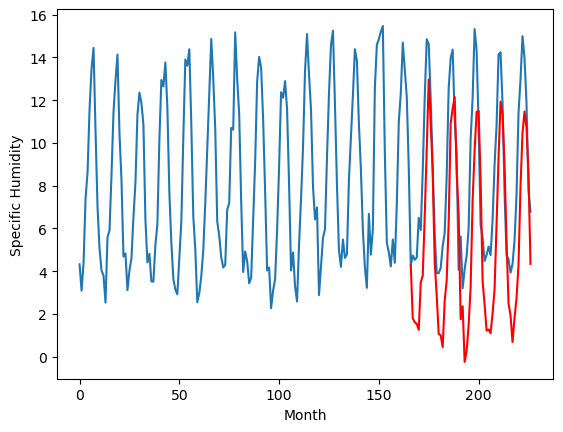

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.85   1.788309
1                 1    3.34   1.698309
2                 2   -2.46  -0.811691
3                 3    4.49   5.508309
4                 4   -2.07   0.418309
5                 5    3.77   4.168309
6                 6    2.89   2.828309
7                 7    3.55   1.348309
8                 8    2.23  -1.381691
9                 9   -0.17   1.768309
10               10    0.52   1.788309


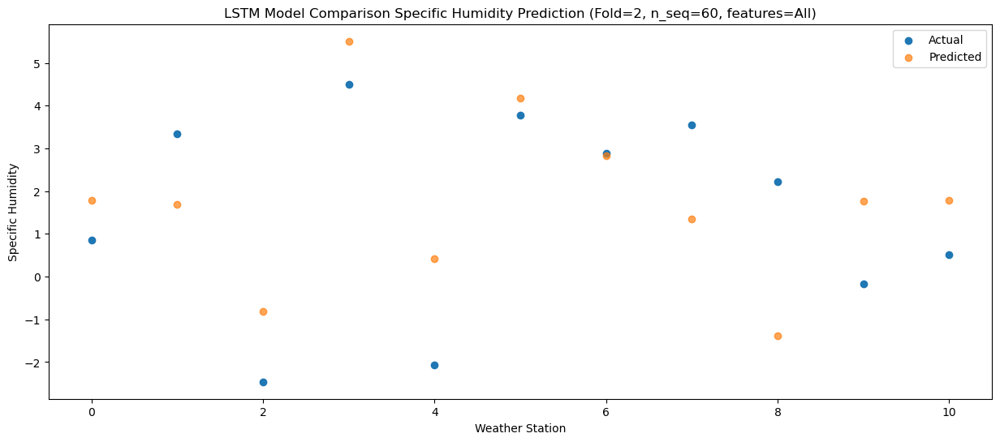

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.35   1.610466
1                 1    2.83   1.520466
2                 2   -2.15  -0.989534
3                 3    3.93   5.330466
4                 4   -1.27   0.240466
5                 5    2.58   3.990466
6                 6    1.79   2.650466
7                 7    3.10   1.170466
8                 8    2.05  -1.559534
9                 9   -0.06   1.590466
10               10    0.97   1.610466


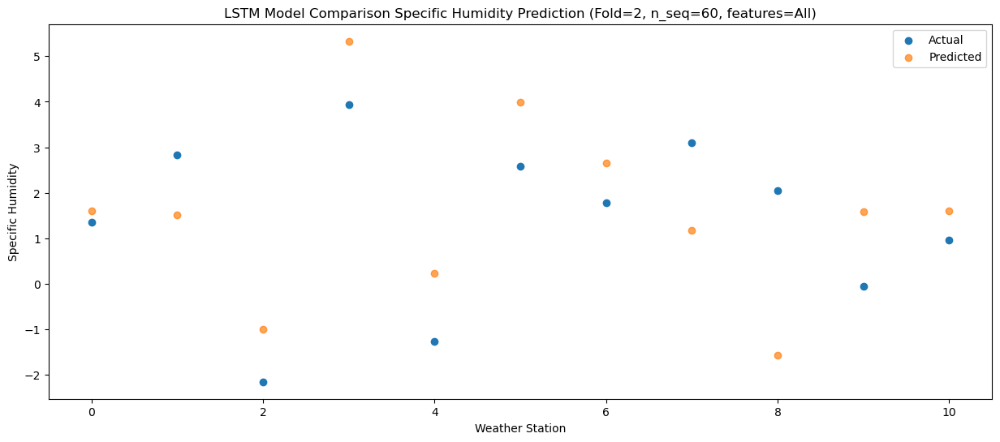

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.06   1.528935
1                 1    2.81   1.438935
2                 2   -3.71  -1.071065
3                 3    3.75   5.248935
4                 4   -1.24   0.158935
5                 5    3.41   3.908935
6                 6    2.47   2.568935
7                 7    2.15   1.088935
8                 8    1.84  -1.641065
9                 9   -0.08   1.508935
10               10    0.77   1.528935


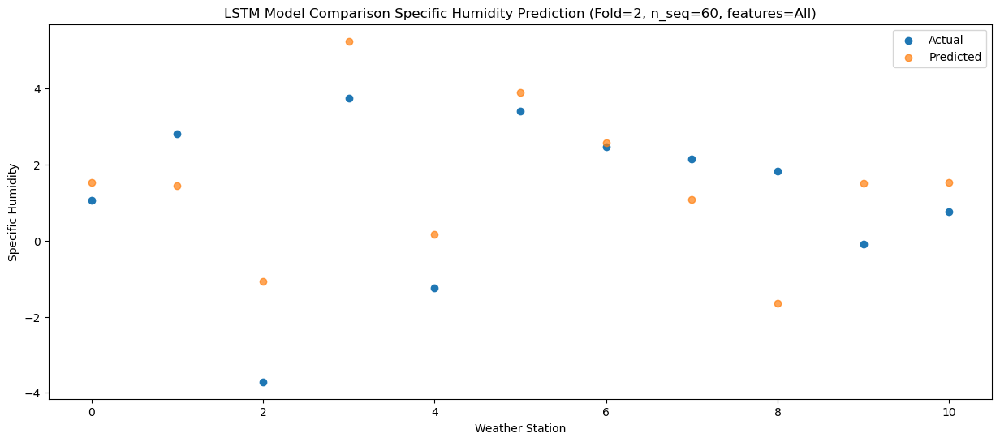

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.74   1.257745
1                 1    2.87   1.167745
2                 2   -2.83  -1.342255
3                 3    3.77   4.977745
4                 4   -0.92  -0.112255
5                 5    2.74   3.637745
6                 6    1.91   2.297745
7                 7    2.68   0.817745
8                 8    1.12  -1.912255
9                 9    0.31   1.237745
10               10    0.88   1.257745


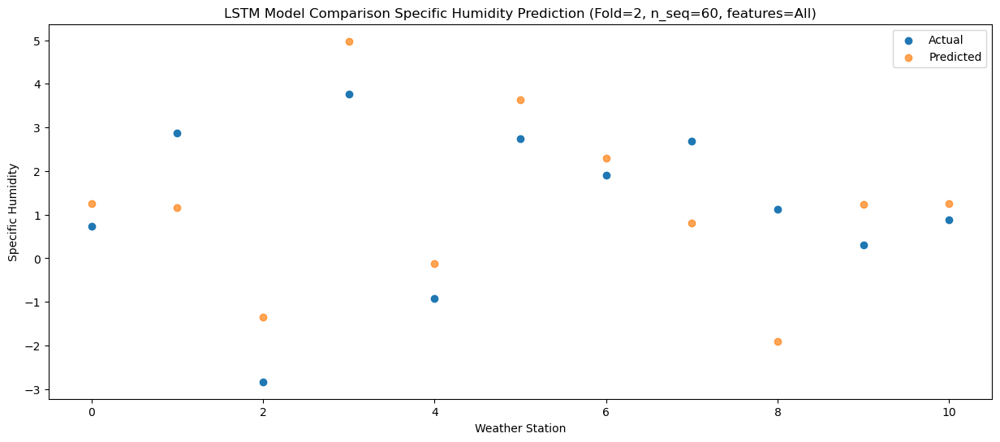

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.67   3.477209
1                 1    4.66   3.387209
2                 2   -1.66   0.877209
3                 3    4.29   7.197209
4                 4    2.57   2.107209
5                 5    7.35   5.857209
6                 6    6.13   4.517209
7                 7    4.14   3.037209
8                 8    2.76   0.307209
9                 9    1.94   3.457209
10               10    2.73   3.477209


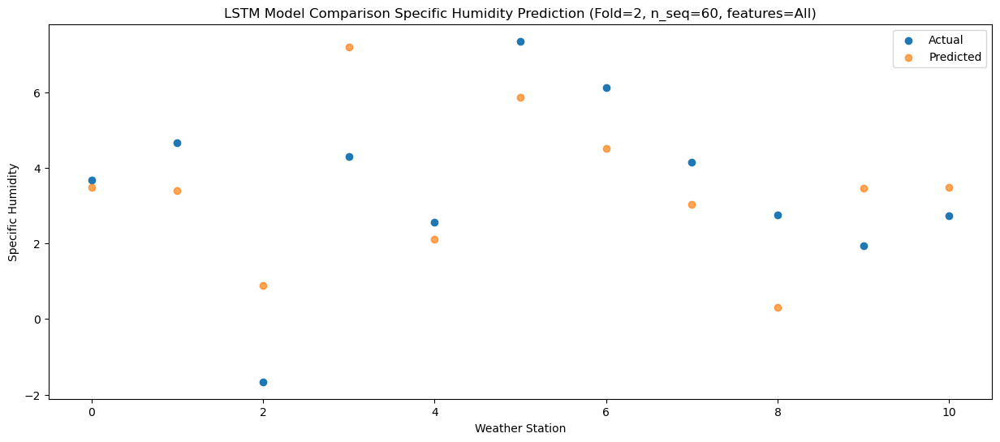

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.51   3.788598
1                 1    4.95   3.698598
2                 2   -0.18   1.188598
3                 3    4.67   7.508598
4                 4    1.61   2.418598
5                 5    6.83   6.168598
6                 6    5.71   4.828598
7                 7    2.74   3.348598
8                 8    4.17   0.618598
9                 9    1.85   3.768598
10               10    2.16   3.788598


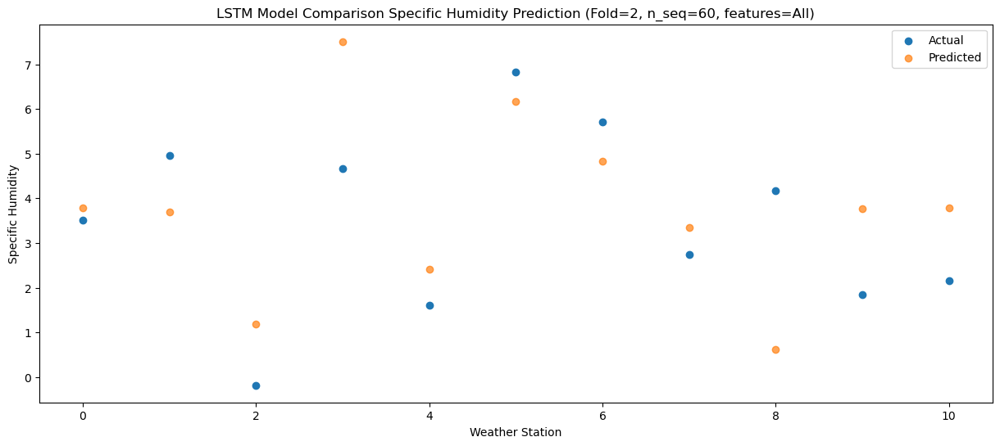

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.50   6.608312
1                 1    7.85   6.518312
2                 2    0.93   4.008312
3                 3    6.92  10.328312
4                 4    3.73   5.238312
5                 5    8.91   8.988312
6                 6    8.65   7.648312
7                 7    2.98   6.168312
8                 8    4.93   3.438312
9                 9    5.18   6.588312
10               10    4.95   6.608312


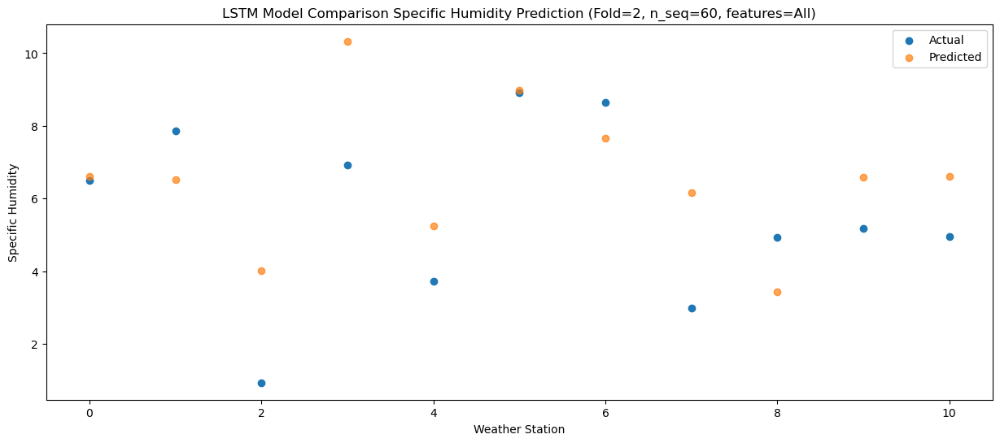

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.65   9.709824
1                 1    9.27   9.619824
2                 2    4.27   7.109824
3                 3   10.93  13.429824
4                 4    7.07   8.339824
5                 5   11.03  12.089824
6                 6   10.93  10.749824
7                 7    4.66   9.269824
8                 8    4.91   6.539824
9                 9    8.69   9.689824
10               10    8.39   9.709824


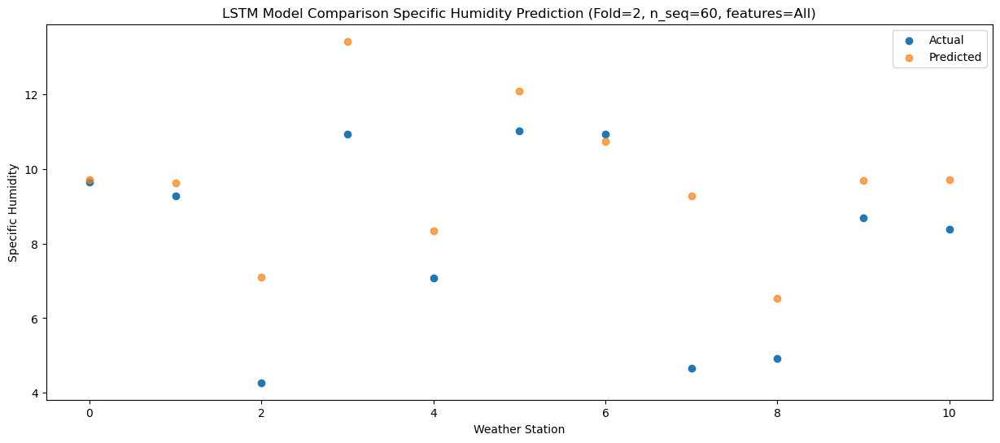

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.35    12.9601
1                 1   14.08    12.8701
2                 2    5.29    10.3601
3                 3   14.31    16.6801
4                 4    9.20    11.5901
5                 5   13.61    15.3401
6                 6   13.84    14.0001
7                 7    8.10    12.5201
8                 8    5.68     9.7901
9                 9   11.54    12.9401
10               10   11.09    12.9601


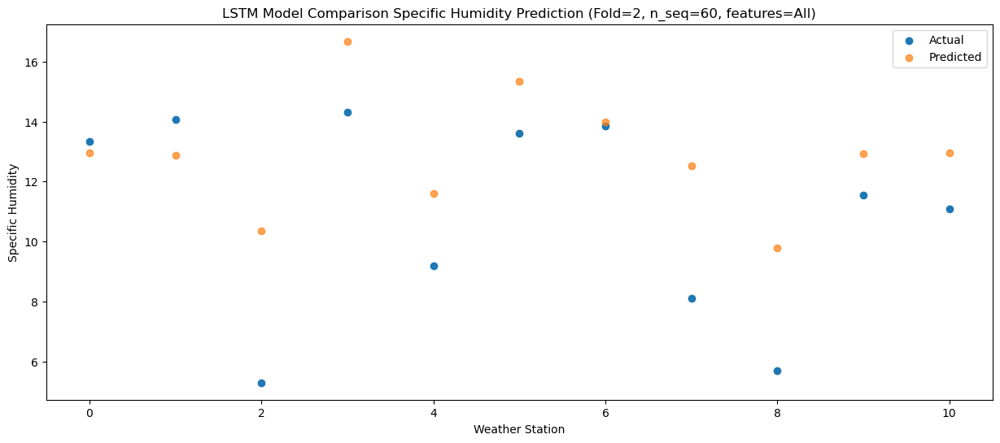

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   11.19  11.004388
1                 1   12.65  10.914388
2                 2    5.99   8.404388
3                 3   13.48  14.724388
4                 4    8.47   9.634388
5                 5   12.17  13.384388
6                 6   11.14  12.044388
7                 7    6.37  10.564388
8                 8    6.76   7.834388
9                 9   11.53  10.984388
10               10   10.85  11.004388


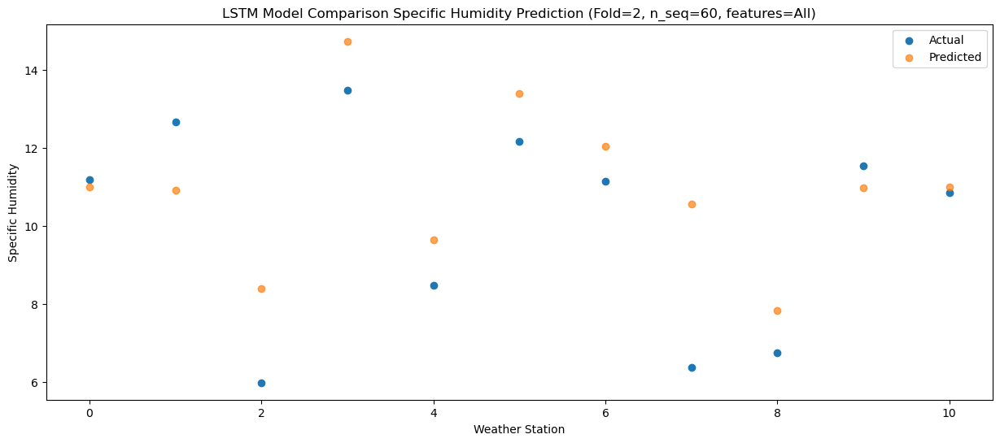

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.73    8.56488
1                 1    8.59    8.47488
2                 2    5.29    5.96488
3                 3   10.39   12.28488
4                 4    6.67    7.19488
5                 5   10.72   10.94488
6                 6   10.20    9.60488
7                 7    5.72    8.12488
8                 8    4.98    5.39488
9                 9    7.81    8.54488
10               10    8.24    8.56488


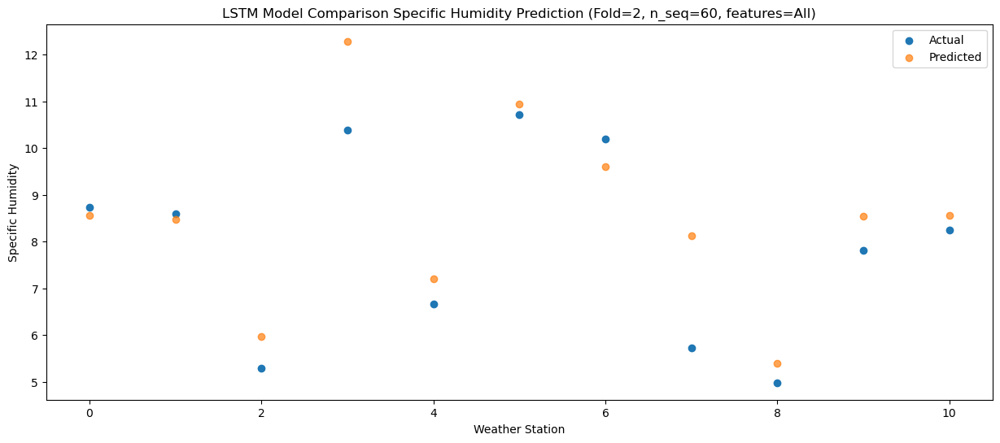

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.14   4.420698
1                 1    4.86   4.330698
2                 2    2.70   1.820698
3                 3    7.88   8.140698
4                 4    3.46   3.050698
5                 5    6.85   6.800698
6                 6    5.71   5.460698
7                 7    2.65   3.980698
8                 8    3.85   1.250698
9                 9    5.19   4.400698
10               10    5.05   4.420698


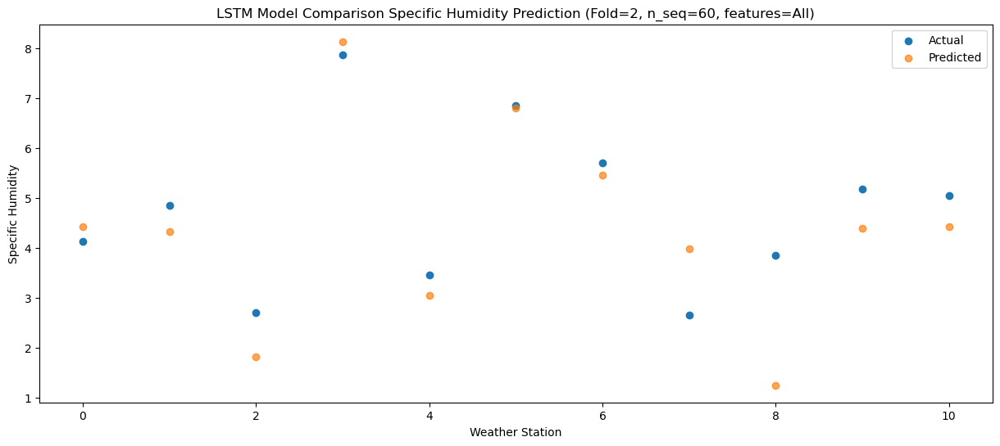

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.89   2.856307
1                 1    4.64   2.766307
2                 2   -0.25   0.256307
3                 3    6.01   6.576307
4                 4    0.73   1.486307
5                 5    4.79   5.236307
6                 6    4.12   3.896307
7                 7    2.70   2.416307
8                 8    1.61  -0.313693
9                 9    2.54   2.836307
10               10    1.93   2.856307


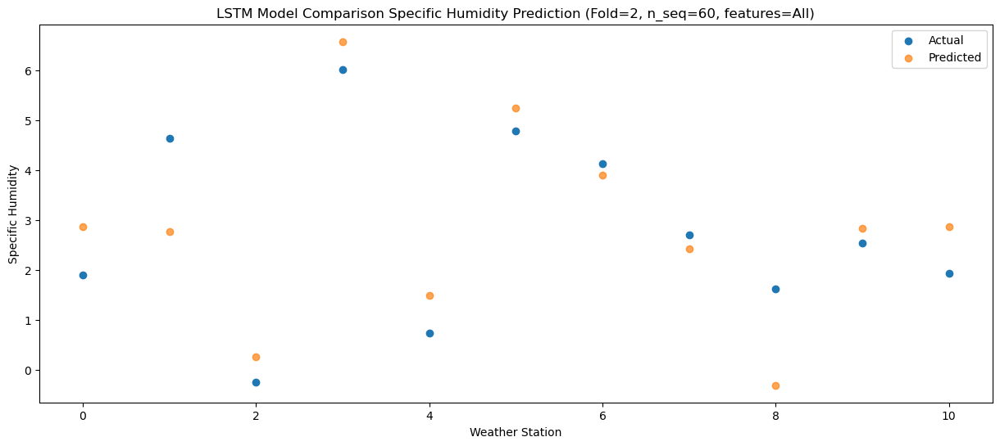

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.16   1.064283
1                 1    2.91   0.974283
2                 2   -4.92  -1.535717
3                 3    4.09   4.784283
4                 4   -2.55  -0.305717
5                 5    2.47   3.444283
6                 6    1.41   2.104283
7                 7    1.44   0.624283
8                 8    0.04  -2.105717
9                 9   -0.68   1.044283
10               10    0.14   1.064283


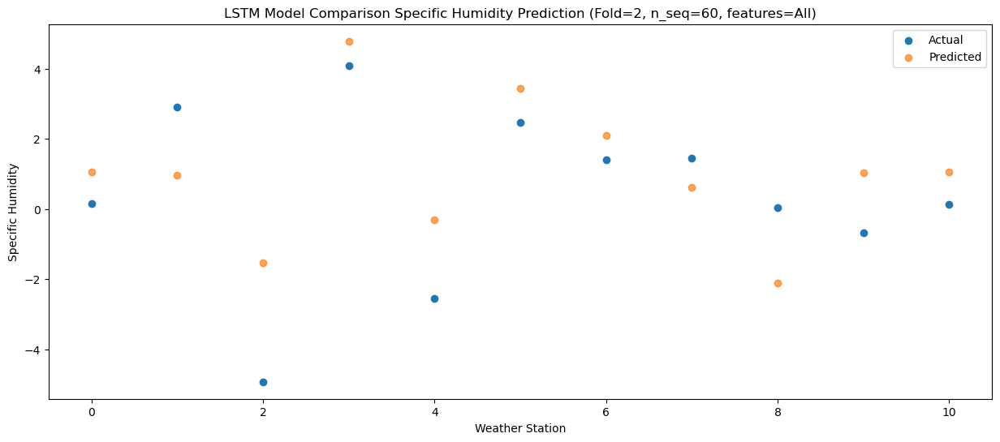

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.07    0.99836
1                 1    2.86    0.90836
2                 2   -4.43   -1.60164
3                 3    3.01    4.71836
4                 4   -2.42   -0.37164
5                 5    2.34    3.37836
6                 6    1.31    2.03836
7                 7    1.72    0.55836
8                 8    0.89   -2.17164
9                 9   -0.80    0.97836
10               10    0.15    0.99836


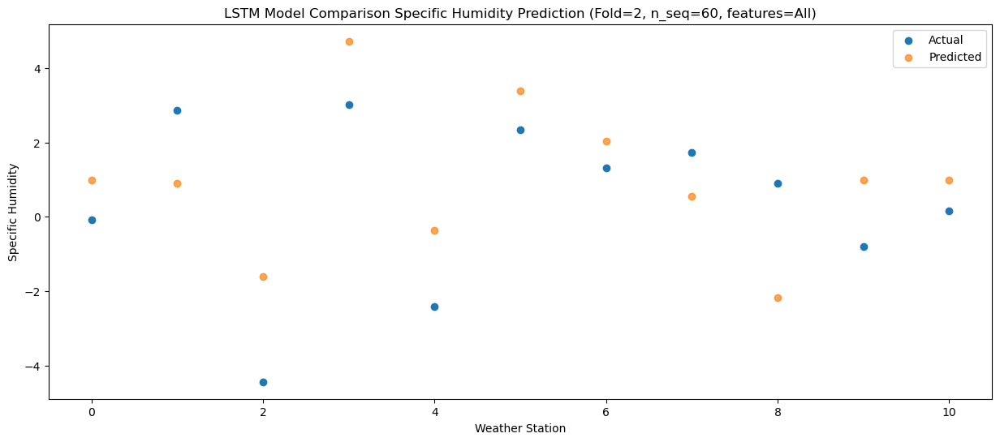

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.79   0.447165
1                 1    2.18   0.357165
2                 2   -2.30  -2.152835
3                 3    3.18   4.167165
4                 4   -2.44  -0.922835
5                 5    2.29   2.827165
6                 6    0.98   1.487165
7                 7    1.59   0.007165
8                 8    1.42  -2.722835
9                 9   -0.73   0.427165
10               10    0.39   0.447165


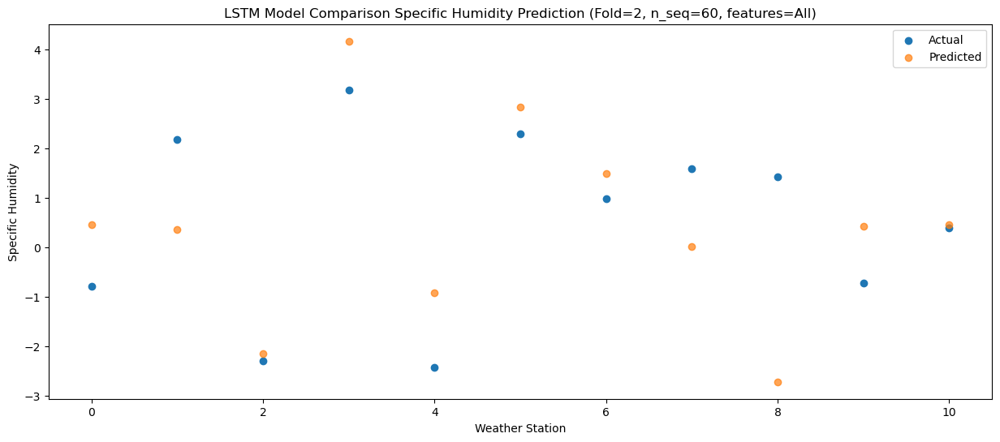

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.49   2.616556
1                 1    4.03   2.526556
2                 2   -2.08   0.016556
3                 3    3.82   6.336556
4                 4    0.85   1.246556
5                 5    5.28   4.996556
6                 6    3.84   3.656556
7                 7    1.68   2.176556
8                 8    1.53  -0.553444
9                 9    1.00   2.596556
10               10    1.42   2.616556


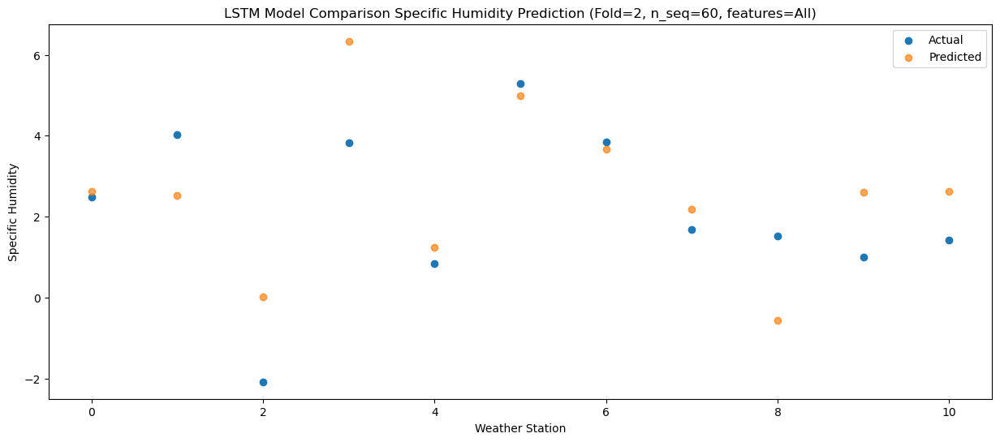

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.88   3.562328
1                 1    4.15   3.472328
2                 2   -1.11   0.962328
3                 3    5.17   7.282328
4                 4    0.87   2.192328
5                 5    6.85   5.942328
6                 6    5.16   4.602328
7                 7    1.98   3.122328
8                 8    2.85   0.392328
9                 9    1.53   3.542328
10               10    2.03   3.562328


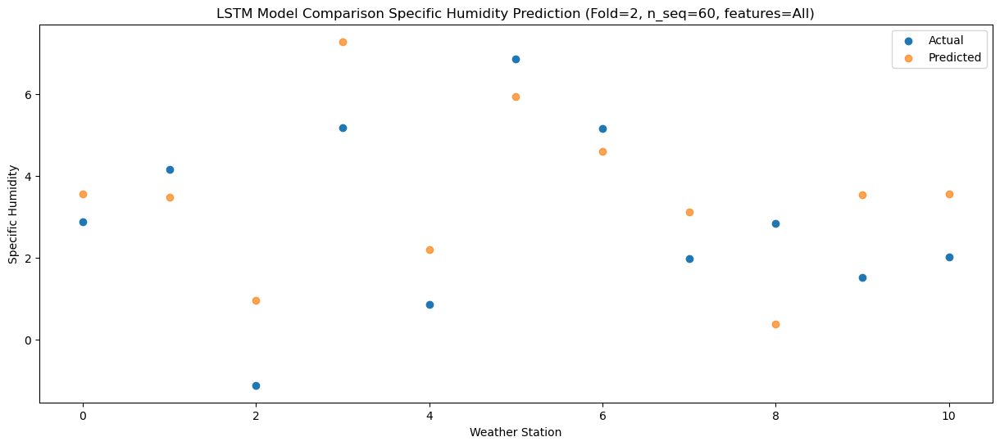

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.55   6.292709
1                 1    9.27   6.202709
2                 2    0.20   3.692709
3                 3    6.85  10.012709
4                 4    4.07   4.922709
5                 5   11.68   8.672709
6                 6    9.36   7.332709
7                 7    2.10   5.852709
8                 8    4.33   3.122709
9                 9    4.24   6.272709
10               10    4.70   6.292709


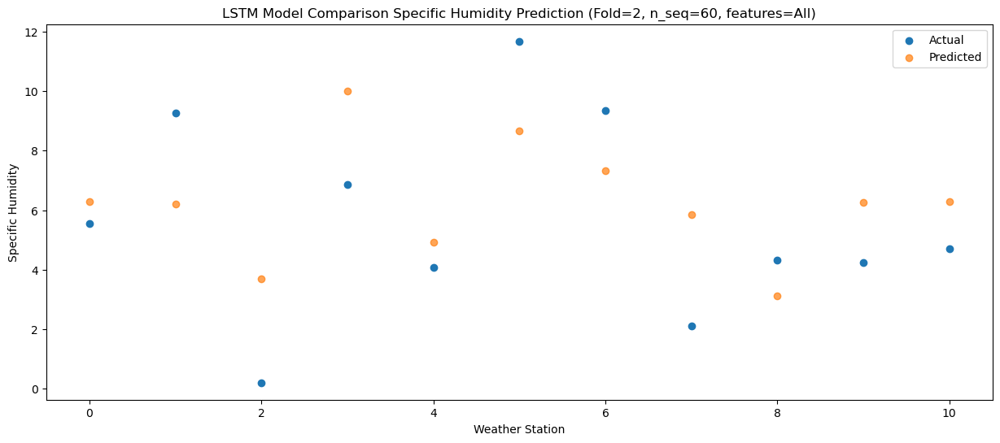

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   10.20    10.9162
1                 1   12.18    10.8262
2                 2    3.98     8.3162
3                 3   11.45    14.6362
4                 4    7.96     9.5462
5                 5   14.32    13.2962
6                 6   13.11    11.9562
7                 7    4.76    10.4762
8                 8    5.58     7.7462
9                 9    8.74    10.8962
10               10    8.80    10.9162


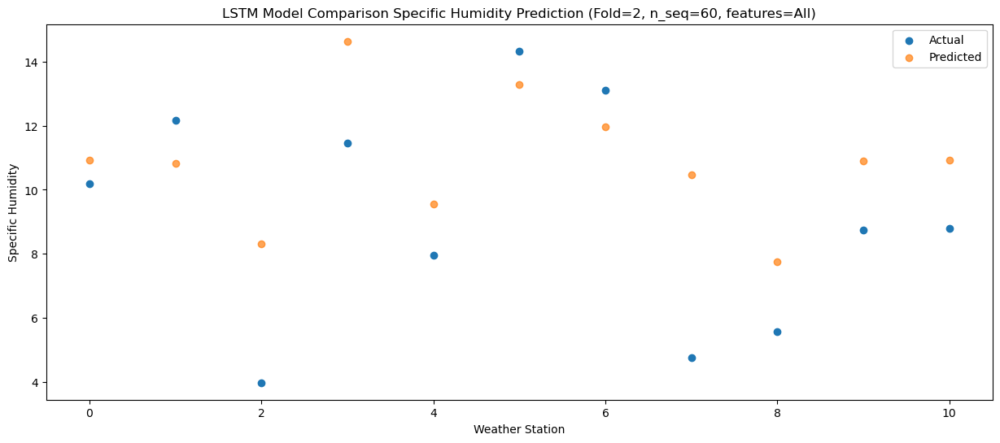

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.30   11.62524
1                 1   13.79   11.53524
2                 2    4.38    9.02524
3                 3   14.05   15.34524
4                 4    8.99   10.25524
5                 5   13.28   14.00524
6                 6   13.93   12.66524
7                 7   10.00   11.18524
8                 8    6.73    8.45524
9                 9   10.26   11.60524
10               10   10.21   11.62524


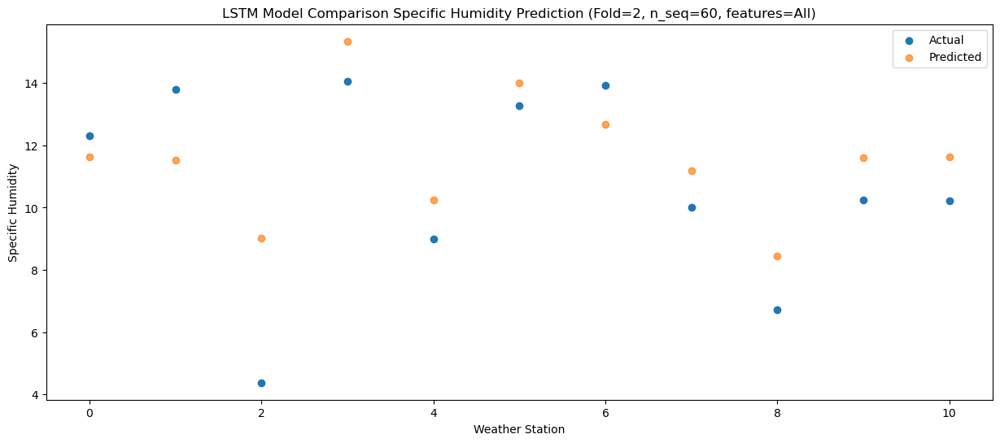

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.00  12.147494
1                 1   12.17  12.057494
2                 2    5.00   9.547494
3                 3   14.79  15.867494
4                 4    8.59  10.777494
5                 5   13.41  14.527494
6                 6   14.31  13.187494
7                 7   10.29  11.707494
8                 8    6.13   8.977494
9                 9   10.84  12.127494
10               10   10.60  12.147494


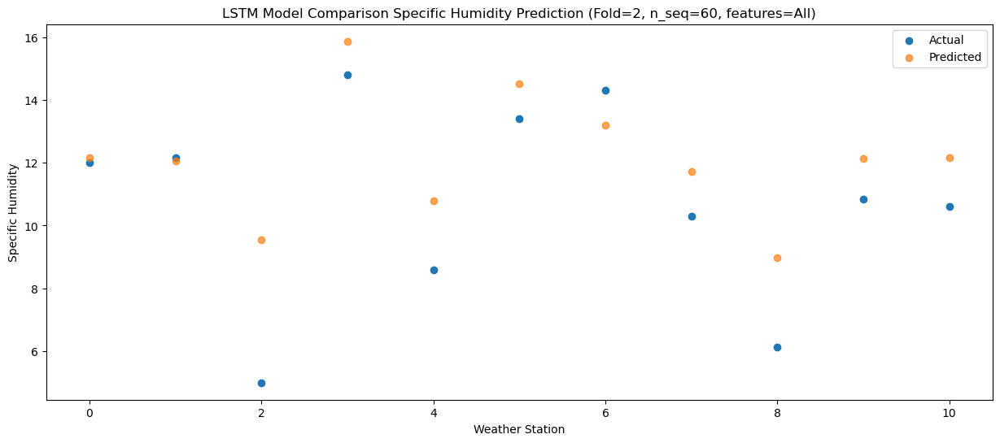

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.23   8.601407
1                 1    9.35   8.511407
2                 2    3.72   6.001407
3                 3   12.13  12.321407
4                 4    6.45   7.231407
5                 5    9.85  10.981407
6                 6    9.86   9.641407
7                 7    7.53   8.161407
8                 8    5.67   5.431407
9                 9    7.24   8.581407
10               10    7.39   8.601407


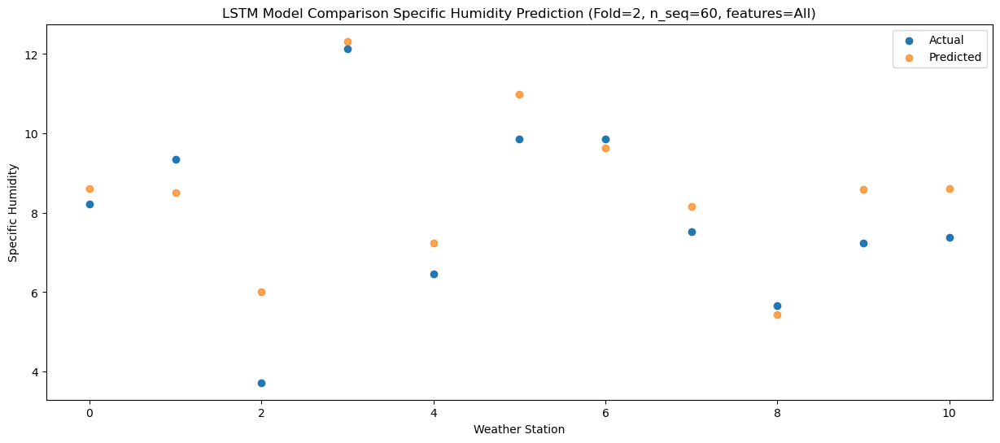

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.78   6.622797
1                 1    5.96   6.532797
2                 2    1.06   4.022797
3                 3    9.17  10.342797
4                 4    3.92   5.252797
5                 5    8.26   9.002797
6                 6    7.25   7.662797
7                 7    3.82   6.182797
8                 8    2.87   3.452797
9                 9    5.08   6.602797
10               10    5.66   6.622797


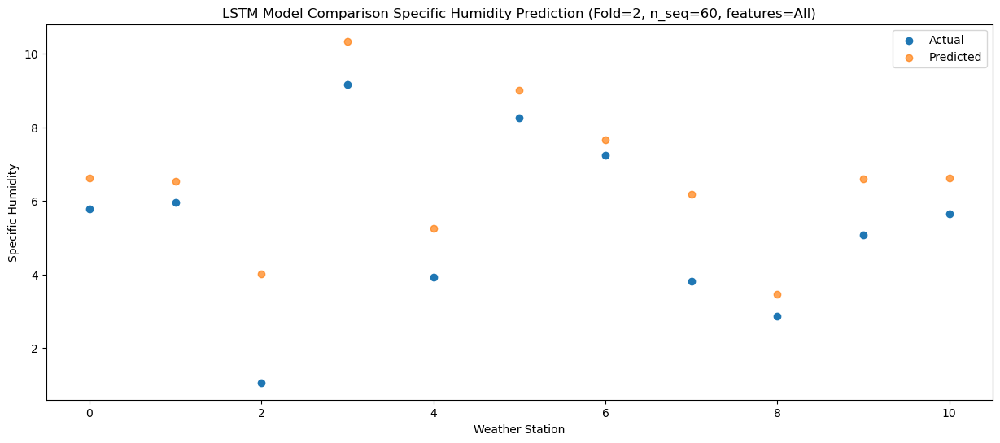

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.59    1.75317
1                 1    3.53    1.66317
2                 2   -2.89   -0.84683
3                 3    4.72    5.47317
4                 4   -1.74    0.38317
5                 5    4.07    4.13317
6                 6    3.26    2.79317
7                 7    2.17    1.31317
8                 8    2.33   -1.41683
9                 9   -0.48    1.73317
10               10    0.30    1.75317


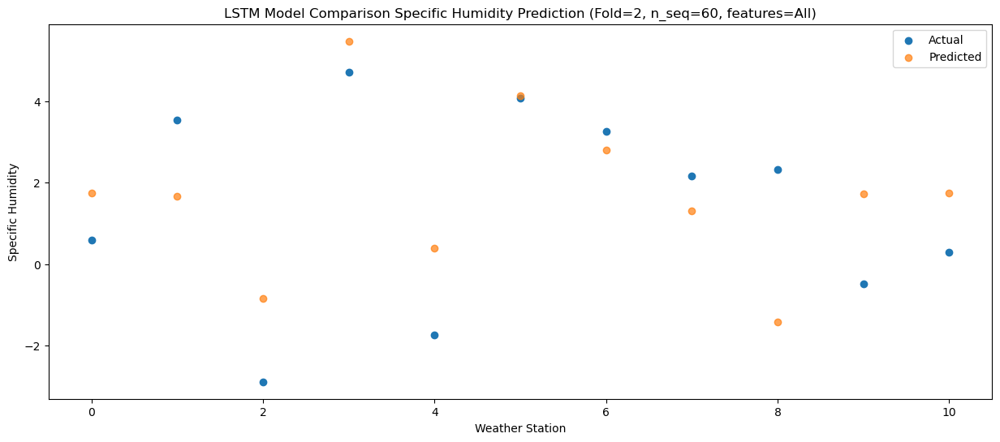

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.99   2.359241
1                 1    2.47   2.269241
2                 2   -1.49  -0.240759
3                 3    4.36   6.079241
4                 4    1.54   0.989241
5                 5    6.94   4.739241
6                 6    5.76   3.399241
7                 7    2.30   1.919241
8                 8    2.15  -0.810759
9                 9    1.37   2.339241
10               10    1.86   2.359241


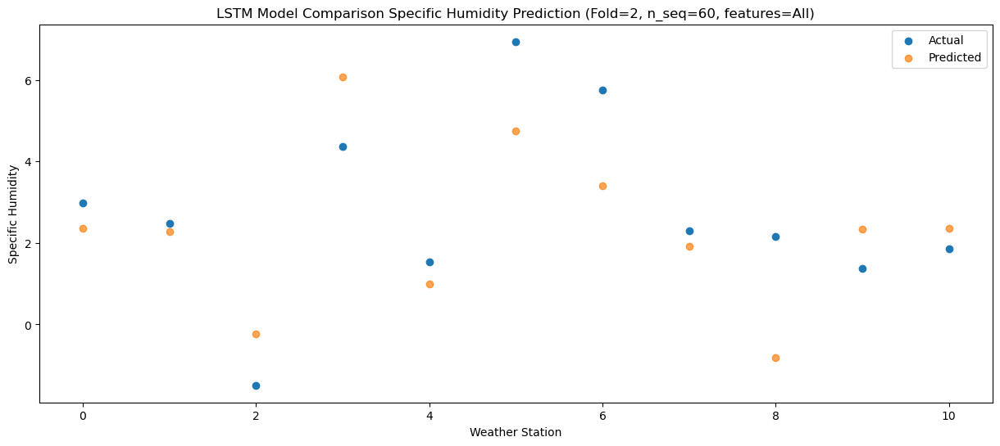

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.00  -0.245243
1                 1    2.14  -0.335243
2                 2   -5.14  -2.845243
3                 3    3.03   3.474757
4                 4   -3.37  -1.615243
5                 5    1.31   2.134757
6                 6    0.47   0.794757
7                 7    2.02  -0.685243
8                 8    0.79  -3.415243
9                 9   -1.41  -0.265243
10               10   -0.56  -0.245243


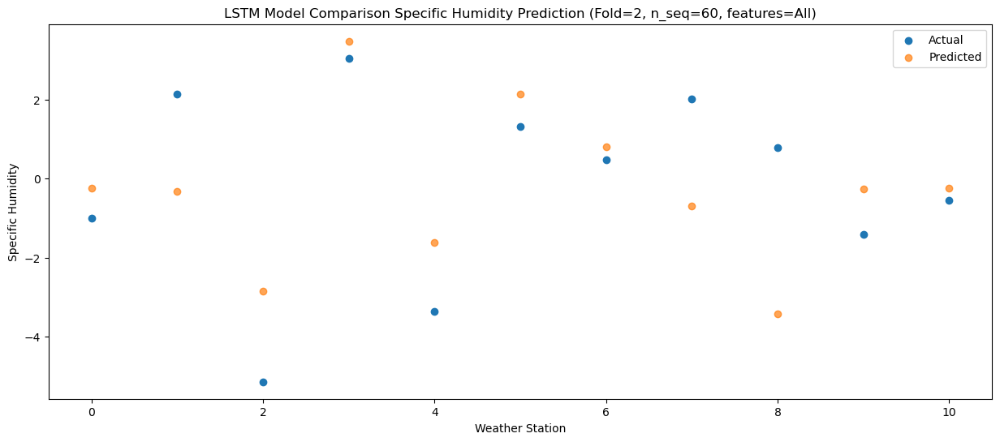

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.34   0.264938
1                 1    2.05   0.174938
2                 2   -3.95  -2.335062
3                 3    3.60   3.984938
4                 4   -1.91  -1.105062
5                 5    1.53   2.644938
6                 6    0.94   1.304938
7                 7    1.03  -0.175062
8                 8    0.05  -2.905062
9                 9   -0.10   0.244938
10               10    0.34   0.264938


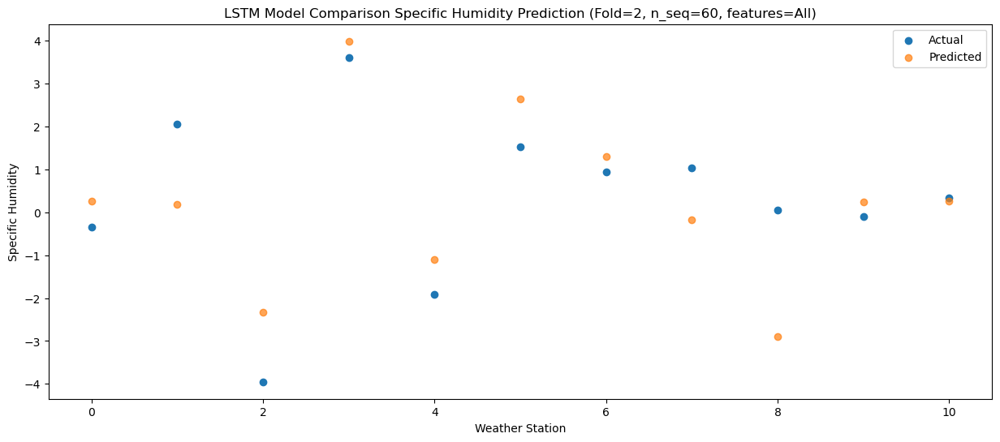

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.09   1.477637
1                 1    2.93   1.387637
2                 2   -2.14  -1.122363
3                 3    4.36   5.197637
4                 4   -1.06   0.107637
5                 5    3.15   3.857637
6                 6    2.57   2.517637
7                 7    1.43   1.037637
8                 8    1.79  -1.692363
9                 9    0.86   1.457637
10               10    0.96   1.477637


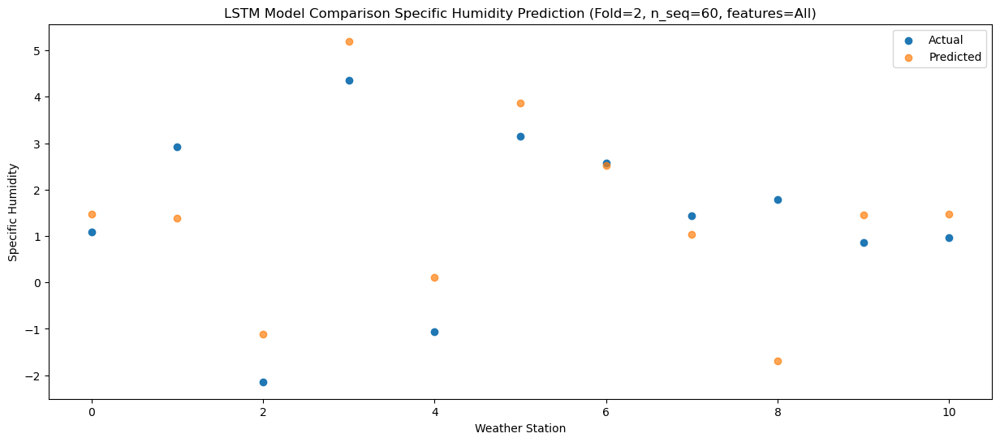

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.99   3.251989
1                 1    4.08   3.161989
2                 2   -0.78   0.651989
3                 3    5.06   6.971989
4                 4    1.37   1.881989
5                 5    7.11   5.631989
6                 6    6.47   4.291989
7                 7    1.44   2.811989
8                 8    2.63   0.081989
9                 9    1.90   3.231989
10               10    2.23   3.251989


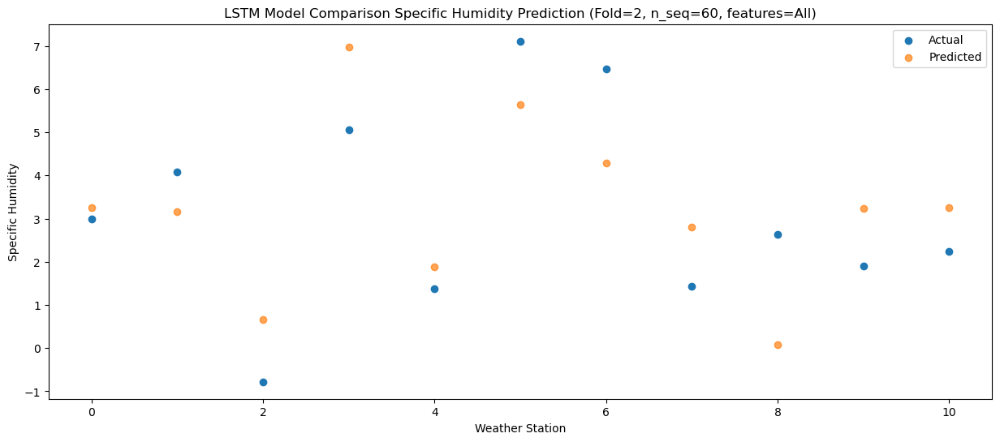

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.25   7.304029
1                 1    6.47   7.214029
2                 2    2.32   4.704029
3                 3    8.36  11.024029
4                 4    5.40   5.934029
5                 5   10.76   9.684029
6                 6   10.56   8.344029
7                 7    1.37   6.864029
8                 8    3.89   4.134029
9                 9    6.22   7.284029
10               10    6.39   7.304029


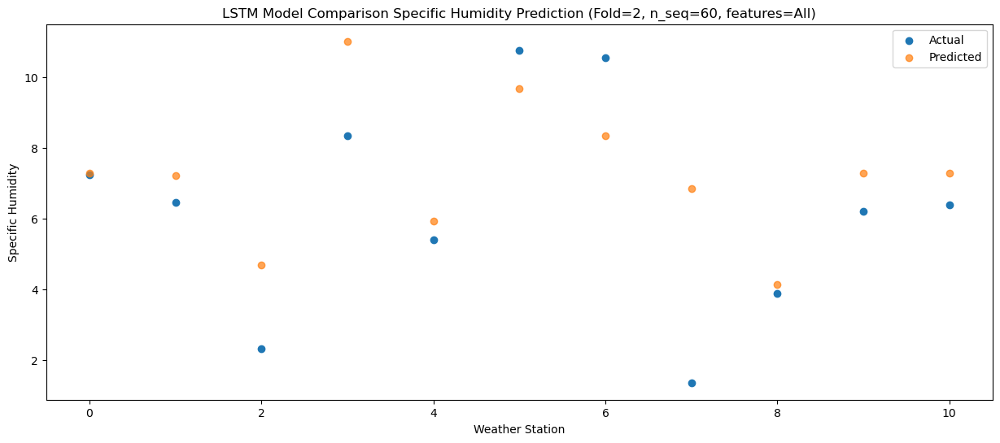

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    9.30   9.654512
1                 1   10.83   9.564512
2                 2    4.25   7.054512
3                 3   10.62  13.374512
4                 4    7.70   8.284512
5                 5   11.79  12.034512
6                 6   11.36  10.694512
7                 7    6.87   9.214512
8                 8    5.66   6.484512
9                 9    8.02   9.634512
10               10    8.35   9.654512


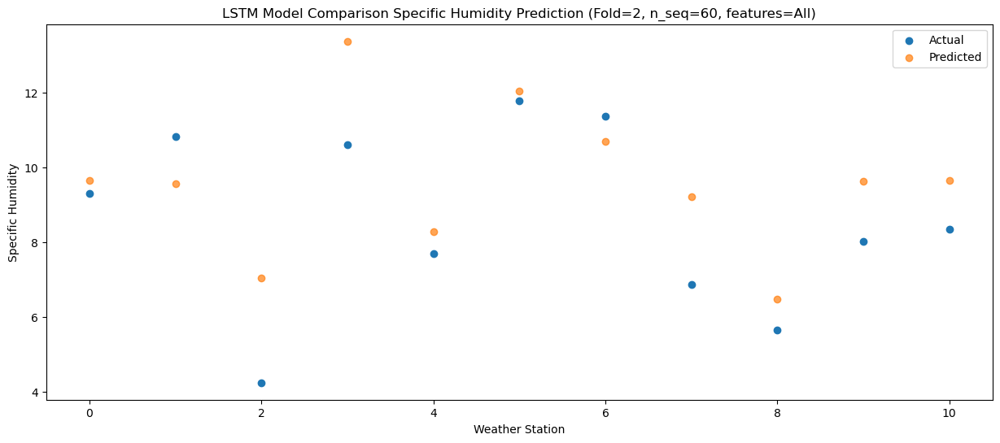

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.52  11.444635
1                 1   12.17  11.354635
2                 2    5.08   8.844635
3                 3   13.98  15.164635
4                 4    8.99  10.074635
5                 5   12.89  13.824635
6                 6   10.68  12.484635
7                 7    9.43  11.004635
8                 8    6.55   8.274635
9                 9   11.60  11.424635
10               10   11.56  11.444635


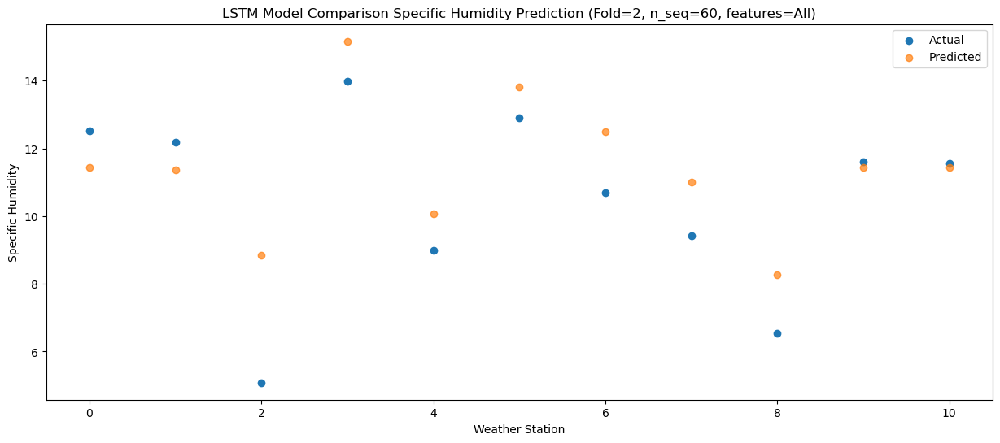

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.04  11.493538
1                 1   11.67  11.403538
2                 2    4.97   8.893538
3                 3   14.66  15.213538
4                 4    9.39  10.123538
5                 5   13.35  13.873538
6                 6   11.74  12.533538
7                 7   11.40  11.053538
8                 8    6.65   8.323538
9                 9   10.03  11.473538
10               10   10.57  11.493538


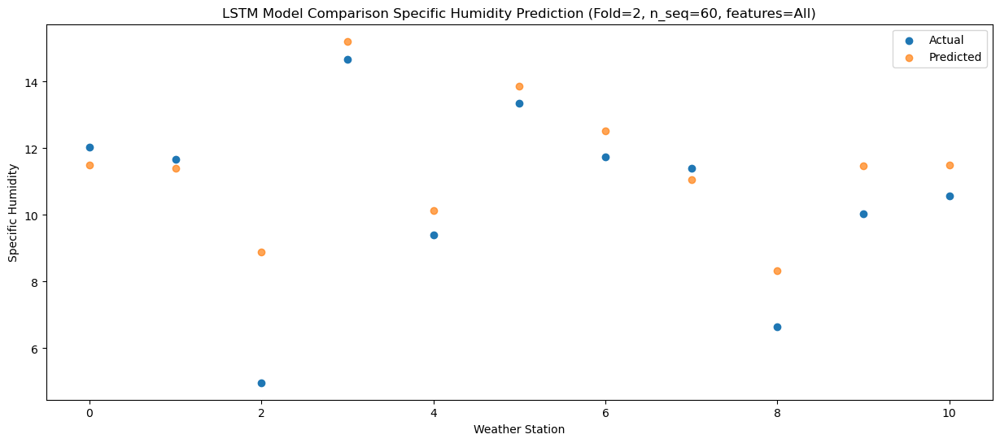

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.29    8.29787
1                 1    9.10    8.20787
2                 2    4.82    5.69787
3                 3   10.86   12.01787
4                 4    5.88    6.92787
5                 5    9.99   10.67787
6                 6    9.07    9.33787
7                 7    8.36    7.85787
8                 8    7.50    5.12787
9                 9    6.60    8.27787
10               10    7.09    8.29787


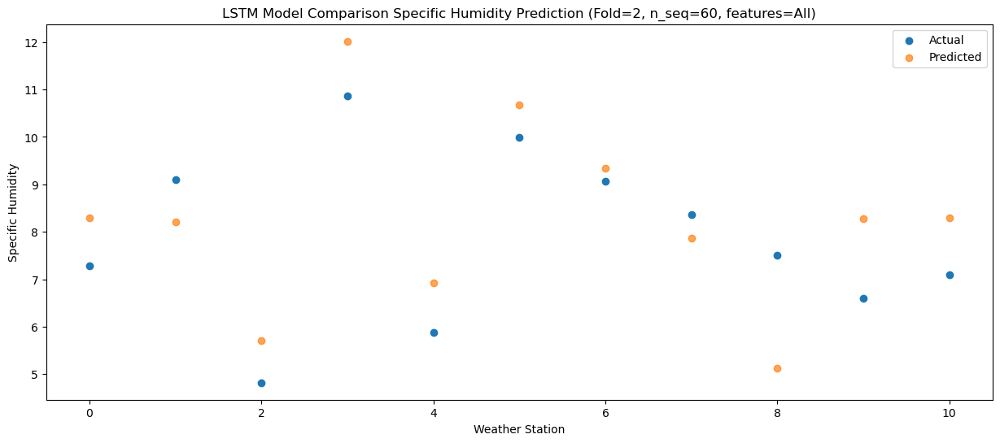

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.57   3.524496
1                 1    5.42   3.434496
2                 2    0.43   0.924496
3                 3    7.99   7.244496
4                 4    0.70   2.154496
5                 5    5.17   5.904496
6                 6    4.29   4.564496
7                 7    6.28   3.084496
8                 8    5.73   0.354496
9                 9    2.24   3.504496
10               10    2.43   3.524496


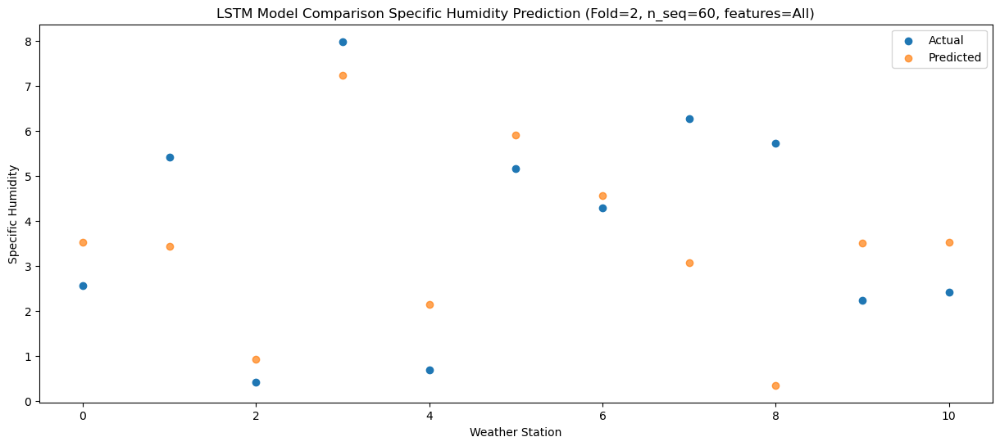

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.63   2.443338
1                 1    3.92   2.353338
2                 2    0.32  -0.156662
3                 3    6.17   6.163338
4                 4    0.26   1.073338
5                 5    5.03   4.823338
6                 6    3.84   3.483338
7                 7    2.31   2.003338
8                 8    1.09  -0.726662
9                 9    1.77   2.423338
10               10    1.81   2.443338


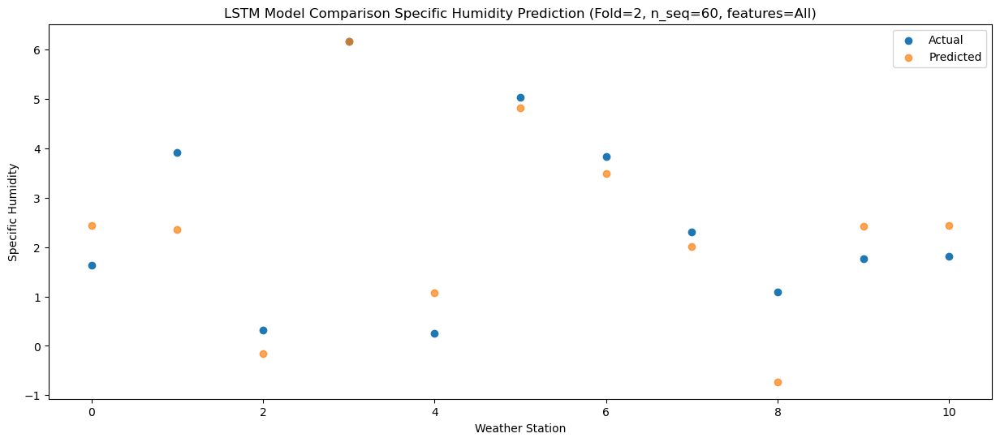

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.00   1.216937
1                 1    2.73   1.126937
2                 2   -3.34  -1.383063
3                 3    4.08   4.936937
4                 4   -0.29  -0.153063
5                 5    4.12   3.596937
6                 6    2.67   2.256937
7                 7    3.13   0.776937
8                 8    1.94  -1.953063
9                 9   -0.47   1.196937
10               10    0.72   1.216937


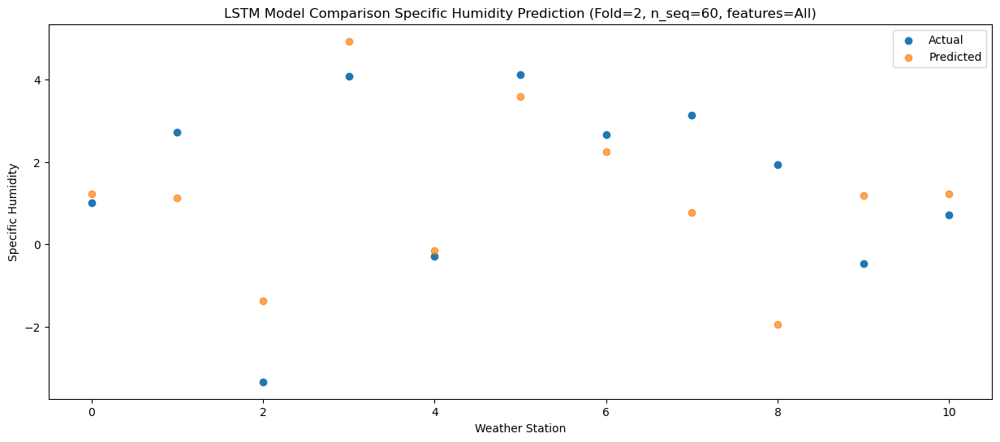

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.41   1.272619
1                 1    2.72   1.182619
2                 2   -3.72  -1.327381
3                 3    4.59   4.992619
4                 4   -0.38  -0.097381
5                 5    3.74   3.652619
6                 6    1.89   2.312619
7                 7    2.24   0.832619
8                 8    2.03  -1.897381
9                 9    0.39   1.252619
10               10    0.99   1.272619


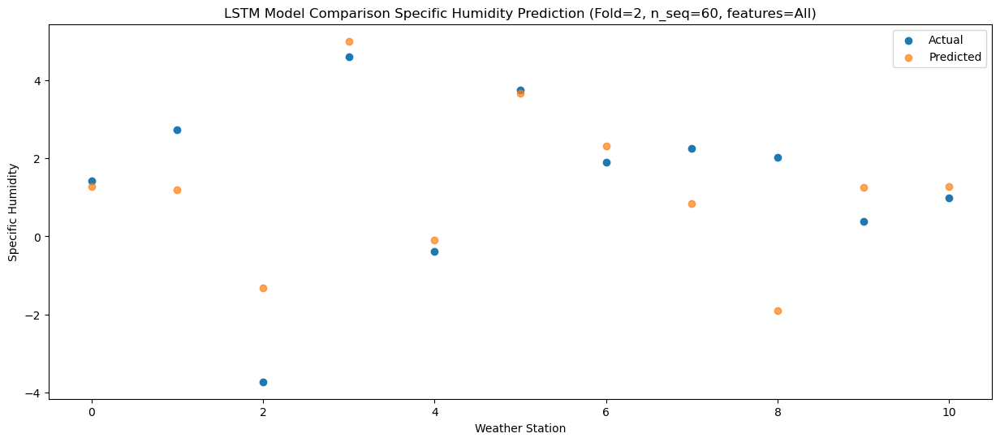

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.63   1.097269
1                 1    2.64   1.007269
2                 2   -1.87  -1.502731
3                 3    3.83   4.817269
4                 4    0.92  -0.272731
5                 5    4.19   3.477269
6                 6    2.29   2.137269
7                 7    2.12   0.657269
8                 8    0.62  -2.072731
9                 9    1.15   1.077269
10               10    1.39   1.097269


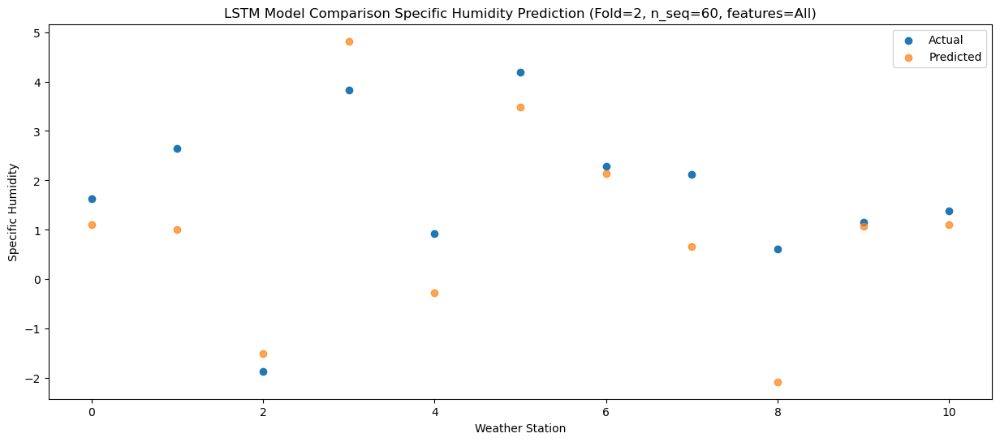

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.98   2.016715
1                 1    3.33   1.926715
2                 2   -1.48  -0.583285
3                 3    4.08   5.736715
4                 4    1.80   0.646715
5                 5    5.97   4.396715
6                 6    4.20   3.056715
7                 7    2.46   1.576715
8                 8    2.54  -1.153285
9                 9    0.84   1.996715
10               10    0.99   2.016715


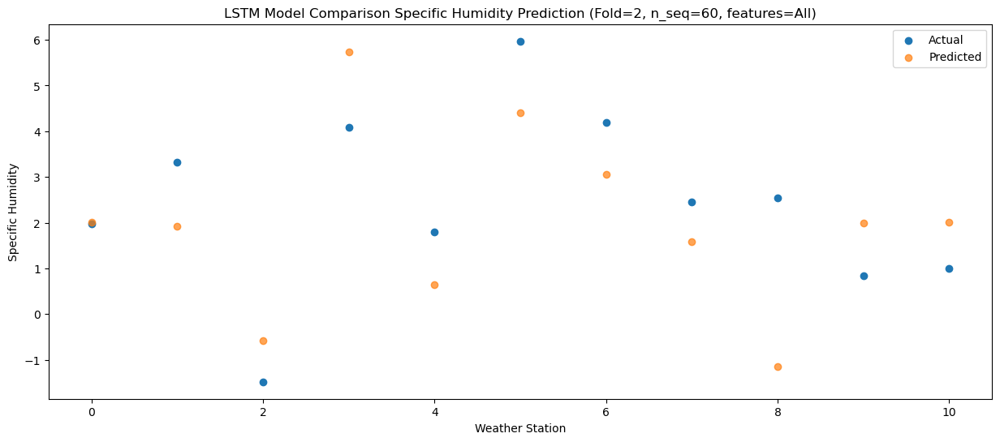

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.92   3.158261
1                 1    3.95   3.068261
2                 2    0.03   0.558261
3                 3    6.16   6.878261
4                 4    2.35   1.788261
5                 5    6.52   5.538261
6                 6    4.87   4.198261
7                 7    1.62   2.718261
8                 8    3.24  -0.011739
9                 9    2.97   3.138261
10               10    2.63   3.158261


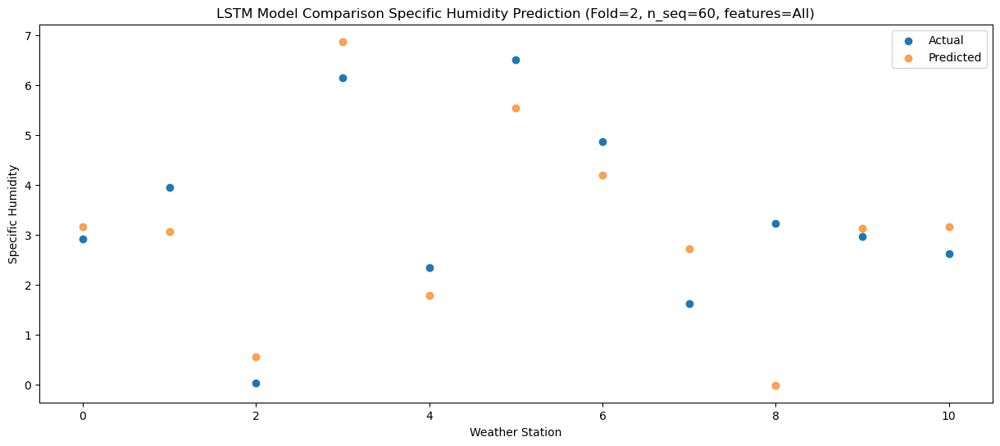

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.53   6.184682
1                 1    9.73   6.094682
2                 2    0.84   3.584682
3                 3    6.97   9.904682
4                 4    5.41   4.814682
5                 5   10.22   8.564682
6                 6    8.76   7.224682
7                 7    3.62   5.744682
8                 8    4.64   3.014682
9                 9    4.50   6.164682
10               10    5.22   6.184682


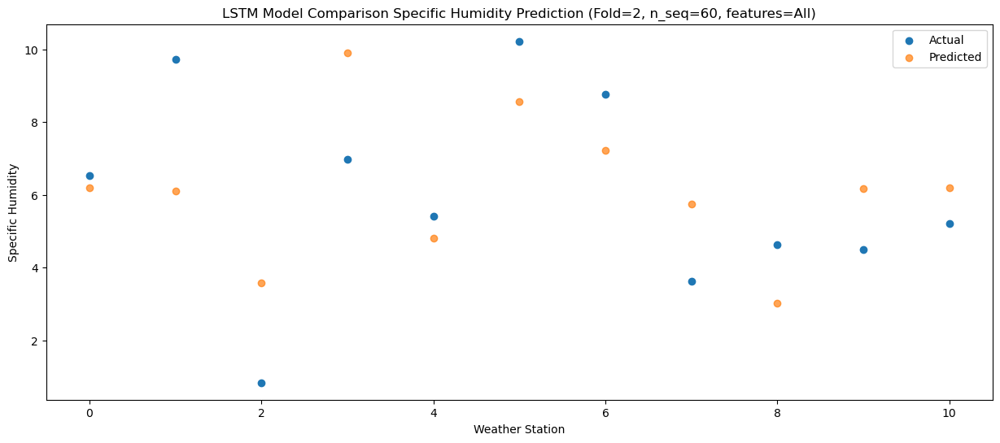

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.50   9.337792
1                 1   12.38   9.247792
2                 2    4.00   6.737792
3                 3   10.87  13.057792
4                 4    8.72   7.967792
5                 5   13.68  11.717792
6                 6   12.66  10.377792
7                 7    3.42   8.897792
8                 8    5.02   6.167792
9                 9    7.36   9.317792
10               10    7.06   9.337792


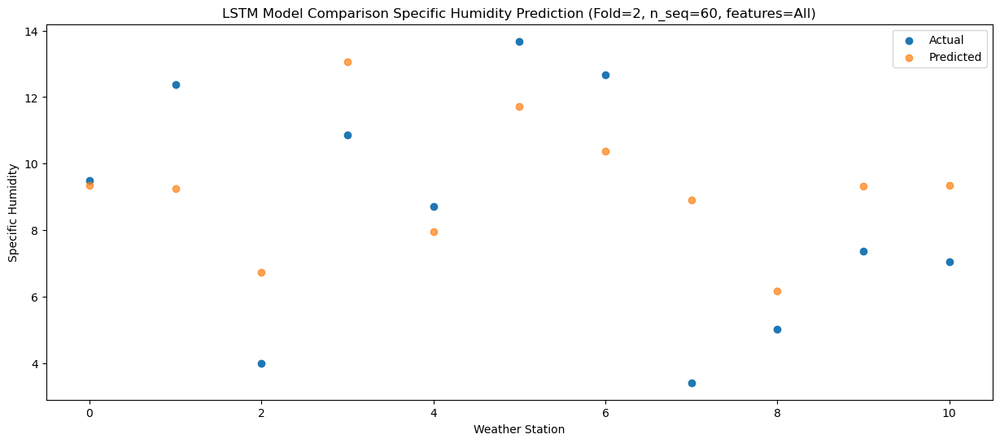

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.68  11.933969
1                 1   14.44  11.843969
2                 2    4.97   9.333969
3                 3   15.13  15.653969
4                 4   10.06  10.563969
5                 5   13.39  14.313969
6                 6   11.95  12.973969
7                 7    6.77  11.493969
8                 8    6.36   8.763969
9                 9   11.20  11.913969
10               10   10.37  11.933969


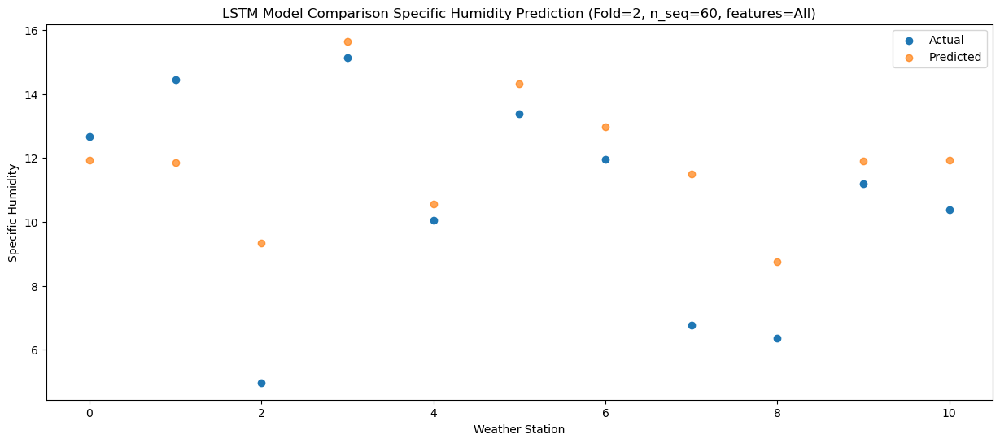

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   12.03  11.319193
1                 1   12.55  11.229193
2                 2    5.69   8.719193
3                 3   12.79  15.039193
4                 4   10.09   9.949193
5                 5   11.96  13.699193
6                 6    9.90  12.359193
7                 7    8.96  10.879193
8                 8    6.97   8.149193
9                 9   10.71  11.299193
10               10   10.48  11.319193


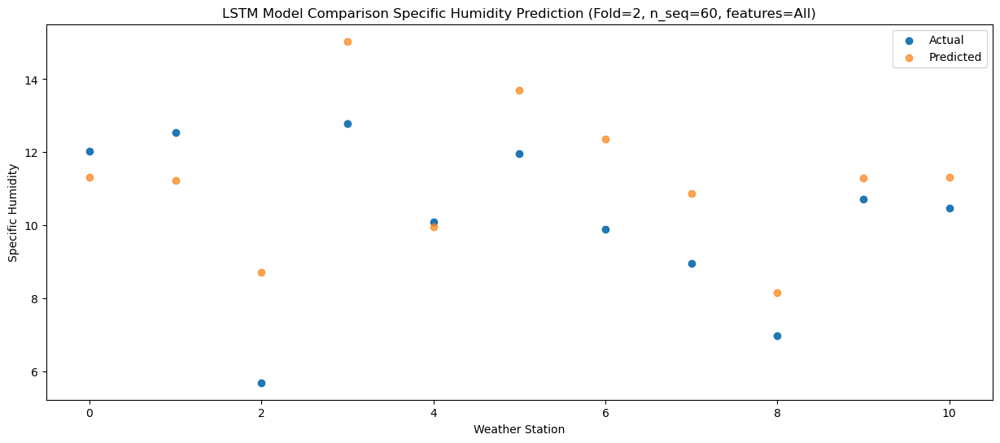

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.00   8.980896
1                 1    9.96   8.890896
2                 2    3.30   6.380896
3                 3   11.78  12.700896
4                 4    7.74   7.610896
5                 5   11.41  11.360896
6                 6    9.27  10.020896
7                 7    7.15   8.540896
8                 8    6.72   5.810896
9                 9    7.57   8.960896
10               10    8.06   8.980896


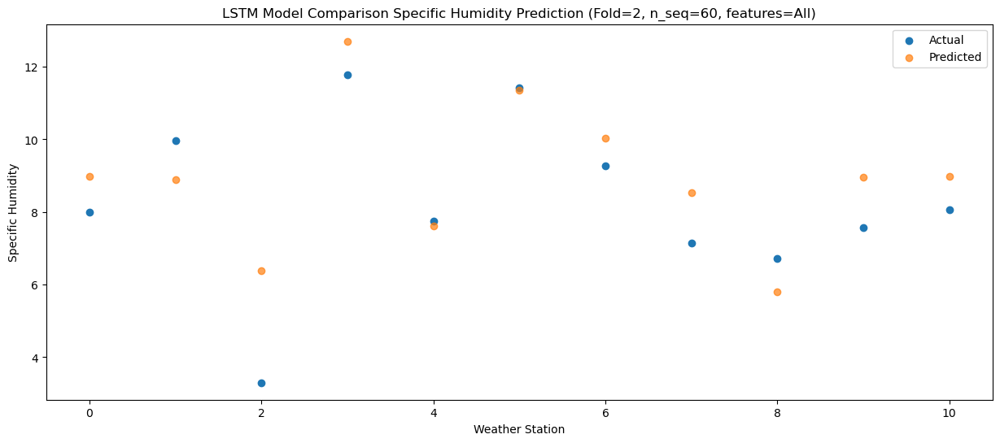

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    3.90   5.384915
1                 1    6.50   5.294915
2                 2    0.38   2.784915
3                 3    8.42   9.104915
4                 4    2.51   4.014915
5                 5    7.88   7.764915
6                 6    6.12   6.424915
7                 7    4.70   4.944915
8                 8    4.42   2.214915
9                 9    3.38   5.364915
10               10    3.95   5.384915


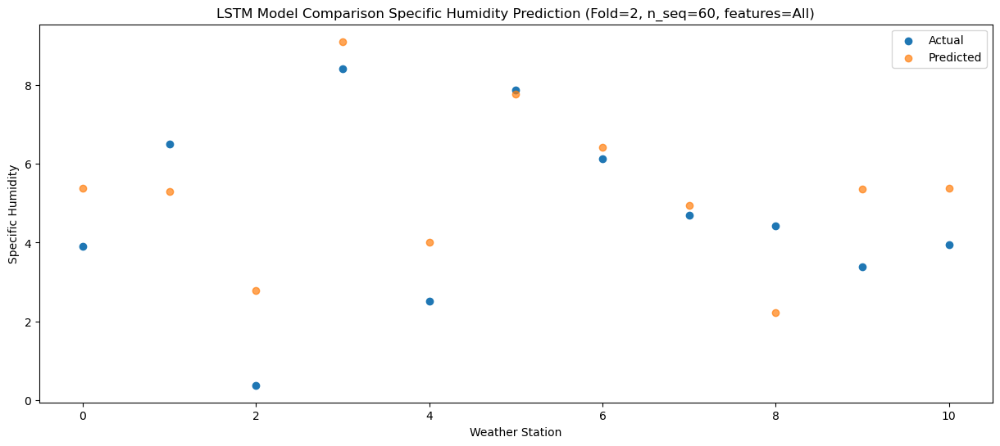

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.26   2.491869
1                 1    3.94   2.401869
2                 2   -2.12  -0.108131
3                 3    4.59   6.211869
4                 4   -0.01   1.121869
5                 5    4.71   4.871869
6                 6    3.50   3.531869
7                 7    3.78   2.051869
8                 8    1.39  -0.678131
9                 9    0.27   2.471869
10               10    1.00   2.491869


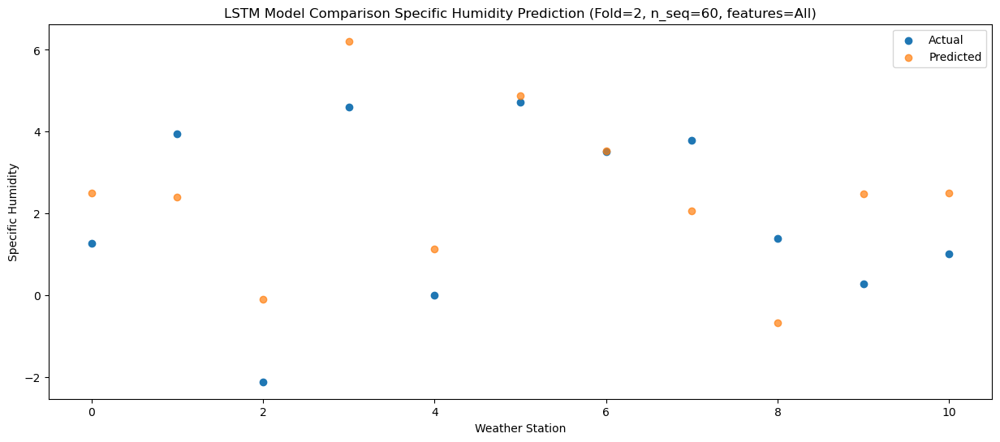

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.34   1.934997
1                 1    3.55   1.844997
2                 2   -2.69  -0.665003
3                 3    4.88   5.654997
4                 4   -1.60   0.564997
5                 5    2.78   4.314997
6                 6    1.68   2.974997
7                 7    2.26   1.494997
8                 8    2.18  -1.235003
9                 9    0.18   1.914997
10               10    0.79   1.934997


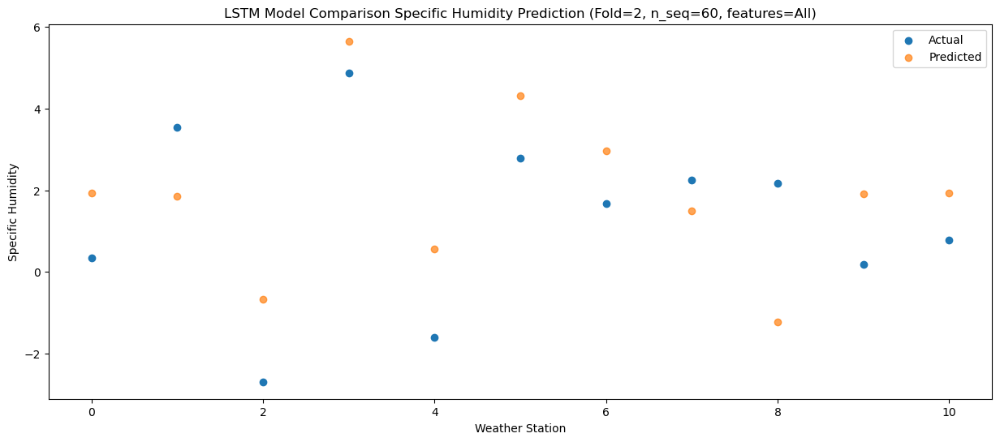

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.55   0.688854
1                 1    2.96   0.598854
2                 2   -3.76  -1.911146
3                 3    3.55   4.408854
4                 4   -2.47  -0.681146
5                 5    1.77   3.068854
6                 6    0.56   1.728854
7                 7    2.68   0.248854
8                 8    2.15  -2.481146
9                 9   -0.51   0.668854
10               10    0.17   0.688854


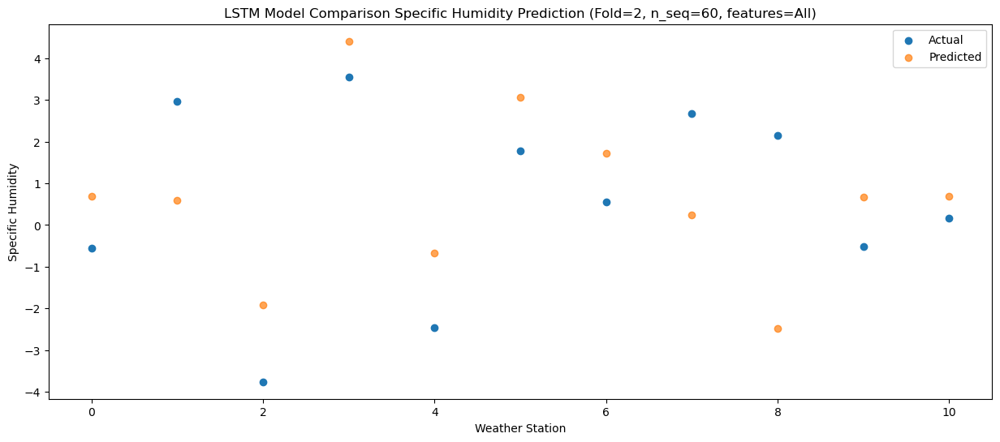

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.32   1.805936
1                 1    3.78   1.715936
2                 2   -4.18  -0.794064
3                 3    3.50   5.525936
4                 4   -1.41   0.435936
5                 5    4.17   4.185936
6                 6    3.03   2.845936
7                 7    2.70   1.365936
8                 8    3.12  -1.364064
9                 9   -0.37   1.785936
10               10    0.57   1.805936


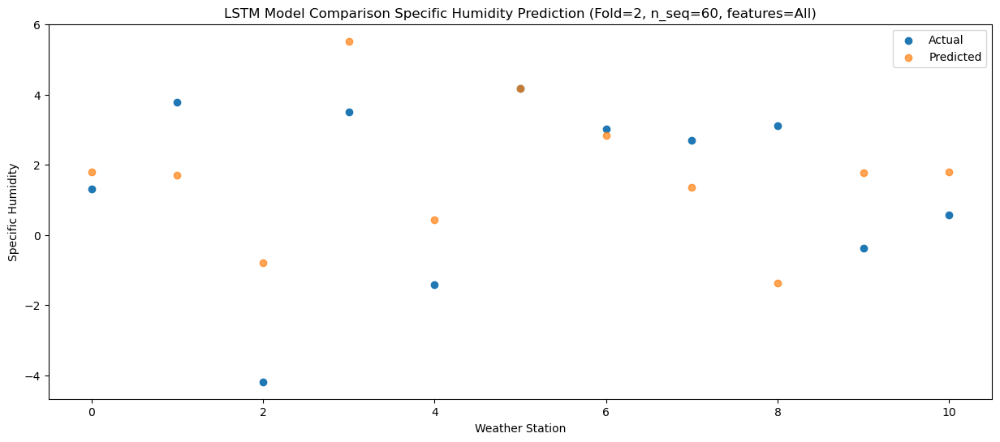

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.14   2.730865
1                 1    4.03   2.640865
2                 2   -1.02   0.130865
3                 3    4.55   6.450865
4                 4    0.19   1.360865
5                 5    5.81   5.110865
6                 6    4.65   3.770865
7                 7    2.92   2.290865
8                 8    1.56  -0.439135
9                 9    1.04   2.710865
10               10    1.67   2.730865


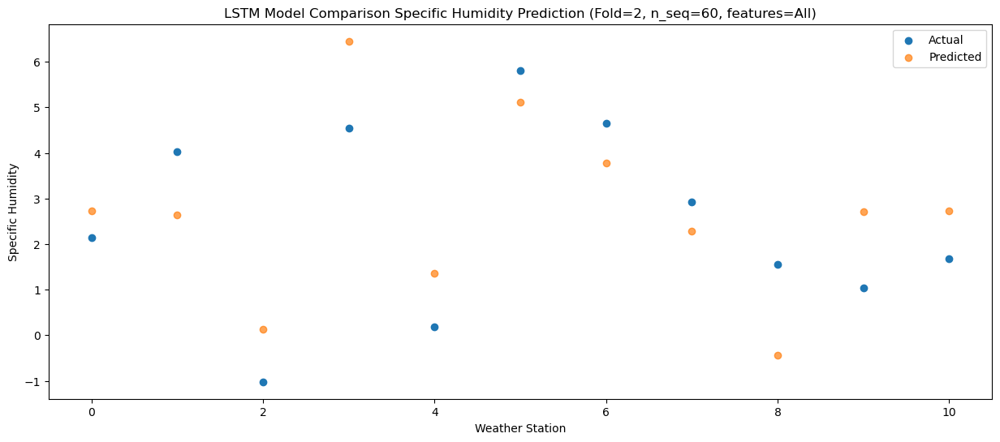

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    4.35      4.271
1                 1    4.99      4.181
2                 2   -2.23      1.671
3                 3    5.44      7.991
4                 4    2.26      2.901
5                 5    8.09      6.651
6                 6    6.85      5.311
7                 7    2.25      3.831
8                 8    0.66      1.101
9                 9    3.26      4.251
10               10    3.78      4.271


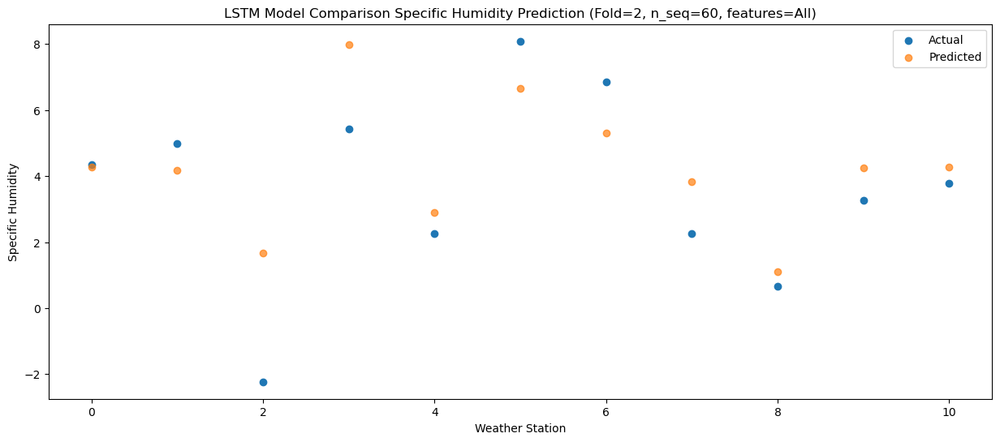

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.61   7.956451
1                 1    8.02   7.866451
2                 2    2.63   5.356451
3                 3    8.62  11.676451
4                 4    6.69   6.586451
5                 5   12.19  10.336451
6                 6   10.63   8.996451
7                 7    1.94   7.516451
8                 8    4.76   4.786451
9                 9    7.14   7.936451
10               10    7.64   7.956451


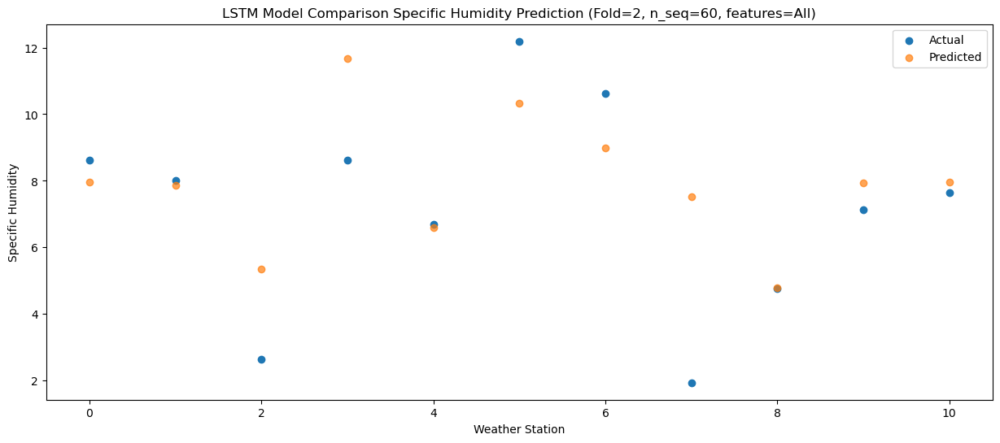

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.58  10.456111
1                 1   14.03  10.366111
2                 2    4.69   7.856111
3                 3   11.54  14.176111
4                 4    8.66   9.086111
5                 5   13.85  12.836111
6                 6   12.22  11.496111
7                 7    5.99  10.016111
8                 8    6.36   7.286111
9                 9    9.01  10.436111
10               10    9.19  10.456111


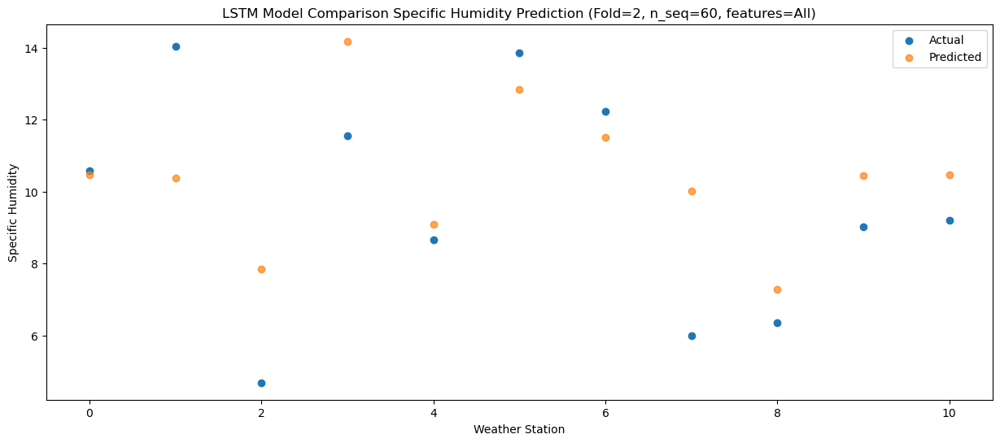

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.05  11.468431
1                 1   12.58  11.378431
2                 2    5.74   8.868431
3                 3   14.71  15.188431
4                 4   10.30  10.098431
5                 5   14.15  13.848431
6                 6   12.45  12.508431
7                 7    9.59  11.028431
8                 8    7.59   8.298431
9                 9   11.62  11.448431
10               10   11.23  11.468431


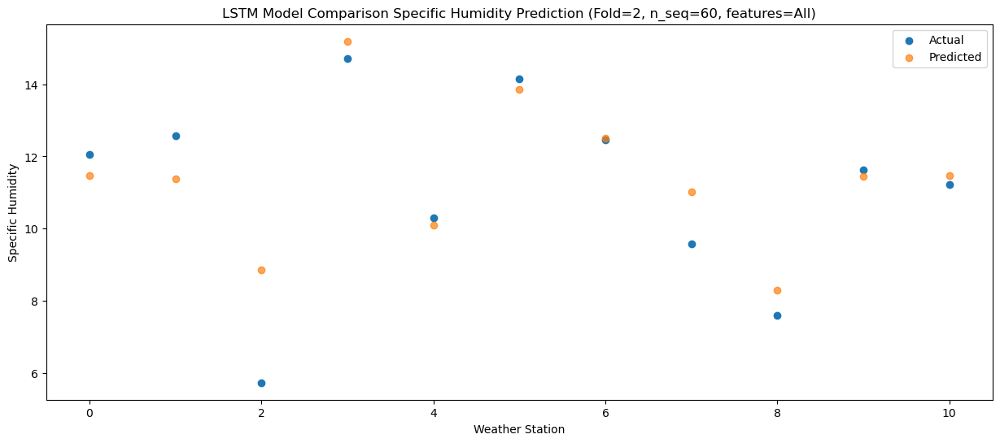

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   10.05  10.723332
1                 1   13.56  10.633332
2                 2    6.34   8.123332
3                 3   13.21  14.443332
4                 4    9.13   9.353332
5                 5   14.19  13.103332
6                 6   12.27  11.763332
7                 7    9.27  10.283332
8                 8    6.77   7.553332
9                 9   10.36  10.703332
10               10   10.22  10.723332


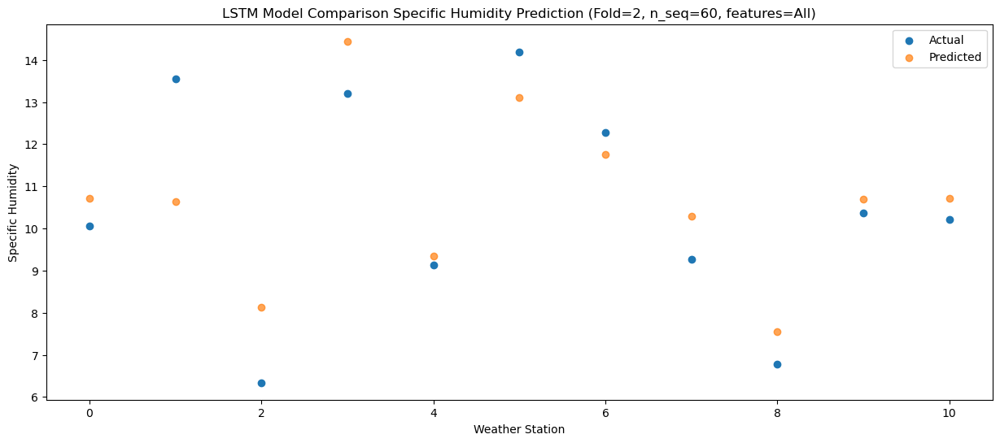

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    8.43   8.577966
1                 1    9.61   8.487966
2                 2    6.77   5.977966
3                 3   10.32  12.297966
4                 4    7.53   7.207966
5                 5   11.70  10.957966
6                 6    9.37   9.617966
7                 7    6.53   8.137966
8                 8    6.38   5.407966
9                 9    8.51   8.557966
10               10    8.12   8.577966


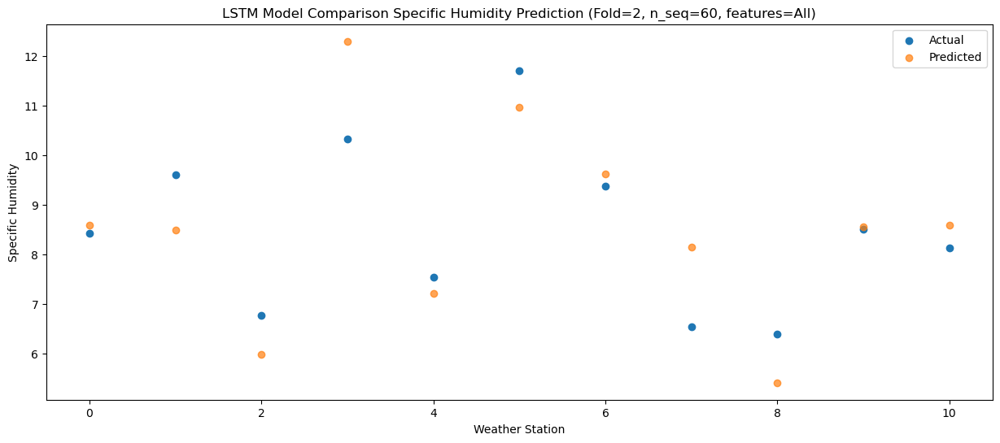

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    4.05   4.341029
1                 1    6.75   4.251029
2                 2    1.79   1.741029
3                 3    7.08   8.061029
4                 4    2.67   2.971029
5                 5    7.38   6.721029
6                 6    5.95   5.381029
7                 7    3.64   3.901029
8                 8    4.48   1.171029
9                 9    3.89   4.321029
10               10    4.05   4.341029


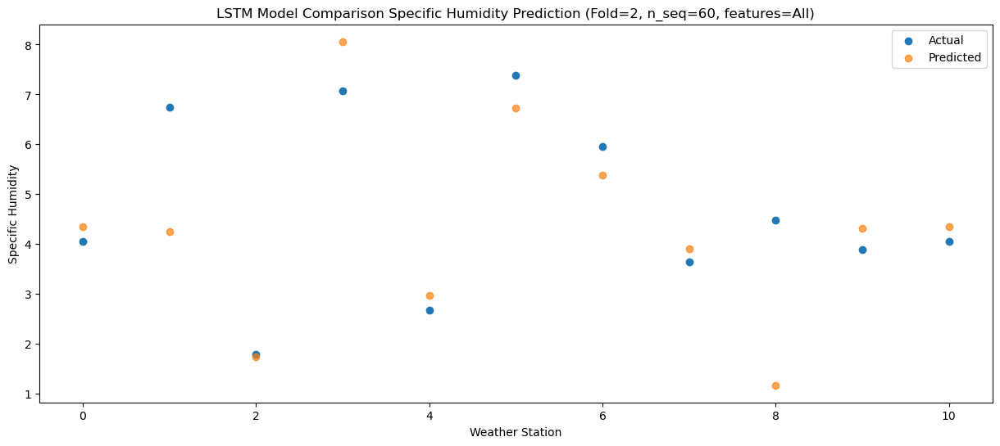

f, t:
[[ 8.500e-01  3.340e+00 -2.460e+00  4.490e+00 -2.070e+00  3.770e+00
   2.890e+00  3.550e+00  2.230e+00 -1.700e-01  5.200e-01]
 [ 1.350e+00  2.830e+00 -2.150e+00  3.930e+00 -1.270e+00  2.580e+00
   1.790e+00  3.100e+00  2.050e+00 -6.000e-02  9.700e-01]
 [ 1.060e+00  2.810e+00 -3.710e+00  3.750e+00 -1.240e+00  3.410e+00
   2.470e+00  2.150e+00  1.840e+00 -8.000e-02  7.700e-01]
 [ 7.400e-01  2.870e+00 -2.830e+00  3.770e+00 -9.200e-01  2.740e+00
   1.910e+00  2.680e+00  1.120e+00  3.100e-01  8.800e-01]
 [ 3.670e+00  4.660e+00 -1.660e+00  4.290e+00  2.570e+00  7.350e+00
   6.130e+00  4.140e+00  2.760e+00  1.940e+00  2.730e+00]
 [ 3.510e+00  4.950e+00 -1.800e-01  4.670e+00  1.610e+00  6.830e+00
   5.710e+00  2.740e+00  4.170e+00  1.850e+00  2.160e+00]
 [ 6.500e+00  7.850e+00  9.300e-01  6.920e+00  3.730e+00  8.910e+00
   8.650e+00  2.980e+00  4.930e+00  5.180e+00  4.950e+00]
 [ 9.650e+00  9.270e+00  4.270e+00  1.093e+01  7.070e+00  1.103e+01
   1.093e+01  4.660e+00  4.910e+00  8.690e+0

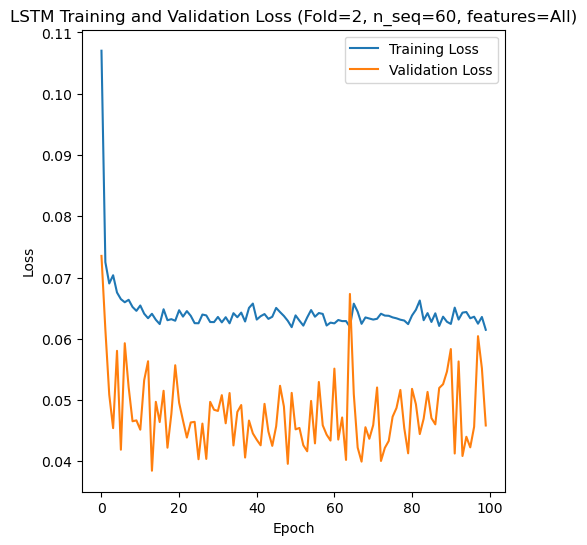

[[ 5.11  3.7   4.74 ... 13.5   8.68  7.66]
 [ 3.73  2.91  5.05 ... 11.19  6.96  6.57]
 [ 5.56  5.41  5.55 ...  8.56  7.45  5.59]
 ...
 [ 2.73  2.21  3.23 ...  5.    3.95  3.09]
 [ 5.93  5.59  5.49 ...  8.63  7.04  6.11]
 [ 3.71  2.55  2.84 ...  9.78  6.68  4.77]]
Epoch 1/100
84/84 [==============================] - 46s 250ms/step - loss: 0.1043 - accuracy: 0.2619 - mae: 0.0837 - rmse: 0.1043 - mape: 18.5479 - pearson: 0.6662 - val_loss: 0.0735 - val_accuracy: 0.0000e+00 - val_mae: 0.0573 - val_rmse: 0.0735 - val_mape: 12.2104 - val_pearson: 0.7290
Epoch 2/100
84/84 [==============================] - 14s 169ms/step - loss: 0.0750 - accuracy: 0.3929 - mae: 0.0598 - rmse: 0.0750 - mape: 13.5592 - pearson: 0.7508 - val_loss: 0.0678 - val_accuracy: 0.6000 - val_mae: 0.0535 - val_rmse: 0.0678 - val_mape: 11.7974 - val_pearson: 0.6967
Epoch 3/100
84/84 [==============================] - 15s 176ms/step - loss: 0.0666 - accuracy: 0.4762 - mae: 0.0526 - rmse: 0.0666 - mape: 12.0275 - pearson: 0.

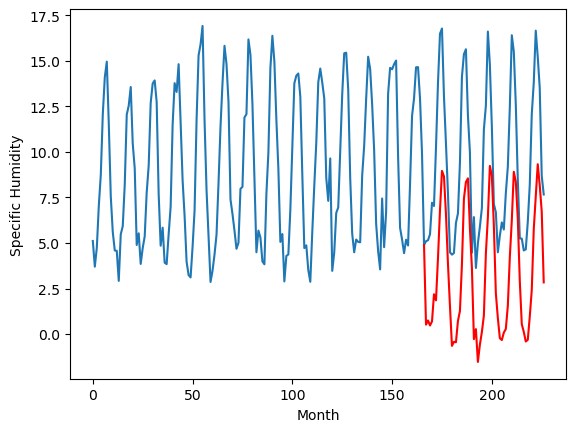

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.24		1.92		-0.32
1.83		2.15		0.32
1.80		1.87		0.07
1.44		2.10		0.66
4.04		3.59		-0.45
4.19		3.25		-0.94
7.16		5.57		-1.59
10.69		8.20		-2.49
13.43		10.36		-3.07
10.76		10.05		-0.71
9.32		7.97		-1.35
4.75		5.25		0.50
3.25		2.95		-0.30
1.21		0.75		-0.46
1.12		0.98		-0.14
0.56		0.95		0.39
3.07		2.12		-0.95
4.24		2.67		-1.57
7.76		5.23		-2.53
12.29		8.83		-3.46
13.17		9.74		-3.43
13.34		9.95		-3.39
9.37		7.21		-2.16
7.18		5.04		-2.14
2.75		1.12		-1.63
3.72		1.67		-2.05
0.53		-0.13		-0.66
0.90		0.82		-0.08
2.37		1.52		-0.85
4.67		2.42		-2.25
9.12		5.83		-3.29
11.74		7.80		-3.94
11.95		10.63		-1.32
12.56		10.09		-2.47
8.71		7.36		-1.35
4.25		3.64		-0.61
3.22		2.28		-0.94
2.03		1.17		-0.86
1.95		1.08		-0.87
2.11		1.48		-0.63
3.05		1.68		-1.37
3.92		2.95		-0.97
8.33		5.62		-2.71
10.97		7.66		-3.31
13.24		10.31		-2.93
13.48		9.76		-3.72
9.41		7.73		-1.68
5.97		4.32		-1.65
3.09		1.94		-1.15
2.27		1.52

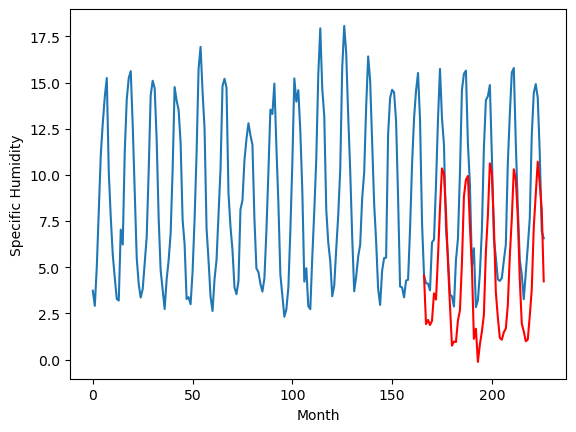

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.79		0.54		-3.25
4.33		0.77		-3.56
3.95		0.49		-3.46
3.26		0.72		-2.54
4.34		2.21		-2.13
5.71		1.87		-3.84
5.52		4.19		-1.33
7.06		6.82		-0.24
7.28		8.98		1.70
8.80		8.67		-0.13
8.32		6.59		-1.73
6.44		3.87		-2.57
3.75		1.57		-2.18
3.15		-0.63		-3.78
3.59		-0.40		-3.99
3.53		-0.43		-3.96
3.61		0.74		-2.87
4.23		1.29		-2.94
4.63		3.85		-0.78
7.08		7.45		0.37
7.78		8.36		0.58
7.31		8.57		1.26
6.02		5.83		-0.19
4.88		3.66		-1.22
5.46		-0.26		-5.72
3.96		0.29		-3.67
3.68		-1.51		-5.19
2.90		-0.56		-3.46
4.24		0.14		-4.10
3.91		1.04		-2.87
4.09		4.45		0.36
5.26		6.42		1.16
6.43		9.25		2.82
7.22		8.71		1.49
6.93		5.98		-0.95
5.76		2.26		-3.50
3.04		0.90		-2.14
3.88		-0.21		-4.09
4.03		-0.30		-4.33
2.90		0.10		-2.80
4.42		0.30		-4.12
4.62		1.57		-3.05
5.56		4.24		-1.32
6.33		6.28		-0.05
7.43		8.93		1.50
8.50		8.38		-0.12
6.96		6.35		-0.61
5.80		2.94		-2.86
3.69		0.56		-3.13
3.92		0.14		-3.78
4.46		

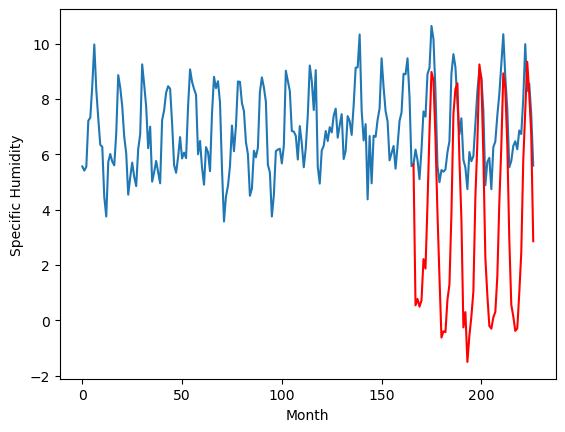

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.02		2.37		1.35
1.55		2.60		1.05
1.15		2.32		1.17
0.97		2.55		1.58
2.83		4.04		1.21
2.75		3.70		0.95
6.18		6.02		-0.16
9.42		8.65		-0.77
12.52		10.81		-1.71
11.44		10.50		-0.94
8.87		8.42		-0.45
5.18		5.70		0.52
2.29		3.40		1.11
0.68		1.20		0.52
0.41		1.43		1.02
0.34		1.40		1.06
1.64		2.57		0.93
2.83		3.12		0.29
5.36		5.68		0.32
10.78		9.28		-1.50
11.41		10.19		-1.22
12.29		10.40		-1.89
8.82		7.66		-1.16
6.76		5.49		-1.27
1.07		1.57		0.50
2.21		2.12		-0.09
-0.11		0.32		0.43
0.41		1.27		0.86
1.39		1.97		0.58
2.66		2.87		0.21
7.08		6.28		-0.80
9.34		8.25		-1.09
12.38		11.08		-1.30
11.25		10.54		-0.71
8.00		7.81		-0.19
2.85		4.09		1.24
2.04		2.73		0.69
1.01		1.62		0.61
1.55		1.53		-0.02
1.37		1.93		0.56
1.24		2.13		0.89
2.78		3.40		0.62
5.69		6.07		0.38
7.71		8.11		0.40
11.36		10.76		-0.60
10.81		10.21		-0.60
8.34		8.18		-0.16
4.81		4.77		-0.04
1.42		2.39		0.97
1.44		1.97		0.53
0.70		1.45		0.75

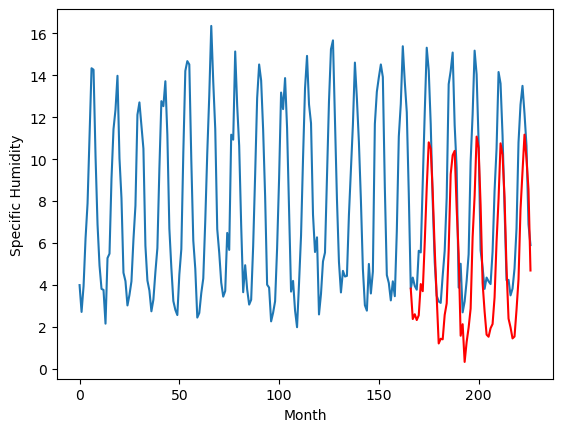

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.49		0.80		-1.69
0.99		1.03		0.04
-1.30		0.75		2.05
-2.06		0.98		3.04
0.01		2.47		2.46
0.33		2.13		1.80
4.03		4.45		0.42
7.12		7.08		-0.04
11.07		9.24		-1.83
8.69		8.93		0.24
5.73		6.85		1.12
1.01		4.13		3.12
-0.09		1.83		1.92
-2.02		-0.37		1.65
-2.22		-0.14		2.08
-3.05		-0.17		2.88
-0.57		1.00		1.57
0.49		1.55		1.06
2.91		4.11		1.20
7.37		7.71		0.34
9.32		8.62		-0.70
9.41		8.83		-0.58
5.64		6.09		0.45
3.69		3.92		0.23
-1.43		0.00		1.43
-0.73		0.55		1.28
-3.19		-1.25		1.94
-2.57		-0.30		2.27
-1.00		0.40		1.40
0.56		1.30		0.74
4.65		4.71		0.06
6.75		6.68		-0.07
9.34		9.51		0.17
8.84		8.97		0.13
5.74		6.24		0.50
0.74		2.52		1.78
-0.65		1.16		1.81
-1.77		0.05		1.82
-1.39		-0.04		1.35
-0.51		0.36		0.87
-0.84		0.56		1.40
0.39		1.83		1.44
3.57		4.50		0.93
5.70		6.54		0.84
9.47		9.19		-0.28
9.86		8.64		-1.22
5.75		6.61		0.86
2.13		3.20		1.07
-1.04		0.82		1.86
-1.45		0.40		1.85
-2.32		-0.12		2.20
-1

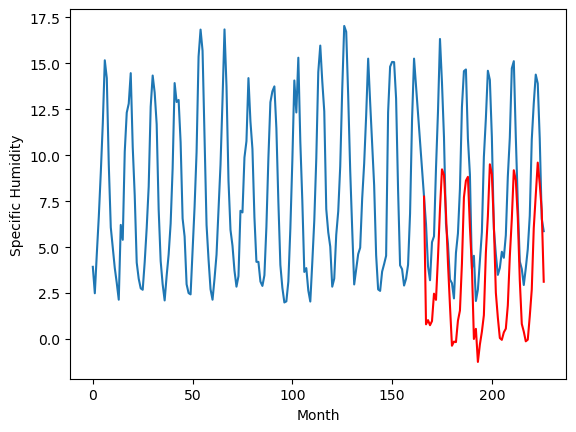

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.44		0.74		0.30
0.73		0.97		0.24
0.23		0.69		0.46
-0.02		0.92		0.94
1.97		2.41		0.44
2.09		2.07		-0.02
5.30		4.39		-0.91
8.03		7.02		-1.01
11.19		9.18		-2.01
9.97		8.87		-1.10
6.79		6.79		0.00
3.37		4.07		0.70
1.60		1.77		0.17
-0.06		-0.43		-0.37
-0.37		-0.20		0.17
-0.89		-0.23		0.66
1.14		0.94		-0.20
2.44		1.49		-0.95
4.68		4.05		-0.63
9.90		7.65		-2.25
11.15		8.56		-2.59
11.32		8.77		-2.55
8.02		6.03		-1.99
6.40		3.86		-2.54
0.53		-0.06		-0.59
1.58		0.49		-1.09
-0.93		-1.31		-0.38
-0.40		-0.36		0.04
0.91		0.34		-0.57
2.44		1.24		-1.20
6.67		4.65		-2.02
8.74		6.62		-2.12
11.52		9.45		-2.07
10.32		8.91		-1.41
7.55		6.18		-1.37
2.25		2.46		0.21
1.03		1.10		0.07
0.27		-0.01		-0.28
0.85		-0.10		-0.95
0.52		0.30		-0.22
0.95		0.50		-0.45
2.26		1.77		-0.49
4.86		4.44		-0.42
7.02		6.48		-0.54
11.53		9.13		-2.40
10.65		8.58		-2.07
7.42		6.55		-0.87
4.04		3.14		-0.90
0.85		0.76		-0.09
0.81		0.34		-0.

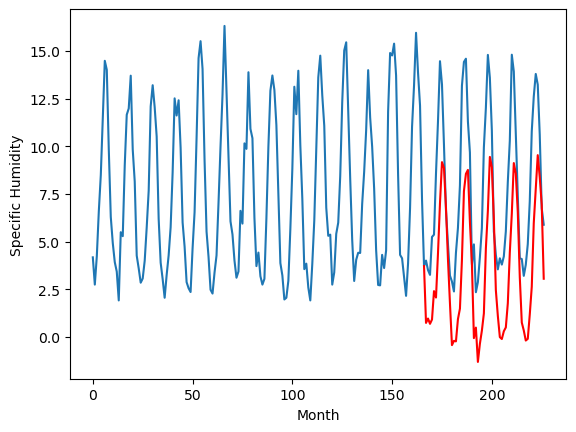

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.78		0.99		-3.79
4.41		1.22		-3.19
4.37		0.94		-3.43
4.33		1.17		-3.16
4.96		2.66		-2.30
5.31		2.32		-2.99
6.44		4.64		-1.80
7.50		7.27		-0.23
9.02		9.43		0.41
7.81		9.12		1.31
6.67		7.04		0.37
5.02		4.32		-0.70
4.96		2.02		-2.94
4.15		-0.18		-4.33
4.32		0.05		-4.27
4.38		0.02		-4.36
4.69		1.19		-3.50
5.16		1.74		-3.42
6.56		4.30		-2.26
7.89		7.90		0.01
10.34		8.81		-1.53
8.91		9.02		0.11
7.21		6.28		-0.93
6.12		4.11		-2.01
5.41		0.19		-5.22
4.70		0.74		-3.96
4.22		-1.06		-5.28
4.01		-0.11		-4.12
4.69		0.59		-4.10
5.19		1.49		-3.70
6.00		4.90		-1.10
7.94		6.87		-1.07
10.93		9.70		-1.23
10.77		9.16		-1.61
7.82		6.43		-1.39
6.21		2.71		-3.50
4.55		1.35		-3.20
4.58		0.24		-4.34
4.55		0.15		-4.40
4.17		0.55		-3.62
4.47		0.75		-3.72
5.10		2.02		-3.08
7.26		4.69		-2.57
7.49		6.73		-0.76
8.33		9.38		1.05
9.98		8.83		-1.15
7.36		6.80		-0.56
6.11		3.39		-2.72
4.78		1.01		-3.77
4.65		0.59		-4.06
4.59	

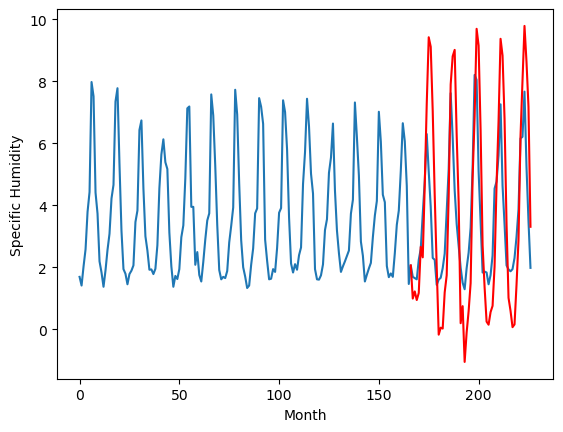

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.69		-1.50		-4.19
3.68		-1.27		-4.95
2.56		-1.55		-4.11
2.14		-1.32		-3.46
3.88		0.17		-3.71
3.69		-0.17		-3.86
2.99		2.15		-0.84
3.32		4.78		1.46
3.80		6.94		3.14
4.67		6.63		1.96
3.41		4.55		1.14
2.40		1.83		-0.57
2.38		-0.47		-2.85
1.55		-2.67		-4.22
2.36		-2.44		-4.80
1.88		-2.47		-4.35
2.18		-1.30		-3.48
1.87		-0.75		-2.62
2.43		1.81		-0.62
3.85		5.41		1.56
9.21		6.32		-2.89
6.78		6.53		-0.25
5.06		3.79		-1.27
3.96		1.62		-2.34
2.69		-2.30		-4.99
2.83		-1.75		-4.58
1.84		-3.55		-5.39
1.41		-2.60		-4.01
2.03		-1.90		-3.93
2.03		-1.00		-3.03
2.29		2.41		0.12
4.05		4.38		0.33
7.48		7.21		-0.27
10.55		6.67		-3.88
6.64		3.94		-2.70
3.91		0.22		-3.69
2.14		-1.14		-3.28
2.89		-2.25		-5.14
3.28		-2.34		-5.62
2.03		-1.94		-3.97
3.07		-1.74		-4.81
2.22		-0.47		-2.69
3.76		2.20		-1.56
4.26		4.24		-0.02
5.23		6.89		1.66
7.81		6.34		-1.47
6.87		4.31		-2.56
3.81		0.90		-2.91
2.80		-1.48		-4.28
2.72		

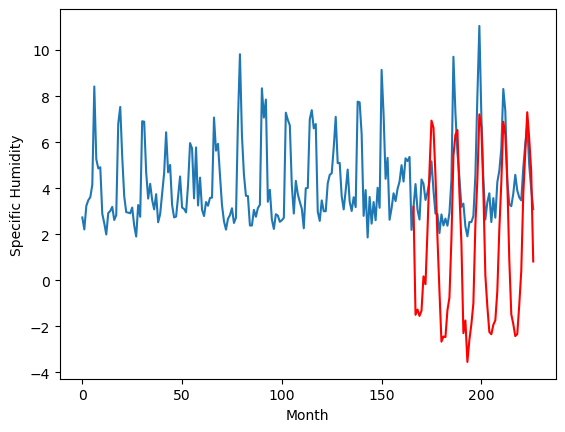

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.33		-0.46		-3.79
4.56		-0.23		-4.79
3.88		-0.51		-4.39
2.99		-0.28		-3.27
3.47		1.21		-2.26
4.53		0.87		-3.66
5.39		3.19		-2.20
5.61		5.82		0.21
6.08		7.98		1.90
6.88		7.67		0.79
6.49		5.59		-0.90
4.29		2.87		-1.42
3.13		0.57		-2.56
2.79		-1.63		-4.42
3.46		-1.40		-4.86
3.11		-1.43		-4.54
2.76		-0.26		-3.02
3.69		0.29		-3.40
4.13		2.85		-1.28
5.56		6.45		0.89
6.04		7.36		1.32
6.43		7.57		1.14
5.79		4.83		-0.96
4.76		2.66		-2.10
4.98		-1.26		-6.24
3.73		-0.71		-4.44
3.40		-2.51		-5.91
2.56		-1.56		-4.12
3.56		-0.86		-4.42
3.66		0.04		-3.62
4.03		3.45		-0.58
5.52		5.42		-0.10
6.35		8.25		1.90
6.81		7.71		0.90
6.21		4.98		-1.23
4.90		1.26		-3.64
2.65		-0.10		-2.75
3.44		-1.21		-4.65
3.27		-1.30		-4.57
2.41		-0.90		-3.31
3.21		-0.70		-3.91
3.59		0.57		-3.02
5.18		3.24		-1.94
5.24		5.28		0.04
6.08		7.93		1.85
7.35		7.38		0.03
6.80		5.35		-1.45
5.37		1.94		-3.43
4.28		-0.44		-4.72
4.66		-0.86		-5

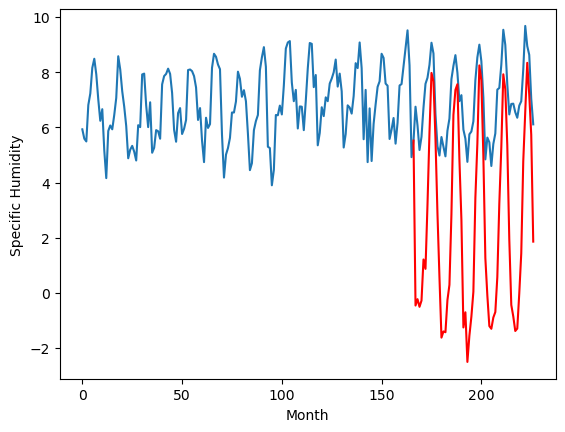

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.25		2.74		0.49
1.89		2.97		1.08
1.61		2.69		1.08
1.69		2.92		1.23
2.18		4.41		2.23
2.68		4.07		1.39
4.91		6.39		1.48
9.02		9.02		-0.00
13.00		11.18		-1.82
11.93		10.87		-1.06
8.56		8.79		0.23
6.03		6.07		0.04
3.87		3.77		-0.10
1.91		1.57		-0.34
0.82		1.80		0.98
0.97		1.77		0.80
1.75		2.94		1.19
3.13		3.49		0.36
4.70		6.05		1.35
9.60		9.65		0.05
11.81		10.56		-1.25
12.19		10.77		-1.42
9.59		8.03		-1.56
7.05		5.86		-1.19
2.52		1.94		-0.58
2.22		2.49		0.27
0.74		0.69		-0.05
1.33		1.64		0.31
2.17		2.34		0.17
2.82		3.24		0.42
6.21		6.65		0.44
8.55		8.62		0.07
11.71		11.45		-0.26
11.85		10.91		-0.94
8.18		8.18		-0.00
5.55		4.46		-1.09
3.70		3.10		-0.60
1.73		1.99		0.26
2.30		1.90		-0.40
1.59		2.30		0.71
1.80		2.50		0.70
4.04		3.77		-0.27
4.56		6.44		1.88
8.26		8.48		0.22
13.11		11.13		-1.98
10.54		10.58		0.04
9.57		8.55		-1.02
6.18		5.14		-1.04
2.38		2.76		0.38
2.71		2.34		-0.37
1.41		1.82		0.41

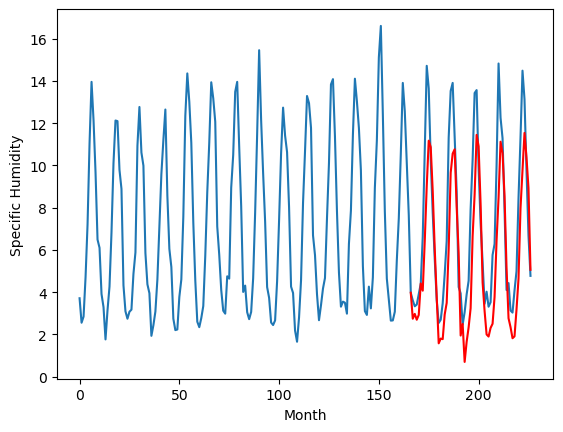

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.54		0.52		1.06
-0.66		0.75		1.41
-0.74		0.47		1.21
-0.75		0.70		1.45
0.21		2.19		1.98
0.64		1.85		1.21
3.17		4.17		1.00
6.74		6.80		0.06
10.09		8.96		-1.13
9.45		8.65		-0.80
6.16		6.57		0.41
3.39		3.85		0.46
1.06		1.55		0.49
-0.79		-0.65		0.14
-1.48		-0.42		1.06
-1.62		-0.45		1.17
-0.34		0.72		1.06
1.07		1.27		0.20
2.66		3.83		1.17
7.53		7.43		-0.10
9.22		8.34		-0.88
9.54		8.55		-0.99
6.62		5.81		-0.81
4.72		3.64		-1.08
-0.20		-0.28		-0.08
-0.30		0.27		0.57
-1.81		-1.53		0.28
-1.11		-0.58		0.53
-0.17		0.12		0.29
0.47		1.02		0.55
4.65		4.43		-0.22
6.05		6.40		0.35
9.03		9.23		0.20
8.66		8.69		0.03
5.64		5.96		0.32
2.22		2.24		0.02
1.00		0.88		-0.12
-0.92		-0.23		0.69
-0.14		-0.32		-0.18
-0.89		0.08		0.97
-0.76		0.28		1.04
1.67		1.55		-0.12
2.14		4.22		2.08
5.83		6.26		0.43
9.81		8.91		-0.90
8.57		8.36		-0.21
6.88		6.33		-0.55
3.61		2.92		-0.69
-0.07		0.54		0.61
0.31		0.12		-0.19
-0.82		-0.

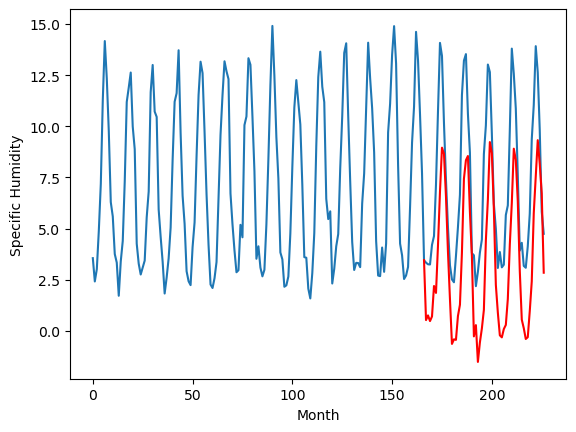

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.29   0.519493
1                 1    2.24   1.919493
2                 2    3.79   0.539493
3                 3    1.02   2.369493
4                 4    2.49   0.799493
5                 5    0.44   0.739493
6                 6    4.78   0.989493
7                 7    2.69  -1.500507
8                 8    3.33  -0.460507
9                 9    2.25   2.739493
10               10   -0.54   0.519493


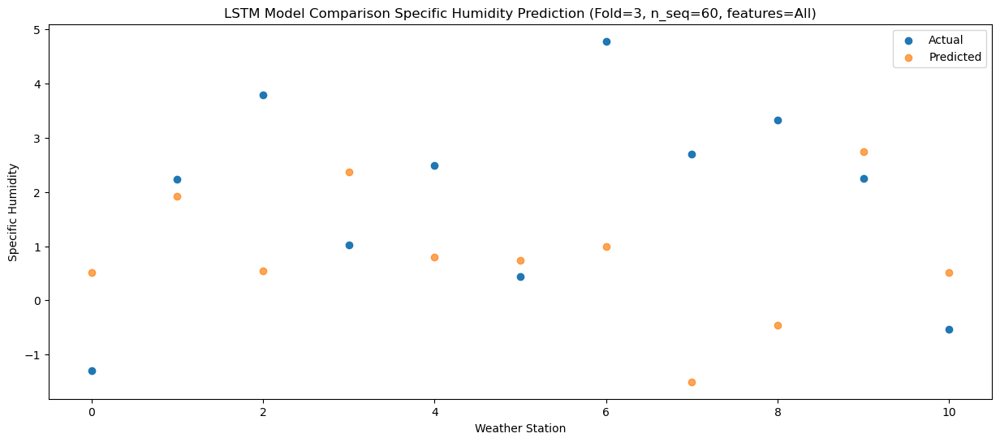

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -1.08   0.749934
1                 1    1.83   2.149934
2                 2    4.33   0.769934
3                 3    1.55   2.599934
4                 4    0.99   1.029934
5                 5    0.73   0.969934
6                 6    4.41   1.219934
7                 7    3.68  -1.270066
8                 8    4.56  -0.230066
9                 9    1.89   2.969934
10               10   -0.66   0.749934


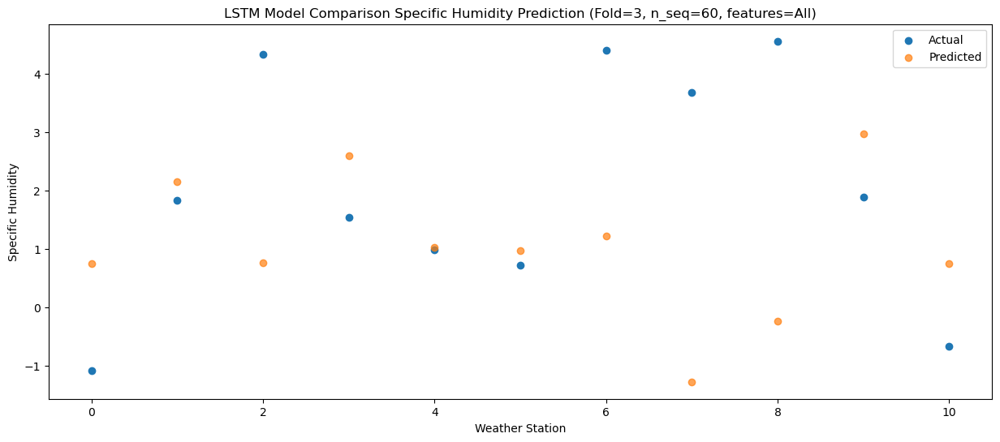

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.03   0.472112
1                 1    1.80   1.872112
2                 2    3.95   0.492112
3                 3    1.15   2.322112
4                 4   -1.30   0.752112
5                 5    0.23   0.692112
6                 6    4.37   0.942112
7                 7    2.56  -1.547888
8                 8    3.88  -0.507888
9                 9    1.61   2.692112
10               10   -0.74   0.472112


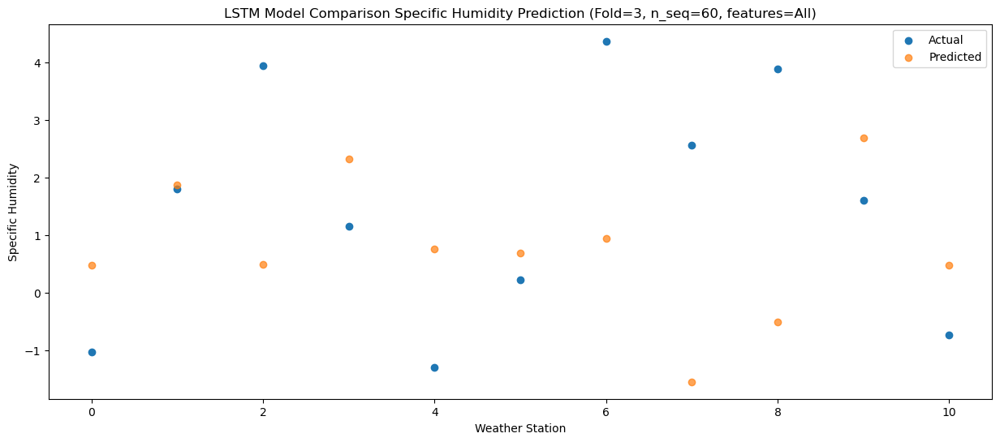

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.70   0.698786
1                 1    1.44   2.098786
2                 2    3.26   0.718786
3                 3    0.97   2.548786
4                 4   -2.06   0.978786
5                 5   -0.02   0.918786
6                 6    4.33   1.168786
7                 7    2.14  -1.321214
8                 8    2.99  -0.281214
9                 9    1.69   2.918786
10               10   -0.75   0.698786


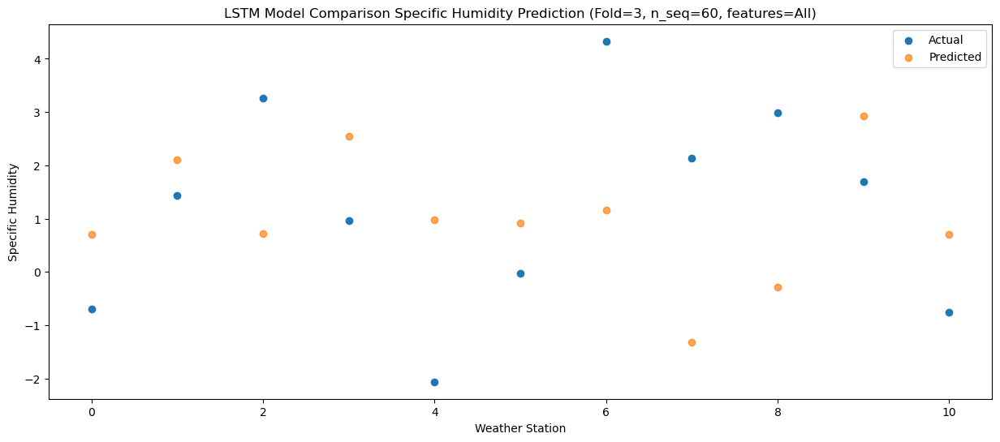

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.03   2.189271
1                 1    4.04   3.589271
2                 2    4.34   2.209271
3                 3    2.83   4.039271
4                 4    0.01   2.469271
5                 5    1.97   2.409271
6                 6    4.96   2.659271
7                 7    3.88   0.169271
8                 8    3.47   1.209271
9                 9    2.18   4.409271
10               10    0.21   2.189271


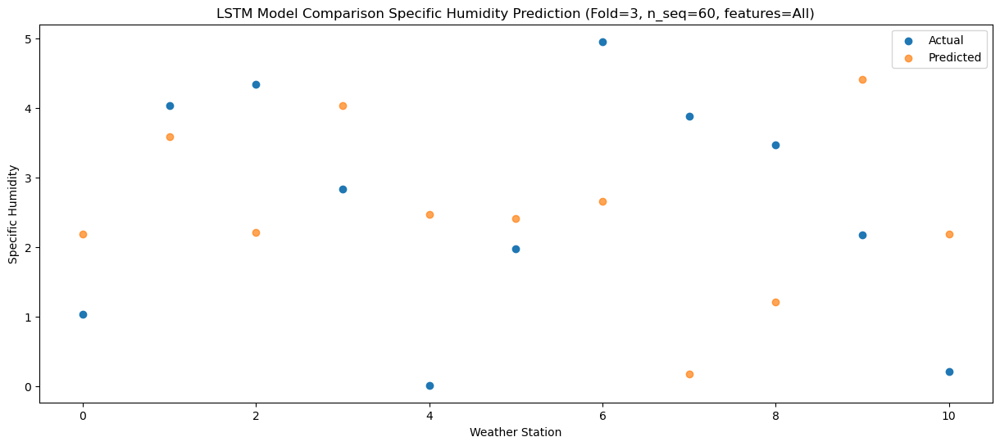

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    0.85   1.849832
1                 1    4.19   3.249832
2                 2    5.71   1.869832
3                 3    2.75   3.699832
4                 4    0.33   2.129832
5                 5    2.09   2.069832
6                 6    5.31   2.319832
7                 7    3.69  -0.170168
8                 8    4.53   0.869832
9                 9    2.68   4.069832
10               10    0.64   1.849832


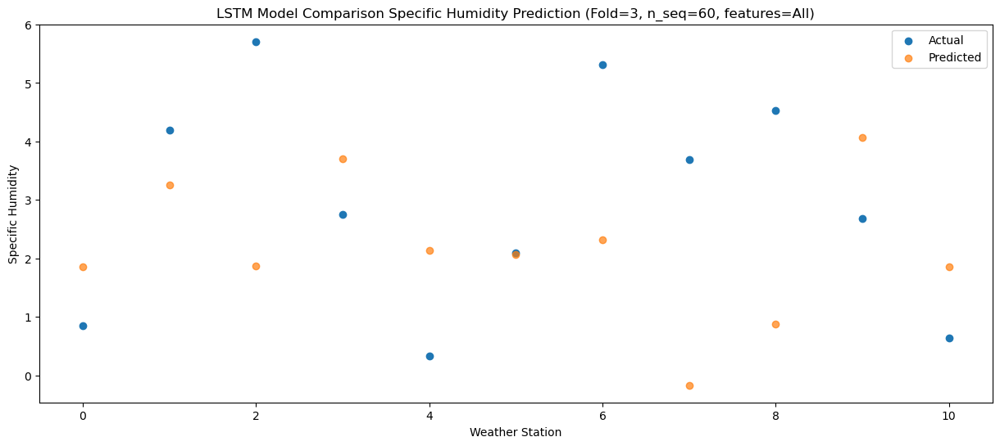

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    4.07   4.174704
1                 1    7.16   5.574704
2                 2    5.52   4.194704
3                 3    6.18   6.024704
4                 4    4.03   4.454704
5                 5    5.30   4.394704
6                 6    6.44   4.644704
7                 7    2.99   2.154704
8                 8    5.39   3.194704
9                 9    4.91   6.394704
10               10    3.17   4.174704


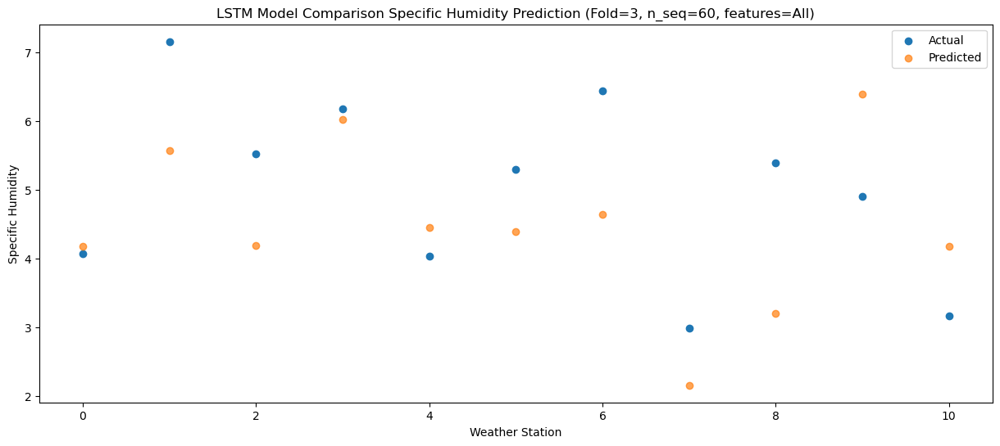

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.61   6.799616
1                 1   10.69   8.199616
2                 2    7.06   6.819616
3                 3    9.42   8.649616
4                 4    7.12   7.079616
5                 5    8.03   7.019616
6                 6    7.50   7.269616
7                 7    3.32   4.779616
8                 8    5.61   5.819616
9                 9    9.02   9.019616
10               10    6.74   6.799616


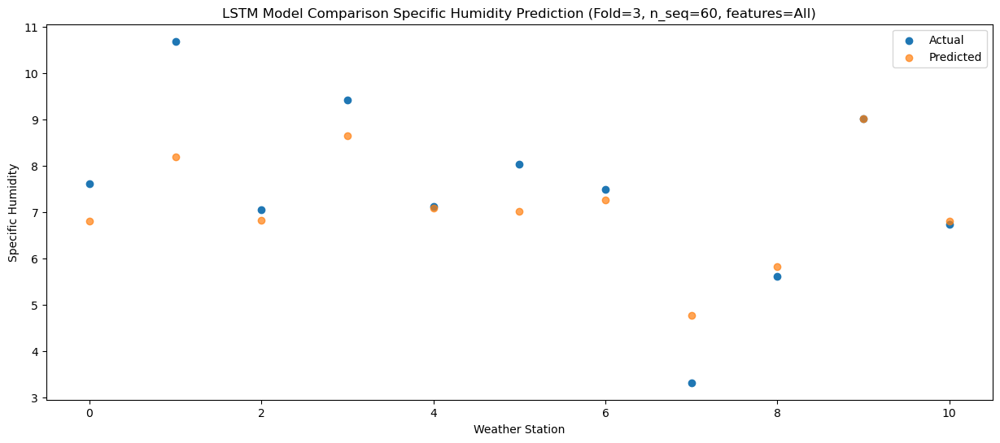

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   10.30   8.955105
1                 1   13.43  10.355105
2                 2    7.28   8.975105
3                 3   12.52  10.805105
4                 4   11.07   9.235105
5                 5   11.19   9.175105
6                 6    9.02   9.425105
7                 7    3.80   6.935105
8                 8    6.08   7.975105
9                 9   13.00  11.175105
10               10   10.09   8.955105


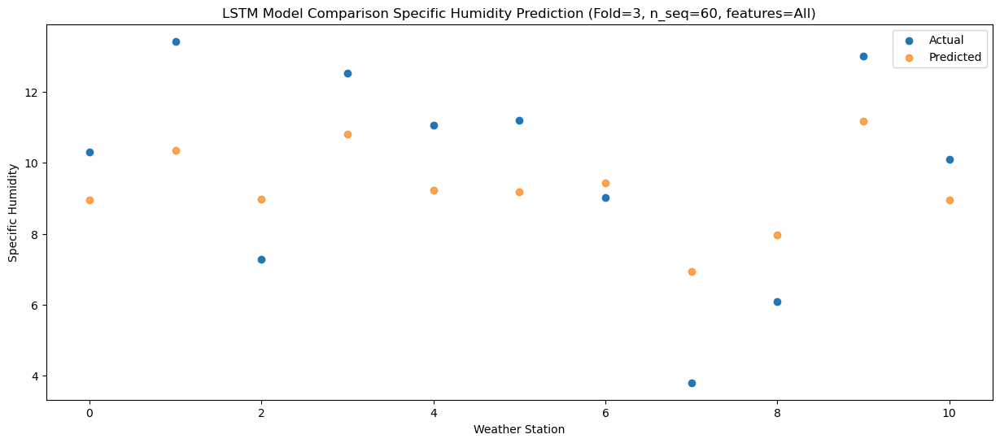

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.59   8.648976
1                 1   10.76  10.048976
2                 2    8.80   8.668976
3                 3   11.44  10.498976
4                 4    8.69   8.928976
5                 5    9.97   8.868976
6                 6    7.81   9.118976
7                 7    4.67   6.628976
8                 8    6.88   7.668976
9                 9   11.93  10.868976
10               10    9.45   8.648976


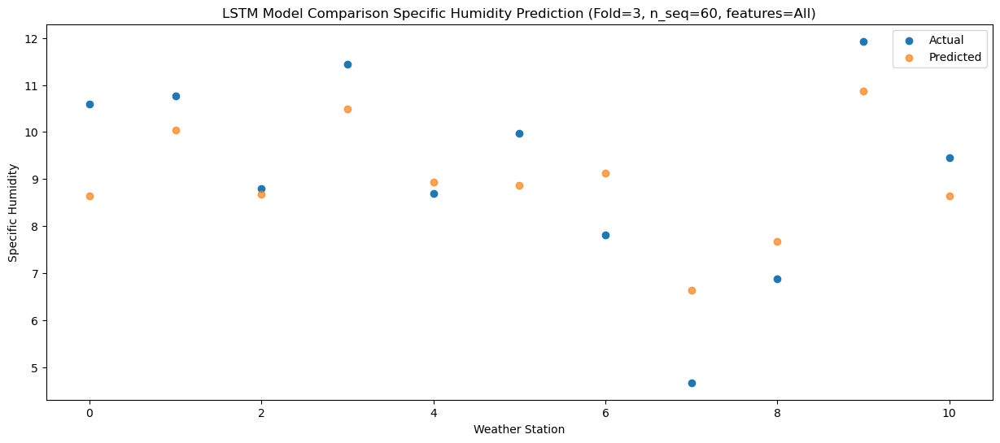

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    6.85   6.571621
1                 1    9.32   7.971621
2                 2    8.32   6.591621
3                 3    8.87   8.421621
4                 4    5.73   6.851621
5                 5    6.79   6.791621
6                 6    6.67   7.041621
7                 7    3.41   4.551621
8                 8    6.49   5.591621
9                 9    8.56   8.791621
10               10    6.16   6.571621


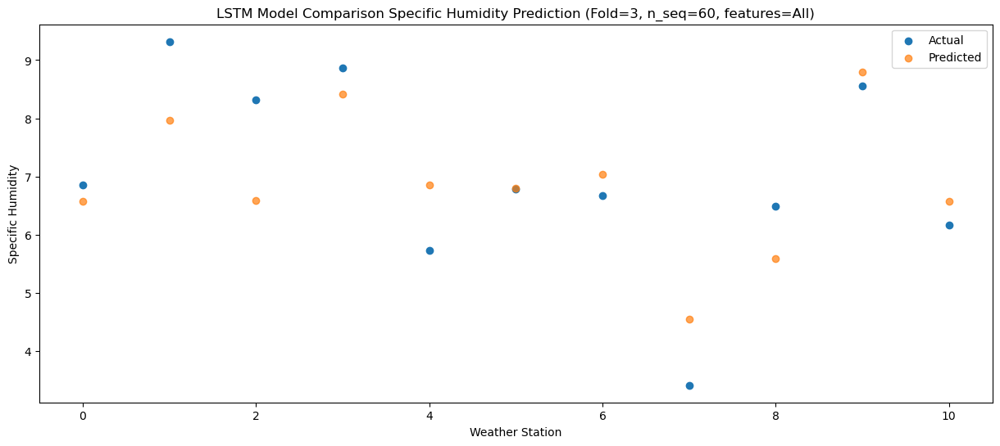

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.27   3.853144
1                 1    4.75   5.253144
2                 2    6.44   3.873144
3                 3    5.18   5.703144
4                 4    1.01   4.133144
5                 5    3.37   4.073144
6                 6    5.02   4.323144
7                 7    2.40   1.833144
8                 8    4.29   2.873144
9                 9    6.03   6.073144
10               10    3.39   3.853144


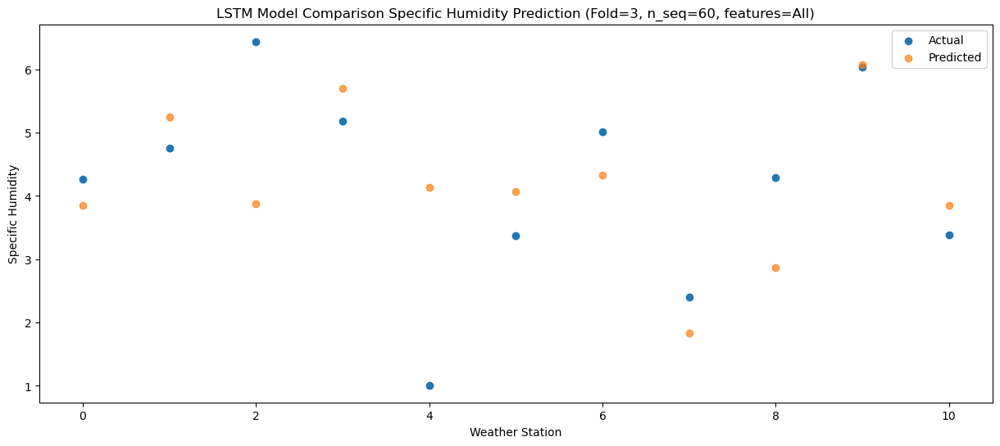

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.53   1.545556
1                 1    3.25   2.945556
2                 2    3.75   1.565556
3                 3    2.29   3.395556
4                 4   -0.09   1.825556
5                 5    1.60   1.765556
6                 6    4.96   2.015556
7                 7    2.38  -0.474444
8                 8    3.13   0.565556
9                 9    3.87   3.765556
10               10    1.06   1.545556


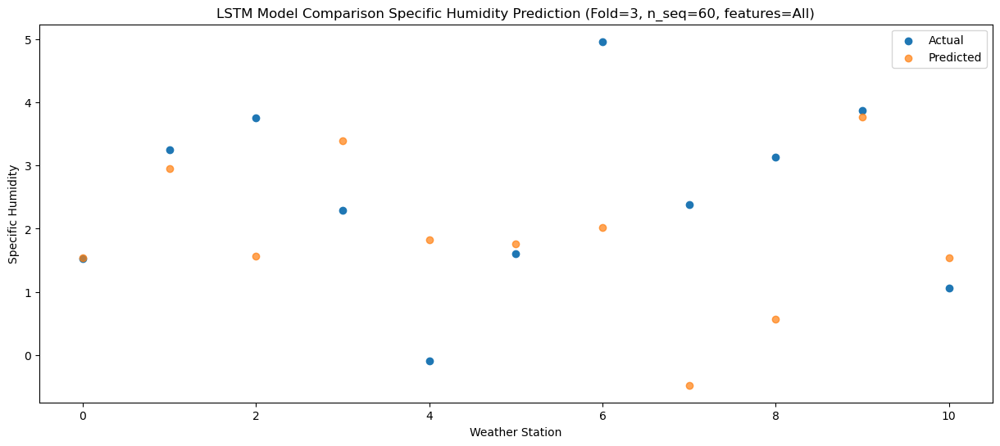

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -0.645833
1                 1    1.21   0.754167
2                 2    3.15  -0.625833
3                 3    0.68   1.204167
4                 4   -2.02  -0.365833
5                 5   -0.06  -0.425833
6                 6    4.15  -0.175833
7                 7    1.55  -2.665833
8                 8    2.79  -1.625833
9                 9    1.91   1.574167
10               10   -0.79  -0.645833


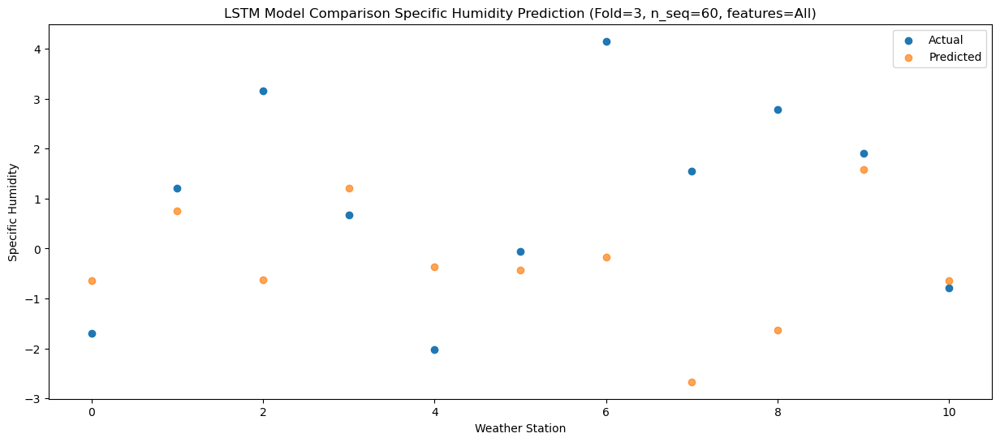

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -1.82  -0.420296
1                 1    1.12   0.979704
2                 2    3.59  -0.400296
3                 3    0.41   1.429704
4                 4   -2.22  -0.140296
5                 5   -0.37  -0.200296
6                 6    4.32   0.049704
7                 7    2.36  -2.440296
8                 8    3.46  -1.400296
9                 9    0.82   1.799704
10               10   -1.48  -0.420296


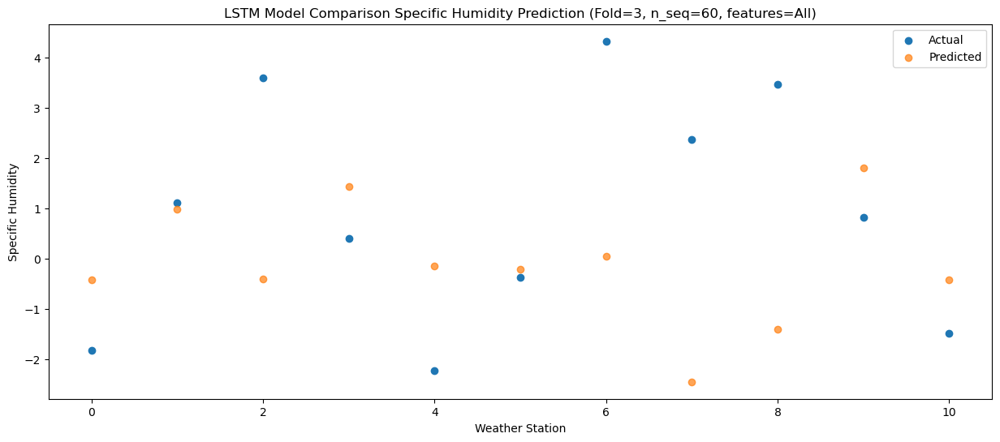

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.73  -0.448585
1                 1    0.56   0.951415
2                 2    3.53  -0.428585
3                 3    0.34   1.401415
4                 4   -3.05  -0.168585
5                 5   -0.89  -0.228585
6                 6    4.38   0.021415
7                 7    1.88  -2.468585
8                 8    3.11  -1.428585
9                 9    0.97   1.771415
10               10   -1.62  -0.448585


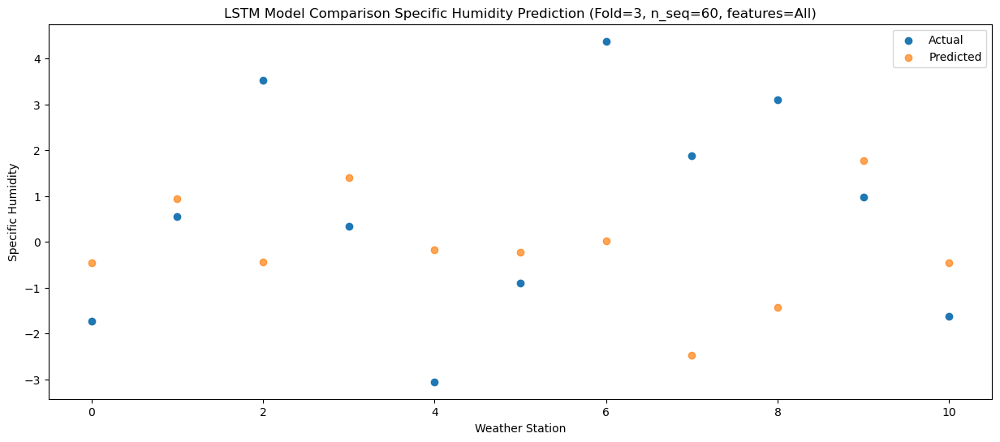

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -0.08   0.718426
1                 1    3.07   2.118426
2                 2    3.61   0.738426
3                 3    1.64   2.568426
4                 4   -0.57   0.998426
5                 5    1.14   0.938426
6                 6    4.69   1.188426
7                 7    2.18  -1.301574
8                 8    2.76  -0.261574
9                 9    1.75   2.938426
10               10   -0.34   0.718426


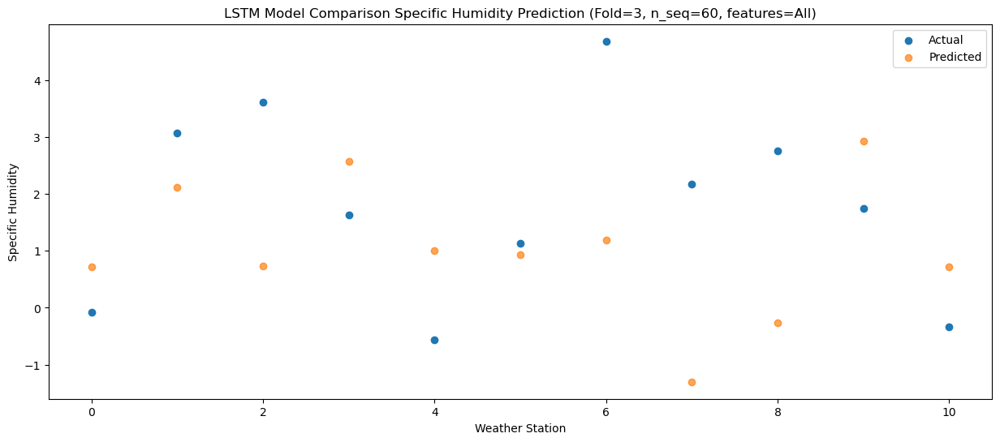

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.44   1.268987
1                 1    4.24   2.668987
2                 2    4.23   1.288987
3                 3    2.83   3.118987
4                 4    0.49   1.548987
5                 5    2.44   1.488987
6                 6    5.16   1.738987
7                 7    1.87  -0.751013
8                 8    3.69   0.288987
9                 9    3.13   3.488987
10               10    1.07   1.268987


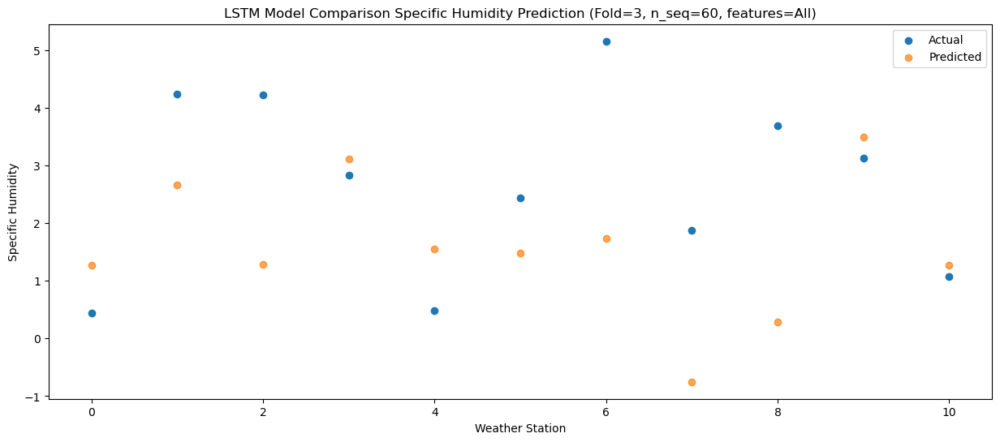

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    3.22   3.828215
1                 1    7.76   5.228215
2                 2    4.63   3.848215
3                 3    5.36   5.678215
4                 4    2.91   4.108215
5                 5    4.68   4.048215
6                 6    6.56   4.298215
7                 7    2.43   1.808215
8                 8    4.13   2.848215
9                 9    4.70   6.048215
10               10    2.66   3.828215


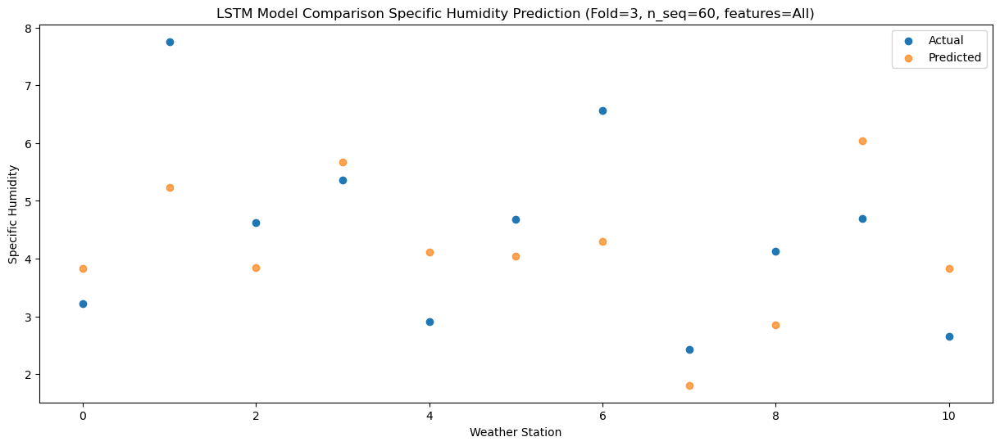

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.94   7.432258
1                 1   12.29   8.832258
2                 2    7.08   7.452258
3                 3   10.78   9.282258
4                 4    7.37   7.712258
5                 5    9.90   7.652258
6                 6    7.89   7.902258
7                 7    3.85   5.412258
8                 8    5.56   6.452258
9                 9    9.60   9.652258
10               10    7.53   7.432258


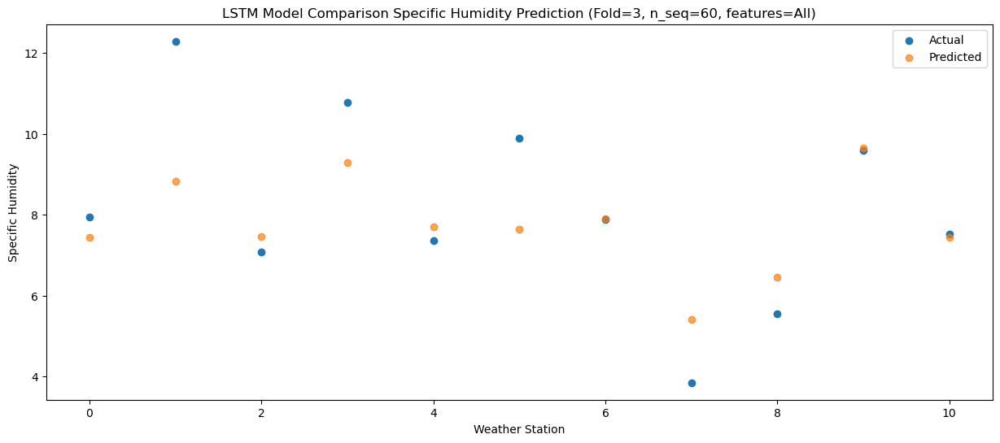

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.18   8.340294
1                 1   13.17   9.740294
2                 2    7.78   8.360294
3                 3   11.41  10.190294
4                 4    9.32   8.620294
5                 5   11.15   8.560294
6                 6   10.34   8.810294
7                 7    9.21   6.320294
8                 8    6.04   7.360294
9                 9   11.81  10.560294
10               10    9.22   8.340294


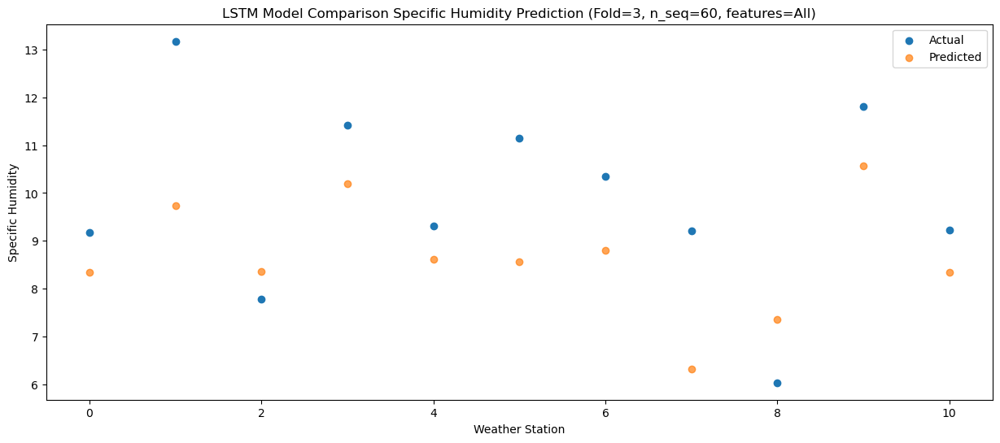

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.45    8.54692
1                 1   13.34    9.94692
2                 2    7.31    8.56692
3                 3   12.29   10.39692
4                 4    9.41    8.82692
5                 5   11.32    8.76692
6                 6    8.91    9.01692
7                 7    6.78    6.52692
8                 8    6.43    7.56692
9                 9   12.19   10.76692
10               10    9.54    8.54692


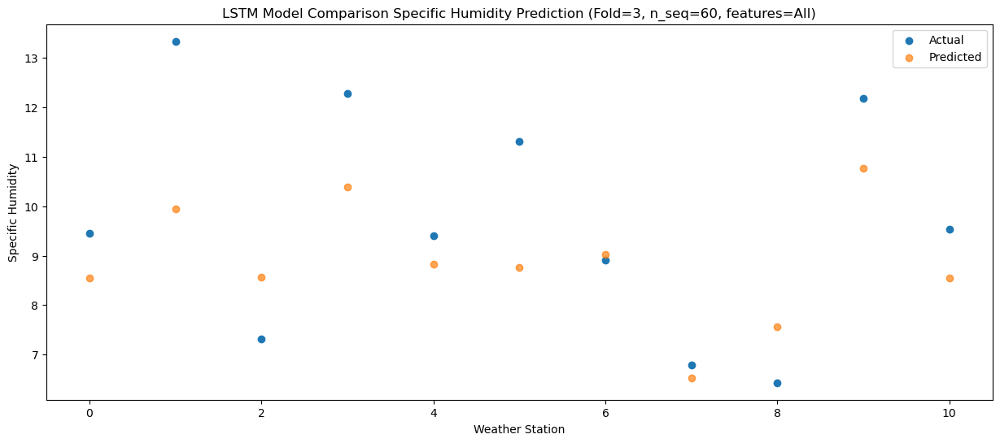

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    5.83   5.812223
1                 1    9.37   7.212223
2                 2    6.02   5.832223
3                 3    8.82   7.662223
4                 4    5.64   6.092223
5                 5    8.02   6.032223
6                 6    7.21   6.282223
7                 7    5.06   3.792223
8                 8    5.79   4.832223
9                 9    9.59   8.032223
10               10    6.62   5.812223


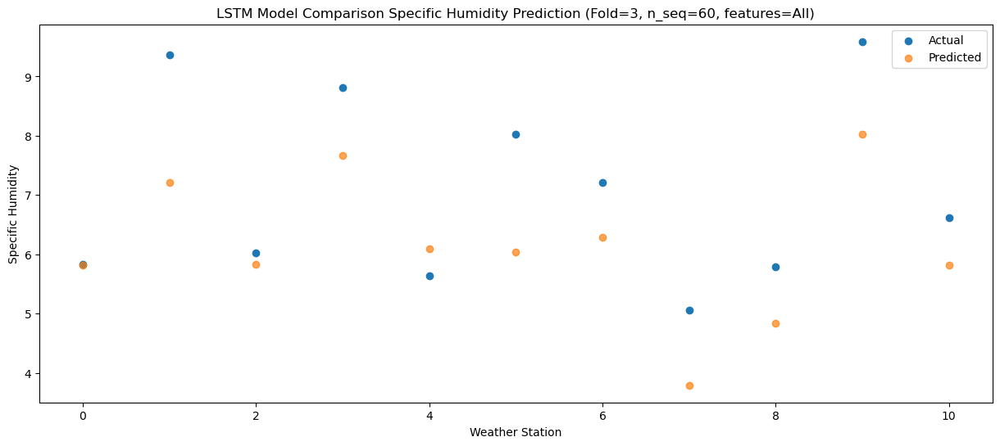

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    3.79   3.635036
1                 1    7.18   5.035036
2                 2    4.88   3.655036
3                 3    6.76   5.485036
4                 4    3.69   3.915036
5                 5    6.40   3.855036
6                 6    6.12   4.105036
7                 7    3.96   1.615036
8                 8    4.76   2.655036
9                 9    7.05   5.855036
10               10    4.72   3.635036


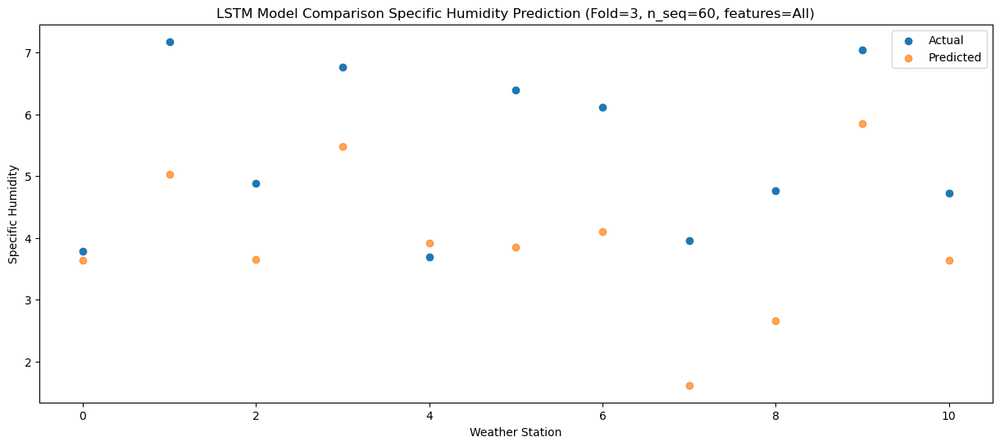

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.71  -0.276329
1                 1    2.75   1.123671
2                 2    5.46  -0.256329
3                 3    1.07   1.573671
4                 4   -1.43   0.003671
5                 5    0.53  -0.056329
6                 6    5.41   0.193671
7                 7    2.69  -2.296329
8                 8    4.98  -1.256329
9                 9    2.52   1.943671
10               10   -0.20  -0.276329


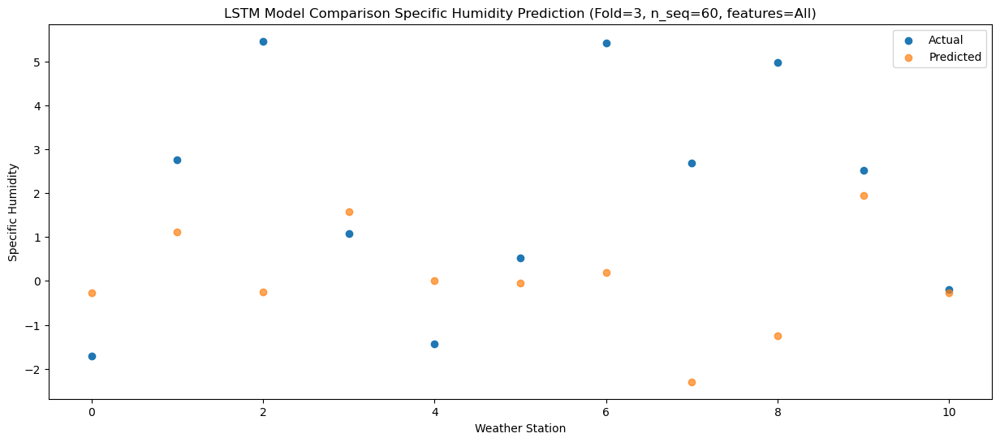

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.24   0.273752
1                 1    3.72   1.673752
2                 2    3.96   0.293752
3                 3    2.21   2.123752
4                 4   -0.73   0.553752
5                 5    1.58   0.493752
6                 6    4.70   0.743752
7                 7    2.83  -1.746248
8                 8    3.73  -0.706248
9                 9    2.22   2.493752
10               10   -0.30   0.273752


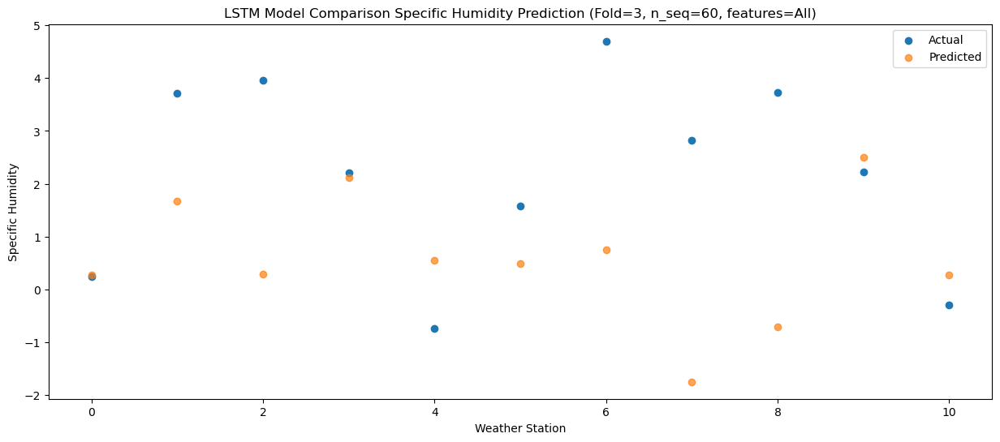

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -2.55  -1.526251
1                 1    0.53  -0.126251
2                 2    3.68  -1.506251
3                 3   -0.11   0.323749
4                 4   -3.19  -1.246251
5                 5   -0.93  -1.306251
6                 6    4.22  -1.056251
7                 7    1.84  -3.546251
8                 8    3.40  -2.506251
9                 9    0.74   0.693749
10               10   -1.81  -1.526251


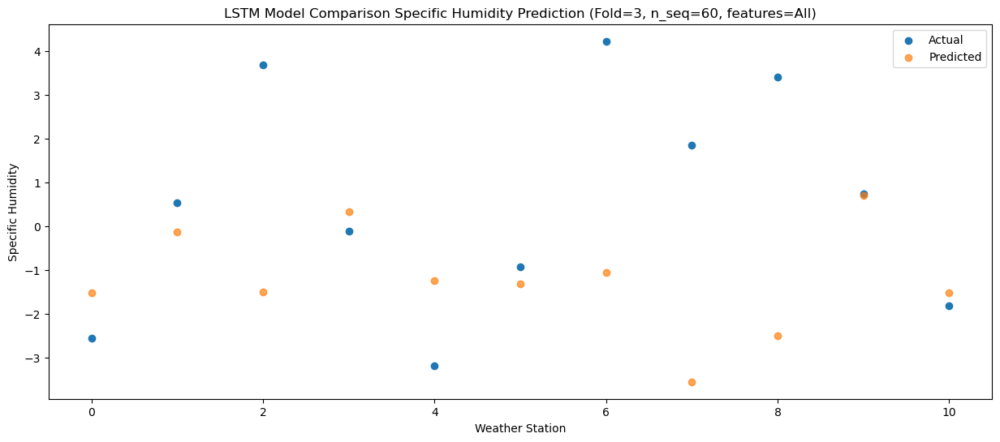

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.19   -0.57558
1                 1    0.90    0.82442
2                 2    2.90   -0.55558
3                 3    0.41    1.27442
4                 4   -2.57   -0.29558
5                 5   -0.40   -0.35558
6                 6    4.01   -0.10558
7                 7    1.41   -2.59558
8                 8    2.56   -1.55558
9                 9    1.33    1.64442
10               10   -1.11   -0.57558


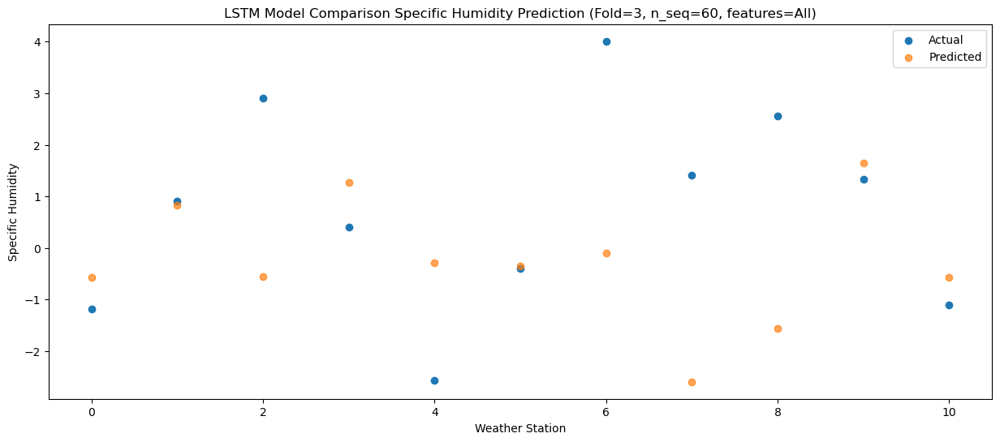

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -0.29   0.115435
1                 1    2.37   1.515435
2                 2    4.24   0.135435
3                 3    1.39   1.965435
4                 4   -1.00   0.395435
5                 5    0.91   0.335435
6                 6    4.69   0.585435
7                 7    2.03  -1.904565
8                 8    3.56  -0.864565
9                 9    2.17   2.335435
10               10   -0.17   0.115435


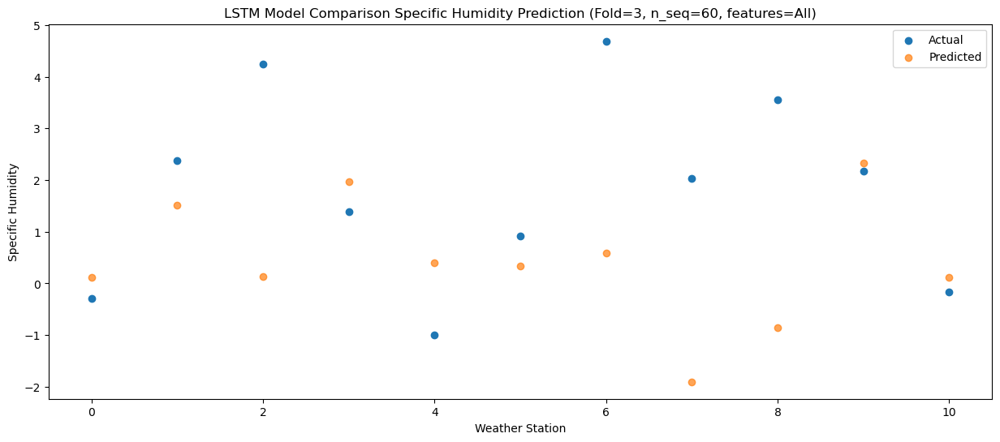

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    0.74   1.018985
1                 1    4.67   2.418985
2                 2    3.91   1.038985
3                 3    2.66   2.868985
4                 4    0.56   1.298985
5                 5    2.44   1.238985
6                 6    5.19   1.488985
7                 7    2.03  -1.001015
8                 8    3.66   0.038985
9                 9    2.82   3.238985
10               10    0.47   1.018985


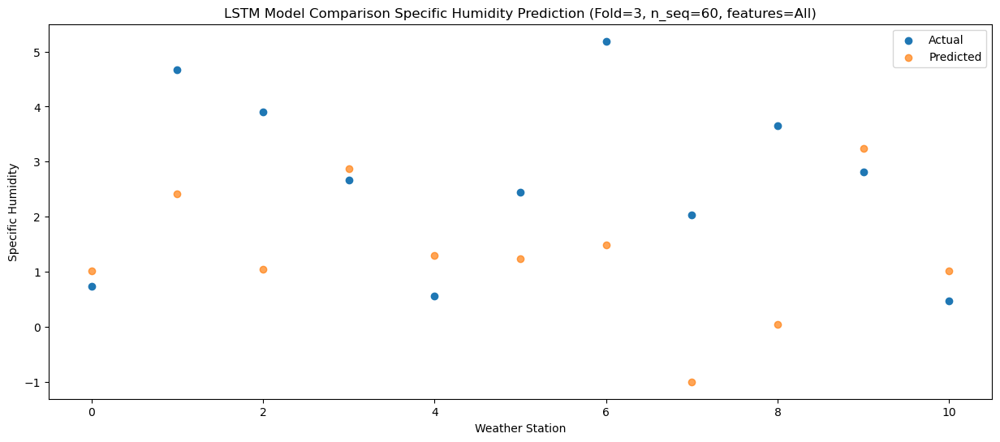

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    5.05   4.427739
1                 1    9.12   5.827739
2                 2    4.09   4.447739
3                 3    7.08   6.277739
4                 4    4.65   4.707739
5                 5    6.67   4.647739
6                 6    6.00   4.897739
7                 7    2.29   2.407739
8                 8    4.03   3.447739
9                 9    6.21   6.647739
10               10    4.65   4.427739


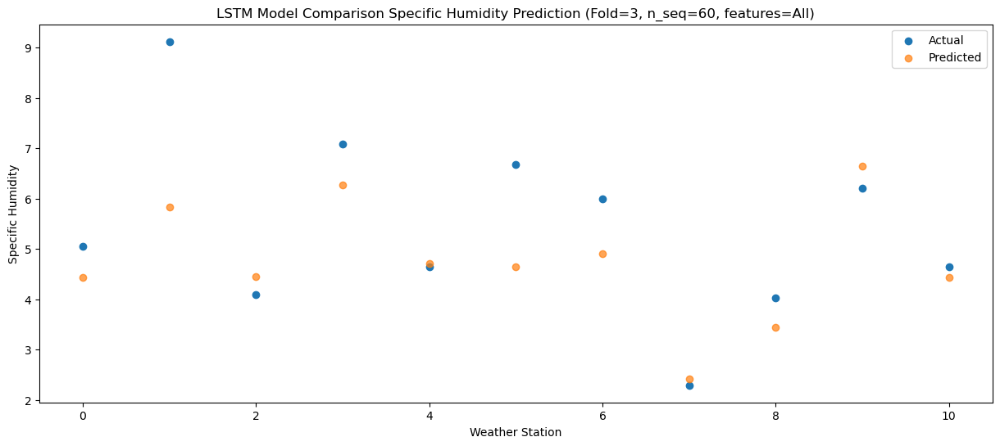

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    6.35   6.399241
1                 1   11.74   7.799241
2                 2    5.26   6.419241
3                 3    9.34   8.249241
4                 4    6.75   6.679241
5                 5    8.74   6.619241
6                 6    7.94   6.869241
7                 7    4.05   4.379241
8                 8    5.52   5.419241
9                 9    8.55   8.619241
10               10    6.05   6.399241


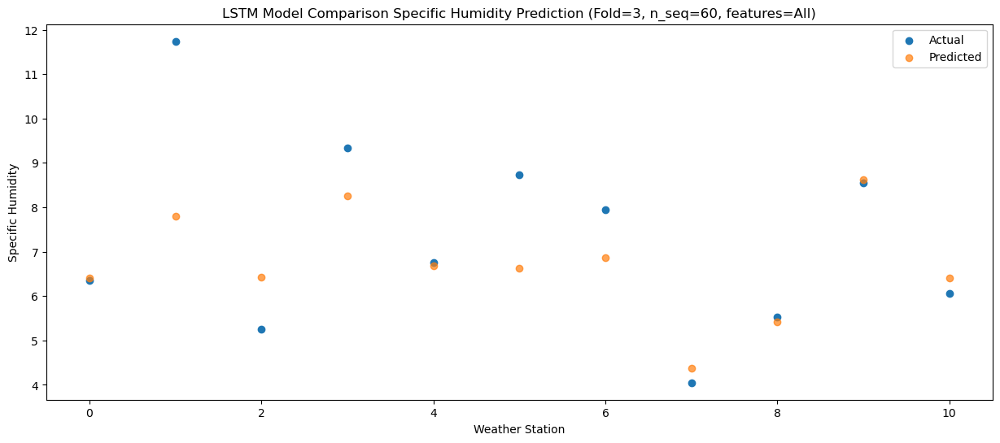

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   10.42   9.227879
1                 1   11.95  10.627879
2                 2    6.43   9.247879
3                 3   12.38  11.077879
4                 4    9.34   9.507879
5                 5   11.52   9.447879
6                 6   10.93   9.697879
7                 7    7.48   7.207879
8                 8    6.35   8.247879
9                 9   11.71  11.447879
10               10    9.03   9.227879


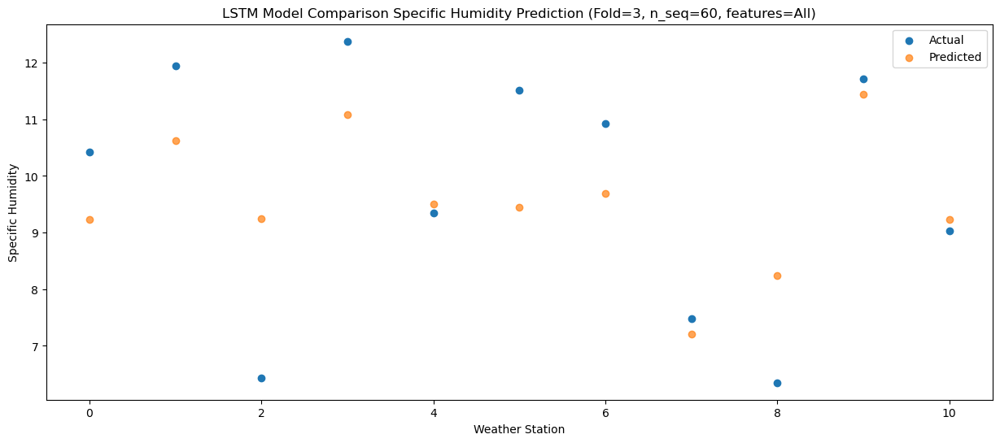

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    8.61   8.688189
1                 1   12.56  10.088189
2                 2    7.22   8.708189
3                 3   11.25  10.538189
4                 4    8.84   8.968189
5                 5   10.32   8.908189
6                 6   10.77   9.158189
7                 7   10.55   6.668189
8                 8    6.81   7.708189
9                 9   11.85  10.908189
10               10    8.66   8.688189


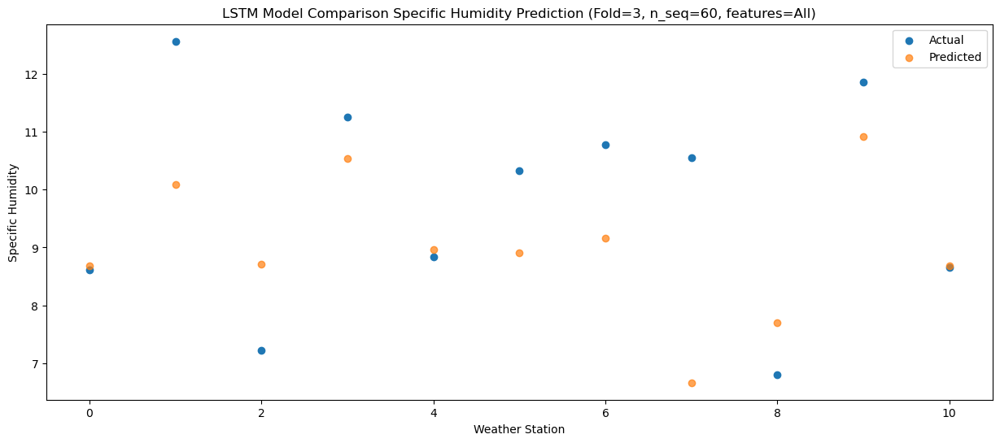

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    5.19   5.956564
1                 1    8.71   7.356564
2                 2    6.93   5.976564
3                 3    8.00   7.806564
4                 4    5.74   6.236564
5                 5    7.55   6.176564
6                 6    7.82   6.426564
7                 7    6.64   3.936564
8                 8    6.21   4.976564
9                 9    8.18   8.176564
10               10    5.64   5.956564


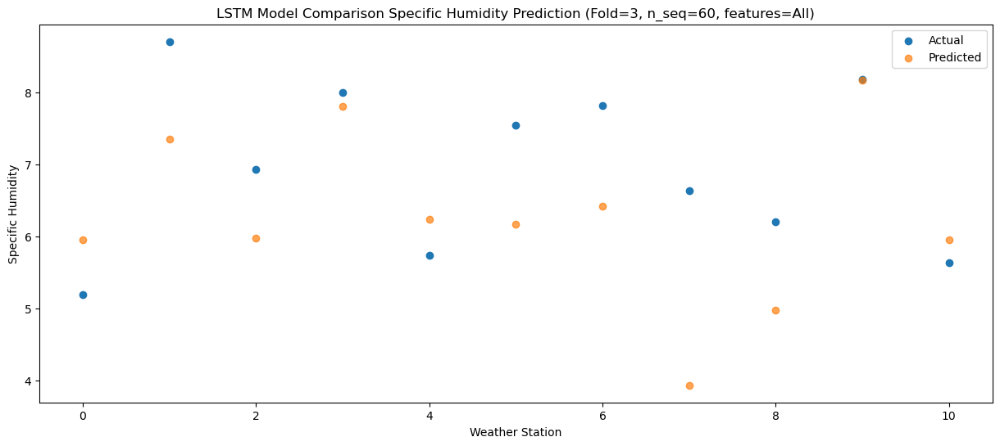

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    0.96   2.240826
1                 1    4.25   3.640826
2                 2    5.76   2.260826
3                 3    2.85   4.090826
4                 4    0.74   2.520826
5                 5    2.25   2.460826
6                 6    6.21   2.710826
7                 7    3.91   0.220826
8                 8    4.90   1.260826
9                 9    5.55   4.460826
10               10    2.22   2.240826


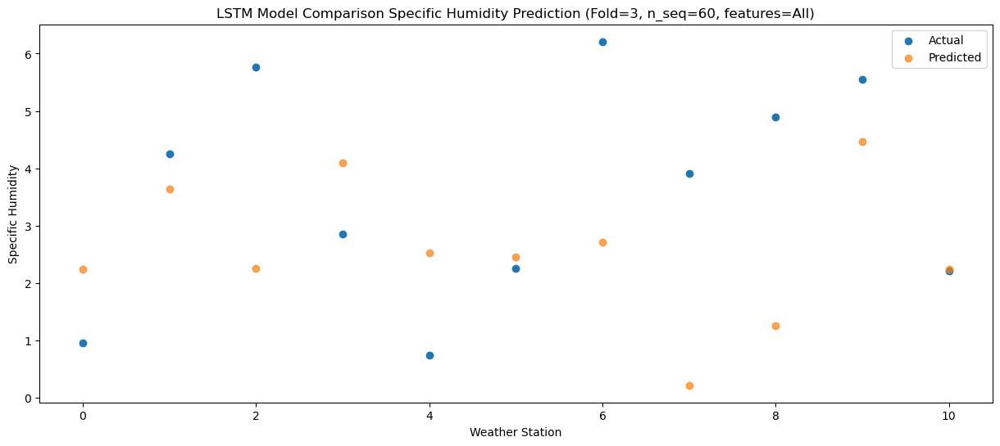

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    0.51   0.884549
1                 1    3.22   2.284549
2                 2    3.04   0.904549
3                 3    2.04   2.734549
4                 4   -0.65   1.164549
5                 5    1.03   1.104549
6                 6    4.55   1.354549
7                 7    2.14  -1.135451
8                 8    2.65  -0.095451
9                 9    3.70   3.104549
10               10    1.00   0.884549


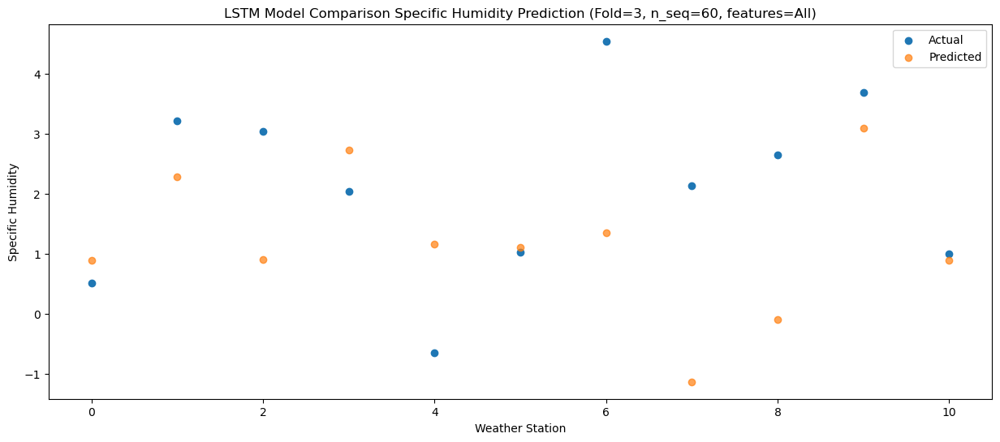

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -0.225023
1                 1    2.03   1.174977
2                 2    3.88  -0.205023
3                 3    1.01   1.624977
4                 4   -1.77   0.054977
5                 5    0.27  -0.005023
6                 6    4.58   0.244977
7                 7    2.89  -2.245023
8                 8    3.44  -1.205023
9                 9    1.73   1.994977
10               10   -0.92  -0.225023


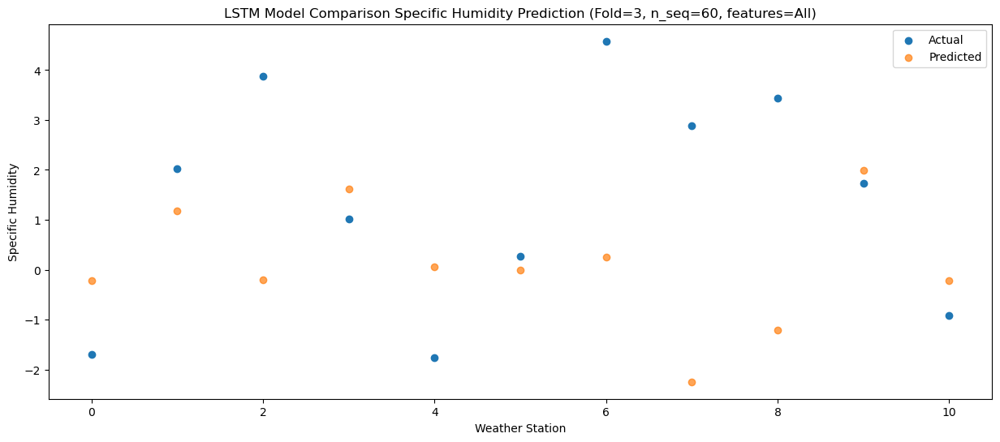

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.78  -0.324614
1                 1    1.95   1.075386
2                 2    4.03  -0.304614
3                 3    1.55   1.525386
4                 4   -1.39  -0.044614
5                 5    0.85  -0.104614
6                 6    4.55   0.145386
7                 7    3.28  -2.344614
8                 8    3.27  -1.304614
9                 9    2.30   1.895386
10               10   -0.14  -0.324614


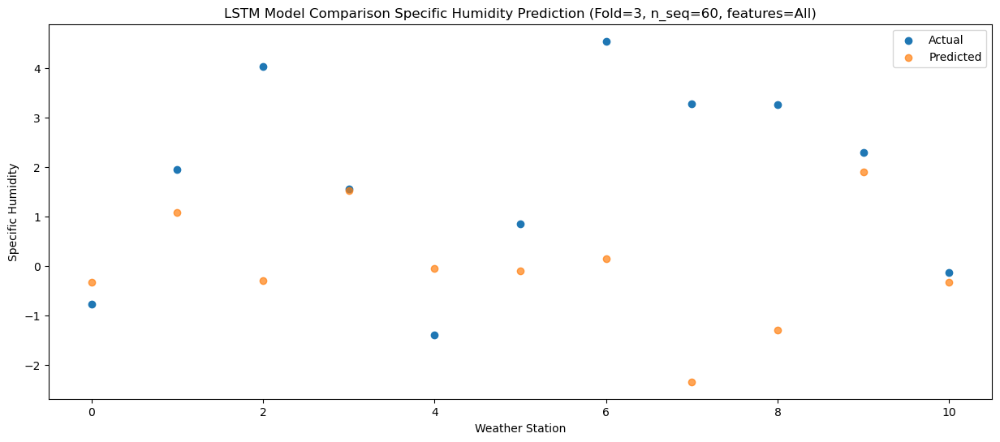

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -0.05   0.083315
1                 1    2.11   1.483315
2                 2    2.90   0.103315
3                 3    1.37   1.933315
4                 4   -0.51   0.363315
5                 5    0.52   0.303315
6                 6    4.17   0.553315
7                 7    2.03  -1.936685
8                 8    2.41  -0.896685
9                 9    1.59   2.303315
10               10   -0.89   0.083315


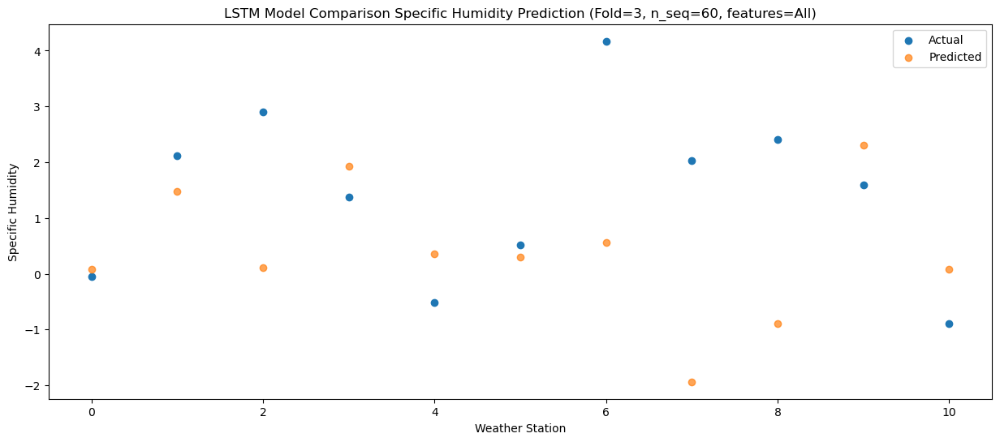

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -0.44   0.282722
1                 1    3.05   1.682722
2                 2    4.42   0.302722
3                 3    1.24   2.132722
4                 4   -0.84   0.562722
5                 5    0.95   0.502722
6                 6    4.47   0.752722
7                 7    3.07  -1.737278
8                 8    3.21  -0.697278
9                 9    1.80   2.502722
10               10   -0.76   0.282722


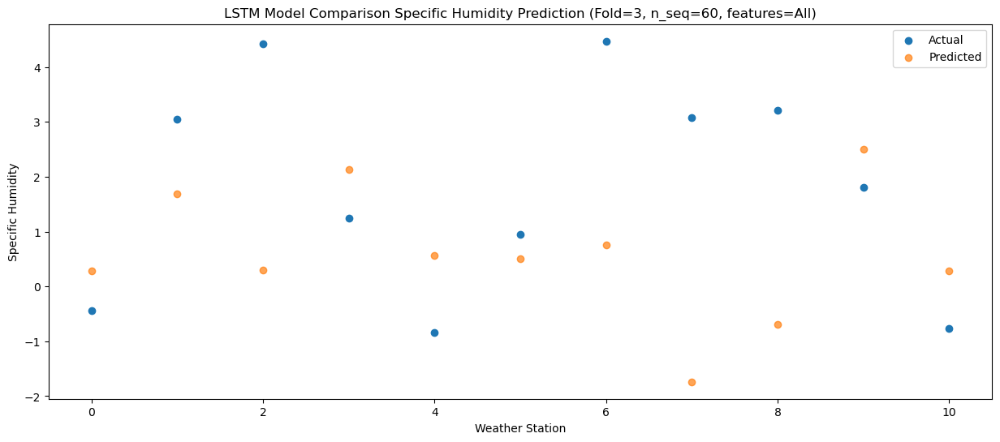

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    1.55   1.553025
1                 1    3.92   2.953025
2                 2    4.62   1.573025
3                 3    2.78   3.403025
4                 4    0.39   1.833025
5                 5    2.26   1.773025
6                 6    5.10   2.023025
7                 7    2.22  -0.466975
8                 8    3.59   0.573025
9                 9    4.04   3.773025
10               10    1.67   1.553025


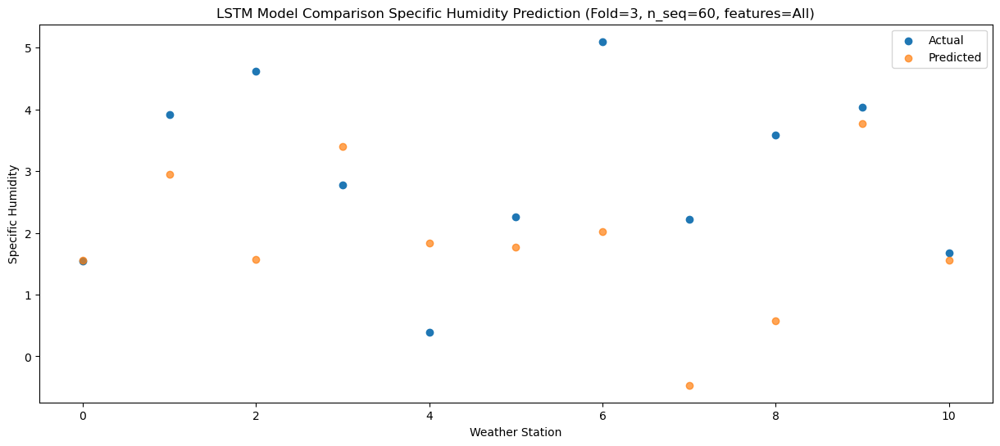

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    3.00   4.216805
1                 1    8.33   5.616805
2                 2    5.56   4.236805
3                 3    5.69   6.066805
4                 4    3.57   4.496805
5                 5    4.86   4.436805
6                 6    7.26   4.686805
7                 7    3.76   2.196805
8                 8    5.18   3.236805
9                 9    4.56   6.436805
10               10    2.14   4.216805


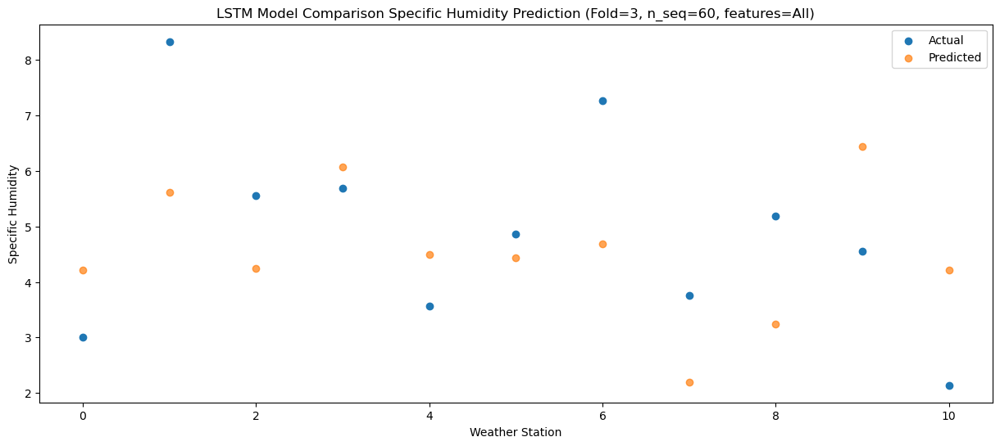

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.27   6.256581
1                 1   10.97   7.656581
2                 2    6.33   6.276581
3                 3    7.71   8.106581
4                 4    5.70   6.536581
5                 5    7.02   6.476581
6                 6    7.49   6.726581
7                 7    4.26   4.236581
8                 8    5.24   5.276581
9                 9    8.26   8.476581
10               10    5.83   6.256581


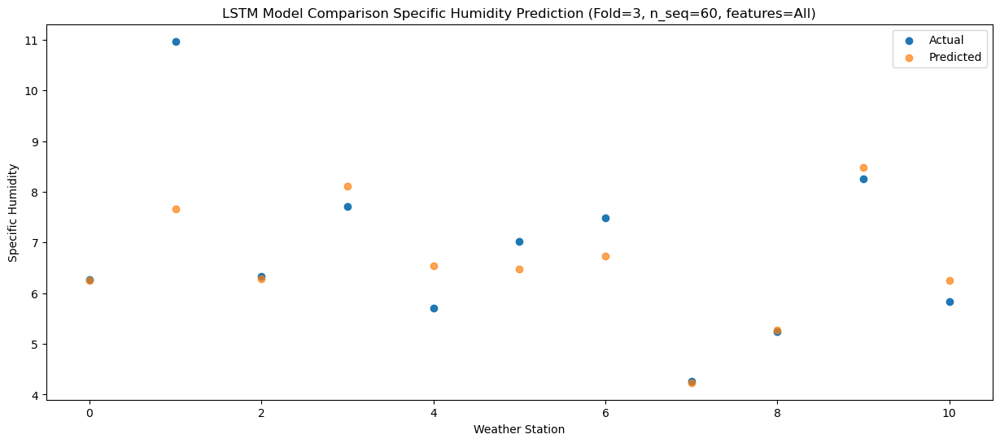

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   10.22   8.905191
1                 1   13.24  10.305191
2                 2    7.43   8.925191
3                 3   11.36  10.755191
4                 4    9.47   9.185191
5                 5   11.53   9.125191
6                 6    8.33   9.375191
7                 7    5.23   6.885191
8                 8    6.08   7.925191
9                 9   13.11  11.125191
10               10    9.81   8.905191


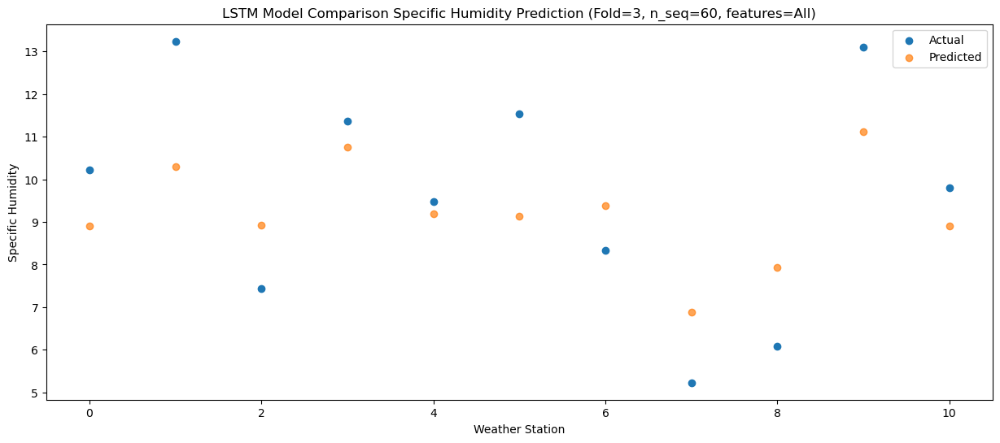

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.32   8.362083
1                 1   13.48   9.762083
2                 2    8.50   8.382083
3                 3   10.81  10.212083
4                 4    9.86   8.642083
5                 5   10.65   8.582083
6                 6    9.98   8.832083
7                 7    7.81   6.342083
8                 8    7.35   7.382083
9                 9   10.54  10.582083
10               10    8.57   8.362083


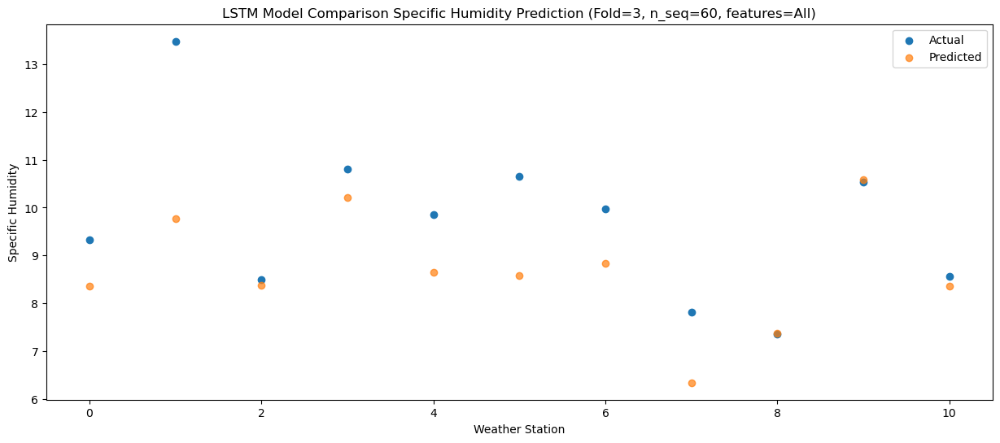

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    6.41   6.325572
1                 1    9.41   7.725572
2                 2    6.96   6.345572
3                 3    8.34   8.175572
4                 4    5.75   6.605572
5                 5    7.42   6.545572
6                 6    7.36   6.795572
7                 7    6.87   4.305572
8                 8    6.80   5.345572
9                 9    9.57   8.545572
10               10    6.88   6.325572


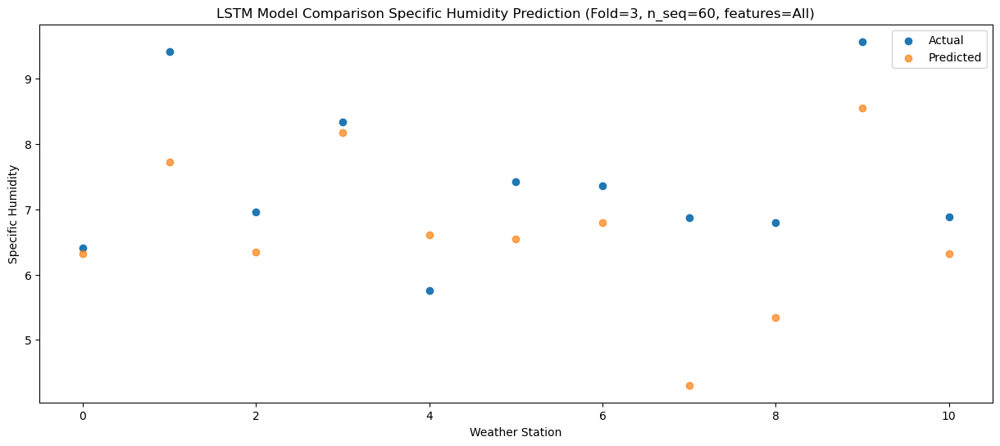

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    2.30   2.920132
1                 1    5.97   4.320132
2                 2    5.80   2.940132
3                 3    4.81   4.770132
4                 4    2.13   3.200132
5                 5    4.04   3.140132
6                 6    6.11   3.390132
7                 7    3.81   0.900132
8                 8    5.37   1.940132
9                 9    6.18   5.140132
10               10    3.61   2.920132


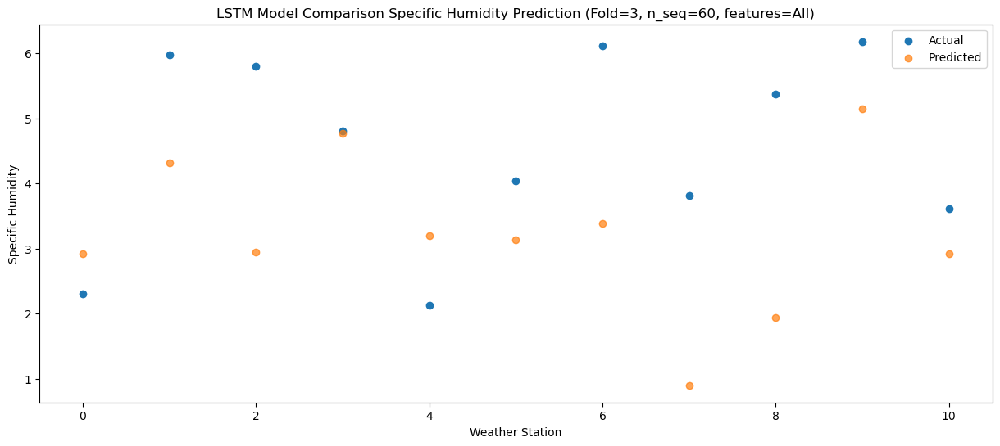

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.93    0.54146
1                 1    3.09    1.94146
2                 2    3.69    0.56146
3                 3    1.42    2.39146
4                 4   -1.04    0.82146
5                 5    0.85    0.76146
6                 6    4.78    1.01146
7                 7    2.80   -1.47854
8                 8    4.28   -0.43854
9                 9    2.38    2.76146
10               10   -0.07    0.54146


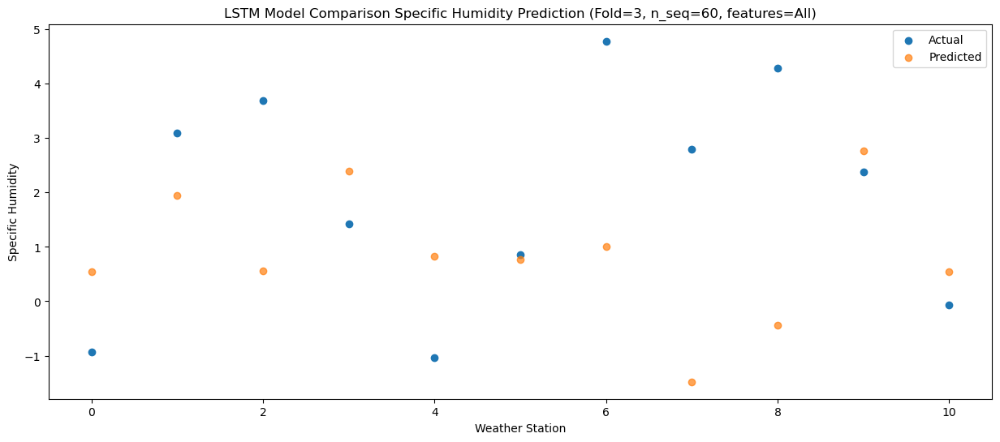

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.94   0.122799
1                 1    2.27   1.522799
2                 2    3.92   0.142799
3                 3    1.44   1.972799
4                 4   -1.45   0.402799
5                 5    0.81   0.342799
6                 6    4.65   0.592799
7                 7    2.72  -1.897201
8                 8    4.66  -0.857201
9                 9    2.71   2.342799
10               10    0.31   0.122799


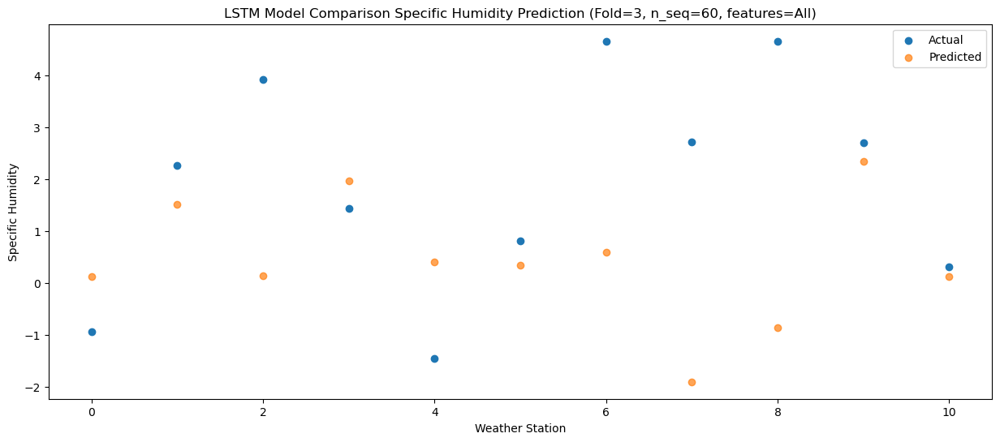

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -1.59  -0.404441
1                 1    0.96   0.995559
2                 2    4.46  -0.384441
3                 3    0.70   1.445559
4                 4   -2.32  -0.124441
5                 5   -0.07  -0.184441
6                 6    4.59   0.065559
7                 7    3.26  -2.424441
8                 8    4.67  -1.384441
9                 9    1.41   1.815559
10               10   -0.82  -0.404441


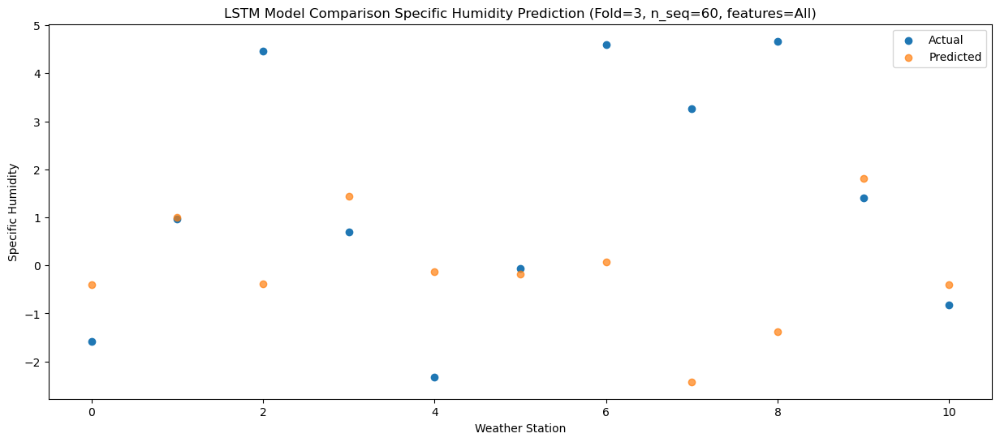

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -1.53   -0.31571
1                 1    2.38    1.08429
2                 2    4.63   -0.29571
3                 3    1.02    1.53429
4                 4   -1.41   -0.03571
5                 5    0.51   -0.09571
6                 6    4.66    0.15429
7                 7    4.08   -2.33571
8                 8    4.36   -1.29571
9                 9    1.31    1.90429
10               10   -0.91   -0.31571


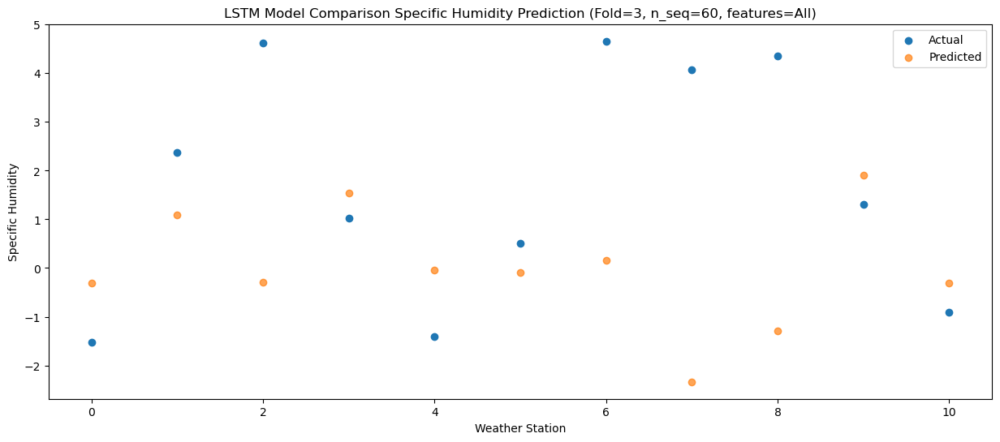

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -0.03   0.958346
1                 1    3.80   2.358346
2                 2    4.34   0.978346
3                 3    1.98   2.808346
4                 4   -0.37   1.238346
5                 5    1.59   1.178346
6                 6    5.02   1.428346
7                 7    3.40  -1.061654
8                 8    4.16  -0.021654
9                 9    2.36   3.178346
10               10    0.14   0.958346


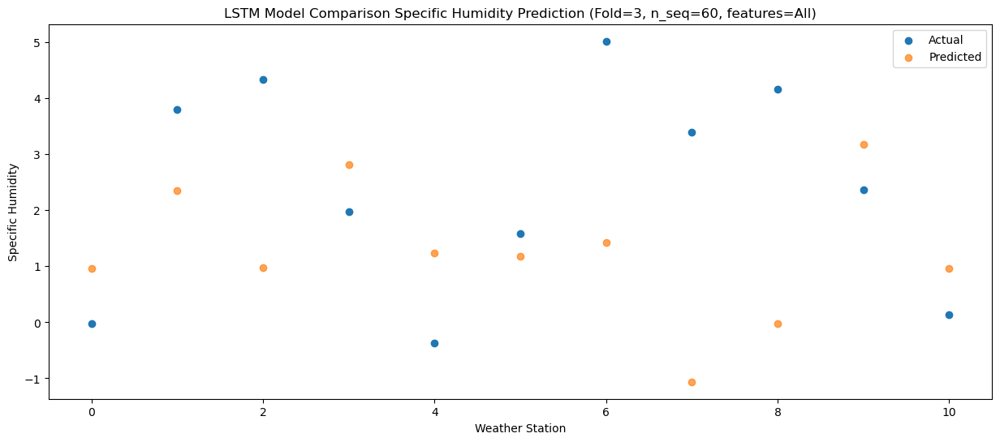

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    2.01   2.414497
1                 1    5.34   3.814497
2                 2    5.02   2.434497
3                 3    3.89   4.264497
4                 4    1.45   2.694497
5                 5    3.84   2.634497
6                 6    5.70   2.884497
7                 7    3.10   0.394497
8                 8    4.60   1.434497
9                 9    3.27   4.634497
10               10    1.74   2.414497


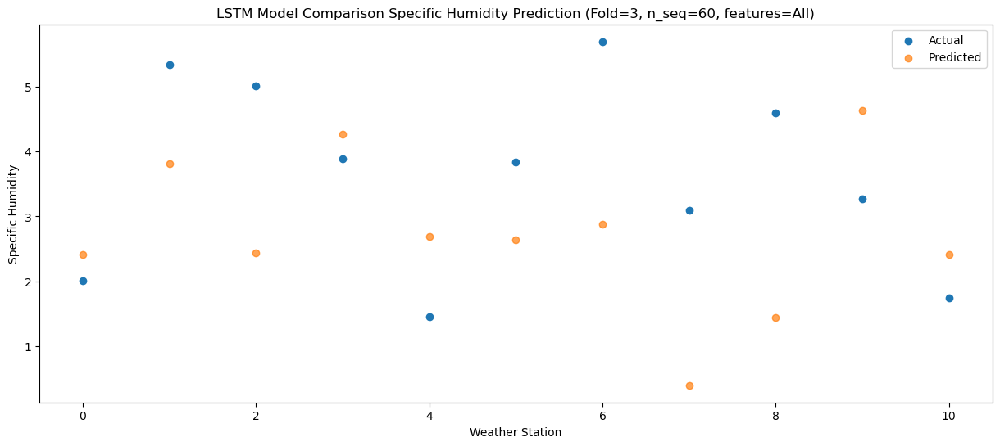

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.88    5.74823
1                 1    9.84    7.14823
2                 2    4.89    5.76823
3                 3    8.00    7.59823
4                 4    5.59    6.02823
5                 5    7.51    5.96823
6                 6    6.59    6.21823
7                 7    2.97    3.72823
8                 8    4.76    4.76823
9                 9    6.73    7.96823
10               10    5.37    5.74823


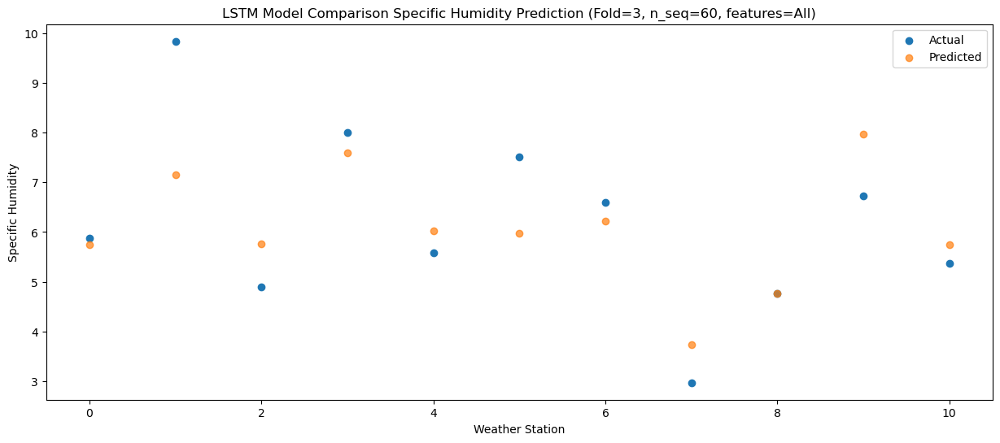

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    7.61   7.550223
1                 1   12.12   8.950223
2                 2    6.16   7.570223
3                 3    9.80   9.400223
4                 4    7.56   7.830223
5                 5    9.33   7.770223
6                 6    8.88   8.020223
7                 7    4.37   5.530223
8                 8    5.91   6.570223
9                 9    9.60   9.770223
10               10    7.05   7.550223


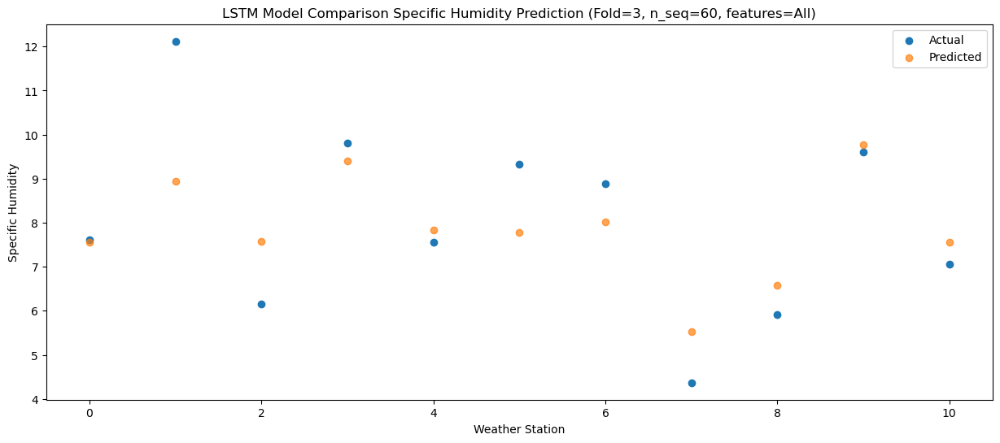

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   10.47   9.321049
1                 1   12.61  10.721049
2                 2    8.14   9.341049
3                 3   10.70  11.171049
4                 4    9.13   9.601049
5                 5   10.52   9.541049
6                 6    8.93   9.791049
7                 7    5.40   7.301049
8                 8    7.49   8.341049
9                 9   12.77  11.541049
10               10    9.93   9.321049


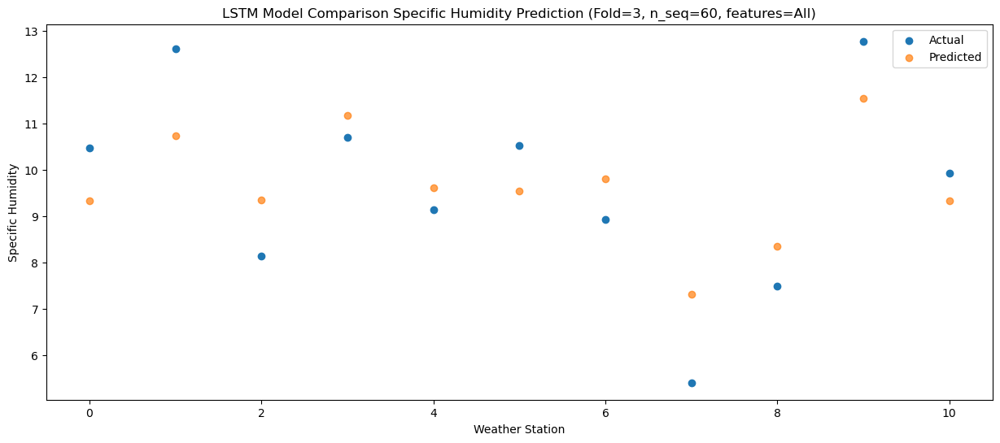

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.03   8.164539
1                 1   11.87   9.564539
2                 2    6.45   8.184539
3                 3    9.38  10.014539
4                 4    8.65   8.444539
5                 5    9.96   8.384539
6                 6   10.39   8.634539
7                 7    6.22   6.144539
8                 8    6.76   7.184539
9                 9   11.42  10.384539
10               10    8.65   8.164539


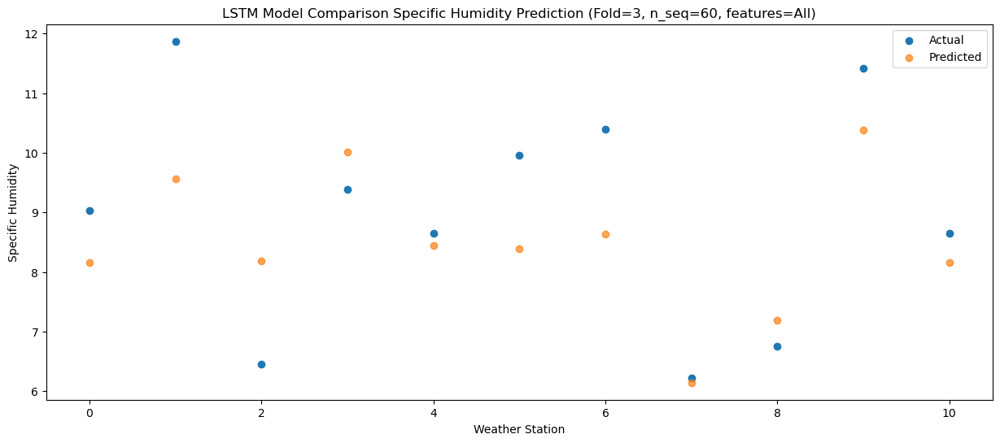

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.32   6.712428
1                 1    8.88   8.112428
2                 2    6.72   6.732428
3                 3    7.84   8.562428
4                 4    5.64   6.992428
5                 5    7.34   6.932428
6                 6    7.97   7.182428
7                 7    4.50   4.692428
8                 8    6.44   5.732428
9                 9    8.06   8.932428
10               10    5.83   6.712428


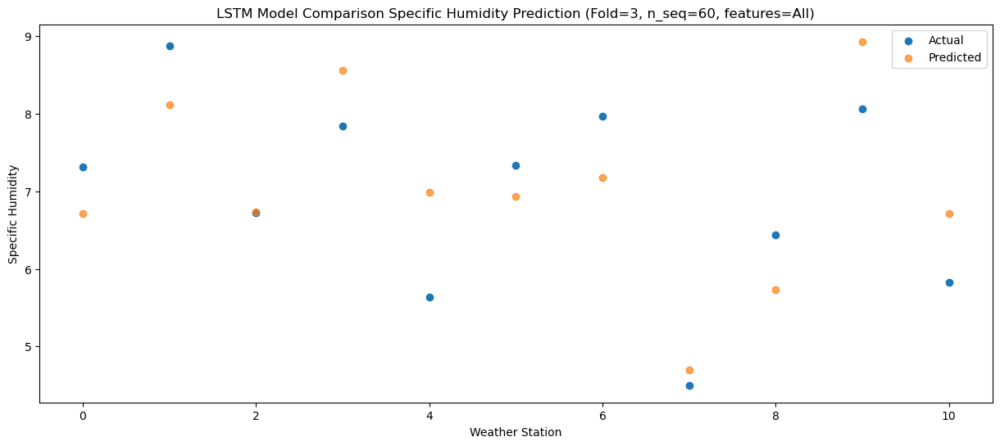

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.50   2.837167
1                 1    4.65   4.237167
2                 2    5.61   2.857167
3                 3    4.09   4.687167
4                 4    1.28   3.117167
5                 5    3.47   3.057167
6                 6    6.21   3.307167
7                 7    3.45   0.817167
8                 8    4.85   1.857167
9                 9    4.96   5.057167
10               10    1.83   2.837167


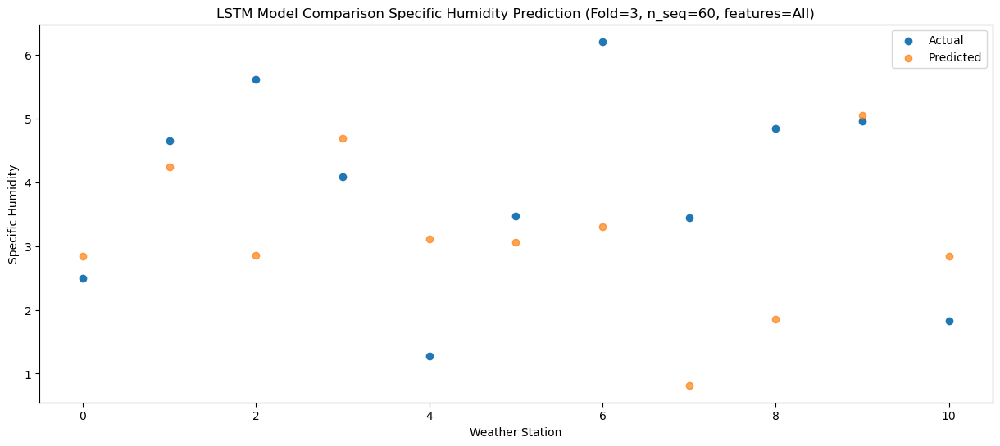

f, t:
[[-1.290e+00  2.240e+00  3.790e+00  1.020e+00  2.490e+00  4.400e-01
   4.780e+00  2.690e+00  3.330e+00  2.250e+00 -5.400e-01]
 [-1.080e+00  1.830e+00  4.330e+00  1.550e+00  9.900e-01  7.300e-01
   4.410e+00  3.680e+00  4.560e+00  1.890e+00 -6.600e-01]
 [-1.030e+00  1.800e+00  3.950e+00  1.150e+00 -1.300e+00  2.300e-01
   4.370e+00  2.560e+00  3.880e+00  1.610e+00 -7.400e-01]
 [-7.000e-01  1.440e+00  3.260e+00  9.700e-01 -2.060e+00 -2.000e-02
   4.330e+00  2.140e+00  2.990e+00  1.690e+00 -7.500e-01]
 [ 1.030e+00  4.040e+00  4.340e+00  2.830e+00  1.000e-02  1.970e+00
   4.960e+00  3.880e+00  3.470e+00  2.180e+00  2.100e-01]
 [ 8.500e-01  4.190e+00  5.710e+00  2.750e+00  3.300e-01  2.090e+00
   5.310e+00  3.690e+00  4.530e+00  2.680e+00  6.400e-01]
 [ 4.070e+00  7.160e+00  5.520e+00  6.180e+00  4.030e+00  5.300e+00
   6.440e+00  2.990e+00  5.390e+00  4.910e+00  3.170e+00]
 [ 7.610e+00  1.069e+01  7.060e+00  9.420e+00  7.120e+00  8.030e+00
   7.500e+00  3.320e+00  5.610e+00  9.020e+0

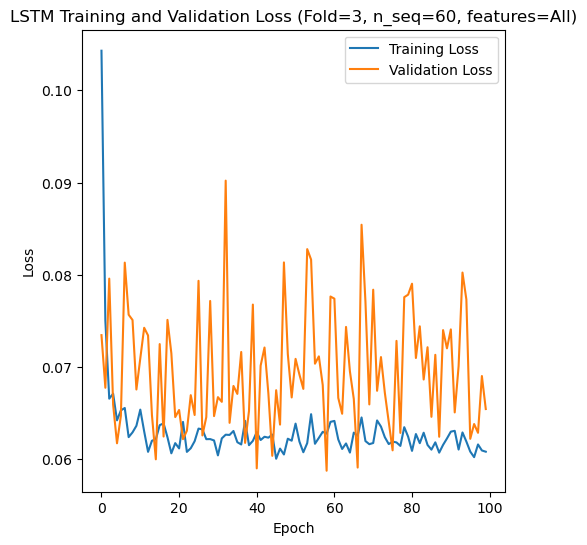

[[ 3.4   2.19  4.28 ... 10.54  6.41  5.39]
 [ 7.94  7.22  7.86 ... 18.27 13.85 11.85]
 [ 5.92  4.91  6.84 ... 14.38  9.59 10.48]
 ...
 [ 3.92  3.    4.93 ... 11.51  7.19  6.46]
 [ 3.98  2.61  4.   ... 10.23  6.65  5.8 ]
 [ 3.84  2.35  4.25 ... 10.6   6.5   5.9 ]]
Epoch 1/100
84/84 [==============================] - 34s 145ms/step - loss: 0.1002 - accuracy: 0.2976 - mae: 0.0793 - rmse: 0.1002 - mape: 17.5576 - pearson: 0.6576 - val_loss: 0.0731 - val_accuracy: 0.7000 - val_mae: 0.0581 - val_rmse: 0.0731 - val_mape: 12.8585 - val_pearson: 0.7464
Epoch 2/100
84/84 [==============================] - 8s 98ms/step - loss: 0.0734 - accuracy: 0.4405 - mae: 0.0572 - rmse: 0.0734 - mape: 13.0612 - pearson: 0.7358 - val_loss: 0.0694 - val_accuracy: 0.7000 - val_mae: 0.0558 - val_rmse: 0.0694 - val_mape: 12.1057 - val_pearson: 0.7581
Epoch 3/100
84/84 [==============================] - 8s 100ms/step - loss: 0.0677 - accuracy: 0.5357 - mae: 0.0540 - rmse: 0.0677 - mape: 12.1149 - pearson: 0.7684 - 

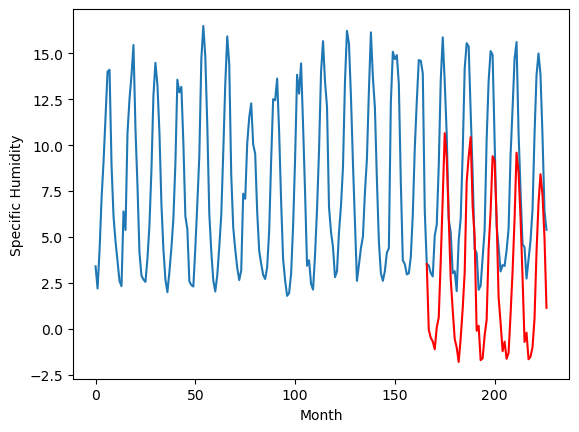

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.88		-0.49		1.39
-1.74		-0.93		0.81
-3.30		-1.13		2.17
-2.46		-1.56		0.90
-1.08		-0.37		0.71
0.13		0.18		0.05
0.78		3.28		2.50
4.11		6.68		2.57
5.85		10.22		4.37
6.09		8.85		2.76
5.51		5.60		0.09
3.47		2.27		-1.20
0.41		0.59		0.18
-4.33		-1.00		3.33
-3.98		-1.47		2.51
-1.99		-2.25		-0.26
-2.02		-0.95		1.07
-1.27		0.64		1.91
0.06		2.63		2.57
4.35		7.57		3.22
5.56		8.93		3.37
5.95		10.00		4.05
5.15		6.22		1.07
2.23		4.55		2.32
-2.43		-0.55		1.88
-0.69		-0.28		0.41
-4.55		-2.15		2.40
-2.97		-2.05		0.92
-1.44		-0.82		0.62
-0.15		0.03		0.18
2.24		3.92		1.68
5.14		5.96		0.82
6.17		8.96		2.79
6.25		8.69		2.44
5.38		5.56		0.18
0.60		1.29		0.69
0.77		-0.12		-0.89
-2.75		-1.67		1.08
-3.26		-1.14		2.12
-1.32		-2.08		-0.76
-0.94		-1.76		-0.82
0.55		0.34		-0.21
1.35		2.66		1.31
4.86		5.53		0.67
6.77		9.16		2.39
7.07		8.08		1.01
4.62		5.60		0.98
1.00		2.36		1.36
-1.30		-1.16		0.14
-2.39		-0.66		1.73
-3.4

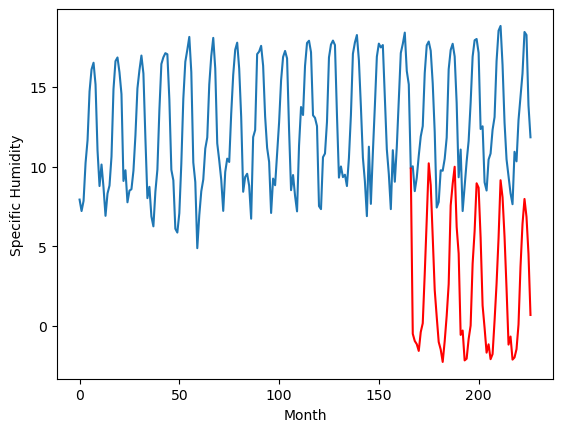

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.90		4.05		1.15
3.74		3.61		-0.13
3.60		3.41		-0.19
3.41		2.98		-0.43
6.96		4.17		-2.79
5.84		4.72		-1.12
8.08		7.82		-0.26
11.38		11.22		-0.16
14.31		14.76		0.45
12.80		13.39		0.59
10.75		10.14		-0.61
7.40		6.81		-0.59
4.73		5.13		0.40
2.35		3.54		1.19
2.24		3.07		0.83
2.12		2.29		0.17
5.18		3.59		-1.59
5.43		5.18		-0.25
8.87		7.17		-1.70
13.11		12.11		-1.00
14.76		13.47		-1.29
14.77		14.54		-0.23
11.83		10.76		-1.07
9.05		9.09		0.04
3.61		3.99		0.38
6.56		4.26		-2.30
1.83		2.39		0.56
2.68		2.49		-0.19
3.73		3.72		-0.01
6.18		4.57		-1.61
10.78		8.46		-2.32
13.16		10.50		-2.66
15.00		13.50		-1.50
14.82		13.23		-1.59
10.58		10.10		-0.48
5.62		5.83		0.21
4.87		4.42		-0.45
4.33		2.87		-1.46
4.23		3.40		-0.83
4.90		2.46		-2.44
5.23		2.78		-2.45
6.07		4.88		-1.19
9.45		7.20		-2.25
13.02		10.07		-2.95
14.61		13.70		-0.91
13.03		12.62		-0.41
10.01		10.14		0.13
6.08		6.90		0.82
4.10		3.38		-0.72
2.7

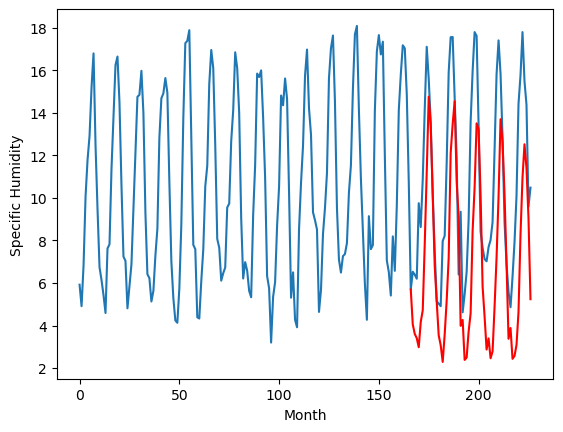

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.20		2.03		-1.17
2.20		1.59		-0.61
2.84		1.39		-1.45
2.22		0.96		-1.26
6.17		2.15		-4.02
5.77		2.70		-3.07
8.93		5.80		-3.13
11.09		9.20		-1.89
14.32		12.74		-1.58
11.73		11.37		-0.36
10.52		8.12		-2.40
5.95		4.79		-1.16
4.31		3.11		-1.20
1.71		1.52		-0.19
1.60		1.05		-0.55
1.28		0.27		-1.01
3.94		1.57		-2.37
5.23		3.16		-2.07
9.23		5.15		-4.08
12.92		10.09		-2.83
13.49		11.45		-2.04
13.88		12.52		-1.36
9.87		8.74		-1.13
7.02		7.07		0.05
3.40		1.97		-1.43
5.26		2.24		-3.02
0.60		0.37		-0.23
1.13		0.47		-0.66
2.72		1.70		-1.02
6.23		2.55		-3.68
10.22		6.44		-3.78
11.99		8.48		-3.51
11.41		11.48		0.07
12.42		11.21		-1.21
9.14		8.08		-1.06
4.68		3.81		-0.87
4.50		2.40		-2.10
2.92		0.85		-2.07
2.23		1.38		-0.85
2.59		0.44		-2.15
4.65		0.76		-3.89
5.33		2.86		-2.47
9.59		5.18		-4.41
13.53		8.05		-5.48
13.38		11.68		-1.70
11.28		10.60		-0.68
10.38		8.12		-2.26
6.66		4.88		-1.78
4.13		1.36		-2.77
2

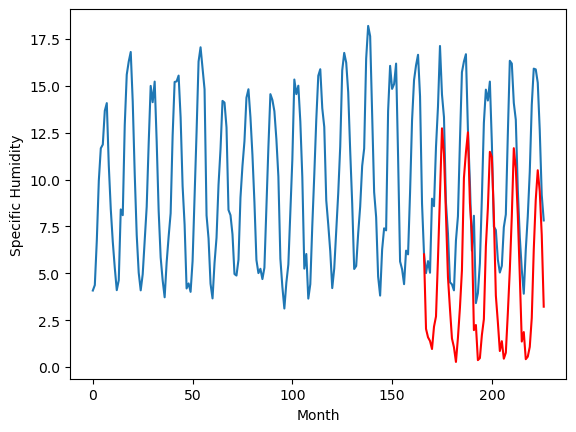

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.29		0.19		-1.10
0.32		-0.25		-0.57
1.01		-0.45		-1.46
0.35		-0.88		-1.23
4.25		0.31		-3.94
3.74		0.86		-2.88
6.98		3.96		-3.02
8.96		7.36		-1.60
12.11		10.90		-1.21
9.46		9.53		0.07
8.57		6.28		-2.29
3.80		2.95		-0.85
2.44		1.27		-1.17
-0.13		-0.32		-0.19
-0.17		-0.79		-0.62
-0.62		-1.57		-0.95
1.96		-0.27		-2.23
3.32		1.32		-2.00
7.61		3.31		-4.30
11.49		8.25		-3.24
11.87		9.61		-2.26
11.98		10.68		-1.30
8.08		6.90		-1.18
5.35		5.23		-0.12
1.74		0.13		-1.61
3.15		0.40		-2.75
-1.18		-1.47		-0.29
-0.74		-1.37		-0.63
0.78		-0.14		-0.92
4.46		0.71		-3.75
8.34		4.60		-3.74
10.02		6.64		-3.38
9.52		9.64		0.12
10.69		9.37		-1.32
7.54		6.24		-1.30
3.08		1.97		-1.11
2.66		0.56		-2.10
1.07		-0.99		-2.06
0.32		-0.46		-0.78
0.72		-1.40		-2.12
2.69		-1.08		-3.77
3.54		1.02		-2.52
7.81		3.34		-4.47
11.29		6.21		-5.08
10.39		9.84		-0.55
9.01		8.76		-0.25
8.68		6.28		-2.40
5.02		3.04		-1.98
2.60		-0.48		-

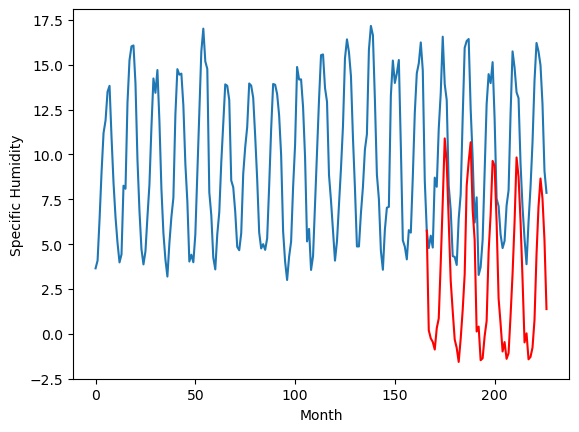

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.63		-0.24		-2.87
1.39		-0.68		-2.07
1.27		-0.88		-2.15
1.15		-1.31		-2.46
3.95		-0.12		-4.07
3.20		0.43		-2.77
5.47		3.53		-1.94
7.18		6.93		-0.25
8.41		10.47		2.06
7.10		9.10		2.00
6.91		5.85		-1.06
3.26		2.52		-0.74
2.80		0.84		-1.96
0.24		-0.75		-0.99
0.94		-1.22		-2.16
0.30		-2.00		-2.30
1.79		-0.70		-2.49
2.75		0.89		-1.86
7.30		2.88		-4.42
9.60		7.82		-1.78
10.63		9.18		-1.45
10.35		10.25		-0.10
7.10		6.47		-0.63
4.05		4.80		0.75
2.33		-0.30		-2.63
1.48		-0.03		-1.51
0.02		-1.90		-1.92
0.01		-1.80		-1.81
0.60		-0.57		-1.17
2.63		0.28		-2.35
4.89		4.17		-0.72
7.74		6.21		-1.53
8.43		9.21		0.78
10.42		8.94		-1.48
9.17		5.81		-3.36
5.66		1.54		-4.12
2.96		0.13		-2.83
2.32		-1.42		-3.74
0.77		-0.89		-1.66
0.89		-1.83		-2.72
2.18		-1.51		-3.69
2.15		0.59		-1.56
6.99		2.91		-4.08
10.85		5.78		-5.07
8.52		9.41		0.89
7.66		8.33		0.67
8.17		5.85		-2.32
6.04		2.61		-3.43
3.74		-0.91		-4.65
2.16

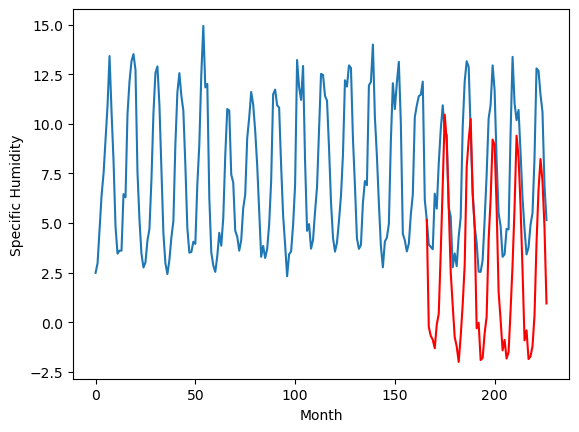

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.97		-1.40		1.57
-2.90		-1.84		1.06
-3.06		-2.04		1.02
-2.48		-2.47		0.01
-0.29		-1.28		-0.99
-0.96		-0.73		0.23
2.16		2.37		0.21
5.99		5.77		-0.22
8.58		9.31		0.73
8.79		7.94		-0.85
4.95		4.69		-0.26
2.30		1.36		-0.94
-0.53		-0.32		0.21
-3.87		-1.91		1.96
-3.99		-2.38		1.61
-3.74		-3.16		0.58
-2.03		-1.86		0.17
-1.62		-0.27		1.35
1.36		1.72		0.36
6.05		6.66		0.61
7.65		8.02		0.37
8.03		9.09		1.06
4.45		5.31		0.86
2.24		3.64		1.40
-3.48		-1.46		2.02
-1.62		-1.19		0.43
-4.60		-3.06		1.54
-3.28		-2.96		0.32
-2.44		-1.73		0.71
-1.38		-0.88		0.50
2.63		3.01		0.38
4.91		5.05		0.14
8.07		8.05		-0.02
6.88		7.78		0.90
3.33		4.65		1.32
-1.35		0.38		1.73
-1.53		-1.03		0.50
-3.52		-2.58		0.94
-2.89		-2.05		0.84
-1.85		-2.99		-1.14
-2.36		-2.67		-0.31
-0.76		-0.57		0.19
1.46		1.75		0.29
4.51		4.62		0.11
7.90		8.25		0.35
7.44		7.17		-0.27
3.99		4.69		0.70
0.08		1.45		1.37
-2.87		-2.07		0.80
-3.15		-1.57

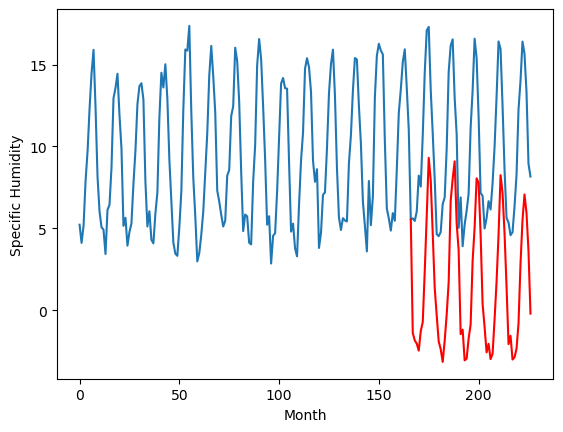

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.81		1.33		-0.48
1.54		0.89		-0.65
1.30		0.69		-0.61
1.07		0.26		-0.81
3.62		1.45		-2.17
3.94		2.00		-1.94
7.32		5.10		-2.22
10.93		8.50		-2.43
12.98		12.04		-0.94
10.33		10.67		0.34
8.73		7.42		-1.31
4.18		4.09		-0.09
2.51		2.41		-0.10
0.58		0.82		0.24
0.43		0.35		-0.08
-0.20		-0.43		-0.23
2.17		0.87		-1.30
3.09		2.46		-0.63
6.25		4.45		-1.80
10.85		9.39		-1.46
11.80		10.75		-1.05
11.54		11.82		0.28
8.28		8.04		-0.24
6.19		6.37		0.18
1.50		1.27		-0.23
2.97		1.54		-1.43
-0.23		-0.33		-0.10
0.28		-0.23		-0.51
1.79		1.00		-0.79
3.58		1.85		-1.73
8.29		5.74		-2.55
10.65		7.78		-2.87
11.45		10.78		-0.67
11.92		10.51		-1.41
8.11		7.38		-0.73
3.45		3.11		-0.34
2.09		1.70		-0.39
1.22		0.15		-1.07
1.50		0.68		-0.82
1.31		-0.26		-1.57
2.07		0.06		-2.01
2.97		2.16		-0.81
7.36		4.48		-2.88
9.92		7.35		-2.57
12.71		10.98		-1.73
12.99		9.90		-3.09
8.79		7.42		-1.37
5.18		4.18		-1.00
2.15		0.66		-1.49
1.3

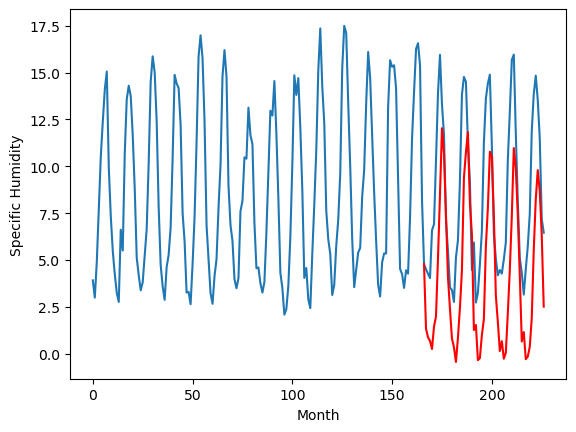

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.40		0.03		-0.37
0.57		-0.41		-0.98
0.20		-0.61		-0.81
-0.20		-1.04		-0.84
1.72		0.15		-1.57
2.00		0.70		-1.30
5.15		3.80		-1.35
7.89		7.20		-0.69
11.11		10.74		-0.37
9.44		9.37		-0.07
6.52		6.12		-0.40
3.14		2.79		-0.35
1.46		1.11		-0.35
-0.14		-0.48		-0.34
-0.49		-0.95		-0.46
-1.06		-1.73		-0.67
0.88		-0.43		-1.31
2.21		1.16		-1.05
4.50		3.15		-1.35
9.56		8.09		-1.47
10.82		9.45		-1.37
10.96		10.52		-0.44
7.48		6.74		-0.74
6.33		5.07		-1.26
0.56		-0.03		-0.59
1.27		0.24		-1.03
-1.11		-1.63		-0.52
-0.53		-1.53		-1.00
0.78		-0.30		-1.08
2.27		0.55		-1.72
6.29		4.44		-1.85
7.73		6.48		-1.25
10.47		9.48		-0.99
10.11		9.21		-0.90
7.45		6.08		-1.37
2.12		1.81		-0.31
1.08		0.40		-0.68
0.12		-1.15		-1.27
0.74		-0.62		-1.36
0.34		-1.56		-1.90
0.69		-1.24		-1.93
2.14		0.86		-1.28
4.39		3.18		-1.21
6.35		6.05		-0.30
10.65		9.68		-0.97
10.11		8.60		-1.51
7.31		6.12		-1.19
3.98		2.88		-1.10
0.91		-0.64

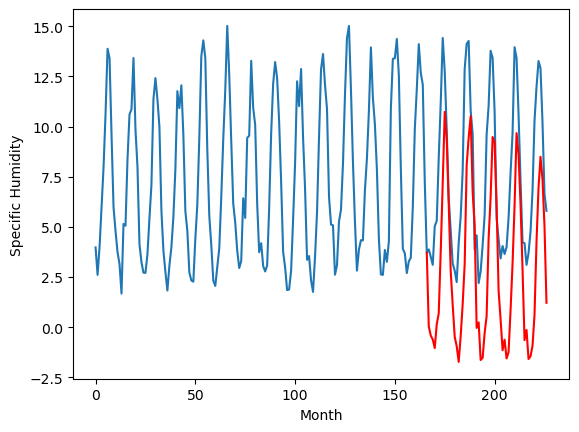

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.95		0.09		-0.86
1.12		-0.35		-1.47
0.64		-0.55		-1.19
0.37		-0.98		-1.35
2.42		0.21		-2.21
3.01		0.76		-2.25
6.73		3.86		-2.87
9.21		7.26		-1.95
12.77		10.80		-1.97
10.58		9.43		-1.15
7.80		6.18		-1.62
3.64		2.85		-0.79
2.55		1.17		-1.38
0.64		-0.42		-1.06
0.32		-0.89		-1.21
-0.32		-1.67		-1.35
2.05		-0.37		-2.42
3.36		1.22		-2.14
5.98		3.21		-2.77
10.73		8.15		-2.58
12.13		9.51		-2.62
12.38		10.58		-1.80
8.35		6.80		-1.55
6.48		5.13		-1.35
1.19		0.03		-1.16
1.73		0.30		-1.43
-0.51		-1.57		-1.06
0.19		-1.47		-1.66
1.71		-0.24		-1.95
3.01		0.61		-2.40
7.08		4.50		-2.58
9.32		6.54		-2.78
11.96		9.54		-2.42
11.19		9.27		-1.92
7.82		6.14		-1.68
3.06		1.87		-1.19
1.69		0.46		-1.23
0.58		-1.09		-1.67
1.10		-0.56		-1.66
0.87		-1.50		-2.37
1.48		-1.18		-2.66
2.99		0.92		-2.07
5.77		3.24		-2.53
7.41		6.11		-1.30
12.11		9.74		-2.37
11.98		8.66		-3.32
8.20		6.18		-2.02
4.76		2.94		-1.82
1.37		-0.58		

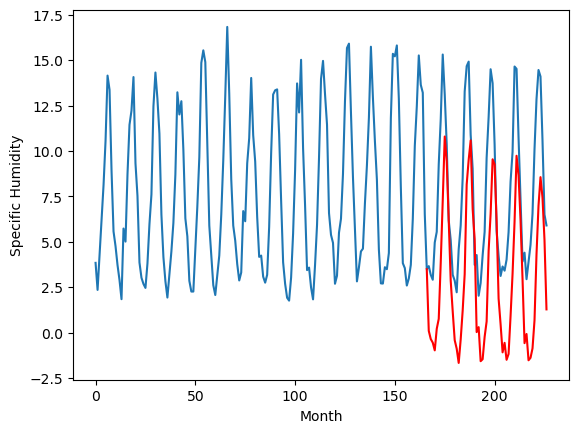

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.15		-0.05		-0.20
0.30		-0.49		-0.79
-0.04		-0.69		-0.65
-0.39		-1.12		-0.73
1.18		0.07		-1.11
1.02		0.62		-0.40
3.64		3.72		0.08
6.83		7.12		0.29
9.75		10.66		0.91
8.33		9.29		0.96
6.19		6.04		-0.15
3.15		2.71		-0.44
1.22		1.03		-0.19
-0.11		-0.56		-0.45
-0.49		-1.03		-0.54
-1.06		-1.81		-0.75
0.23		-0.51		-0.74
1.90		1.08		-0.82
3.50		3.07		-0.43
8.51		8.01		-0.50
9.78		9.37		-0.41
10.65		10.44		-0.21
6.89		6.66		-0.23
5.88		4.99		-0.89
0.64		-0.11		-0.75
0.60		0.16		-0.44
-1.14		-1.71		-0.57
-0.69		-1.61		-0.92
0.46		-0.38		-0.84
1.45		0.47		-0.98
4.91		4.36		-0.55
6.82		6.40		-0.42
8.55		9.40		0.85
9.01		9.13		0.12
7.02		6.00		-1.02
2.20		1.73		-0.47
1.48		0.32		-1.16
0.03		-1.23		-1.26
0.65		-0.70		-1.35
-0.10		-1.64		-1.54
0.11		-1.32		-1.43
1.81		0.78		-1.03
2.71		3.10		0.39
5.95		5.97		0.02
9.57		9.60		0.03
8.77		8.52		-0.25
7.06		6.04		-1.02
4.00		2.80		-1.20
0.56		-0.72		-1.28
1.0

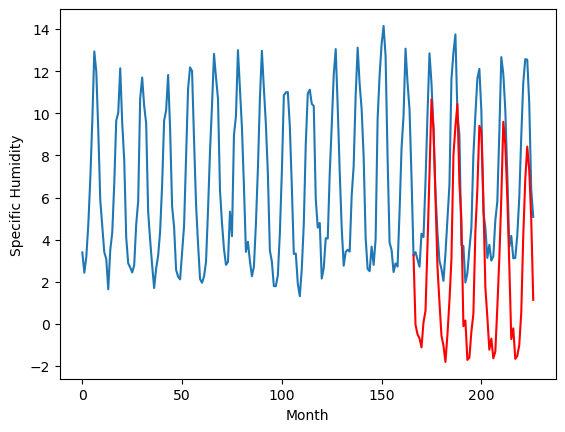

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.95   -0.04549
1                 1   -1.88   -0.48549
2                 2    2.90    4.05451
3                 3    3.20    2.03451
4                 4    1.29    0.19451
5                 5    2.63   -0.23549
6                 6   -2.97   -1.39549
7                 7    1.81    1.33451
8                 8    0.40    0.03451
9                 9    0.95    0.09451
10               10    0.15   -0.04549


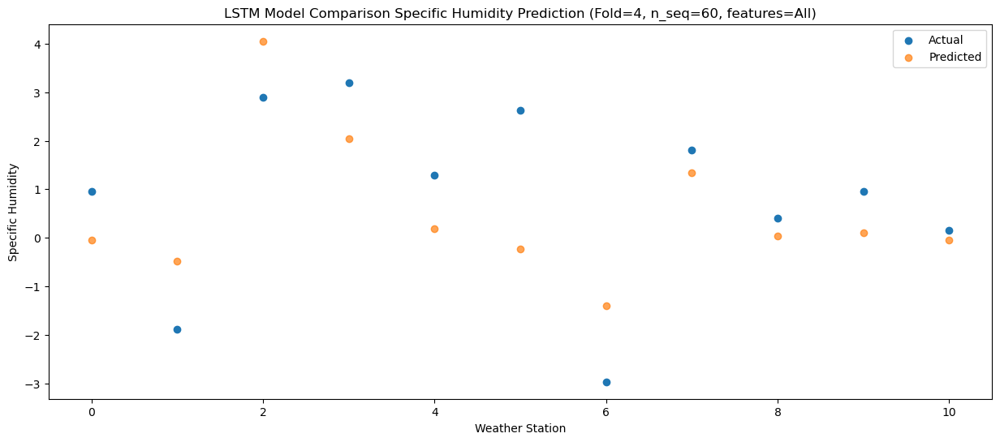

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.88  -0.494308
1                 1   -1.74  -0.934308
2                 2    3.74   3.605692
3                 3    2.20   1.585692
4                 4    0.32  -0.254308
5                 5    1.39  -0.684308
6                 6   -2.90  -1.844308
7                 7    1.54   0.885692
8                 8    0.57  -0.414308
9                 9    1.12  -0.354308
10               10    0.30  -0.494308


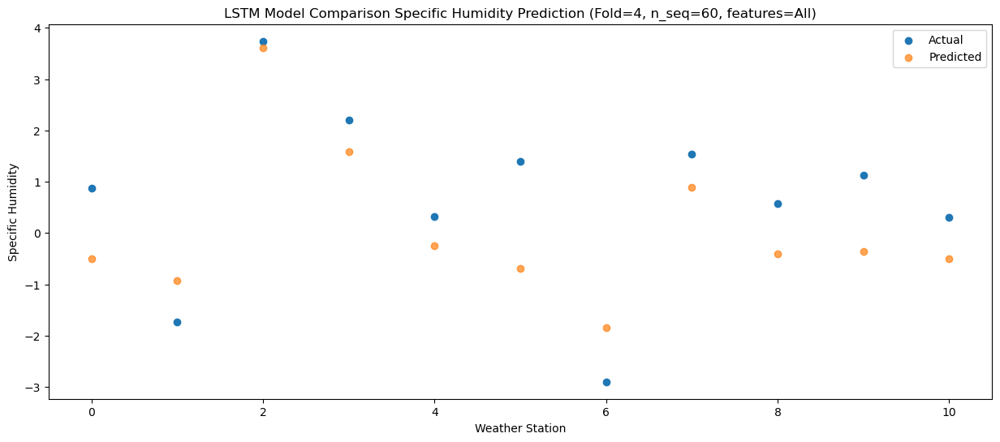

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.46  -0.692914
1                 1   -3.30  -1.132914
2                 2    3.60   3.407086
3                 3    2.84   1.387086
4                 4    1.01  -0.452914
5                 5    1.27  -0.882914
6                 6   -3.06  -2.042914
7                 7    1.30   0.687086
8                 8    0.20  -0.612914
9                 9    0.64  -0.552914
10               10   -0.04  -0.692914


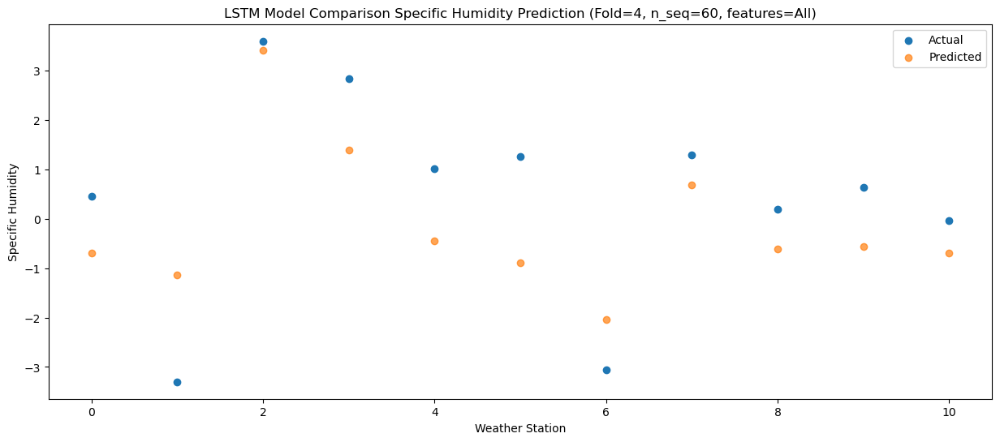

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.28  -1.119047
1                 1   -2.46  -1.559047
2                 2    3.41   2.980953
3                 3    2.22   0.960953
4                 4    0.35  -0.879047
5                 5    1.15  -1.309047
6                 6   -2.48  -2.469047
7                 7    1.07   0.260953
8                 8   -0.20  -1.039047
9                 9    0.37  -0.979047
10               10   -0.39  -1.119047


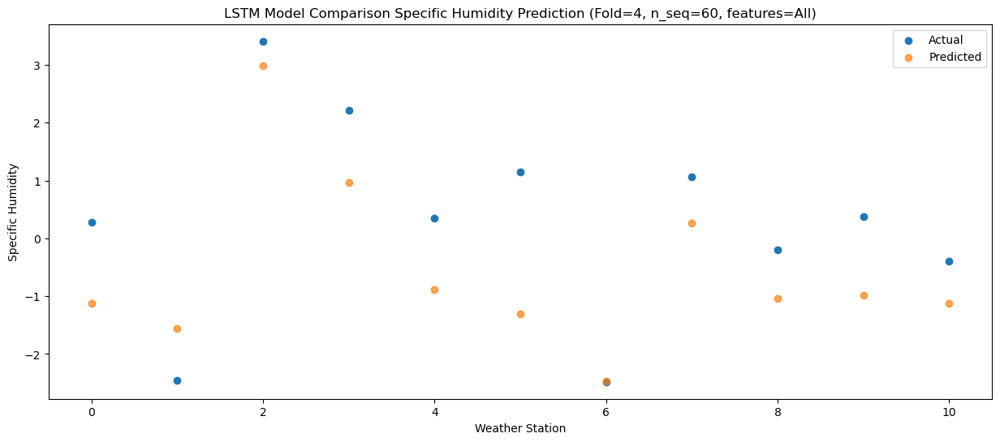

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    2.51   0.069313
1                 1   -1.08  -0.370687
2                 2    6.96   4.169313
3                 3    6.17   2.149313
4                 4    4.25   0.309313
5                 5    3.95  -0.120687
6                 6   -0.29  -1.280687
7                 7    3.62   1.449313
8                 8    1.72   0.149313
9                 9    2.42   0.209313
10               10    1.18   0.069313


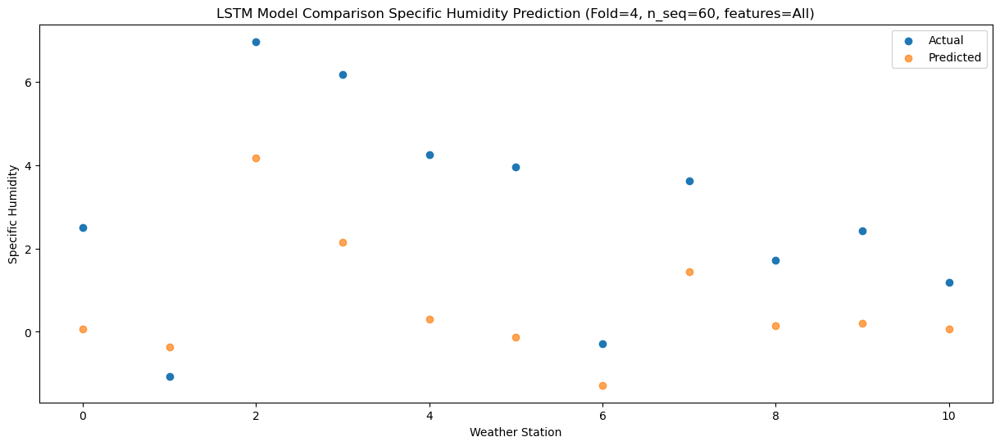

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.10   0.615931
1                 1    0.13   0.175931
2                 2    5.84   4.715931
3                 3    5.77   2.695931
4                 4    3.74   0.855931
5                 5    3.20   0.425931
6                 6   -0.96  -0.734069
7                 7    3.94   1.995931
8                 8    2.00   0.695931
9                 9    3.01   0.755931
10               10    1.02   0.615931


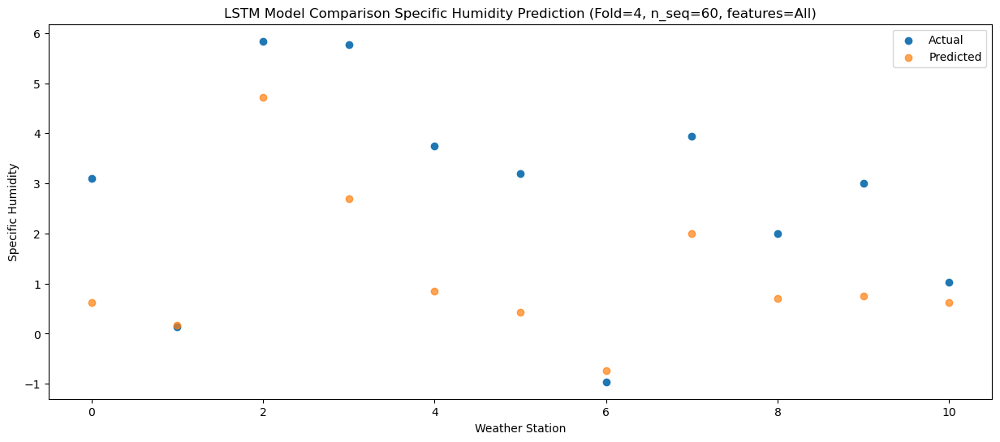

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.31   3.721935
1                 1    0.78   3.281935
2                 2    8.08   7.821935
3                 3    8.93   5.801935
4                 4    6.98   3.961935
5                 5    5.47   3.531935
6                 6    2.16   2.371935
7                 7    7.32   5.101935
8                 8    5.15   3.801935
9                 9    6.73   3.861935
10               10    3.64   3.721935


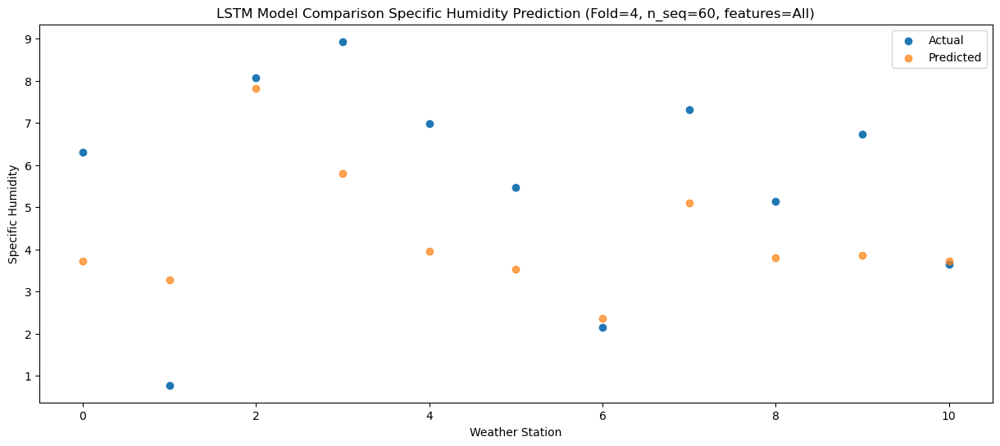

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   10.96   7.118784
1                 1    4.11   6.678784
2                 2   11.38  11.218784
3                 3   11.09   9.198784
4                 4    8.96   7.358784
5                 5    7.18   6.928784
6                 6    5.99   5.768784
7                 7   10.93   8.498784
8                 8    7.89   7.198784
9                 9    9.21   7.258784
10               10    6.83   7.118784


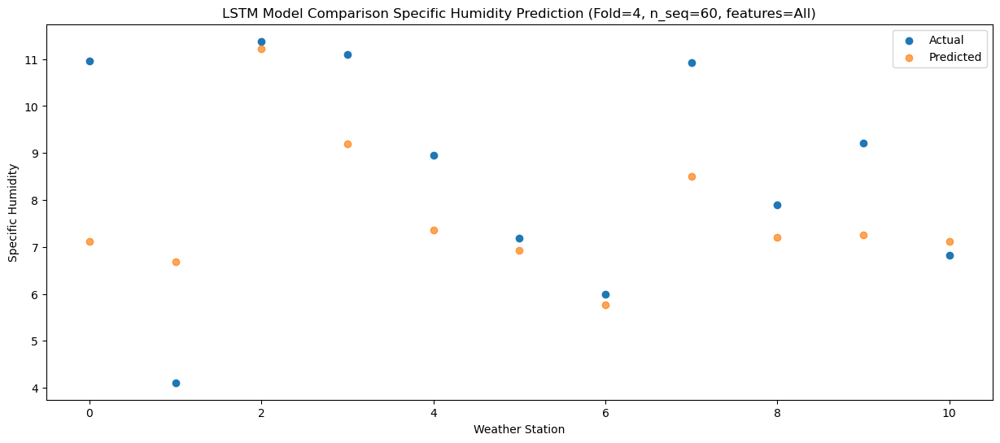

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.31  10.656403
1                 1    5.85  10.216403
2                 2   14.31  14.756403
3                 3   14.32  12.736403
4                 4   12.11  10.896403
5                 5    8.41  10.466403
6                 6    8.58   9.306403
7                 7   12.98  12.036403
8                 8   11.11  10.736403
9                 9   12.77  10.796403
10               10    9.75  10.656403


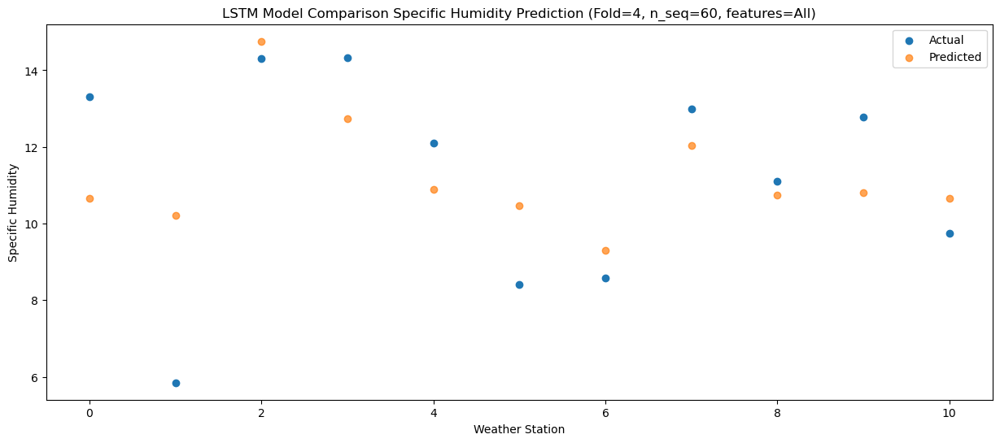

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.88   9.290718
1                 1    6.09   8.850718
2                 2   12.80  13.390718
3                 3   11.73  11.370718
4                 4    9.46   9.530718
5                 5    7.10   9.100718
6                 6    8.79   7.940718
7                 7   10.33  10.670718
8                 8    9.44   9.370718
9                 9   10.58   9.430718
10               10    8.33   9.290718


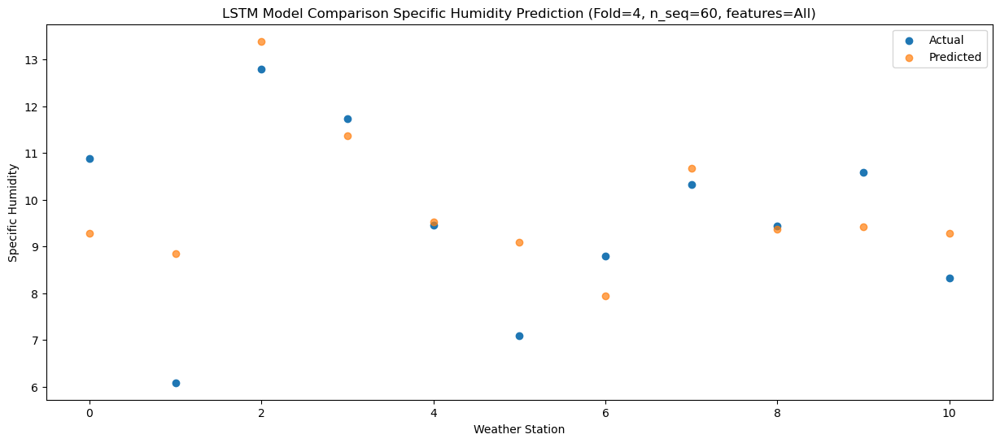

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    7.99   6.037592
1                 1    5.51   5.597592
2                 2   10.75  10.137592
3                 3   10.52   8.117592
4                 4    8.57   6.277592
5                 5    6.91   5.847592
6                 6    4.95   4.687592
7                 7    8.73   7.417592
8                 8    6.52   6.117592
9                 9    7.80   6.177592
10               10    6.19   6.037592


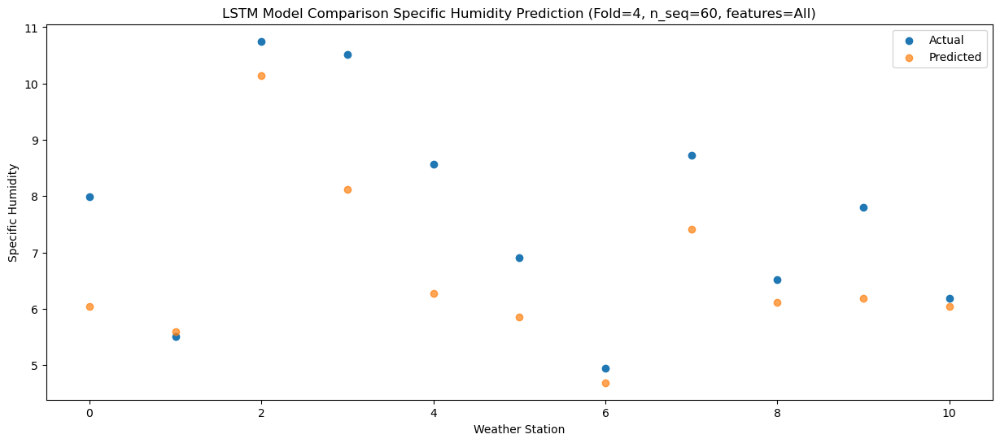

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.40   2.710059
1                 1    3.47   2.270059
2                 2    7.40   6.810059
3                 3    5.95   4.790059
4                 4    3.80   2.950059
5                 5    3.26   2.520059
6                 6    2.30   1.360059
7                 7    4.18   4.090059
8                 8    3.14   2.790059
9                 9    3.64   2.850059
10               10    3.15   2.710059


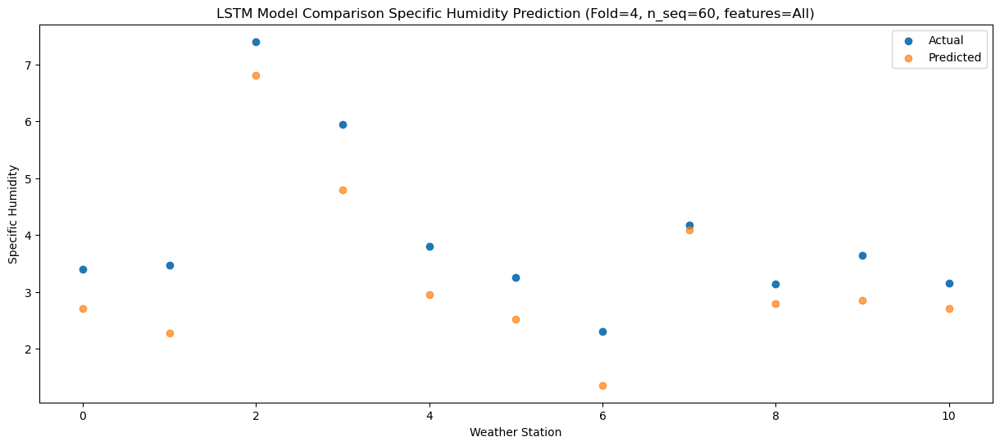

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    2.68   1.029405
1                 1    0.41   0.589405
2                 2    4.73   5.129405
3                 3    4.31   3.109405
4                 4    2.44   1.269405
5                 5    2.80   0.839405
6                 6   -0.53  -0.320595
7                 7    2.51   2.409405
8                 8    1.46   1.109405
9                 9    2.55   1.169405
10               10    1.22   1.029405


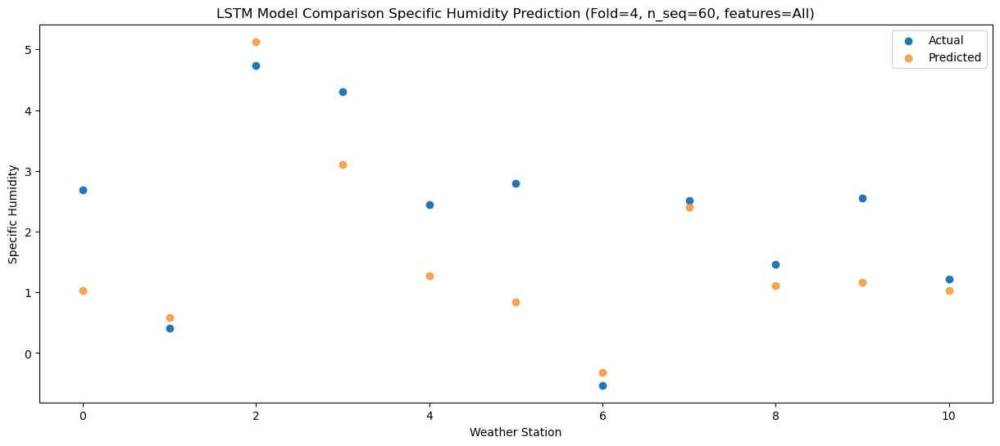

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.45  -0.557694
1                 1   -4.33  -0.997694
2                 2    2.35   3.542306
3                 3    1.71   1.522306
4                 4   -0.13  -0.317694
5                 5    0.24  -0.747694
6                 6   -3.87  -1.907694
7                 7    0.58   0.822306
8                 8   -0.14  -0.477694
9                 9    0.64  -0.417694
10               10   -0.11  -0.557694


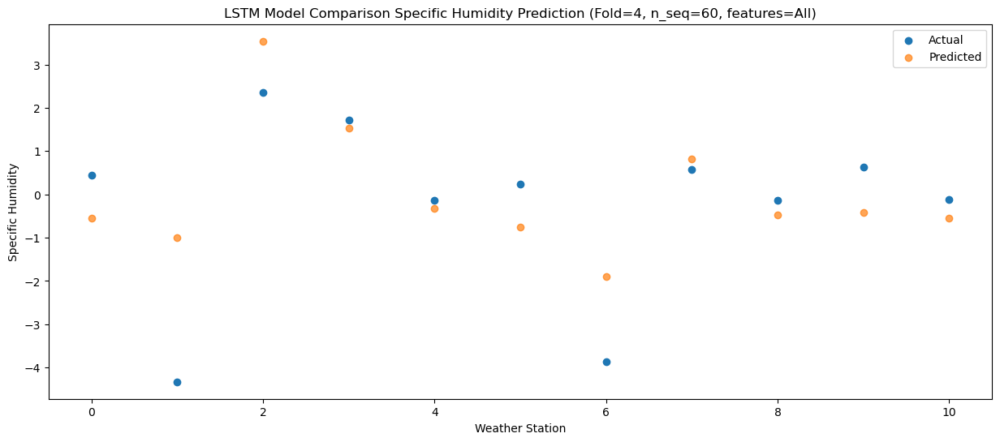

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    0.57  -1.026927
1                 1   -3.98  -1.466927
2                 2    2.24   3.073073
3                 3    1.60   1.053073
4                 4   -0.17  -0.786927
5                 5    0.94  -1.216927
6                 6   -3.99  -2.376927
7                 7    0.43   0.353073
8                 8   -0.49  -0.946927
9                 9    0.32  -0.886927
10               10   -0.49  -1.026927


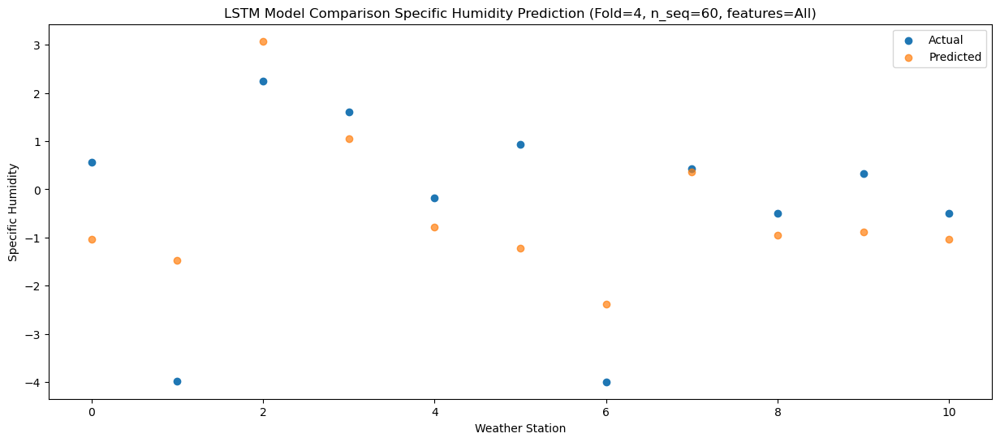

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.52  -1.809377
1                 1   -1.99  -2.249377
2                 2    2.12   2.290623
3                 3    1.28   0.270623
4                 4   -0.62  -1.569377
5                 5    0.30  -1.999377
6                 6   -3.74  -3.159377
7                 7   -0.20  -0.429377
8                 8   -1.06  -1.729377
9                 9   -0.32  -1.669377
10               10   -1.06  -1.809377


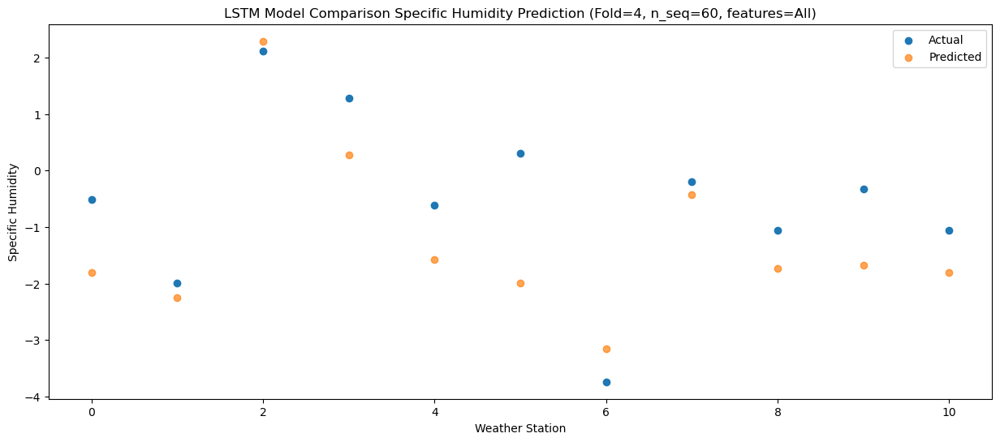

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.24  -0.513525
1                 1   -2.02  -0.953525
2                 2    5.18   3.586475
3                 3    3.94   1.566475
4                 4    1.96  -0.273525
5                 5    1.79  -0.703525
6                 6   -2.03  -1.863525
7                 7    2.17   0.866475
8                 8    0.88  -0.433525
9                 9    2.05  -0.373525
10               10    0.23  -0.513525


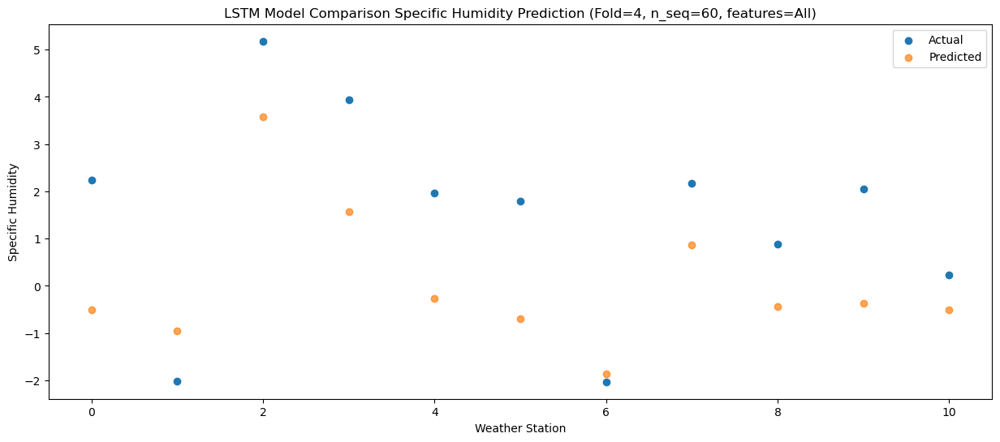

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.45   1.082189
1                 1   -1.27   0.642189
2                 2    5.43   5.182189
3                 3    5.23   3.162189
4                 4    3.32   1.322189
5                 5    2.75   0.892189
6                 6   -1.62  -0.267811
7                 7    3.09   2.462189
8                 8    2.21   1.162189
9                 9    3.36   1.222189
10               10    1.90   1.082189


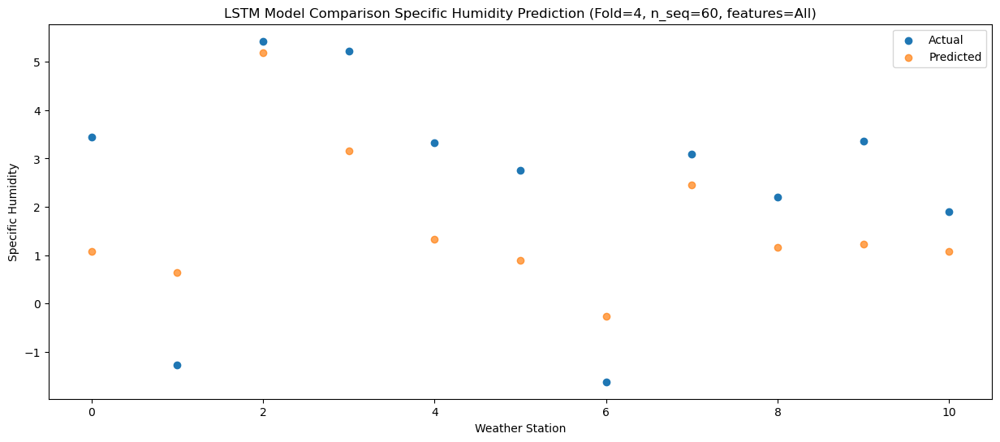

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    7.01   3.074639
1                 1    0.06   2.634639
2                 2    8.87   7.174639
3                 3    9.23   5.154639
4                 4    7.61   3.314639
5                 5    7.30   2.884639
6                 6    1.36   1.724639
7                 7    6.25   4.454639
8                 8    4.50   3.154639
9                 9    5.98   3.214639
10               10    3.50   3.074639


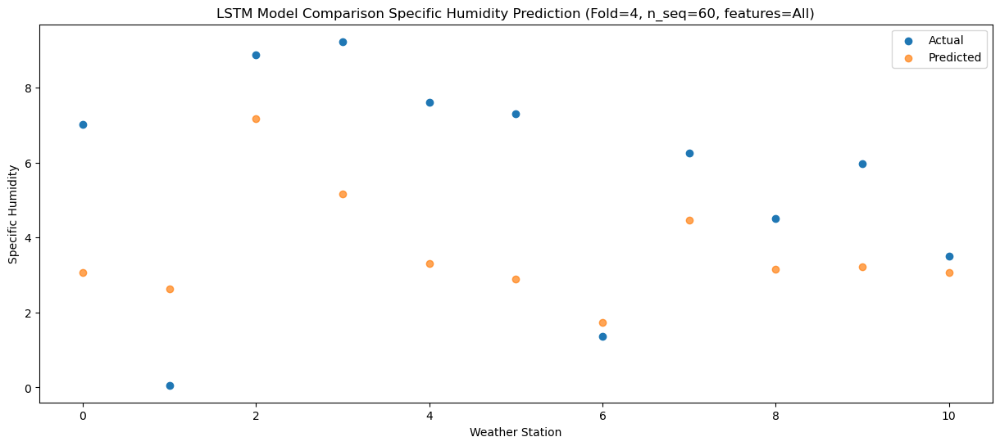

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.60   8.010595
1                 1    4.35   7.570595
2                 2   13.11  12.110595
3                 3   12.92  10.090595
4                 4   11.49   8.250595
5                 5    9.60   7.820595
6                 6    6.05   6.660595
7                 7   10.85   9.390595
8                 8    9.56   8.090595
9                 9   10.73   8.150595
10               10    8.51   8.010595


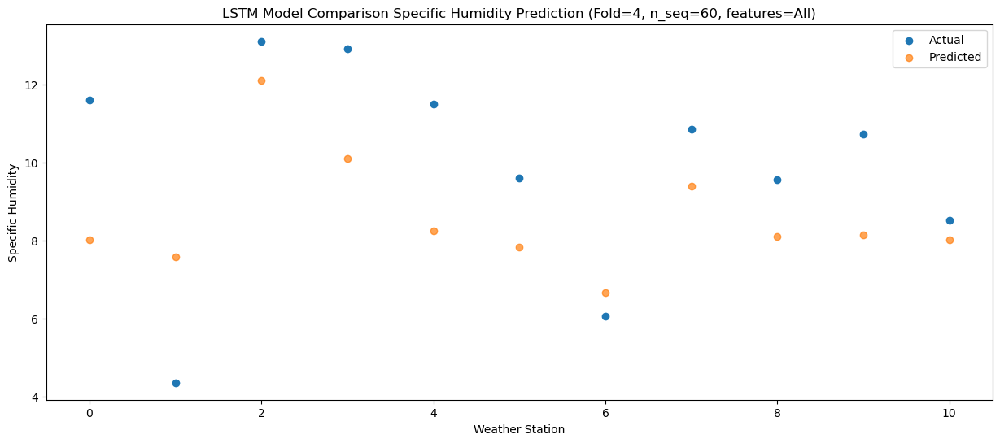

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.99   9.369955
1                 1    5.56   8.929955
2                 2   14.76  13.469955
3                 3   13.49  11.449955
4                 4   11.87   9.609955
5                 5   10.63   9.179955
6                 6    7.65   8.019955
7                 7   11.80  10.749955
8                 8   10.82   9.449955
9                 9   12.13   9.509955
10               10    9.78   9.369955


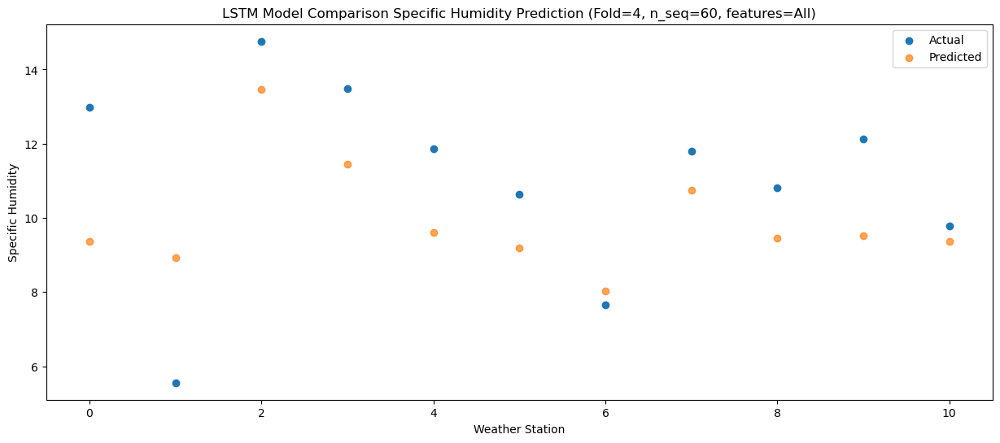

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.81  10.440994
1                 1    5.95  10.000994
2                 2   14.77  14.540994
3                 3   13.88  12.520994
4                 4   11.98  10.680994
5                 5   10.35  10.250994
6                 6    8.03   9.090994
7                 7   11.54  11.820994
8                 8   10.96  10.520994
9                 9   12.38  10.580994
10               10   10.65  10.440994


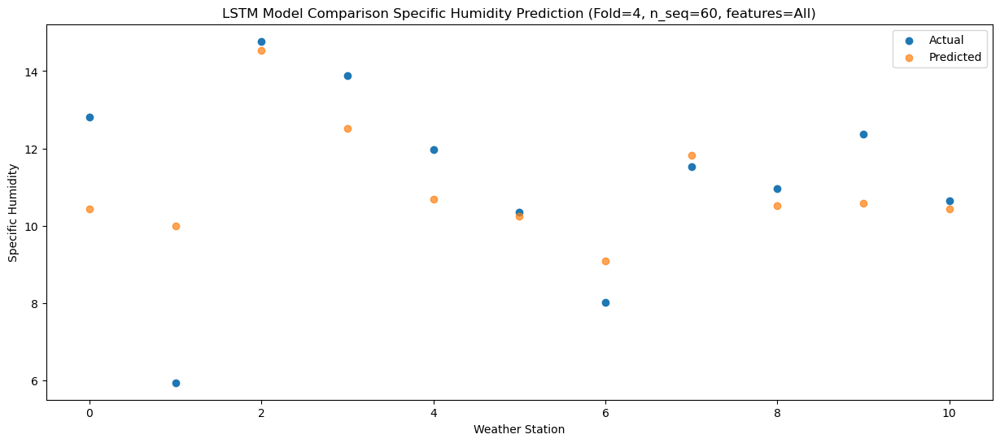

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    9.23   6.663224
1                 1    5.15   6.223224
2                 2   11.83  10.763224
3                 3    9.87   8.743224
4                 4    8.08   6.903224
5                 5    7.10   6.473224
6                 6    4.45   5.313224
7                 7    8.28   8.043224
8                 8    7.48   6.743224
9                 9    8.35   6.803224
10               10    6.89   6.663224


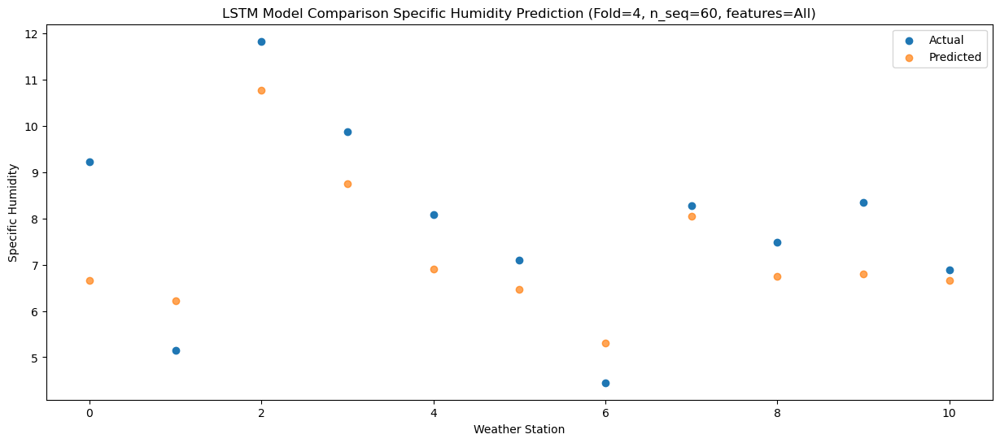

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.86   4.991961
1                 1    2.23   4.551961
2                 2    9.05   9.091961
3                 3    7.02   7.071961
4                 4    5.35   5.231961
5                 5    4.05   4.801961
6                 6    2.24   3.641961
7                 7    6.19   6.371961
8                 8    6.33   5.071961
9                 9    6.48   5.131961
10               10    5.88   4.991961


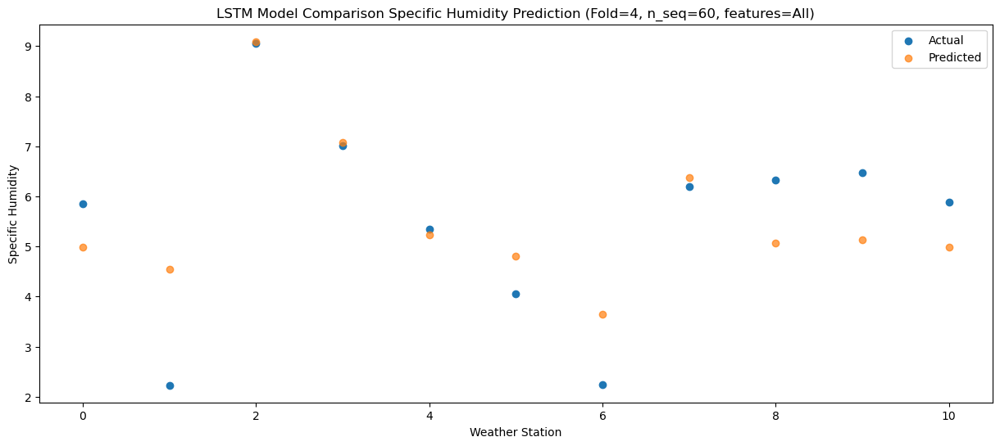

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.77  -0.114199
1                 1   -2.43  -0.554199
2                 2    3.61   3.985801
3                 3    3.40   1.965801
4                 4    1.74   0.125801
5                 5    2.33  -0.304199
6                 6   -3.48  -1.464199
7                 7    1.50   1.265801
8                 8    0.56  -0.034199
9                 9    1.19   0.025801
10               10    0.64  -0.114199


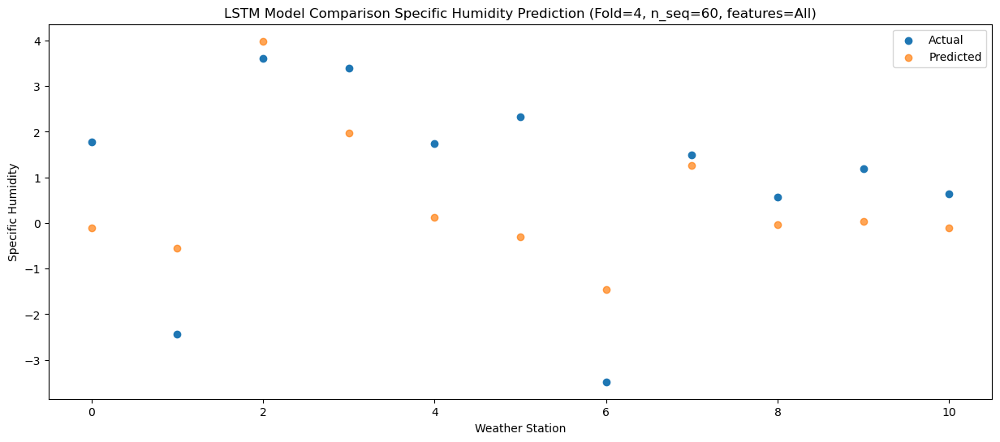

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.56   0.162065
1                 1   -0.69  -0.277935
2                 2    6.56   4.262065
3                 3    5.26   2.242065
4                 4    3.15   0.402065
5                 5    1.48  -0.027935
6                 6   -1.62  -1.187935
7                 7    2.97   1.542065
8                 8    1.27   0.242065
9                 9    1.73   0.302065
10               10    0.60   0.162065


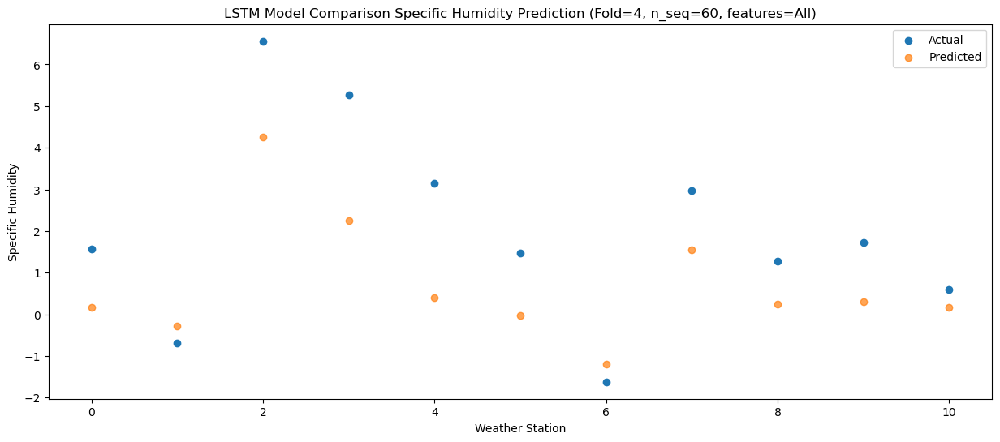

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -0.45  -1.714192
1                 1   -4.55  -2.154192
2                 2    1.83   2.385808
3                 3    0.60   0.365808
4                 4   -1.18  -1.474192
5                 5    0.02  -1.904192
6                 6   -4.60  -3.064192
7                 7   -0.23  -0.334192
8                 8   -1.11  -1.634192
9                 9   -0.51  -1.574192
10               10   -1.14  -1.714192


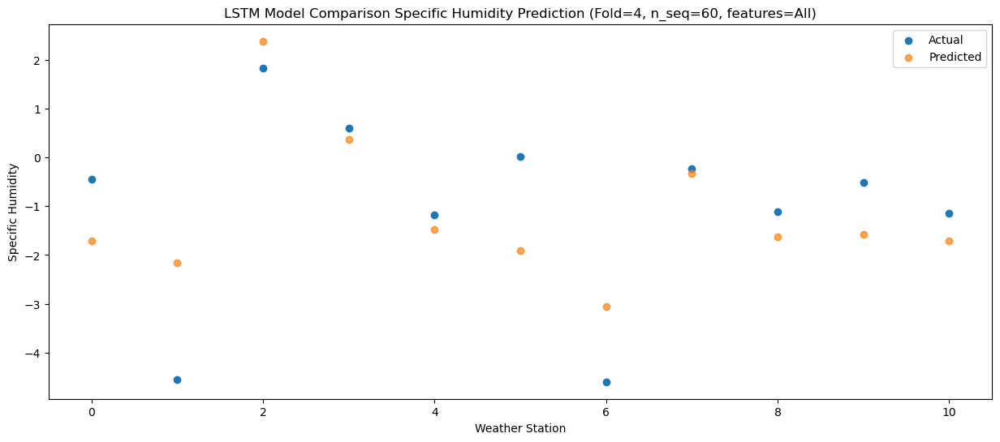

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.23   -1.60567
1                 1   -2.97   -2.04567
2                 2    2.68    2.49433
3                 3    1.13    0.47433
4                 4   -0.74   -1.36567
5                 5    0.01   -1.79567
6                 6   -3.28   -2.95567
7                 7    0.28   -0.22567
8                 8   -0.53   -1.52567
9                 9    0.19   -1.46567
10               10   -0.69   -1.60567


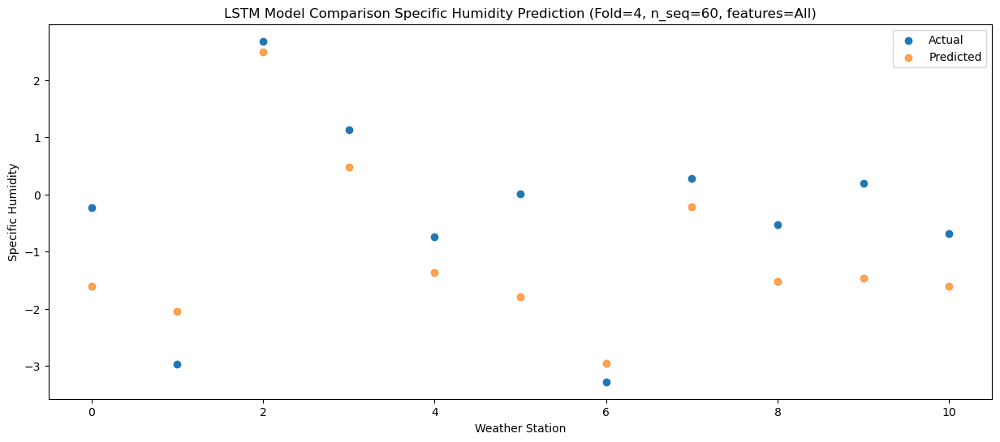

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.33  -0.375003
1                 1   -1.44  -0.815003
2                 2    3.73   3.724997
3                 3    2.72   1.704997
4                 4    0.78  -0.135003
5                 5    0.60  -0.565003
6                 6   -2.44  -1.725003
7                 7    1.79   1.004997
8                 8    0.78  -0.295003
9                 9    1.71  -0.235003
10               10    0.46  -0.375003


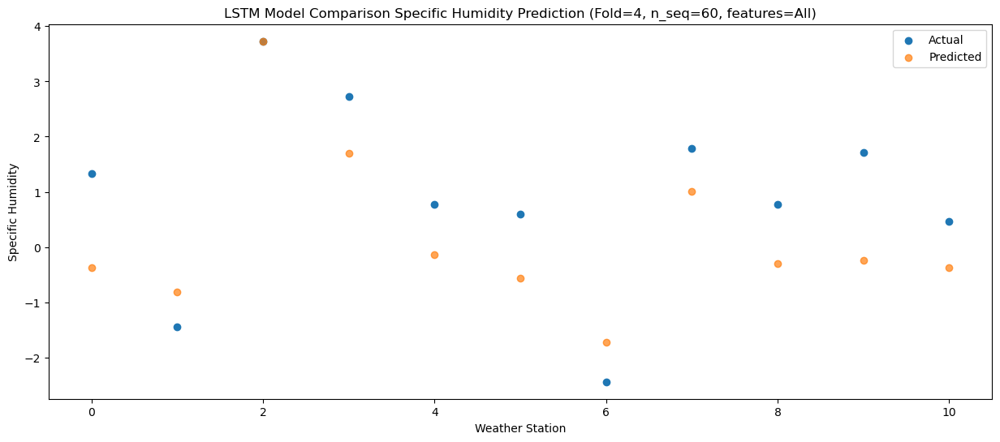

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.82   0.472492
1                 1   -0.15   0.032492
2                 2    6.18   4.572492
3                 3    6.23   2.552492
4                 4    4.46   0.712492
5                 5    2.63   0.282492
6                 6   -1.38  -0.877508
7                 7    3.58   1.852492
8                 8    2.27   0.552492
9                 9    3.01   0.612492
10               10    1.45   0.472492


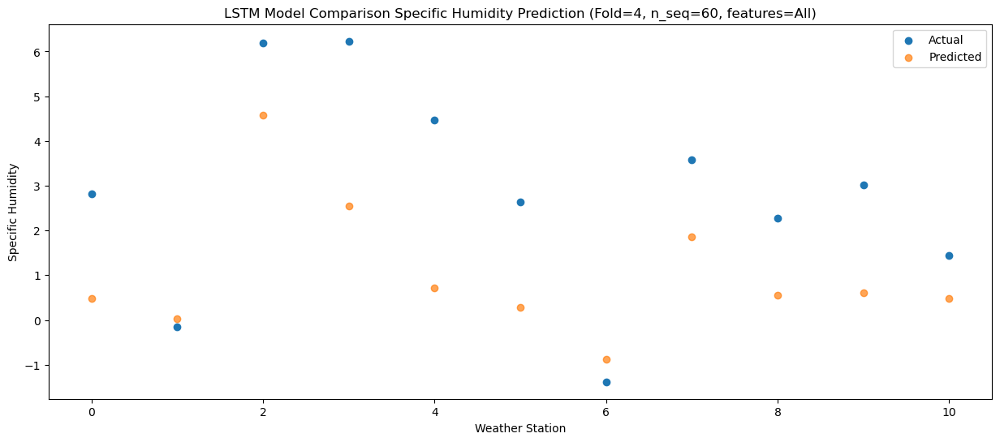

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.70   4.357876
1                 1    2.24   3.917876
2                 2   10.78   8.457876
3                 3   10.22   6.437876
4                 4    8.34   4.597876
5                 5    4.89   4.167876
6                 6    2.63   3.007876
7                 7    8.29   5.737876
8                 8    6.29   4.437876
9                 9    7.08   4.497876
10               10    4.91   4.357876


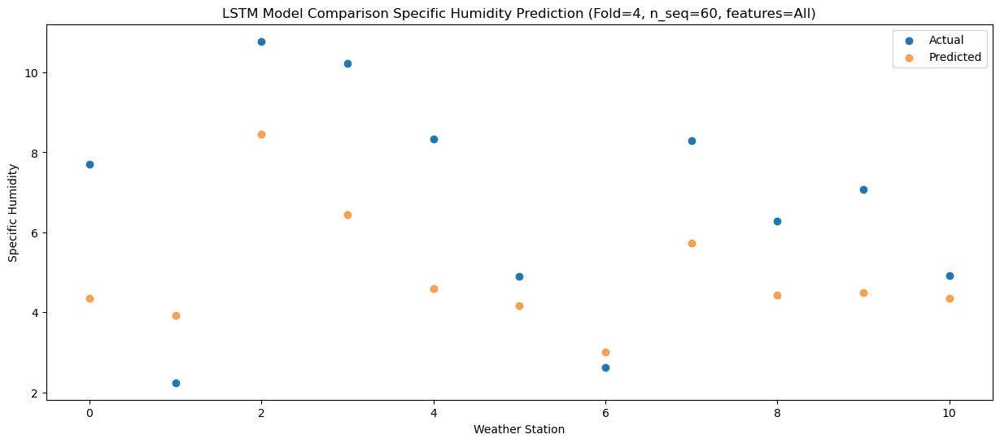

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   10.93   6.399224
1                 1    5.14   5.959224
2                 2   13.16  10.499224
3                 3   11.99   8.479224
4                 4   10.02   6.639224
5                 5    7.74   6.209224
6                 6    4.91   5.049224
7                 7   10.65   7.779224
8                 8    7.73   6.479224
9                 9    9.32   6.539224
10               10    6.82   6.399224


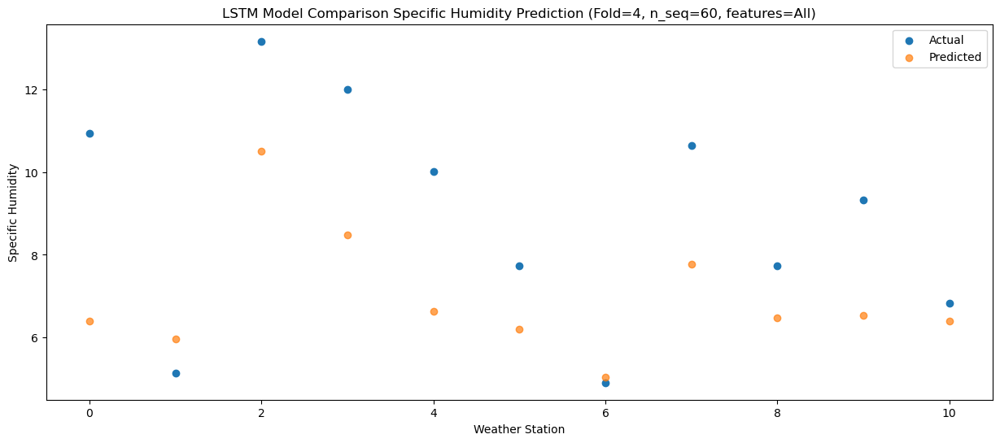

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.56   9.402842
1                 1    6.17   8.962842
2                 2   15.00  13.502842
3                 3   11.41  11.482842
4                 4    9.52   9.642842
5                 5    8.43   9.212842
6                 6    8.07   8.052842
7                 7   11.45  10.782842
8                 8   10.47   9.482842
9                 9   11.96   9.542842
10               10    8.55   9.402842


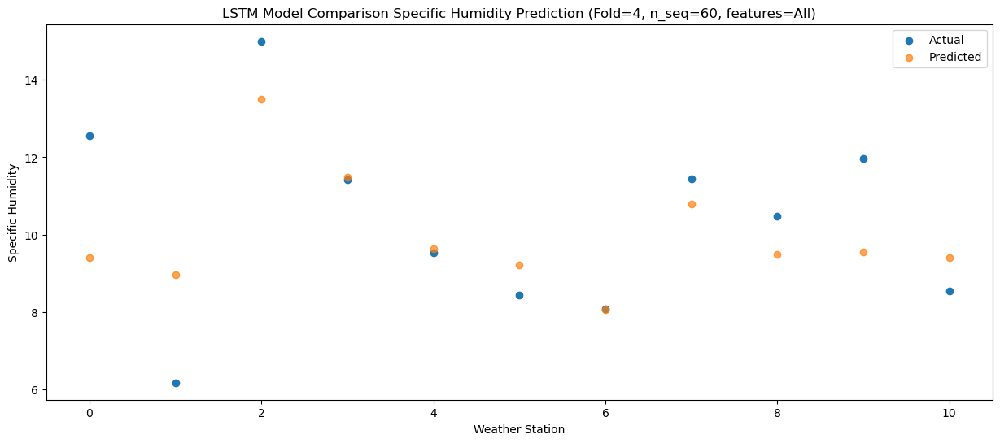

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.35   9.125113
1                 1    6.25   8.685113
2                 2   14.82  13.225113
3                 3   12.42  11.205113
4                 4   10.69   9.365113
5                 5   10.42   8.935113
6                 6    6.88   7.775113
7                 7   11.92  10.505113
8                 8   10.11   9.205113
9                 9   11.19   9.265113
10               10    9.01   9.125113


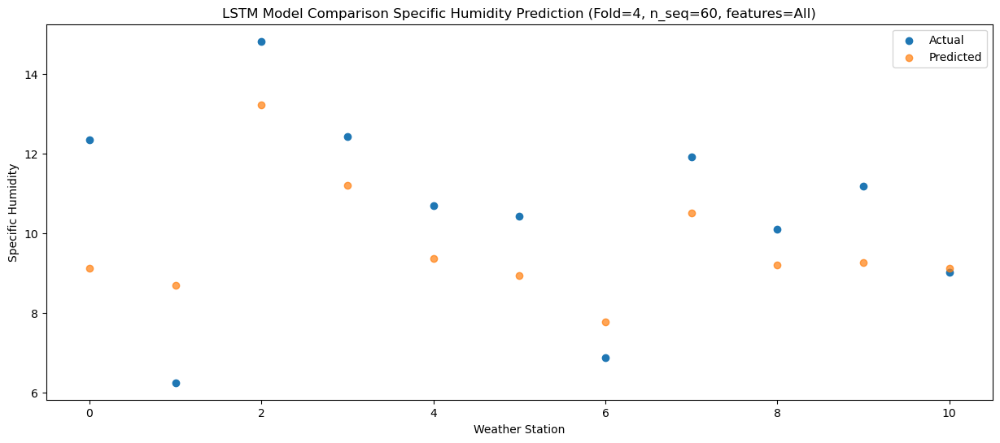

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.65   6.003656
1                 1    5.38   5.563656
2                 2   10.58  10.103656
3                 3    9.14   8.083656
4                 4    7.54   6.243656
5                 5    9.17   5.813656
6                 6    3.33   4.653656
7                 7    8.11   7.383656
8                 8    7.45   6.083656
9                 9    7.82   6.143656
10               10    7.02   6.003656


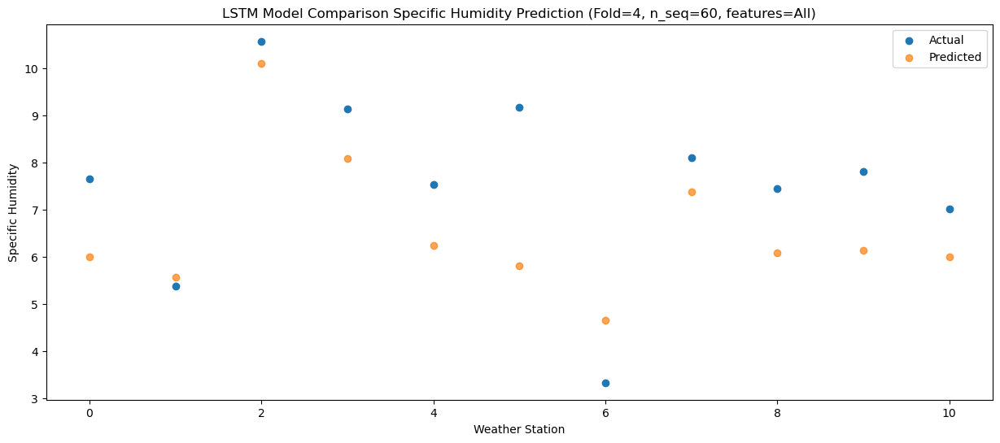

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    3.06   1.731991
1                 1    0.60   1.291991
2                 2    5.62   5.831991
3                 3    4.68   3.811991
4                 4    3.08   1.971991
5                 5    5.66   1.541991
6                 6   -1.35   0.381991
7                 7    3.45   3.111991
8                 8    2.12   1.811991
9                 9    3.06   1.871991
10               10    2.20   1.731991


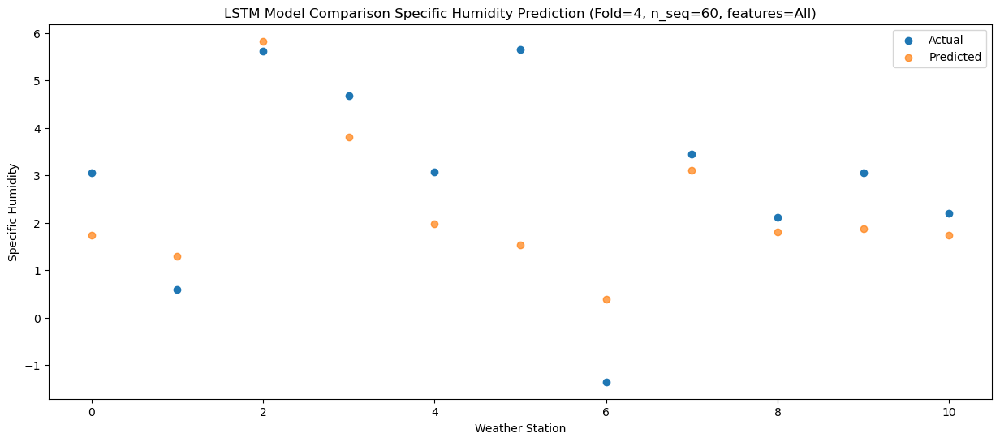

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.89   0.319436
1                 1    0.77  -0.120564
2                 2    4.87   4.419436
3                 3    4.50   2.399436
4                 4    2.66   0.559436
5                 5    2.96   0.129436
6                 6   -1.53  -1.030564
7                 7    2.09   1.699436
8                 8    1.08   0.399436
9                 9    1.69   0.459436
10               10    1.48   0.319436


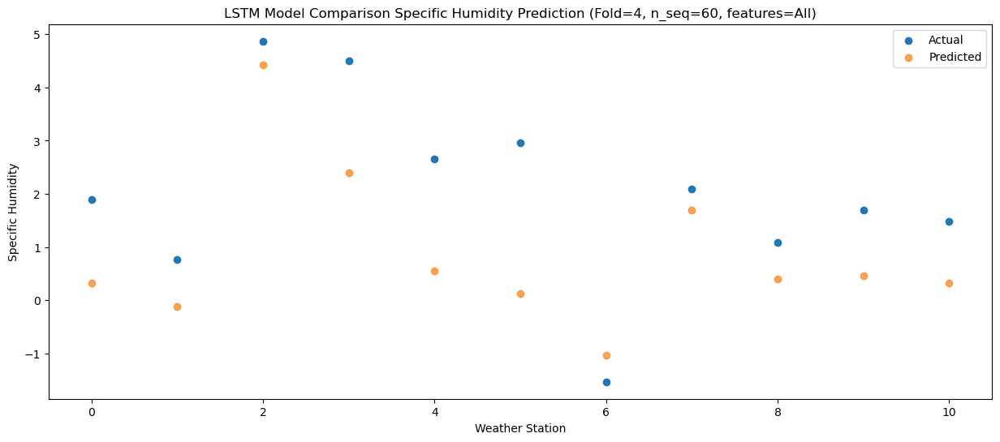

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    0.55  -1.226832
1                 1   -2.75  -1.666832
2                 2    4.33   2.873168
3                 3    2.92   0.853168
4                 4    1.07  -0.986832
5                 5    2.32  -1.416832
6                 6   -3.52  -2.576832
7                 7    1.22   0.153168
8                 8    0.12  -1.146832
9                 9    0.58  -1.086832
10               10    0.03  -1.226832


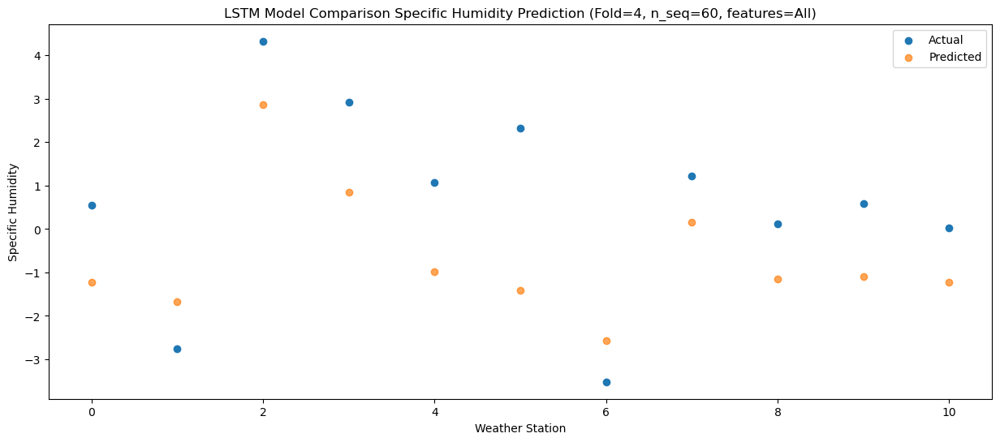

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.90  -0.703435
1                 1   -3.26  -1.143435
2                 2    4.23   3.396565
3                 3    2.23   1.376565
4                 4    0.32  -0.463435
5                 5    0.77  -0.893435
6                 6   -2.89  -2.053435
7                 7    1.50   0.676565
8                 8    0.74  -0.623435
9                 9    1.10  -0.563435
10               10    0.65  -0.703435


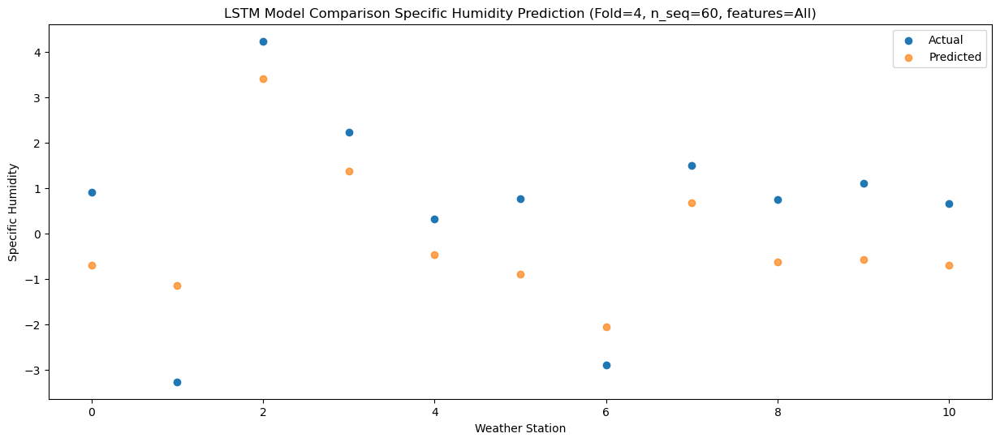

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.85  -1.637526
1                 1   -1.32  -2.077526
2                 2    4.90   2.462474
3                 3    2.59   0.442474
4                 4    0.72  -1.397526
5                 5    0.89  -1.827526
6                 6   -1.85  -2.987526
7                 7    1.31  -0.257526
8                 8    0.34  -1.557526
9                 9    0.87  -1.497526
10               10   -0.10  -1.637526


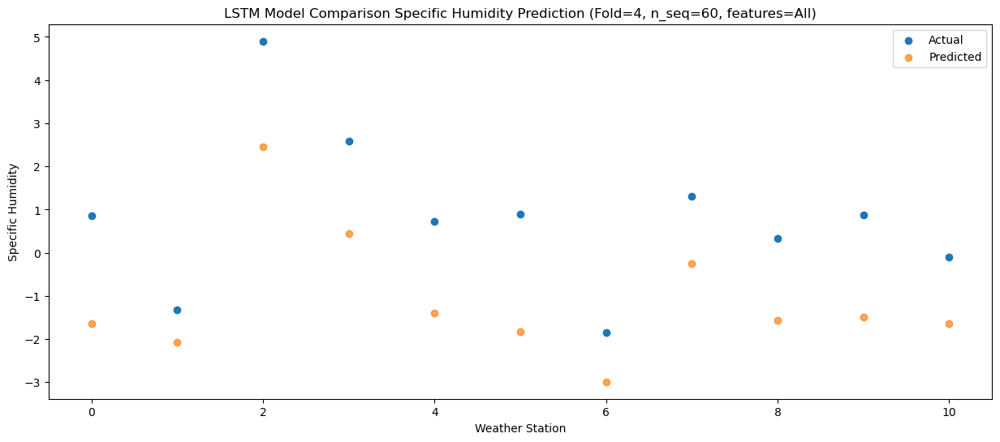

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.69  -1.317052
1                 1   -0.94  -1.757052
2                 2    5.23   2.782948
3                 3    4.65   0.762948
4                 4    2.69  -1.077052
5                 5    2.18  -1.507052
6                 6   -2.36  -2.667052
7                 7    2.07   0.062948
8                 8    0.69  -1.237052
9                 9    1.48  -1.177052
10               10    0.11  -1.317052


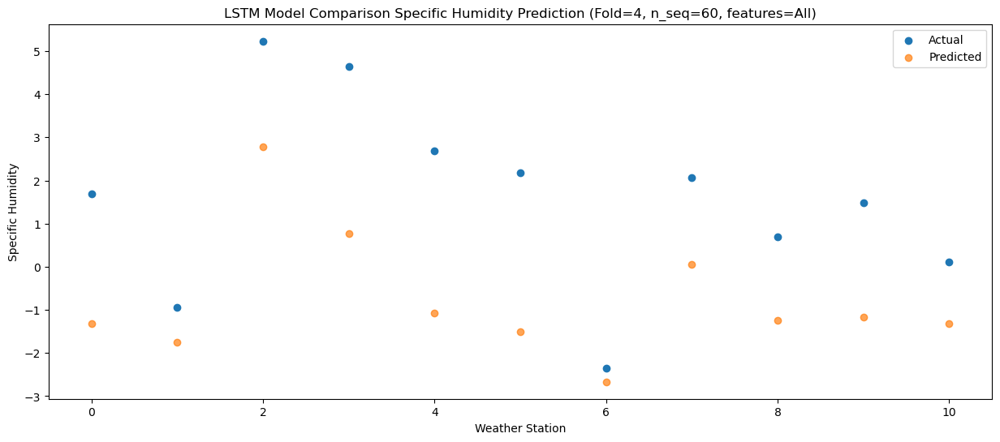

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.87   0.779155
1                 1    0.55   0.339155
2                 2    6.07   4.879155
3                 3    5.33   2.859155
4                 4    3.54   1.019155
5                 5    2.15   0.589155
6                 6   -0.76  -0.570845
7                 7    2.97   2.159155
8                 8    2.14   0.859155
9                 9    2.99   0.919155
10               10    1.81   0.779155


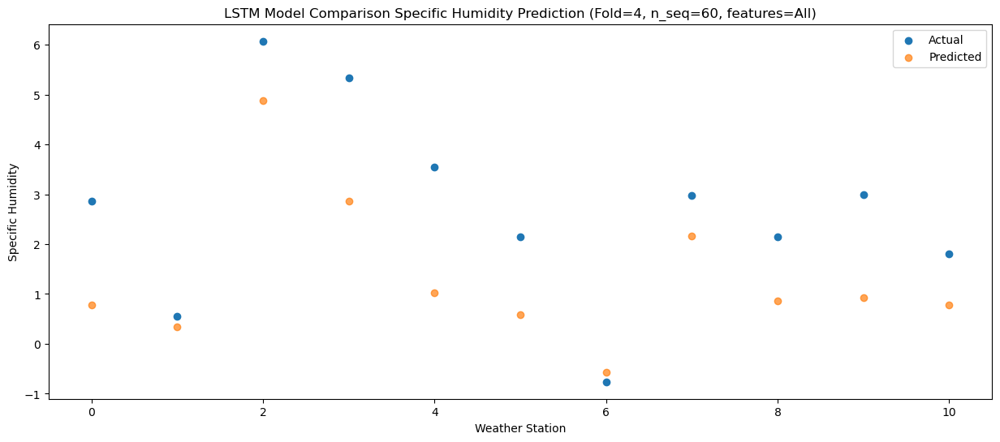

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.89   3.099175
1                 1    1.35   2.659175
2                 2    9.45   7.199175
3                 3    9.59   5.179175
4                 4    7.81   3.339175
5                 5    6.99   2.909175
6                 6    1.46   1.749175
7                 7    7.36   4.479175
8                 8    4.39   3.179175
9                 9    5.77   3.239175
10               10    2.71   3.099175


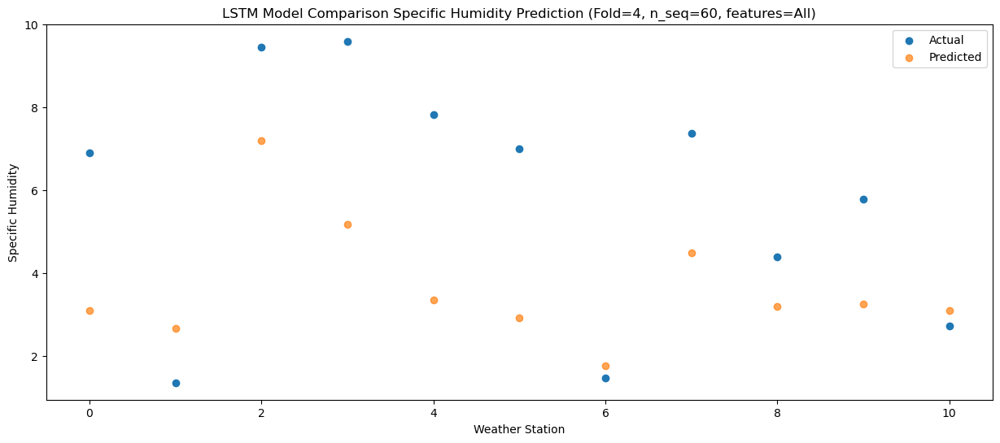

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.43    5.97381
1                 1    4.86    5.53381
2                 2   13.02   10.07381
3                 3   13.53    8.05381
4                 4   11.29    6.21381
5                 5   10.85    5.78381
6                 6    4.51    4.62381
7                 7    9.92    7.35381
8                 8    6.35    6.05381
9                 9    7.41    6.11381
10               10    5.95    5.97381


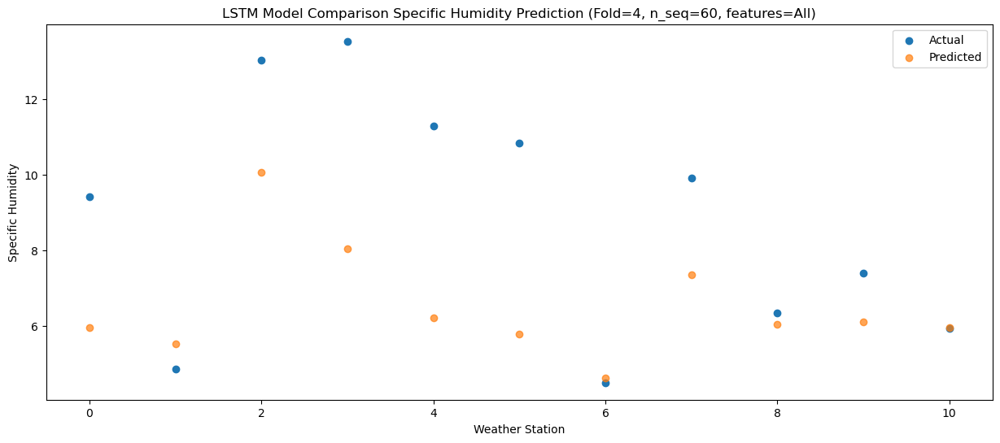

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.12   9.595798
1                 1    6.77   9.155798
2                 2   14.61  13.695798
3                 3   13.38  11.675798
4                 4   10.39   9.835798
5                 5    8.52   9.405798
6                 6    7.90   8.245798
7                 7   12.71  10.975798
8                 8   10.65   9.675798
9                 9   12.11   9.735798
10               10    9.57   9.595798


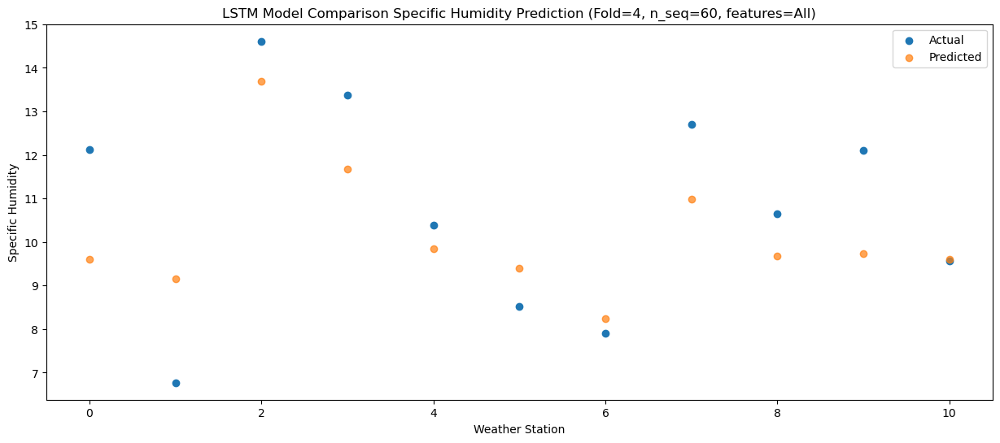

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   13.05   8.522211
1                 1    7.07   8.082211
2                 2   13.03  12.622211
3                 3   11.28  10.602211
4                 4    9.01   8.762211
5                 5    7.66   8.332211
6                 6    7.44   7.172211
7                 7   12.99   9.902211
8                 8   10.11   8.602211
9                 9   11.98   8.662211
10               10    8.77   8.522211


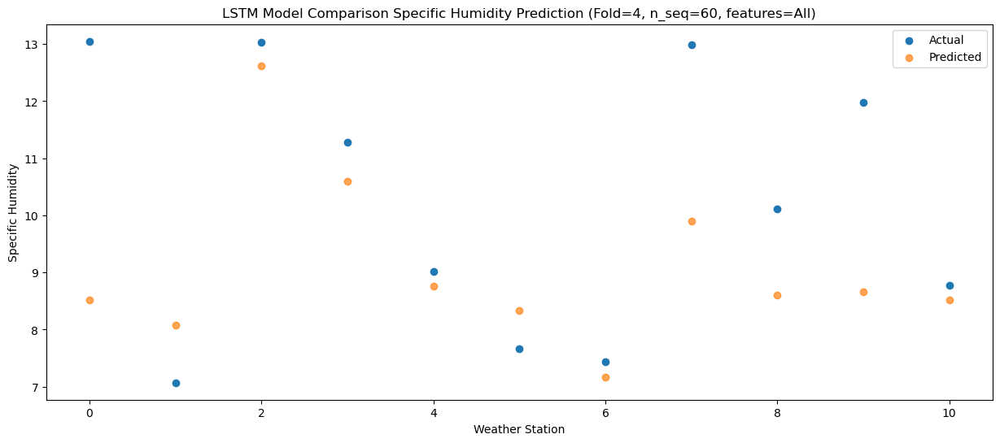

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.13   6.038538
1                 1    4.62   5.598538
2                 2   10.01  10.138538
3                 3   10.38   8.118538
4                 4    8.68   6.278538
5                 5    8.17   5.848538
6                 6    3.99   4.688538
7                 7    8.79   7.418538
8                 8    7.31   6.118538
9                 9    8.20   6.178538
10               10    7.06   6.038538


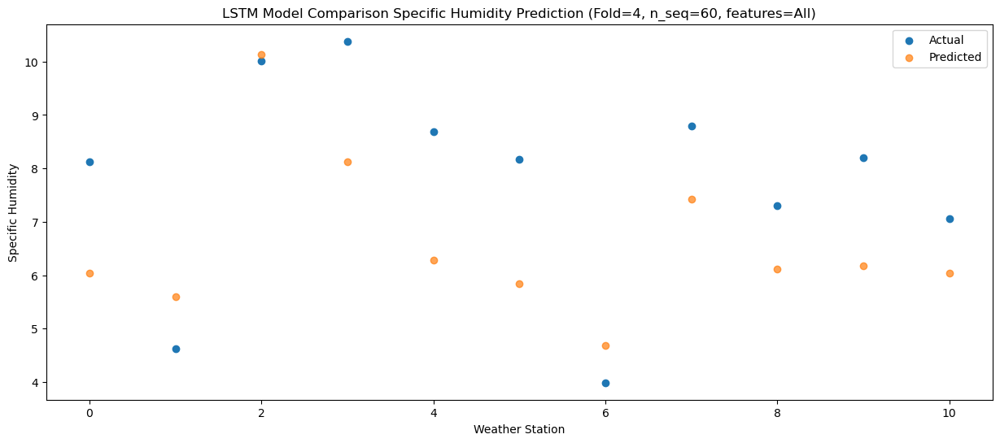

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    4.94   2.797442
1                 1    1.00   2.357442
2                 2    6.08   6.897442
3                 3    6.66   4.877442
4                 4    5.02   3.037442
5                 5    6.04   2.607442
6                 6    0.08   1.447442
7                 7    5.18   4.177442
8                 8    3.98   2.877442
9                 9    4.76   2.937442
10               10    4.00   2.797442


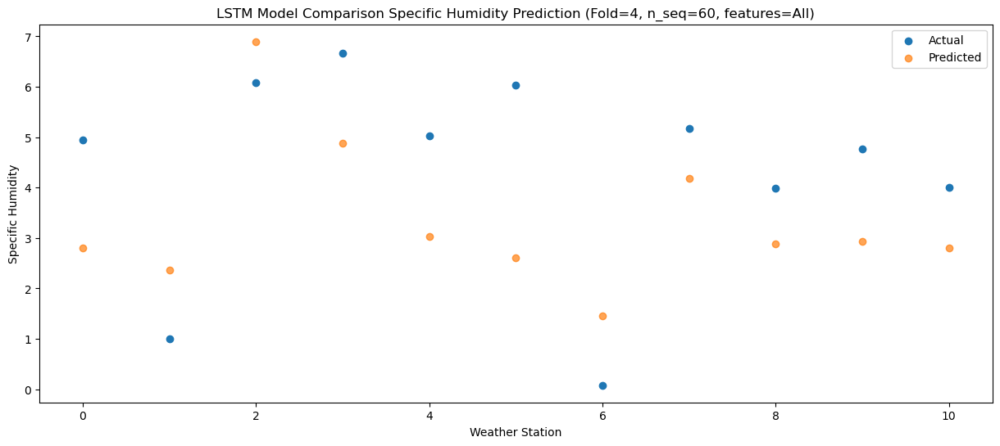

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    2.04  -0.721148
1                 1   -1.30  -1.161148
2                 2    4.10   3.378852
3                 3    4.13   1.358852
4                 4    2.60  -0.481148
5                 5    3.74  -0.911148
6                 6   -2.87  -2.071148
7                 7    2.15   0.658852
8                 8    0.91  -0.641148
9                 9    1.37  -0.581148
10               10    0.56  -0.721148


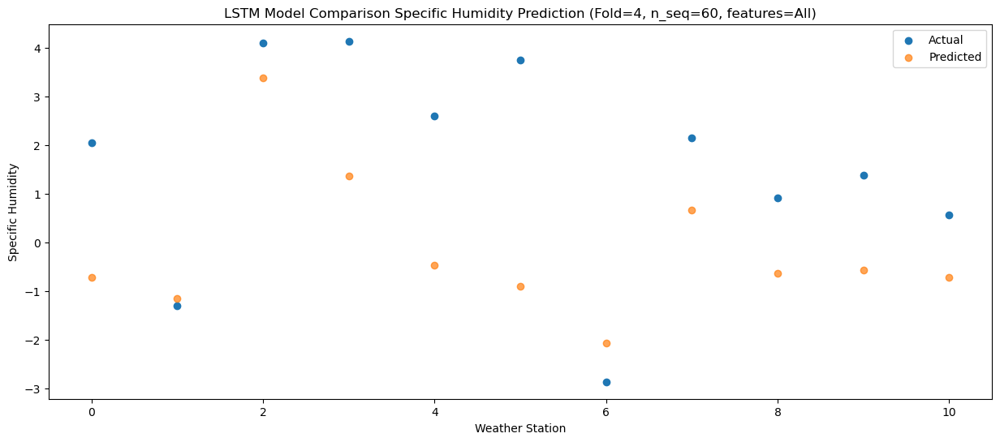

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    1.86  -0.216772
1                 1   -2.39  -0.656772
2                 2    2.79   3.883228
3                 3    2.38   1.863228
4                 4    0.84   0.023228
5                 5    2.16  -0.406772
6                 6   -3.15  -1.566772
7                 7    1.34   1.163228
8                 8    0.88  -0.136772
9                 9    1.86  -0.076772
10               10    1.08  -0.216772


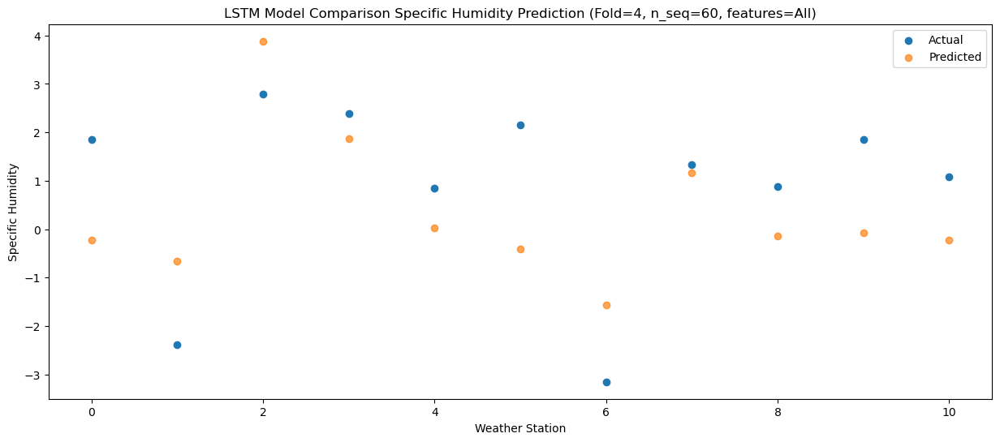

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0    0.16  -1.663988
1                 1   -3.43  -2.103988
2                 2    2.07   2.436012
3                 3    1.10   0.416012
4                 4   -0.58  -1.423988
5                 5    0.89  -1.853988
6                 6   -3.93  -3.013988
7                 7    0.19  -0.283988
8                 8   -0.20  -1.583988
9                 9    0.40  -1.523988
10               10    0.01  -1.663988


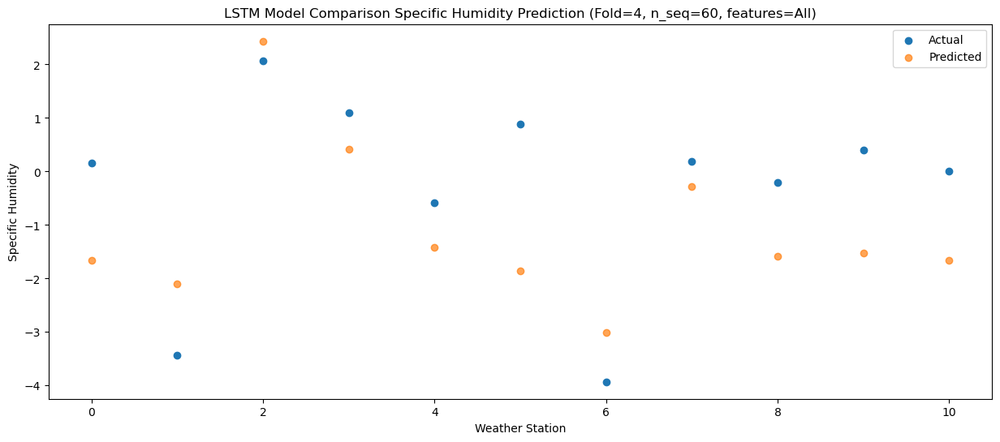

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.17   -1.52754
1                 1   -4.12   -1.96754
2                 2    3.50    2.57246
3                 3    3.44    0.55246
4                 4    1.77   -1.28754
5                 5    1.24   -1.71754
6                 6   -3.75   -2.87754
7                 7    1.55   -0.14754
8                 8    0.38   -1.44754
9                 9    1.32   -1.38754
10               10    0.03   -1.52754


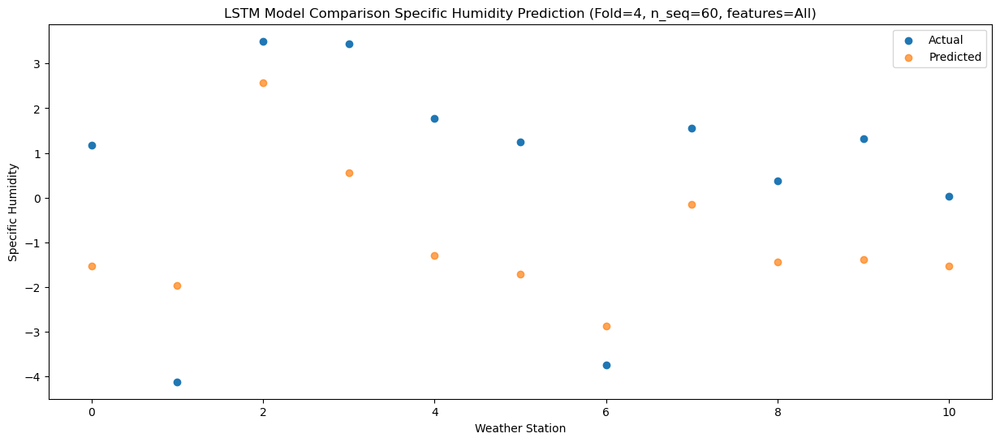

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.23  -1.008328
1                 1   -0.83  -1.448328
2                 2    5.13   3.091672
3                 3    5.23   1.071672
4                 4    3.72  -0.768328
5                 5    2.38  -1.198328
6                 6   -2.18  -2.358328
7                 7    2.76   0.371672
8                 8    1.45  -0.928328
9                 9    2.29  -0.868328
10               10    1.10  -1.008328


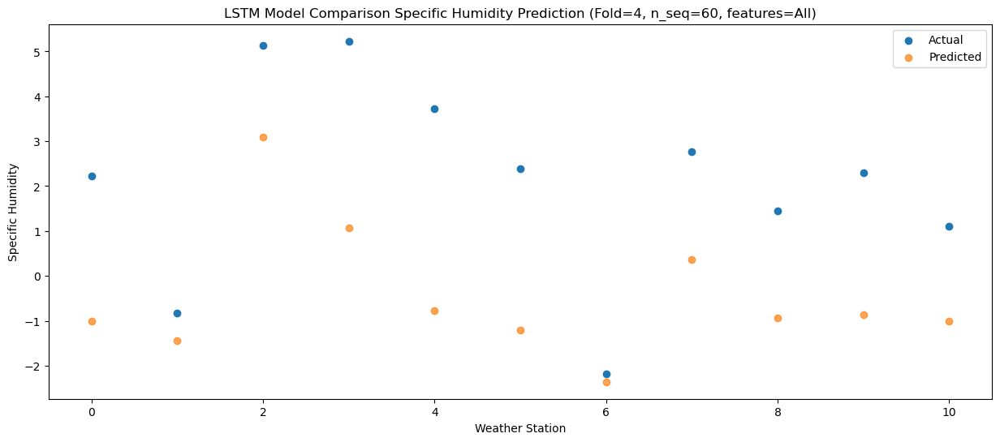

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    3.91   0.536878
1                 1   -1.43   0.096878
2                 2    7.31   4.636878
3                 3    7.60   2.616878
4                 4    6.22   0.776878
5                 5    2.98   0.346878
6                 6   -0.26  -0.813122
7                 7    4.49   1.916878
8                 8    3.48   0.616878
9                 9    4.01   0.676878
10               10    2.88   0.536878


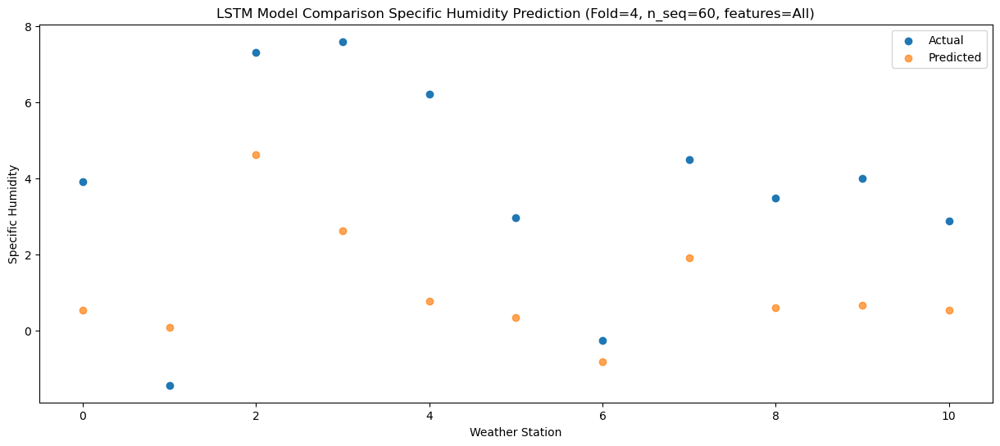

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    7.98   4.170737
1                 1    1.16   3.730737
2                 2   11.63   8.270737
3                 3   11.17   6.250737
4                 4    9.65   4.410737
5                 5    5.74   3.980737
6                 6    3.74   2.820737
7                 7    8.91   5.550737
8                 8    6.97   4.250737
9                 9    7.55   4.310737
10               10    5.80   4.170737


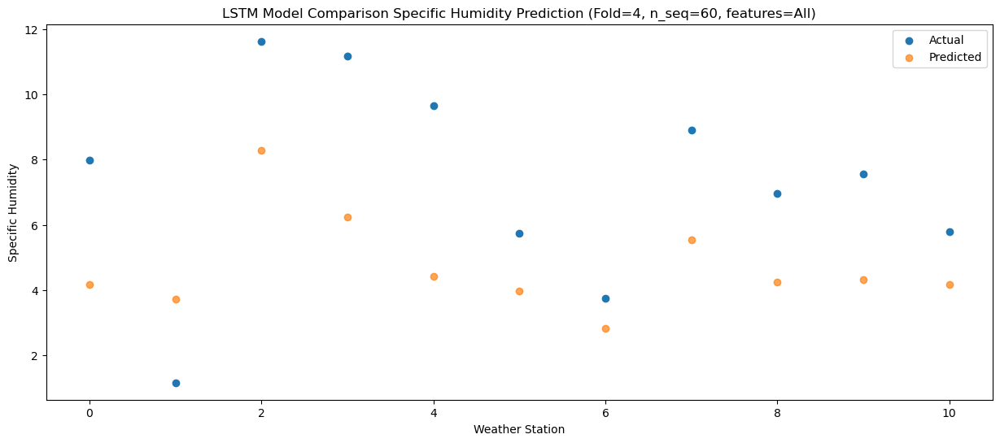

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   11.24    6.84475
1                 1    2.62    6.40475
2                 2   12.97   10.94475
3                 3   13.11    8.92475
4                 4   11.76    7.08475
5                 5   10.27    6.65475
6                 6    5.50    5.49475
7                 7   10.89    8.22475
8                 8    8.66    6.92475
9                 9   10.31    6.98475
10               10    8.35    6.84475


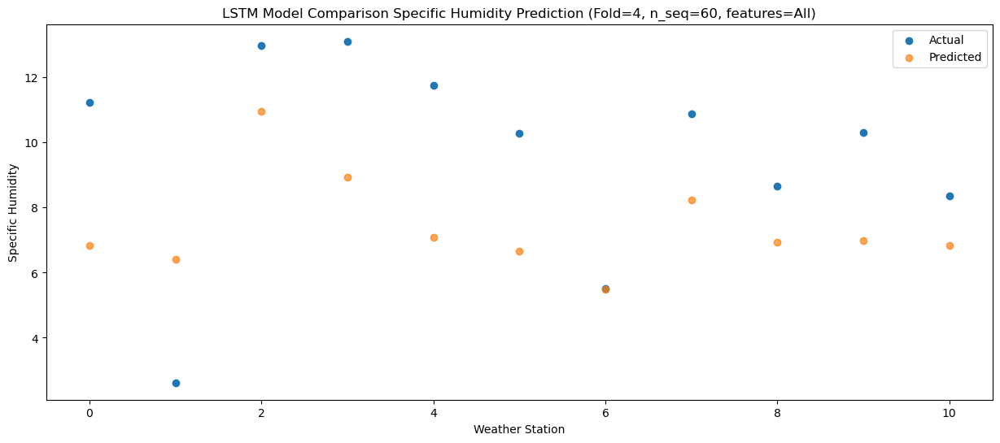

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.43   8.418905
1                 1    4.08   7.978905
2                 2   15.00  12.518905
3                 3   13.07  10.498905
4                 4   11.29   8.658905
5                 5   10.15   8.228905
6                 6    7.89   7.068905
7                 7   11.87   9.798905
8                 8    9.96   8.498905
9                 9   11.92   8.558905
10               10    9.47   8.418905


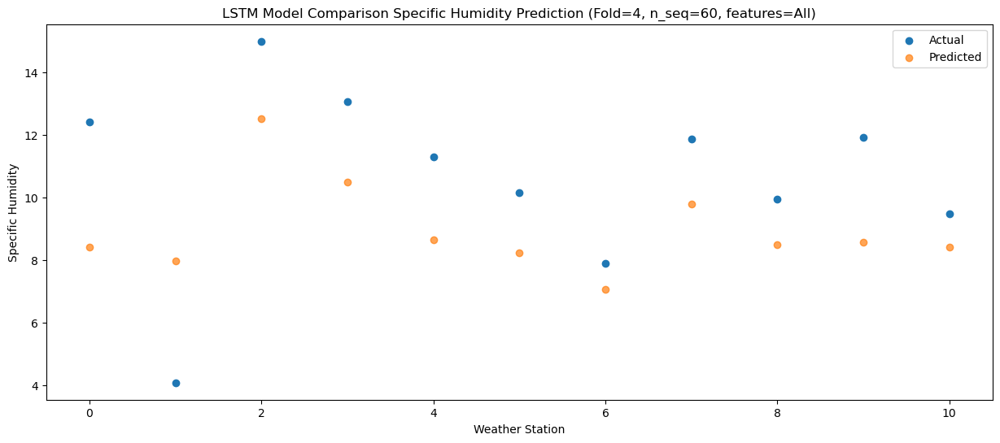

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   11.27   7.296668
1                 1    6.69   6.856668
2                 2   12.69  11.396668
3                 3   12.36   9.376668
4                 4   10.52   7.536668
5                 5    8.95   7.106668
6                 6    7.15   5.946668
7                 7   10.58   8.676668
8                 8    9.60   7.376668
9                 9   11.56   7.436668
10               10    9.45   7.296668


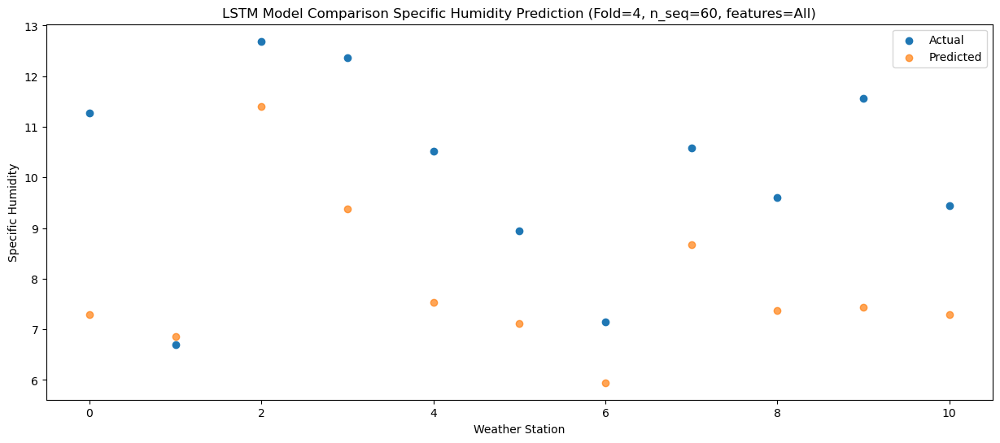

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.97   4.969328
1                 1    6.50   4.529328
2                 2   11.59   9.069328
3                 3    9.83   7.049328
4                 4    8.36   5.209328
5                 5    8.07   4.779328
6                 6    4.83   3.619328
7                 7    8.54   6.349328
8                 8    6.92   5.049328
9                 9    8.06   5.109328
10               10    7.38   4.969328


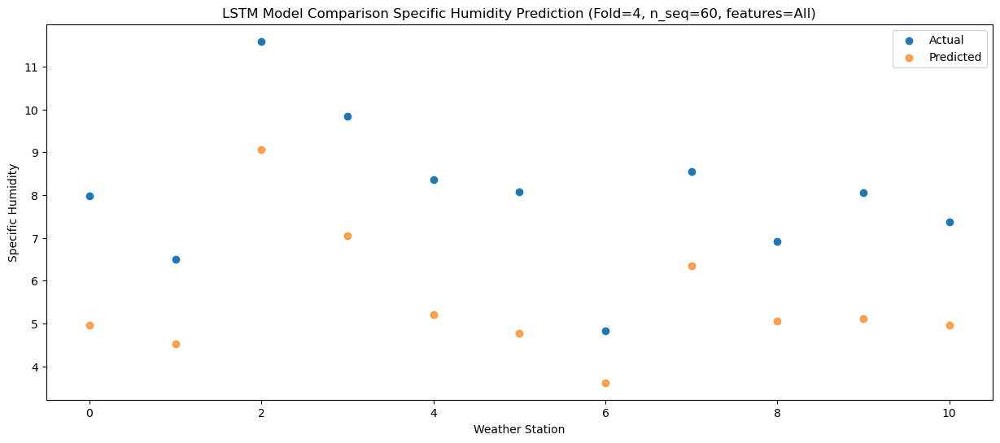

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.84   1.138145
1                 1    2.08   0.698145
2                 2    6.80   5.238145
3                 3    6.37   3.218145
4                 4    4.62   1.378145
5                 5    4.38   0.948145
6                 6    0.43  -0.211855
7                 7    4.22   2.518145
8                 8    3.34   1.218145
9                 9    3.96   1.278145
10               10    3.27   1.138145


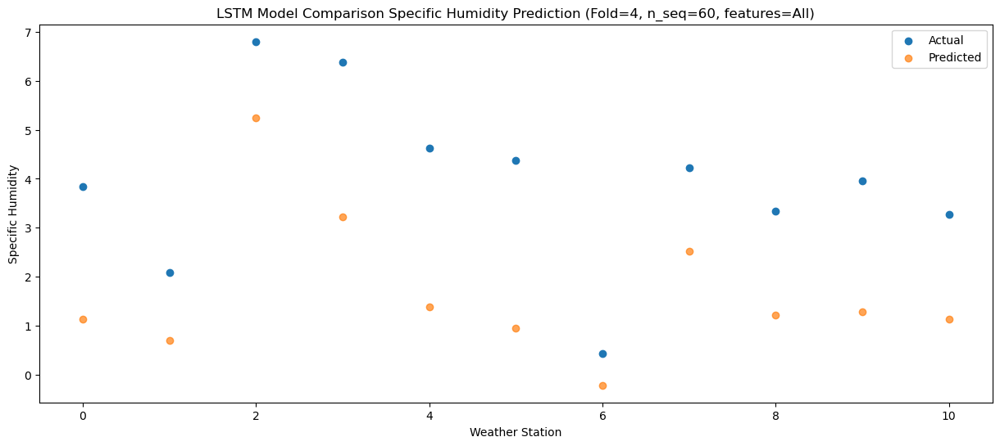

f, t:
[[ 9.500e-01 -1.880e+00  2.900e+00  3.200e+00  1.290e+00  2.630e+00
  -2.970e+00  1.810e+00  4.000e-01  9.500e-01  1.500e-01]
 [ 8.800e-01 -1.740e+00  3.740e+00  2.200e+00  3.200e-01  1.390e+00
  -2.900e+00  1.540e+00  5.700e-01  1.120e+00  3.000e-01]
 [ 4.600e-01 -3.300e+00  3.600e+00  2.840e+00  1.010e+00  1.270e+00
  -3.060e+00  1.300e+00  2.000e-01  6.400e-01 -4.000e-02]
 [ 2.800e-01 -2.460e+00  3.410e+00  2.220e+00  3.500e-01  1.150e+00
  -2.480e+00  1.070e+00 -2.000e-01  3.700e-01 -3.900e-01]
 [ 2.510e+00 -1.080e+00  6.960e+00  6.170e+00  4.250e+00  3.950e+00
  -2.900e-01  3.620e+00  1.720e+00  2.420e+00  1.180e+00]
 [ 3.100e+00  1.300e-01  5.840e+00  5.770e+00  3.740e+00  3.200e+00
  -9.600e-01  3.940e+00  2.000e+00  3.010e+00  1.020e+00]
 [ 6.310e+00  7.800e-01  8.080e+00  8.930e+00  6.980e+00  5.470e+00
   2.160e+00  7.320e+00  5.150e+00  6.730e+00  3.640e+00]
 [ 1.096e+01  4.110e+00  1.138e+01  1.109e+01  8.960e+00  7.180e+00
   5.990e+00  1.093e+01  7.890e+00  9.210e+0

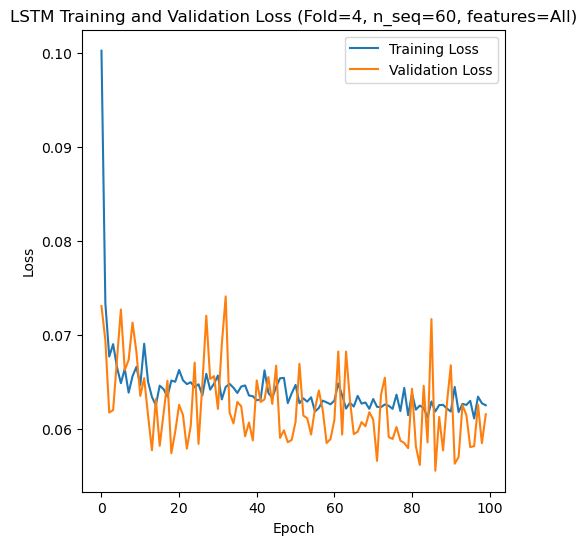

[[1.793131124590167], [2.404945187179641], [1.7214829558753686], [2.093709505896563], [1.9852418486699661]]
[[array(1.79313112)], [array(2.40494519)], [array(1.72148296)], [array(2.09370951)], [array(1.98524185)]]
[[1.4616511675931614], [2.047330811854508], [1.3583265283033255], [1.5574810071123597], [1.6263255386456394]]
[[1.860591150350186], [2.681507392172595], [1.1015363984919235], [1.1394621000432], [1.6910047964487924]]
[[0.8333944128676869], [0.7077218725939334], [0.8400995688790251], [0.6616856939833268], [0.8042452232439541]]
[[array(0.29892839)], [array(0.73144901)], [array(0.2950461)], [array(0.50460712)], [array(1.32979046)]]
[[array(0.90105009)], [array(0.90761962)], [array(0.85880591)], [array(0.73449163)], [array(0.87518623)]]
[0.03 0.46 0.37 ... 9.45 7.38 3.27]
[1.22261585 1.29168159 1.01564243 ... 7.29666819 4.9693283  1.13814487]
Accuracy Results:
RMSE for each fold:
[[1.793131124590167], [2.404945187179641], [1.7214829558753686], [2.093709505896563], [1.9852418486699

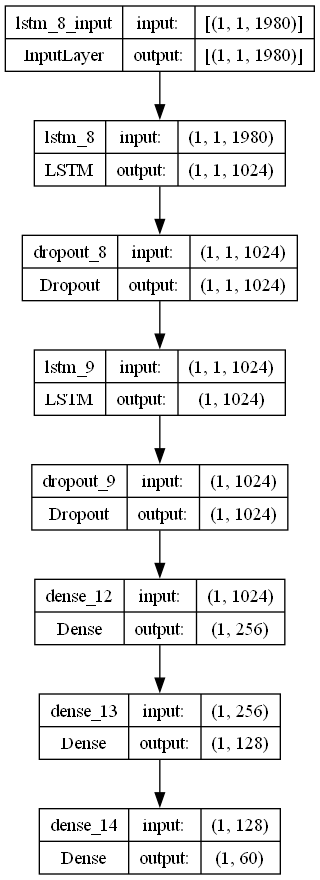

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def kmape (y_true, y_pred):
    return K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def kpearson (y_true, y_pred):
    mean_true = K.mean(y_true)
    mean_pred = K.mean(y_pred)
    return (K.square(K.mean((y_true - mean_true)*(y_pred - mean_pred))))/(K.mean(K.square(y_true - mean_true))*K.mean(K.square(y_pred - mean_pred)))

# fit best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from best model
    lr = 0.0075347879655024725
    optimizer = Adam(learning_rate = lr)
    activation_function = 'sigmoid'
    lstm_units = 1024
    dropout_rate =  0.4315340075776729

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with a LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(actual, forecasts, n_lag, n_seq):

    t = np.array(actual).transpose()
    f = np.array(forecasts).transpose()

    print("f, t:")
    print(t)
    print(f)
    rmse_list = []
    mae_list = []
    skmape_list = []
    mape_list = []
    r2_list = []
    pearson_list = []
    actual_list = []

    for i in range(n_seq):
        act = [row for row in t[i]]
        predicted = [forecast for forecast in f[i]]
        rmse1 = sqrt(mean_squared_error(act, predicted))
        rmse2 = np.array(rmse(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        mae = mean_absolute_error(act, predicted)
        mse = mean_squared_error(act, predicted)
        skmape = mean_absolute_percentage_error(act, predicted)
        kmape1 = np.array(kmape(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        kpearson1 = np.array(kpearson(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        r2 = r2_score(act, predicted) 
        avg_actual = np.mean(act)
        print("Year at t+"+str(i+1)+":")
        print('t+%d SKRMSE: %f' % ((i+1), rmse1))
        print('t+%d KRMSE: %f' % ((i+1), rmse2))        
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d SKMAPE: %f' % ((i+1), skmape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))
        print('t+%d KMAPE: %f' % ((i+1), kmape1))
        print('t+%d PEARSON: %f' % ((i+1), kpearson1))
        print('t+%d AVERAGE ACTUAL: %f' % ((i+1), avg_actual))

    y_true = tf.convert_to_tensor(np.array(actual).flatten())
    y_pred = tf.convert_to_tensor(np.array(forecasts).flatten())

    rmse1 = sqrt(mean_squared_error(np.array(y_true), np.array(y_pred)))
    rmse2 = np.array(rmse(y_true, y_pred))
    mae = mean_absolute_error(np.array(y_true), np.array(y_pred))
    mse = mean_squared_error(np.array(y_true), np.array(y_pred))
    skmape = mean_absolute_percentage_error(np.array(y_true), np.array(y_pred))
    kmape1 = np.array(kmape(y_true, y_pred))
    kpearson1 = np.array(kpearson(y_true, y_pred))
    r2 = r2_score(np.array(y_true), np.array(y_pred)) 
    avg_actual = np.mean(np.array(y_true))
    rmse1_list.append(rmse1)
    rmse2_list.append(rmse2)
    mae_list.append(mae)
    skmape_list.append(skmape)
    pearson_list.append(kpearson1)
    mape_list.append(kmape1)
    r2_list.append(r2)
    actual_list.append(avg_actual)
    print("Metrics for this Fold:")
    print('SKRMSE: %f' % (rmse1))
    print('KRMSE: %f' % (rmse2))        
    print('MAE: %f' % (mae))
    print('SKMAPE: %f' % (skmape))
    print('R2_SCORE: %f' % (r2))
    print('KMAPE: %f' % (kmape1))
    print('PEARSON: %f' % (kpearson1))
    print('AVERAGE ACTUAL: %f' % (avg_actual))

    return rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, actual, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Specific Humidity")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse1_avg_list = []
rmse2_avg_list = []
mae_avg_list = []
skmape_avg_list = []
r2_score_avg_list = []
mape_avg_list = []
pearson_avg_list = []
actual_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]
    
    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    print(dataset)

    series = pd.Series(dataset[:, 0]) # Using first column (specific_humidity)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))
    
    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    print(results_df)
    
    print("Actual and Forecasts:")
    print(actual)
    print(forecasts)
    
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        actual_ws = actual[j]
        
        plot_forecasts(series_ws, forecasts_ws, actual_ws, n_test, n_seq, n_lag)

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)

        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Specific Humidity Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=All)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Specific Humidity')
        plt.legend()
        plt.show()

    rmse1_list = [] # list stores sklearn's root mean squared errors for each future time prediction
    rmse2_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores mean absolute errors for each future time prediction
    skmape_list = [] # list stores sklearn's mean squared percentage errors for each future time prediction
    r2_list = [] # list stores sklearn's r2 pearson values for each future time prediction
    mape_list = [] # list stores mean squared percentage errors for each future time prediction
    pearson_list = [] # list stores r2 pearson values for each future time prediction
    actual_list = [] # list stores average actual values for each future time prediction

    # evaluate forecasts
    rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse1_avg_list.append(rmse1_list)
    rmse2_avg_list.append(rmse2_list)
    mae_avg_list.append(mae_list)
    skmape_avg_list.append(skmape_list)
    r2_score_avg_list.append(r2_list)
    mape_avg_list.append(mape_list)
    pearson_avg_list.append(pearson_list)
    actual_avg_list.append(actual_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)
            
    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=All)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse1_avg_list)
print(rmse2_avg_list)
print(mae_avg_list)
print(skmape_avg_list)
print(r2_score_avg_list)
print(mape_avg_list)
print(pearson_avg_list)
print(np.array(actual_results).flatten())
print(np.array(forecast_results).flatten())
a2 = np.array(actual_results).flatten()
f2 = np.array(forecast_results).flatten()
p1 = np.array(pearson(tf.convert_to_tensor(a2), tf.convert_to_tensor(f2)))
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse1_avg_list)
print("Average SKRMSE:"+str(np.mean(rmse1_avg_list)))
print("Average KRMSE:"+str(np.mean(rmse2_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average SKMAPE:"+str(np.mean(skmape_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average PEARSON:"+str(p1))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))
print("")
print("Average Specific Humidity:"+str(np.mean(actual_avg_list)))
print("RMSE % of Specific Humidity:"+str(np.mean(rmse2_avg_list)/np.mean(actual_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_SH_S60.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)